In [1]:
#%load_ext autoreload
#%autoreload 2

In [2]:
import os
from pathlib import Path
import pandas as pd
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
#from tqdm.notebook import tqdm
from tqdm import tqdm

# Set up
np.random.seed(0)

# Set up plot axes
plt.rc('axes', axisbelow=True)

In [3]:
# Load toolboxes
from newToolbox_ESN import ESN, stateMatrixGenerator
#from newToolbox_ESN import plotFitted, plotOptimFitted, plotStates
from newToolbox_ESN_Multi import ESNMultiFrequency
from newToolbox_MIDAS import MIDAS
#from newToolbox_ExpandingWindow import ExpandingWindow
#from newToolbox_RollingWindow import RollingWindow
from ModelConfidenceSet import ModelConfidenceSet
from statsmodels.stats.stattools import jarque_bera
from statsmodels.stats.diagnostic import acorr_ljungbox
#import ot
#from tabulate import tabulate

In [4]:
# Paths
#path_prefix = "Reservoir-Computing-for-Macroeconomic-Modelling"
path_prefix = ""

path_folder = Path(os.path.dirname(os.path.abspath(os.getcwd())))

In [5]:
# External DFM forecasts
dfm_path = os.path.join(path_folder, path_prefix, "dfm_small")

In [6]:
savePlots = True
plots_folder = os.path.join(path_folder, 'figures', 'nb_macro_small')

##### Preliminaries

In [7]:
def interp1d2(y0, y1, n):
    x = np.linspace(0, 1, n+2)
    y = y0*(1-x) + y1*x
    return y[1:-1]

def daily_begginingInterp(data, start=None, end=None, length=None, endOfMonth=True):
    if isinstance(data, pd.DataFrame):
        data = data.squeeze()
    
    start_ = data.index[0] if (start is None) else start
    end_   = data.index[-1] if (end is None) else end

    assert ~(length is None) and (length > 0), "Choose a valid interpolation length"

    #start_ -= pd.offsets.MonthBegin(1)
    freqrange = pd.date_range(start=start_, end=end_, freq='MS')
    #if endOfMonth:
    #    freqrange = pd.date_range(start=start_, end=end_, freq='MS')
    #else:
    #    freqrange = pd.date_range(start=start_, end=end_, freq='MS')
    
    data_interp = np.full(length * len(freqrange), np.nan)
    #id_i = np.full(length * len(freqrange), np.nan)
    dates_interp = None

    # Initial case
    data_i0 = data.loc[:freqrange[1]]
    L = len(data_i0)
    data_interp[(length-L+2):length] = data_i0.iloc[1:-1]
    data_interp[0:(length-L+2)] = data_i0.iloc[0]
    data_f_last = data_i0[-2]
    if endOfMonth:
        dates_interp = pd.date_range(
            freqrange[1]-pd.DateOffset(days=length), freqrange[1]-pd.DateOffset(days=1)
        )
    else:
        dates_interp = pd.date_range(
            freqrange[0], freqrange[0]+pd.DateOffset(days=length-1)
        )

    # Full cases
    p = length
    for j in range(2, len(freqrange)):
        data_ij = data.loc[freqrange[j-1]:freqrange[j]]
        L = len(data_ij)

        data_interp[(p+length-L+2):(p+length)] = data_ij.iloc[1:-1]
        data_interp[p:(p+length-L+2)] = interp1d2(
            data_f_last, data_ij[0], length-L+2
        )
        if endOfMonth:
            dates_interp = dates_interp.append(pd.date_range(
                freqrange[j]-pd.DateOffset(days=length), freqrange[j]-pd.DateOffset(days=1)
            ))
        else:
            dates_interp = dates_interp.append(pd.date_range(
                freqrange[j-1], freqrange[j-1]+pd.DateOffset(days=length-1)
            ))

        #print(data_ij)
        #print(data_ij[0])

        #id_i[p:(p+length)] = j
        data_f_last = data_ij[-2]
        p += length

    # Last case
    data_ie = data.loc[freqrange[-1]:(freqrange[-1]+pd.tseries.offsets.MonthBegin())]
    L = len(data_ie)
    data_interp[(p+length-L+1):] = data_ie.iloc[1:]
    data_interp[p:(p+length-L+1)] = interp1d2(
        data_f_last, data_ie[0], length-L+1
    )
    if endOfMonth:
        dates_interp = dates_interp.append(pd.date_range(
            freqrange[-1]+pd.tseries.offsets.MonthEnd()-pd.DateOffset(days=length-1), 
            freqrange[-1]+pd.tseries.offsets.MonthEnd()
        ))
    else:
        dates_interp = dates_interp.append(pd.date_range(
            freqrange[-1], freqrange[-1]+pd.DateOffset(days=length-1)
        ))
    
    #data_interp[0:(length-L)] = interp1d2(d_data_pre[0], d_data_pre[1], 24-L)

    data_interp = pd.DataFrame(data=data_interp, index=dates_interp)

    return data_interp

# Plot for visual check-up
#data_i = begginingInterp(d_data, freq='MS', length=24)
#plt.figure(figsize=(10,4))
#for j in range(10):
#    plt.plot(np.arange(j*24, (j+1)*24), data_i[(j*24):((j+1)*24)])

In [8]:
def daily_aggregateByIndex(data, window_size=1, endOfWindow=True, debug=False):
    assert ~(window_size is None) and (window_size > 0), "Choose a valid daily aggregation length"

    data_dates = data.index
    # Get beginning and ends of months over data index
    start_ = data_dates[0] 
    end_   = data_dates[-1]
    month_ends = pd.date_range(start=start_, end=end_, freq='M')
    
    start_j = start_
    exceptions = []

    aggregated_data = pd.DataFrame(data=[], columns=data.columns)
    for end_j in month_ends:
        data_j = data.loc[start_j:end_j]
        j_n = 0
        while j_n < len(data_j):
            slice_j_n = data_j.iloc[j_n:(j_n + window_size)]
            if len(slice_j_n) < window_size:
                exceptions.append(slice_j_n.index.to_period("D"))
            if endOfWindow:
                mean_j_n_index = slice_j_n.index[-1]
            else:
                mean_j_n_index = slice_j_n.index[0]
            aggregated_data.loc[mean_j_n_index] = slice_j_n.mean()
            j_n += window_size

        start_j = end_j + pd.DateOffset(days=1)

    if len(exceptions) > 0:
        print("daily_aggregateByIndex()")
        print(("! Found exceptions in aggregation (some aggregation windows " +
                f"have different length than {window_size})"))
        if debug:
            print("+ Exceptions found:")
            for ex in exceptions: print(ex)

    return aggregated_data

In [9]:
def normalize_train_test(train, test, return_mu_sig=False):
    m_train = train.mean()
    s_train = (train - train.mean()).std()
    if return_mu_sig:
        return (train - m_train)/s_train, (test - m_train)/s_train, m_train, s_train
    else:
        return (train - m_train)/s_train, (test - m_train)/s_train

#### Data

In [10]:
# Sample dates
startSampleDate = pd.to_datetime('1990-01-01')
endSampleDate   = pd.to_datetime('2019-12-31')

data_path = os.path.join(path_folder, path_prefix, "DATE PRE-PROCESING")

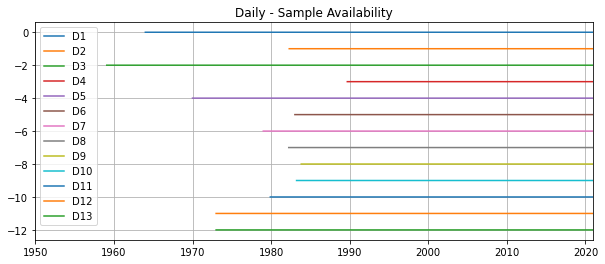

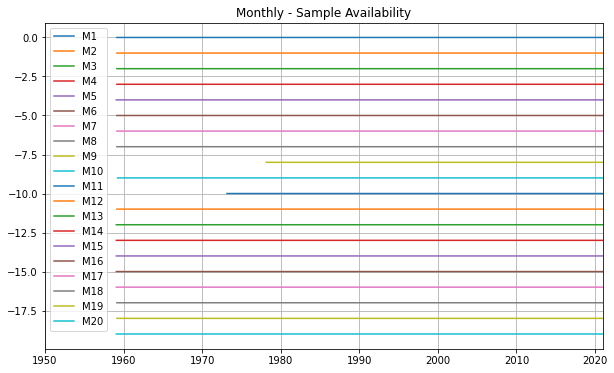

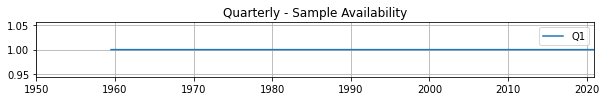

In [11]:
# Check data availability
preproc_data_filled = pd.read_csv(
    os.path.join(data_path, 'fullsample_output_filled_data.csv'),
    parse_dates = ["Date"]
).set_index("Date")

preproc_data_filled[~pd.isna(preproc_data_filled)] = 1

# Daily
plt.figure(figsize=(10,4))
for j, c in enumerate(list(map(lambda j : f"D{j}", range(1, 14)))):
    plt.plot(preproc_data_filled[[c]] * -j, label=c)
plt.xlim([pd.to_datetime('1950-01-01'), pd.to_datetime('2021-01-01')])
plt.grid()
plt.title("Daily - Sample Availability")
plt.legend()
plt.show()

## Weekly
#plt.figure(figsize=(10,3))
#for j, c in enumerate(list(map(lambda j : f"W{j}", range(1, 11)))):
#    plt.plot(preproc_data_filled[[c]] * -j, label=c)
#plt.xlim([pd.to_datetime('1950-01-01'), pd.to_datetime('2021-01-01')])
#plt.grid()
#plt.title("Weekly - Sample Availability")
#plt.legend()
#plt.show()

# Monthly
plt.figure(figsize=(10,6))
for j, c in enumerate(list(map(lambda j : f"M{j}", range(1, 21)))):
    plt.plot(preproc_data_filled[[c]] * -j, label=c)
plt.xlim([pd.to_datetime('1950-01-01'), pd.to_datetime('2021-01-01')])
plt.grid()
plt.title("Monthly - Sample Availability")
plt.legend()
plt.show()

# Quartely
plt.figure(figsize=(10,1))
plt.plot(preproc_data_filled["Q1"], label="Q1")
plt.xlim([pd.to_datetime('1950-01-01'), pd.to_datetime('2021-01-01')])
plt.grid()
plt.title("Quarterly - Sample Availability")
plt.legend()
plt.show()

In [12]:
preproc_data = pd.read_csv(
    os.path.join(data_path, 'fullsample_output_data.csv'), 
    parse_dates = ["Date"]
).set_index("Date")
data = preproc_data.loc[startSampleDate:endSampleDate]

In [13]:
# Non-filled data
d_data = data[['D3']].dropna()
m_data = data[['M1', 'M4', 'M5', 'M7', 'M11', 'M12', 'M14', 'M15']].dropna()
GDP_data = data[['Q1']].dropna()

# Interpolate non-filled daily data
d_data_interp = daily_begginingInterp(d_data, length=24, endOfMonth=False)
d_data_interp.columns = d_data.columns

In [14]:
# Filled data
m_data_prefill = preproc_data[['M1', 'M4', 'M5', 'M7', 'M11', 'M12', 'M14', 'M15']].loc[
    (startSampleDate - pd.offsets.MonthBegin()):endSampleDate
].dropna()
GDP_data_prefill = preproc_data[['Q1']].loc[
    (startSampleDate - pd.offsets.QuarterBegin()):endSampleDate
].dropna()

# Interpolate non-filled daily data to month end
d_data_fill_interp = daily_begginingInterp(d_data, length=24, endOfMonth=True)
d_data_fill_interp.columns = d_data.columns

# Aggregate interpolated daily to mean over 6 days windows
d_data_fill_interp_agg = daily_aggregateByIndex(d_data_fill_interp, window_size=6, endOfWindow=True)

# Shift monthly, quarterly data to solar end-of-month date
m_data_prefill.index = m_data_prefill.index + pd.offsets.MonthEnd(0)
GDP_data_prefill.index = GDP_data_prefill.index + pd.offsets.QuarterEnd(0)

# Re-align filled data to daily indexes, join dataframe
pre_index = pd.date_range(
    start=startSampleDate - pd.offsets.YearBegin(), end=endSampleDate, freq='D'
)
pre_data_interp = pd.DataFrame(
    data=np.full((len(pre_index), 1), np.nan), index=pre_index
)

m_data_interp = pre_data_interp.join(m_data_prefill).ffill()
#GDP_data_interp = pre_data_interp.join(GDP_data_prefill).ffill()

# Make a new dataframe for filled explanatory variables
md_fill_data = d_data_fill_interp.join(m_data_interp.iloc[:,1:])#.join(GDP_data_interp.iloc[:,1:])

md_fill_agg_data = d_data_fill_interp_agg.join(m_data_interp.iloc[:,1:])

# Shift target data
GDP_fill_data  = GDP_data
GDP_fill_data.index = GDP_fill_data.index + pd.offsets.QuarterEnd(0)

In [15]:
# Check: compare GARCH data against squared returns
#preproc_data_old = pd.read_csv(
#    os.path.join(data_path, 'old_versions', 'output_data_nosa.csv'), 
#    parse_dates = ["Date"]
#).set_index("Date")
#data_old = preproc_data_old.loc[startSampleDate:endSampleDate]
#
#sqr_returns_DJ = data[['D4']].dropna() ** 2
#sqr_returns_DJ_interp = daily_begginingInterp(sqr_returns_DJ, length=24, endOfMonth=False)
#sqr_returns_DJ_interp.columns = sqr_returns_DJ.columns
#
#from bokeh.plotting import figure
#from bokeh.io import output_notebook, show
#output_notebook()
#
#p1 = figure(x_axis_type="datetime", plot_height=300, plot_width=700)
#p1.grid.grid_line_alpha=0.3
##p1.xaxis.axis_label = 'Date'
##p1.yaxis.axis_label = 'Price'
#
#def quick_normalize(x):
#    return (x - x.mean()) / np.sqrt(x.var())
#
#p1.line(d_data_interp.index, quick_normalize(d_data_interp).to_numpy().squeeze(), 
#            line_color="royalblue", legend_label='DJ GARCH vola')
#p1.line(sqr_returns_DJ_interp.index, quick_normalize(sqr_returns_DJ_interp).to_numpy().squeeze(), 
#            line_color="coral", legend_label='DJ sqr returns')
#p1.legend.location = "top_left"
#
#show(p1) # open a browser

Function to build datasets:

In [16]:
def getMidasDatasets(trainTestSplitDate, startDate=None, endDate=None):
    assert not trainTestSplitDate is None, "Choose a slicing data for train/test datasets"

    #trainTestSplitDate = pd.to_datetime('2007-12-31')
    trainTestSplitDate = pd.to_datetime(trainTestSplitDate)
    startDate = startSampleDate if (startDate is None) else pd.to_datetime(startDate)
    endDate = startSampleDate if (endDate is None) else pd.to_datetime(endDate)

    GDP_data_train = GDP_data.loc[startDate:trainTestSplitDate]
    GDP_data_test = GDP_data.loc[(trainTestSplitDate + pd.offsets.Day()):endDate]

    m_data_train = m_data.loc[startDate:trainTestSplitDate]
    m_data_test = m_data.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1)):endDate]

    d_data_train = d_data_interp.loc[startDate:trainTestSplitDate]
    d_data_test = d_data_interp.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1) + pd.offsets.Day(23)):endDate]

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test, 
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    # MIDAS data format
    GDP_data_midas = np.vstack((
        GDP_data_train.to_numpy(), 
        GDP_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
    ))
    md_data_midas = (
        tuple(
            np.vstack((
                m_data_train[s].to_numpy()[:,None], 
                m_data_test[s].loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()[:,None]
            )) for s in m_data_train.columns
        ) +
        (np.vstack((
            d_data_train.to_numpy(), 
            d_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
        )), )
    )

    return GDP_data_midas, md_data_midas, (GDP_mu_train, GDP_sig_train)

In [17]:
def getEsnSingleDatasets(trainTestSplitDate, startDate=None, endDate=None, aggregate=False):
    assert not trainTestSplitDate is None, "Choose a slicing data for train/test datasets"

    #trainTestSplitDate = pd.to_datetime('2007-12-31')
    trainTestSplitDate = pd.to_datetime(trainTestSplitDate)
    startDate = startSampleDate if (startDate is None) else pd.to_datetime(startDate)
    endDate = startSampleDate if (endDate is None) else pd.to_datetime(endDate)

    GDP_fill_data_train = GDP_fill_data.loc[startDate:trainTestSplitDate]
    GDP_fill_data_test = GDP_fill_data.loc[(trainTestSplitDate + pd.offsets.Day()):endDate]

    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_fill_data_train, GDP_fill_data_test = normalize_train_test(GDP_fill_data_train, GDP_fill_data_test)

    if aggregate:
        md_fill_agg_data_train = md_fill_agg_data.loc[startDate:trainTestSplitDate]
        md_fill_agg_data_test = md_fill_agg_data.loc[(trainTestSplitDate):endDate]

        md_fill_agg_data_train, md_fill_agg_data_test = normalize_train_test(md_fill_agg_data_train, md_fill_agg_data_test)

        return GDP_fill_data_train, GDP_fill_data_test, md_fill_agg_data_train, md_fill_agg_data_test
    else:
        md_fill_data_train = md_fill_data.loc[startDate:trainTestSplitDate]
        md_fill_data_test = md_fill_data.loc[(trainTestSplitDate):endDate]

        md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)

        return GDP_fill_data_train, GDP_fill_data_test, md_fill_data_train, md_fill_data_test

In [18]:
def getEsnMultiDatasets(trainTestSplitDate, startDate=None, endDate=None):
    assert not trainTestSplitDate is None, "Choose a slicing data for train/test datasets"

    #trainTestSplitDate = pd.to_datetime('2007-12-31')
    trainTestSplitDate = pd.to_datetime(trainTestSplitDate)
    startDate = startSampleDate if (startDate is None) else pd.to_datetime(startDate)
    endDate = startSampleDate if (endDate is None) else pd.to_datetime(endDate)

    GDP_data_train = GDP_data.loc[startDate:trainTestSplitDate]
    GDP_data_test = GDP_data.loc[(trainTestSplitDate + pd.offsets.Day()):endDate]

    m_data_train = m_data.loc[startDate:trainTestSplitDate]
    m_data_test = m_data.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1)):endDate]

    d_data_train = d_data_interp.loc[startDate:trainTestSplitDate]
    d_data_test = d_data_interp.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1) + pd.offsets.Day(23)):endDate]

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_data_train, GDP_data_test = normalize_train_test(GDP_data_train, GDP_data_test)
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    return GDP_data_train, GDP_data_test, m_data_train, m_data_test, d_data_train, d_data_test

In [19]:
def getSmallDatasets(trainTestSplitDate=None):
    assert not trainTestSplitDate is None, "Choose a slicing data for train/test datasets"

    #trainTestSplitDate = pd.to_datetime('2007-12-31')
    trainTestSplitDate = pd.to_datetime(trainTestSplitDate)

    # Split training and testing sample
    GDP_data_train = GDP_data.loc[startSampleDate:trainTestSplitDate]
    m_data_train = m_data.loc[startSampleDate:trainTestSplitDate]
    d_data_train = d_data_interp.loc[startSampleDate:trainTestSplitDate]
    GDP_fill_data_train  = GDP_fill_data.loc[startSampleDate:trainTestSplitDate]
    md_fill_data_train = md_fill_data.loc[startSampleDate:trainTestSplitDate]
    md_fill_agg_data_train = md_fill_agg_data.loc[startSampleDate:trainTestSplitDate]

    GDP_data_test = GDP_data.loc[(trainTestSplitDate + pd.offsets.Day()):endSampleDate]
    m_data_test = m_data.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1)):endSampleDate]
    d_data_test = d_data_interp.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1) + pd.offsets.Day(23)):endSampleDate]
    GDP_fill_data_test  = GDP_fill_data.loc[(trainTestSplitDate + pd.offsets.Day()):endSampleDate]
    md_fill_data_test = md_fill_data.loc[(trainTestSplitDate):endSampleDate]
    md_fill_agg_data_test = md_fill_agg_data.loc[(trainTestSplitDate):endSampleDate]

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    #GDP_data_train, GDP_data_test = normalize_train_test(GDP_data_train, GDP_data_test)
    #m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    #d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    #GDP_fill_data_train, GDP_fill_data_test = normalize_train_test(GDP_fill_data_train, GDP_fill_data_test)
    #md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)
    #md_fill_agg_data_train, md_fill_agg_data_test = normalize_train_test(md_fill_agg_data_train, md_fill_agg_data_test)

    # MIDAS data format
    GDP_data_midas = np.vstack((
        GDP_data_train.to_numpy(), 
        GDP_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
    ))
    md_data_midas = (
        tuple(
            np.vstack((
                m_data_train[s].to_numpy()[:,None], 
                m_data_test[s].loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()[:,None]
            )) for s in m_data_train.columns
        ) +
        (np.vstack((
            d_data_train.to_numpy(), 
            d_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
        )), )
    )

    dataset = {
        'GDP_data_train':           GDP_data_train, 
        'GDP_data_test':            GDP_data_test, 
        'm_data_train':             m_data_train, 
        'm_data_test':              m_data_test, 
        'd_data_train':             d_data_train, 
        'd_data_test':              d_data_test,
        'GDP_fill_data_train':      GDP_fill_data_train, 
        'GDP_fill_data_test':       GDP_fill_data_test, 
        'md_fill_data_train':       md_fill_data_train, 
        'md_fill_data_test':        md_fill_data_test,
        'md_fill_agg_data_train':   md_fill_agg_data_train, 
        'md_fill_agg_data_test':    md_fill_agg_data_test,
        'GDP_data_midas':           GDP_data_midas, 
        'md_data_midas':            md_data_midas,
    }

    return dataset

In [20]:
def getSmallDatasets_extended(startSampleDate, endSampleDate, trainTestSplitDate=None):
    assert not trainTestSplitDate is None, "Choose a slicing data for train/test datasets"

    startSampleDate = pd.to_datetime(startSampleDate)
    endSampleDate = pd.to_datetime(endSampleDate)
    trainTestSplitDate = pd.to_datetime(trainTestSplitDate)

    data_ext = preproc_data.loc[startSampleDate:endSampleDate]
    # NOTE: unlike previous datasets, can not just always drop NAs, but instead 
    #       must slice data correctly according to date frequencies.

    # (i) Non-filled data
    d_data_ext = data_ext[['D3']].replace(np.NaN, 0.)
    m_data_ext = data_ext[
        ['M1', 'M4', 'M5', 'M7', 'M11', 'M12', 'M14', 'M15']
    ].loc[
        pd.date_range(startSampleDate, endSampleDate, freq='BM'),
    ].replace(np.NaN, 0.)
    GDP_data_ext = data_ext[['Q1']].dropna()

    # Interpolate non-filled daily data
    d_data_ext_interp = daily_begginingInterp(d_data_ext, length=24, endOfMonth=False)
    d_data_ext_interp.columns = d_data_ext.columns

    # (ii) Filled data
    m_data_ext_prefill = preproc_data[
        ['M1', 'M4', 'M5', 'M7', 'M11', 'M12', 'M14', 'M15']
    ].loc[
        (startSampleDate - pd.offsets.MonthBegin()):endSampleDate
    ].loc[
        pd.date_range((startSampleDate - pd.offsets.MonthBegin()), endSampleDate, freq='BM'),
    ].replace(np.NaN, 0.)
    GDP_data_ext_prefill = preproc_data[['Q1']].loc[
        (startSampleDate - pd.offsets.QuarterBegin()):endSampleDate
    ].dropna()

    # Interpolate non-filled daily data to month end
    d_data_ext_fill_interp = daily_begginingInterp(d_data_ext, length=24, endOfMonth=True)
    d_data_ext_fill_interp.columns = d_data_ext.columns

    # Aggregate interpolated daily to mean over 6 days windows
    d_data_ext_fill_interp_agg = daily_aggregateByIndex(
        d_data_ext_fill_interp, window_size=6, endOfWindow=True
    )

    # Shift monthly, quarterly data to solar end-of-month date
    m_data_ext_prefill.index = m_data_ext_prefill.index + pd.offsets.MonthEnd(0)
    GDP_data_ext_prefill.index = GDP_data_ext_prefill.index + pd.offsets.QuarterEnd(0)

    # Re-align filled data to daily indexes, join dataframe
    pre_index = pd.date_range(
        start=startSampleDate - pd.offsets.YearBegin(), end=endSampleDate, freq='D'
    )
    pre_data_interp = pd.DataFrame(
        data=np.full((len(pre_index), 1), np.nan), index=pre_index
    )

    # Make a new dataframe for filled explanatory variables
    m_data_ext_interp = pre_data_interp.join(m_data_ext_prefill).ffill()
    md_fill_data_ext = d_data_ext_fill_interp.join(m_data_ext_interp.iloc[:,1:])
    md_fill_agg_data_ext = d_data_ext_fill_interp_agg.join(m_data_ext_interp.iloc[:,1:])

    # Shift target data
    GDP_fill_data_ext = GDP_data_ext.copy()
    GDP_fill_data_ext.index = GDP_fill_data_ext.index + pd.offsets.QuarterEnd(0)
    
    # (iii) Split training and testing sample
    GDP_data_train = GDP_data_ext.loc[:trainTestSplitDate]
    m_data_train = m_data_ext.loc[:trainTestSplitDate]
    d_data_train = d_data_ext_interp.loc[:trainTestSplitDate]
    GDP_fill_data_train  = GDP_fill_data_ext.loc[:trainTestSplitDate]
    md_fill_data_train = md_fill_data_ext.loc[:trainTestSplitDate]
    md_fill_agg_data_train = md_fill_agg_data_ext.loc[:trainTestSplitDate]

    GDP_data_test = GDP_data_ext.loc[(trainTestSplitDate + pd.offsets.Day()):]
    m_data_test = m_data_ext.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1)):]
    d_data_test = d_data_ext_interp.loc[(trainTestSplitDate - pd.offsets.MonthBegin(1) + pd.offsets.Day(23)):]
    GDP_fill_data_test  = GDP_fill_data_ext.loc[(trainTestSplitDate + pd.offsets.Day()):]
    md_fill_data_test = md_fill_data_ext.loc[(trainTestSplitDate):]
    md_fill_agg_data_test = md_fill_agg_data_ext.loc[(trainTestSplitDate):]

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    #GDP_data_train, GDP_data_test = normalize_train_test(GDP_data_train, GDP_data_test)
    #m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    #d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    #GDP_fill_data_train, GDP_fill_data_test = normalize_train_test(GDP_fill_data_train, GDP_fill_data_test)
    #md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)
    #md_fill_agg_data_train, md_fill_agg_data_test = normalize_train_test(md_fill_agg_data_train, md_fill_agg_data_test)

    # MIDAS data format
    GDP_data_midas = np.vstack((
        GDP_data_train.to_numpy(), 
        GDP_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
    ))
    md_data_midas = (
        tuple(
            np.vstack((
                m_data_train[s].to_numpy()[:,None], 
                m_data_test[s].loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()[:,None]
            )) for s in m_data_train.columns
        ) +
        (np.vstack((
            d_data_train.to_numpy(), 
            d_data_test.loc[(trainTestSplitDate + pd.offsets.Day()):].to_numpy()
        )), )
    )

    dataset = {
        'GDP_data_train':           GDP_data_train, 
        'GDP_data_test':            GDP_data_test, 
        'm_data_train':             m_data_train, 
        'm_data_test':              m_data_test, 
        'd_data_train':             d_data_train, 
        'd_data_test':              d_data_test,
        'GDP_fill_data_train':      GDP_fill_data_train, 
        'GDP_fill_data_test':       GDP_fill_data_test, 
        'md_fill_data_train':       md_fill_data_train, 
        'md_fill_data_test':        md_fill_data_test,
        'md_fill_agg_data_train':   md_fill_agg_data_train, 
        'md_fill_agg_data_test':    md_fill_agg_data_test,
        'GDP_data_midas':           GDP_data_midas, 
        'md_data_midas':            md_data_midas,
    }

    return dataset

In [21]:
#test___dataset2007_ext = getSmallDatasets_extended(
#    '1970-01-01', '2019-12-31', trainTestSplitDate='2007-12-31'
#)
#
#plt.figure(figsize=(14,3))
#plt.plot(test___dataset['m_data_train']['M5'])
#plt.plot(dataset2007['m_data_train']['M5'])
#plt.show()
#
#plt.figure(figsize=(14,3))
#plt.plot(test___dataset['GDP_data_train'])
#plt.plot(dataset2007['GDP_data_train'])
#plt.show()

In [22]:
# Export data to MATLAB
#GDP_fill_data_train.to_csv(os.path.join(path_folder, "data", "GDP_fill_data_train.csv"))
#GDP_fill_data_test.to_csv(os.path.join(path_folder, "data", "GDP_fill_data_test.csv"))
#md_fill_data_train.to_csv(os.path.join(path_folder, "data", "md_fill_data_train.csv"))
#md_fill_data_test.to_csv(os.path.join(path_folder, "data", "md_fill_data_test.csv"))

### Models

_[Note: all DFM model forecasts are external, read from CSV files]_

DFM:

In [23]:
def getDFMOneStepAheadForecast(model_name, date_slice=None):
    DFM_forecast_train = pd.read_csv(
        os.path.join(dfm_path, model_name, 'train_predictions_12.csv'),
    parse_dates = [0, 1]).set_index('Target Date')
    DFM_forecast_test = pd.read_csv(
        os.path.join(dfm_path, model_name, 'test_predictions_12.csv'),
    parse_dates = [0, 1]).set_index('Target Date')
    DFM_forecast = pd.concat([DFM_forecast_train, DFM_forecast_test])
    if not date_slice is None:
        DFM_forecast = DFM_forecast.loc[date_slice,]
    return DFM_forecast[['0']]

In [24]:
def getDFMMultiStepAheadForecast(model_name, steps, date_slice=None):
    DFM_multistep_forecast = pd.DataFrame(
        data=None, columns=range(steps), index=date_slice,
    )
    for h in range(steps):
        # Read from files
        DFM_forecast_train_h = pd.read_csv(
            os.path.join(dfm_path, model_name, 'train_predictions_'+str(12*(h+1))+'.csv'),
        parse_dates = [0, 1]).set_index('Target Date')
        DFM_forecast_test_h = pd.read_csv(
            os.path.join(dfm_path, model_name, 'test_predictions_'+str(12*(h+1))+'.csv'),
        parse_dates = [0, 1]).set_index('Target Date')
        DFM_forecast_h = pd.concat([DFM_forecast_train_h, DFM_forecast_test_h])
        # Insert
        DFM_multistep_forecast.iloc[:,h] = DFM_forecast_h.loc[date_slice,'0'].to_numpy()
    return DFM_multistep_forecast

MIDAS:

In [25]:
Y_lags = 3
X_lags = [9 for _ in range(len(m_data.columns))] + [30]
freqs = tuple(3 for _ in range(len(m_data.columns))) + (24*3, )

MIDAS_model = MIDAS(freq=freqs, ylags=Y_lags, xlags=X_lags)

Single-reservoir ESN:

In [26]:
esn_S_A = ESN(
    N=30,
    A=stateMatrixGenerator(
        (30, 30), 
        dist='sparse_normal', sparsity=10/30, normalize='eig',
        seed=20220623
    ),
    C=stateMatrixGenerator(
        (30, int(m_data.shape[1] + d_data.shape[1])), 
        dist='sparse_uniform', sparsity=10/30, normalize='norm2',
        seed=20220623
    ),
    rho=0.5,
    gamma=1,
    leak_rate=0.1,
    activation=np.tanh,
)

esnSingle_A = ESNMultiFrequency((esn_S_A,), ar=False) 

In [27]:
esn_S_B = ESN(
    N=120,
    A=stateMatrixGenerator(
        (120, 120), 
        dist='sparse_normal', sparsity=10/120, normalize='eig',
        seed=19120623
    ),
    C=stateMatrixGenerator(
        (120, int(m_data.shape[1] + d_data.shape[1])), 
        dist='sparse_uniform', sparsity=10/120, normalize='norm2',
        seed=19120623
    ),
    rho=0.5,
    gamma=1,
    leak_rate=0.1,
    activation=np.tanh,
)

esnSingle_B = ESNMultiFrequency((esn_S_B,), ar=False) 

Multi-reservoir ESN:

In [28]:
esn_M_A = ESN(
    N=100,
    A=stateMatrixGenerator(
        (100, 100), 
        dist='sparse_normal', sparsity=10/100, normalize='eig',
        seed=20220623
    ),
    C=stateMatrixGenerator(
        (100, m_data.shape[1]), 
        dist='sparse_uniform', sparsity=10/100, normalize='norm2',
        seed=20220623
    ),
    rho=0.5,
    gamma=1.5,
    leak_rate=0,
    activation=np.tanh,
)

esn_D_A = ESN(
    N=20,
    A=stateMatrixGenerator(
        (20, 20), 
        dist='sparse_normal', sparsity=10/20, normalize='eig',
        seed=20220623
    ),
    C=stateMatrixGenerator(
        (20, d_data.shape[1]), 
        dist='sparse_uniform', sparsity=10/20, normalize='norm2',
        seed=20220623
    ),
    rho=0.5,
    gamma=0.5,
    leak_rate=0.1,
    activation=np.tanh,
)

esnMulti_A = ESNMultiFrequency((esn_M_A, esn_D_A), ar=False) 

In [29]:
esn_M_B = ESN(
    N=100,
    A=stateMatrixGenerator(
        (100, 100), 
        dist='sparse_normal', sparsity=10/100, normalize='eig',
        seed=19120623
    ),
    C=stateMatrixGenerator(
        (100, m_data.shape[1]), 
        dist='sparse_uniform', sparsity=10/100, normalize='norm2',
        seed=19120623
    ),
    rho=0.08,
    gamma=0.25,
    leak_rate=0.3,
    activation=np.tanh,
)

esn_D_B = ESN(
    N=20,
    A=stateMatrixGenerator(
        (20, 20), 
        dist='sparse_normal', sparsity=10/20, normalize='eig',
        seed=19120623
    ),
    C=stateMatrixGenerator(
        (20, d_data.shape[1]), 
        dist='sparse_uniform', sparsity=10/20, normalize='norm2',
        seed=19120623
    ),
    rho=0.01,
    gamma=0.01,
    leak_rate=0.99,
    activation=np.tanh,
)

esnMulti_B = ESNMultiFrequency((esn_M_B, esn_D_B), ar=False) 

### Pre-Crisis Model Evaluation

In [30]:
dataset2007 = getSmallDatasets('2007-12-31')

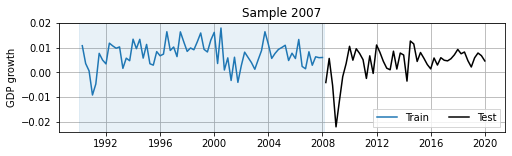

In [31]:
plt.figure(figsize=(8,2))
plt.axvspan(pd.to_datetime("01-01-1990"), pd.to_datetime("01-31-2008"),
                color="C0", alpha=0.1)
plt.plot(dataset2007['GDP_data_train'], label="Train", color="C0")
plt.plot(dataset2007['GDP_data_test'], color="black", label="Test")
plt.ylabel("GDP growth")
plt.grid()
plt.legend(loc="lower right", fancybox=False, shadow=False, ncol=2)
plt.title("Sample 2007")
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_train_sample_2007.pdf'), bbox_inches="tight")
plt.show()

In [33]:
# Export data to MATLAB
#dataset2007['m_data_train'].to_csv(os.path.join(path_folder, "data", "m_data_train.csv"))
#dataset2007['m_data_test'].to_csv(os.path.join(path_folder, "data", "m_data_test.csv"))
#dataset2007['d_data_train'].to_csv(os.path.join(path_folder, "data", "d_data_train.csv"))
#dataset2007['d_data_test'].to_csv(os.path.join(path_folder, "data", "d_data_test.csv"))

##### ESN Ridge CV

Get 'extended' dataset to have enough CV data:

In [34]:
dataset2007_ext = getSmallDatasets_extended(
    '1975-01-01', '2019-12-31', trainTestSplitDate='2007-12-31'
)

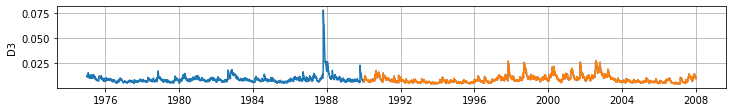

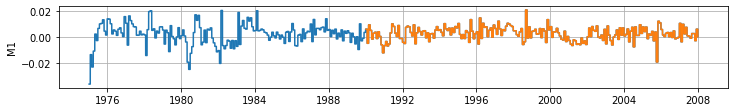

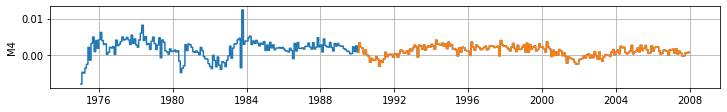

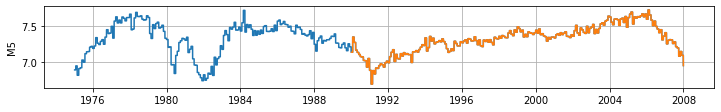

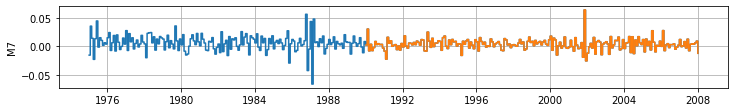

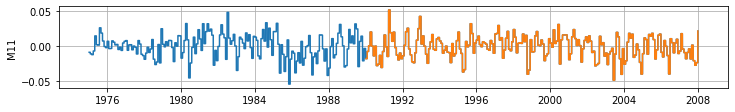

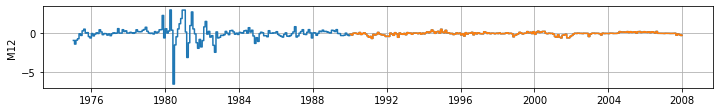

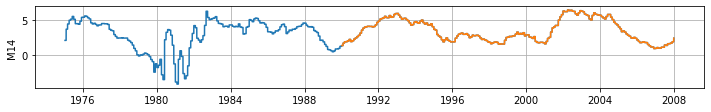

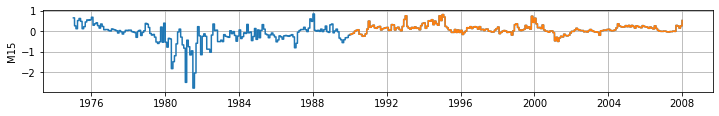

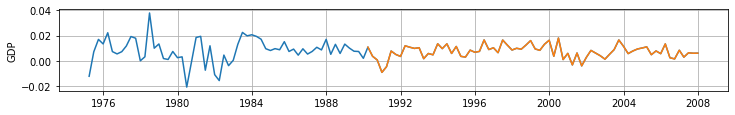

In [35]:
for c in dataset2007['md_fill_data_train'].columns:
    plt.figure(figsize=(12,1.5))
    plt.plot(dataset2007_ext['md_fill_data_train'][c], label=c)
    plt.plot(dataset2007['md_fill_data_train'][c], label=c)
    plt.ylabel(c)
    plt.grid()
    plt.show()

plt.figure(figsize=(12,1.5))
plt.plot(dataset2007_ext['GDP_fill_data_train'])
plt.plot(dataset2007['GDP_fill_data_train'])
plt.ylabel("GDP")
plt.grid()
plt.show()

Single ESN:

In [36]:
#print("+ 10-Fold CV ---------------")
#esnSingle_A_cv10_lambda_2007 = esnSingle_A.ridge_lambda_cv(
#    Y=dataset2007_ext['GDP_fill_data_train'], z=(dataset2007_ext['md_fill_data_train'], ),
#    method="ridge-isotropic",
#    cv_options="-cv:10-test_size:5",
#    steps=1,
#    debug=True,
#)

In [37]:
#print("+ Shift CV ---------------")
#esnSingle_A.ridge_lambda_cv(
#    Y=dataset2007_ext['GDP_fill_data_train'], z=(dataset2007_ext['md_fill_data_train'], ),
#    method="ridge-isotropic-shift",
#    cv_options="-cv_min_split_size:80-cv_max_split_size:80-test_size:1",
#    steps=1,
#    debug=True,
#)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


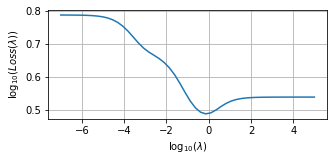

+ s = 0 --------------------
Best solution found:
lambda = [0.76481199]
F      = 3.0834804989816864


In [38]:
# Aggregated
esnSingle_A_agg_cv10_lambda_2007 = esnSingle_A.ridge_lambda_cv(
    Y=dataset2007_ext['GDP_fill_data_train'], z=(dataset2007_ext['md_fill_agg_data_train'], ),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

In [39]:
#print("+ 10-Fold CV ---------------")
#esnSingle_B_cv10_lambda_2007 = esnSingle_B.ridge_lambda_cv(
#    Y=dataset2007_ext['GDP_fill_data_train'], z=(dataset2007_ext['md_fill_data_train'], ),
#    method="ridge-isotropic",
#    cv_options="-cv:10-test_size:5",
#    steps=1,
#    debug=True,
#)

In [40]:
#print("+ Shift CV ---------------")
#esnSingle_B.ridge_lambda_cv(
#    Y=dataset2007_ext['GDP_fill_data_train'], z=(dataset2007_ext['md_fill_data_train'], ),
#    method="ridge-isotropic-shift",
#    cv_options="-cv_min_split_size:80-cv_max_split_size:80-test_size:1",
#    steps=1,
#    debug=True,
#)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


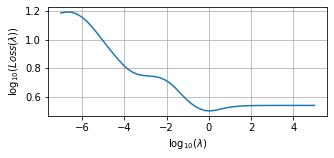

+ s = 0 --------------------
Best solution found:
lambda = [1.03754647]
F      = 3.1728961911990736


In [41]:
# Aggregated
esnSingle_B_agg_cv10_lambda_2007 = esnSingle_B.ridge_lambda_cv(
    Y=dataset2007_ext['GDP_fill_data_train'], z=(dataset2007_ext['md_fill_agg_data_train'], ),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

Multi ESN:

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


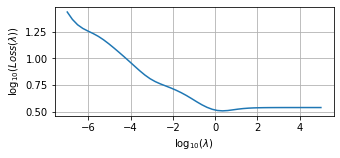

+ s = 0 --------------------
Best solution found:
lambda = [2.19032772]
F      = 3.226790356948246


In [42]:
esnMulti_A_cv10_lambda_2007 = esnMulti_A.ridge_lambda_cv(
    Y=dataset2007_ext['GDP_data_train'], 
    z=(dataset2007_ext['m_data_train'], dataset2007_ext['d_data_train']),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    #cv_options="-cv_min_split_size:80-cv_max_split_size:80-test_size:1",
    steps=1,
    debug=True,
)

In [43]:
#print("+ Shift CV ---------------")
#esnMulti_A.ridge_lambda_cv(
#    Y=dataset2007_ext['GDP_data_train'], 
#    z=(dataset2007_ext['m_data_train'], dataset2007_ext['d_data_train']),
#    method="ridge-isotropic-shift",
#    #cv_options="-cv:10-test_size:5",
#    cv_options="-cv_min_split_size:80-cv_max_split_size:80-test_size:1",
#    steps=1,
#    debug=True,
#)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


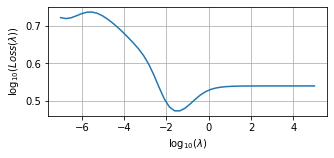

+ s = 0 --------------------
Best solution found:
lambda = [0.0322686]
F      = 2.965175622628758


In [44]:
esnMulti_B_cv10_lambda_2007 = esnMulti_B.ridge_lambda_cv(
    Y=dataset2007_ext['GDP_data_train'], 
    z=(dataset2007_ext['m_data_train'], dataset2007_ext['d_data_train']),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

In [45]:
#print("+ Shift CV ---------------")
#esnMulti_B.ridge_lambda_cv(
#    Y=dataset2007_ext['GDP_data_train'], 
#    z=(dataset2007_ext['m_data_train'], dataset2007_ext['d_data_train']),
#    method="ridge-isotropic-shift",
#    cv_options="-cv_min_split_size:80-cv_max_split_size:80-test_size:1",
#    steps=1,
#    debug=True,
#)

#### Fit

In [196]:
MIDAS_fit_1sa_2007_ = MIDAS_model.fixedparamsForecast(
    data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']),
    fit_length=len(dataset2007['GDP_data_train']),
    steps=1,
    grad=True,
    method='L-BFGS-B',
    debug=False
)

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


In [210]:
MIDAS_fit_1sa_2007_['parsfit_for'][0]['RSS']

0.0012963646601765297

In [213]:
MIDAS_fit_1sa_2007_['forecasts'][0]['FESS']

0.0020350482648548752

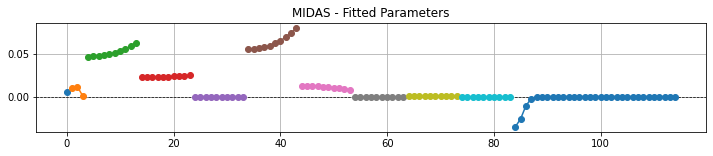

In [198]:
MIDAS_model.plotPhi(MIDAS_fit_1sa_2007_, figsize=(12, 2))

In [47]:
#plt.figure(figsize=(12, 2))
##
#plt.plot(MIDAS_fit_1sa_2007['parsfit_for'][0]['Yt_fit'], label='Fit')
#plt.plot(
#    (MIDAS_fit_1sa_2007['parsfit_for'][0]['Yt_fit'] +
#        MIDAS_fit_1sa_2007['parsfit_for'][0]['Residuals']),
#    label='Data', c='k', ls=':'
#)
##
#plt.grid()
#plt.legend()
#plt.show()

In [269]:
from newToolbox_RAP_MIDAS import RAP_MIDAS

Y_lags = 3
X_lags = [9 for _ in range(len(m_data.columns))] + [30]
freqs = tuple(3 for _ in range(len(m_data.columns))) + (24*3, )

RAP_MIDAS_model = RAP_MIDAS(freq=freqs, ylags=Y_lags, xlags=X_lags)

In [279]:
RAP_MIDAS_fit_1sa_2007 = RAP_MIDAS_model.fixedparamsForecast(
    data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']),
    fit_length=len(dataset2007['GDP_data_train']),
    steps=1,
    M=3,
    basis='gaussian',
    Lambda=1e-5,
    seed=20220725,
)

In [280]:
RAP_MIDAS_fit_1sa_2007['parsfit_for'][0]['RSS']

0.0008871008844702574

In [281]:
RAP_MIDAS_fit_1sa_2007['forecasts'][0]['FESS']

0.0017620098372927546

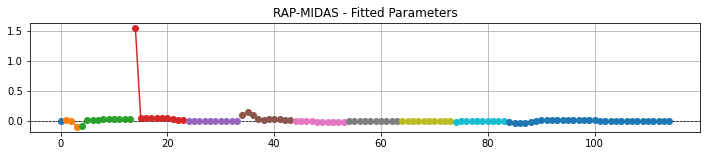

In [282]:
RAP_MIDAS_model.plotCoeffs(RAP_MIDAS_fit_1sa_2007, figsize=(12, 2))

In [299]:
# Repeated estimation
B = 30
averaged_RAP_MIDAS_forecast = np.zeros((B, 48))
for b in range(B):
    RAP_MIDAS_fit_1sa_2007__b = RAP_MIDAS_model.fixedparamsForecast(
        data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']),
        fit_length=len(dataset2007['GDP_data_train']),
        steps=1,
        M=3,
        basis='gaussian',
        Lambda=1e-4,
        seed=20220725+19*b,
    )
    averaged_RAP_MIDAS_forecast[b,:] = np.squeeze(
        RAP_MIDAS_fit_1sa_2007__b['forecasts'][0]['Forecast']
    )
averaged_RAP_MIDAS_forecast = np.mean(averaged_RAP_MIDAS_forecast, 0)

In [303]:
print(np.sum(np.square(
    np.squeeze(RAP_MIDAS_fit_1sa_2007['forecasts'][0]['Yt_test']) -
        averaged_RAP_MIDAS_forecast
)))

0.0015056301837897508


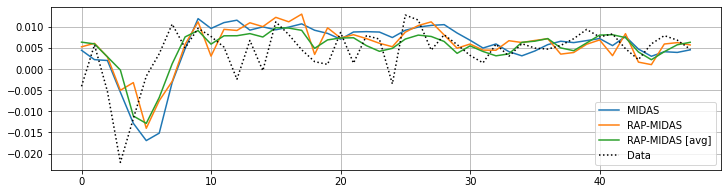

In [304]:
plt.figure(figsize=(12, 3))
#
plt.plot(MIDAS_fit_1sa_2007_['forecasts'][0]['Forecast'], label='MIDAS')
plt.plot(RAP_MIDAS_fit_1sa_2007['forecasts'][0]['Forecast'], label='RAP-MIDAS')
plt.plot(averaged_RAP_MIDAS_forecast, label='RAP-MIDAS [avg]')
plt.plot(RAP_MIDAS_fit_1sa_2007['forecasts'][0]['Yt_test'],
    label='Data', c='k', ls=':'
)
#
plt.grid()
plt.legend()
plt.show()

In [48]:
#MIDAS_fit_1sa_2007__testms = MIDAS_model.fixedparamsForecast(
#    data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']),
#    fit_length=len(dataset2007['GDP_data_train']),
#    steps=3*3*24+1,
#    grad=True,
#    method='L-BFGS-B',
#    debug=False
#)

#for h in range(3):
#    MIDAS_model.plotPhi(MIDAS_fit_1sa_2007__testms, i=h*3*24, figsize=(12, 2))

#for h in range(3):
#    plt.figure(figsize=(12, 2))
#    #
#    plt.plot(MIDAS_fit_1sa_2007__testms['parsfit_for'][h*3*24]['Yt_fit'], label='Fit')
#    plt.plot(
#        (MIDAS_fit_1sa_2007__testms['parsfit_for'][h*3*24]['Yt_fit'] +
#            MIDAS_fit_1sa_2007__testms['parsfit_for'][h*3*24]['Residuals']),
#        label='Data', c='k', ls=':'
#    )
#    #
#    plt.grid()
#    plt.legend()
#    plt.show()

In [49]:
#for h in range(3):
#    plt.figure(figsize=(8, 2))
#    plt.grid()
#    plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
#    #
#    plt.plot(dataset2007['GDP_data_test'].index,
#        MIDAS_fit_1sa_2007__testms['forecasts'][h*3*24]['Forecast'], label="MIDAS", c="C2") 
#    #
#    plt.title("Multi-step Ahead Forecast" + f" [h = {h+1}]")
#    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
#                    frameon=False, fancybox=False, shadow=False, ncol=4)
#    plt.show()

In [50]:
## (A) 
#esnSingle_A_fit_1sa_2007 = esnSingle_A.fit(
#    Y=dataset2007['GDP_fill_data_train'], z=(dataset2007['md_fill_data_train'], ), 
#    method='ridge',
#    Lambda=[1e-2, ],
#    #Lambda=esnSingle_A_cv10_lambda_2007,
#    full=True, 
#    debug=False,
#)
#
## (B)
#esnSingle_B_fit_1sa_2007 = esnSingle_B.fit(
#    Y=dataset2007['GDP_fill_data_train'], z=(dataset2007['md_fill_data_train'], ), 
#    method='ridge',
#    Lambda=[1e-2, ],
#    #Lambda=esnSingle_B_cv10_lambda_2007,
#    full=True, 
#    debug=False,
#)

In [51]:
#plt.figure(figsize=(12, 2))
##
#plt.plot(esnSingle_A_fit_1sa_2007['fit_for'][0]['Y_fit'], label='Fit', c="C0")
#plt.plot(esnSingle_A_fit_1sa_2007['fit_for'][0]['Y'], label='Data', c='k', ls=':')
##
#plt.grid()
#plt.legend()
#plt.show()
#
#plt.figure(figsize=(12, 2))
##
#plt.plot(esnSingle_B_fit_1sa_2007['fit_for'][0]['Y_fit'], label='Fit', c="C1")
#plt.plot(esnSingle_B_fit_1sa_2007['fit_for'][0]['Y'], label='Data', c='k', ls=':')
##
#plt.grid()
#plt.legend()
#plt.show()

In [52]:
## Aggregated 
## (A)
#esnSingle_A_agg_fit_1sa_2007 = esnSingle_A.fit(
#    Y=dataset2007['GDP_fill_data_train'], z=(dataset2007['md_fill_agg_data_train'], ), 
#    method='ridge',
#    Lambda=esnSingle_A_agg_cv10_lambda_2007,
#    full=True, 
#    debug=False,
#)
#
##(B)
#esnSingle_B_agg_fit_1sa_2007 = esnSingle_B.fit(
#    Y=dataset2007['GDP_fill_data_train'], z=(dataset2007['md_fill_agg_data_train'], ), 
#    method='ridge',
#    Lambda=esnSingle_B_agg_cv10_lambda_2007,
#    full=True, 
#    debug=False,
#)

In [53]:
## (A)
#esnMulti_A_fit_1sa_2007 = esnMulti_A.fit(
#    Y=dataset2007['GDP_data_train'], z=(dataset2007['m_data_train'], dataset2007['d_data_train']), 
#    method='ridge',
#    #Lambda=[1e-2, 1e-2],
#    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]],
#    full=True, 
#    debug=False
#)
#
##(B)
#esnMulti_B_fit_1sa_2007 = esnMulti_B.fit(
#    Y=dataset2007['GDP_data_train'], z=(dataset2007['m_data_train'], dataset2007['d_data_train']), 
#    method='ridge',
#    #Lambda=[1e-2, 1e-2],
#    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]],
#    full=True, 
#    debug=False
#)

In [54]:
def esnSingle_fix_fit_highfreq_1sa(esnModel, Lambda, data):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    md_fill_data_train = data['md_fill_agg_data_train']
    md_fill_data_test = data['md_fill_agg_data_test']

    #GDP_test_dates = GDP_data_test.index

    GDP_fill_data_train, GDP_fill_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_fill_data_train, GDP_fill_data_test,
            return_mu_sig=True)
    )
    md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)

    esnSingle_fit = esnModel.fit(
        Y=GDP_fill_data_train, z=(md_fill_data_train, ), 
        method='ridge',
        Lambda=Lambda,
        full=False,
        debug=False,
    )

    esnSingle_hf_for = esnModel.fixedParamsHighFreqForecast(
        Yf=GDP_fill_data_test, zf=(md_fill_data_test,), 
        fit=esnSingle_fit
    )

    # Compute pointwise forecasts
    esnSingle_fix_hf_forecast = (esnSingle_hf_for['highFrequencyForecast'][0]['Y_for'] * 
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy())
    GDP_data_test_hf = (esnSingle_hf_for['highFrequencyForecast'][0]['Y'] *
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()
    )

    return esnSingle_fix_hf_forecast, GDP_data_test_hf

In [55]:
rest__test = esnSingle_fix_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=[1e-2], 
    data=dataset2007,
)

NameError: name 'esnSingle_A_agg_fix_for_1sa_2007' is not defined

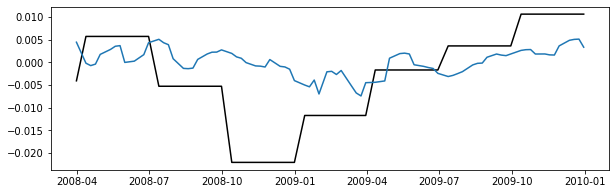

In [56]:
plt.figure(figsize=(10,3))
plt.plot(rest__test[1].loc[:'01-01-2010'], c='k', label="Data")
plt.plot(rest__test[0].loc[:'01-01-2010'])
plt.plot(esnSingle_A_agg_fix_for_1sa_2007.loc[:'01-01-2010'], marker="x", ls="-.")
plt.grid()
plt.show()

In [ ]:
def MIDAS_fix_fit_highfreq_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test, 
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    # MIDAS data format
    GDP_data_midas = np.vstack((
        GDP_data_train.to_numpy(), 
        GDP_data_test.to_numpy()
    ))
    md_data_midas = (
        tuple(
            np.vstack((
                m_data_train[s].to_numpy()[:,None], 
                m_data_test[s].loc[(GDP_data_train.index[-1] + pd.offsets.Day()):].to_numpy()[:,None]
            )) for s in m_data_train.columns
        ) +
        (np.vstack((
            d_data_train.to_numpy(), 
            d_data_test.loc[(GDP_data_train.index[-1] + pd.offsets.Day()):].to_numpy()
        )), )
    )

    # Fit
    MIDAS_fit = midasModel.fixedparamsHighFreqForecast(
        data=(GDP_data_midas, md_data_midas),
        fit_length=len(GDP_data_train),
        steps=1,
        grad=True,
        method='L-BFGS-B',
        debug=True
    )

    #midasModel.plotPhi(MIDAS_fit, figsize=(12, 2))

    # NOTE: build high-freq forecast index *manually*
    #       (here easier than programmatically)
    index_for = GDP_test_dates[[0]]
    for m in pd.date_range(GDP_test_dates[0]+pd.offsets.Day(1), GDP_test_dates[-1], freq="M"):
        index_for = index_for.union(pd.date_range(
            m - pd.offsets.Day(23), m,
        ))

    # Compute pointwise forecasts
    MIDAS_fix_forecast = pd.DataFrame(
        data=(MIDAS_fit['forecasts'][0]['Forecast'] * 
            GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()), 
        #index=GDP_test_dates[[0]].union(
        #    d_test_dates[d_test_dates > GDP_test_dates[0]]
        #),
        index=index_for,
    )

    return MIDAS_fix_forecast

In [ ]:
for m in pd.date_range(pd.to_datetime("2008-03-31"), pd.to_datetime("2019-12-31"), freq="M"):
    print(pd.date_range(
            m - pd.offsets.Day(23), m,
        ))

DatetimeIndex(['2008-03-08', '2008-03-09', '2008-03-10', '2008-03-11',
               '2008-03-12', '2008-03-13', '2008-03-14', '2008-03-15',
               '2008-03-16', '2008-03-17', '2008-03-18', '2008-03-19',
               '2008-03-20', '2008-03-21', '2008-03-22', '2008-03-23',
               '2008-03-24', '2008-03-25', '2008-03-26', '2008-03-27',
               '2008-03-28', '2008-03-29', '2008-03-30', '2008-03-31'],
              dtype='datetime64[ns]', freq='D')
DatetimeIndex(['2008-04-07', '2008-04-08', '2008-04-09', '2008-04-10',
               '2008-04-11', '2008-04-12', '2008-04-13', '2008-04-14',
               '2008-04-15', '2008-04-16', '2008-04-17', '2008-04-18',
               '2008-04-19', '2008-04-20', '2008-04-21', '2008-04-22',
               '2008-04-23', '2008-04-24', '2008-04-25', '2008-04-26',
               '2008-04-27', '2008-04-28', '2008-04-29', '2008-04-30'],
              dtype='datetime64[ns]', freq='D')
DatetimeIndex(['2008-05-08', '2008-05-09', '2008-0

In [ ]:
MIDAS_fix_for_highfreq_1sa_2007 = MIDAS_fix_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2007,
)

---
MIDAS.fixedparamsForecast() | MIDAS model [Forecasting] -> Debug Info
---
MIDAS.mixed_freq_regmats_for() -> Debug Info
 Y           ->  1 variable(s)	 [low-frequency]
 X           ->  9 variable(s)	 [high-frequency]
---
 h1    =  [3.33333333 3.33333333 3.33333333 3.33333333 3.33333333 3.33333333
 3.33333333 3.33333333 0.43055556]
 h2    =  [0.01388889]
 tau1  =  4
---
 Forecasting regression matrices shapes:
  (8640, 1)   ~  [AR] (8640, 3), [weighted] (8640, 111)
 Preliminary joint regression matrix:
[[        nan         nan         nan ...         nan         nan
          nan]
 [        nan         nan         nan ...         nan         nan
          nan]
 [        nan         nan         nan ...         nan         nan
          nan]
 ...
 [        nan         nan         nan ... -0.30702401 -0.25703006
  -0.15751093]
 [        nan         nan         nan ... -0.2810805  -0.30702401
  -0.25703006]
 [        nan         nan         nan ... -0.29509355 -0.2810805
  -0.30702401]]

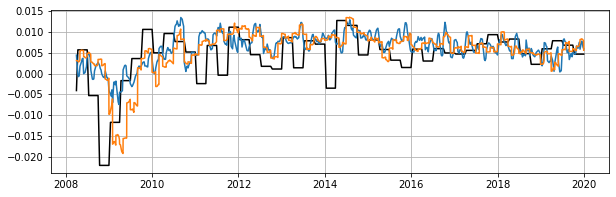

In [ ]:
plt.figure(figsize=(10,3))
plt.plot(rest__test[1], c='k', label="Data")
plt.plot(rest__test[0])
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, marker="x", ls="-.")
plt.plot(MIDAS_fix_for_highfreq_1sa_2007)
#plt.plot(MIDAS_fix_for_1sa_2007, marker="+", ls="-.")
plt.grid()
plt.show()

In [ ]:
def esnMulti_fix_fit_highfreq_1sa(esnModel, Lambda, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    #GDP_test_dates = GDP_data_test.index

    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test,
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    esnMulti_fit = esnModel.fit(
        Y=GDP_data_train, z=(m_data_train, d_data_train), 
        method='ridge',
        Lambda=Lambda,
        full=False,
        debug=False,
    )

    esnMulti_hf_for = esnModel.fixedParamsHighFreqForecast(
        Yf=GDP_data_test, zf=(m_data_test, d_data_test), 
        fit=esnMulti_fit
    )

    # Compute pointwise forecasts
    esnMulti_fix_hf_forecast = (esnMulti_hf_for['highFrequencyForecast'][0]['Y_for'] * 
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy())
    GDP_data_test_hf = (esnMulti_hf_for['highFrequencyForecast'][0]['Y'] *
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()
    )

    return esnMulti_fix_hf_forecast, GDP_data_test_hf

In [ ]:
rest__test = esnMulti_fix_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[1e-2, 1e-2], 
    data=dataset2007,
)

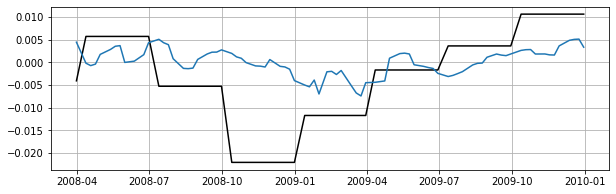

In [ ]:
plt.figure(figsize=(10,3))
plt.plot(rest__test[1].loc[:'01-01-2010'], c='k', label="Data")
plt.plot(rest__test[0].loc[:'01-01-2010'])
plt.grid()
plt.show()

In [ ]:
def esnSingle_ew_fit_highfreq_1sa(esnModel, Lambda, data, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index

    if retune:  Lambdas = []

    forecast_hf_ew = []
    target_hf_ew = []
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train, 
                GDP_fill_data_test.iloc[0:j,]
            ])
            md_fill_data_train_j = pd.concat([
                md_fill_data_train, 
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
            md_fill_data_test_j = md_fill_data_test.loc[GDP_test_dates[j-1]:GDP_test_dates[j]]
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
            md_fill_data_test_j = md_fill_data_test.loc[:GDP_test_dates[0]]

        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        #print(np.mean(GDP_fill_data_train_j))
        #print(np.mean(GDP_fill_data_train_j))

        #print(f"j = {j}")
        #print(f"{GDP_fill_data_train_j.index[-1]} | {GDP_fill_data_test_j.index[0]}")
        #print(f"{md_fill_data_train_j.index[-1]} | {md_fill_data_test_j.index[0]} -> {md_fill_data_test_j.index[-1]}")
        #print("-------------------------------")

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnSingle_hf_for = esnModel.fixedParamsHighFreqForecast(
            Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
            fit=esnSingle_fit
        )

        forecast_hf_ew.append(
            esnSingle_hf_for['highFrequencyForecast'][0]['Y_for'] * sig_j.to_numpy() + mu_j.to_numpy()
        )
        target_hf_ew.append(
            esnSingle_hf_for['highFrequencyForecast'][0]['Y'] * sig_j.to_numpy() + mu_j.to_numpy()
        )

    forecast_hf_ew = pd.concat(forecast_hf_ew)
    target_hf_ew = pd.concat(target_hf_ew)

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return forecast_hf_ew, target_hf_ew

 EW:   0%|          | 0/48 [00:00<?, ?it/s]

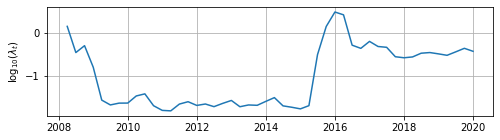

In [ ]:
rest__ew_test = esnSingle_ew_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

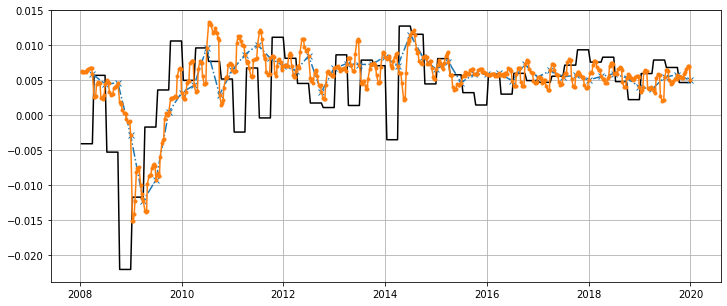

In [ ]:
plt.figure(figsize=(12,5))
plt.plot(rest__ew_test[1], c='k', label="Data")
plt.plot(esnSingle_A_agg_ew_for_1sa_2007, marker="x", ls="-.")
plt.plot(rest__ew_test[0], marker=".")
plt.grid()
plt.show()

In [ ]:
#plt.figure(figsize=(12, 2))
##
#plt.plot(esnMulti_A_fit_1sa_2007['fit_for'][0]['Y_fit'], label='Fit', c="C0")
#plt.plot(esnMulti_A_fit_1sa_2007['fit_for'][0]['Y'], label='Data', c='k', ls=':')
##
#plt.grid()
#plt.legend()
#plt.show()
#
#plt.figure(figsize=(12, 2))
##
#plt.plot(esnMulti_B_fit_1sa_2007['fit_for'][0]['Y_fit'], label='Fit', c="C1")
#plt.plot(esnMulti_B_fit_1sa_2007['fit_for'][0]['Y'], label='Data', c='k', ls=':')
##
#plt.grid()
#plt.legend()
#plt.show()

#### 1-step Ahead Point Forecast Comparison

##### Fixed Parameters

In [54]:
#DFM_A_fix_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1]_fixed__2007', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_A_fix_forecast_2007 = DFM_A_fix_forecast[['0']].loc[DFM_slice_2007,]
#
#DFM_B_fix_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1]_fixed__2007', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_B_fix_forecast_2007 = DFM_B_fix_forecast[['0']].loc[DFM_slice_2007,]

DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_fix_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_fixed__2007', date_slice=DFM_slice_2007,
)

DFM_B_fix_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_fixed__2007', date_slice=DFM_slice_2007,
)

In [55]:
def uncondMean_1sa_fixParamsForecast(data):
    GDP_data_train = data['GDP_data_train']
    GDP_test_dates = data['GDP_data_test'].index

    return pd.DataFrame(
        data=np.ones((len(GDP_test_dates))) * GDP_data_train.mean().iloc[0],
        index=GDP_test_dates,
    )

In [56]:
UnMean_fix_for_1sa_2007 = uncondMean_1sa_fixParamsForecast(
    data=dataset2007,
)

In [81]:
def MIDAS_fix_fit_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test, 
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    # MIDAS data format
    GDP_data_midas = np.vstack((
        GDP_data_train.to_numpy(), 
        GDP_data_test.to_numpy()
    ))
    md_data_midas = (
        tuple(
            np.vstack((
                m_data_train[s].to_numpy()[:,None], 
                m_data_test[s].loc[(GDP_data_train.index[-1] + pd.offsets.Day()):].to_numpy()[:,None]
            )) for s in m_data_train.columns
        ) +
        (np.vstack((
            d_data_train.to_numpy(), 
            d_data_test.loc[(GDP_data_train.index[-1] + pd.offsets.Day()):].to_numpy()
        )), )
    )

    # Fit
    MIDAS_fit = midasModel.fixedparamsForecast(
        data=(GDP_data_midas, md_data_midas),
        fit_length=len(GDP_data_train),
        steps=1,
        grad=True,
        method='L-BFGS-B',
        debug=False
    )

    midasModel.plotPhi(MIDAS_fit, figsize=(12, 2))

    # Compute pointwise forecasts
    MIDAS_fix_forecast = pd.DataFrame(
        data=(MIDAS_fit['forecasts'][0]['Forecast'] * 
            GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()), 
        index=GDP_test_dates,
    )

    return MIDAS_fix_forecast

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


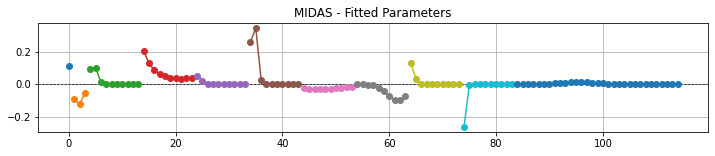

In [82]:
MIDAS_fix_for_1sa_2007 = MIDAS_fix_fit_1sa(
    midasModel=MIDAS_model,
    data=dataset2007,
)

In [60]:
def esnSingle_fix_fit_1sa(esnModel, Lambda, data, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    #GDP_test_dates = GDP_fill_data_test.index

    GDP_fill_data_train, GDP_fill_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_fill_data_train, GDP_fill_data_test,
            return_mu_sig=True)
    )
    md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)

    esnSingle_fit = esnModel.fit(
        Y=GDP_fill_data_train, z=(md_fill_data_train, ), 
        method='ridge',
        Lambda=Lambda,
        full=False,
        debug=False,
    )

    plt.figure(figsize=(12,2))
    plt.plot(esnSingle_fit['fit_for'][0]['Y'], c='k')
    plt.plot(esnSingle_fit['fit_for'][0]['Y_fit'])
    plt.grid()
    plt.show()

    esnSingle_for = esnModel.fixedParamsForecast(
        Yf=GDP_fill_data_test, zf=(md_fill_data_test, ), 
        fit=esnSingle_fit
    )

    # Compute pointwise forecasts
    esnSingle_fix_forecast = (esnSingle_for['Forecast'][0]['Y_for'] * 
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy())

    return esnSingle_fix_forecast

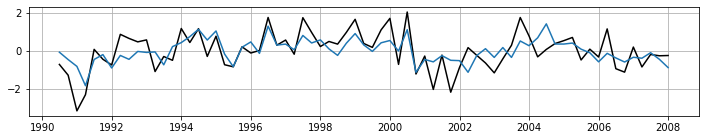

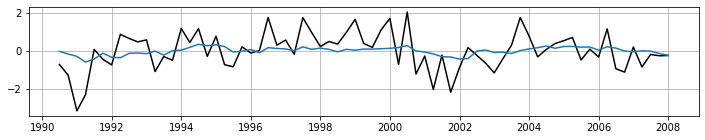

In [71]:
esnSingle_A_agg_fix_for_1sa_2007 = esnSingle_fix_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    #Lambda=[1e-2,],
    data=dataset2007,
    aggregate=True,
)

esnSingle_B_agg_fix_for_1sa_2007 = esnSingle_fix_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    #Lambda=[1e-2,],
    data=dataset2007,
    aggregate=True,
)

In [61]:
## Aggregated singleESNs
#esnSingle_A_agg_for_1sa_2007 = esnSingle_A.fixedParamsForecast(
#    Yf=dataset2007['GDP_fill_data_test'], zf=(dataset2007['md_fill_agg_data_test'], ), 
#    fit=esnSingle_A_agg_fit_1sa_2007
#)['Forecast'][0]['Y_for']
#
#esnSingle_B_agg_for_1sa_2007 = esnSingle_B.fixedParamsForecast(
#    Yf=dataset2007['GDP_fill_data_test'], zf=(dataset2007['md_fill_agg_data_test'], ), 
#    fit=esnSingle_B_agg_fit_1sa_2007
#)['Forecast'][0]['Y_for']

In [62]:
def esnMulti_fix_fit_1sa(esnModel, Lambda, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    #GDP_test_dates = GDP_data_test.index

    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test,
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    esnMulti_fit = esnModel.fit(
        Y=GDP_data_train, z=(m_data_train, d_data_train), 
        method='ridge',
        Lambda=Lambda,
        full=False,
        debug=False,
    )

    plt.figure(figsize=(12,2))
    plt.plot(esnMulti_fit['fit_for'][0]['Y'], c='k')
    plt.plot(esnMulti_fit['fit_for'][0]['Y_fit'])
    plt.grid()
    plt.show()

    esnMulti_for = esnModel.fixedParamsForecast(
        Yf=GDP_data_test, zf=(m_data_test, d_data_test), 
        fit=esnMulti_fit
    )

    # Compute pointwise forecasts
    esnMulti_fix_forecast = (esnMulti_for['Forecast'][0]['Y_for'] * 
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy())

    return esnMulti_fix_forecast

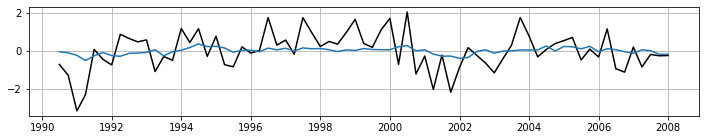

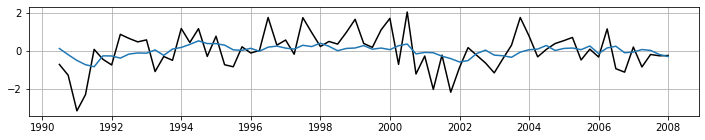

In [63]:
esnMulti_A_fix_for_1sa_2007 = esnMulti_fix_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    #Lambda=[1e-2, 1e-2],
    data=dataset2007,
)

esnMulti_B_fix_for_1sa_2007 = esnMulti_fix_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
)

In [64]:
#esnMulti_A_for_1sa_2007 = esnMulti_A.fixedParamsForecast(
#    Yf=dataset2007['GDP_data_test'], zf=(dataset2007['m_data_test'], dataset2007['d_data_test']), 
#    fit=esnMulti_A_fit_1sa_2007
#)['Forecast'][0]['Y_for']
#
#esnMulti_B_for_1sa_2007 = esnMulti_B.fixedParamsForecast(
#    Yf=dataset2007['GDP_data_test'], zf=(dataset2007['m_data_test'], dataset2007['d_data_test']), 
#    fit=esnMulti_B_fit_1sa_2007
#)['Forecast'][0]['Y_for']

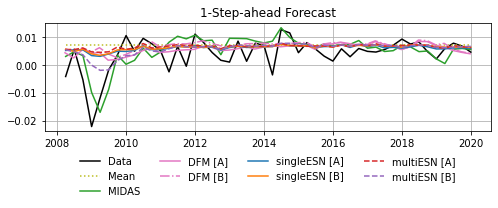

In [65]:
# Plot -- 1-Step-ahead Forecast
plt.figure(figsize=(8, 2))
plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_fix_for_1sa_2007, label="Mean", c="C8", ls=':')
#
plt.plot(MIDAS_fix_for_1sa_2007, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_fix_forecast_2007, label="DFM [A]", c="C6") 
plt.plot(DFM_B_fix_forecast_2007, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_fix_for_1sa_2007, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_fix_for_1sa_2007, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_fix_for_1sa_2007, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_fix_for_1sa_2007, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_2007.pdf'), bbox_inches="tight")
plt.show()

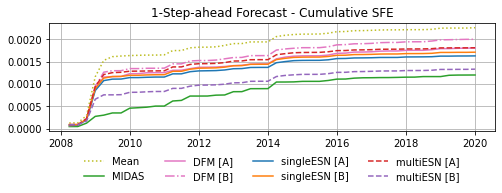

In [66]:
# Plot -- 1-Step-ahead Forecast - Cumulative SFE
cumulSFE_2007 = lambda forecast : np.cumsum(np.square(dataset2007['GDP_data_test'] - forecast.to_numpy()))

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2007(UnMean_fix_for_1sa_2007), label="Mean", c="C8", ls=':') 
#
plt.plot(cumulSFE_2007(MIDAS_fix_for_1sa_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2007(DFM_A_fix_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2007(DFM_B_fix_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulSFE_2007(esnSingle_A_agg_fix_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2007(esnSingle_B_agg_fix_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(cumulSFE_2007(esnMulti_A_fix_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulSFE_2007(esnMulti_B_fix_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
#plt.yscale('log')
plt.title("1-Step-ahead Forecast - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_2007.pdf'), bbox_inches="tight")
plt.show()

In [67]:
def MSFE_2007(forecast, startDate=None):
    if not startDate is None:
        startDate = pd.to_datetime(startDate)
        msfe = np.mean(np.square(
                dataset2007['GDP_data_test'].loc[startDate:,].to_numpy() - 
                    forecast.loc[startDate:,].to_numpy()
            ))
    else:
        msfe = np.mean(np.square(
                dataset2007['GDP_data_test'].to_numpy() - forecast.to_numpy()
            ))
    return msfe

MIDAS_MSE_fix_2007_td = MSFE_2007(MIDAS_fix_for_1sa_2007) * 1e4 
UnMean_MSE_fix_2007_td = MSFE_2007(UnMean_fix_for_1sa_2007) * 1e4
DFM_A_MSE_fix_2007_td = MSFE_2007(DFM_A_fix_forecast_2007) * 1e4
DMF_B_MSE_fix_2007_td = MSFE_2007(DFM_B_fix_forecast_2007) * 1e4
esnSingle_A_MSE_fix_2007_td = MSFE_2007(esnSingle_A_agg_fix_for_1sa_2007) * 1e4
esnSingle_B_MSE_fix_2007_td = MSFE_2007(esnSingle_B_agg_fix_for_1sa_2007) * 1e4
esnMulti_A_MSE_fix_2007_td = MSFE_2007(esnMulti_A_fix_for_1sa_2007) * 1e4
esnMulti_B_MSE_fix_2007_td = MSFE_2007(esnMulti_B_fix_for_1sa_2007) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"MIDAS \t\t = {MIDAS_MSE_fix_2007_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_fix_2007_td).round(4)}")
print(f"Mean \t\t = {UnMean_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_fix_2007_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_fix_2007_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_fix_2007_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_fix_2007_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_fix_2007_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_fix_2007_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_fix_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_fix_2007_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
MIDAS 		 = 0.2504 	|	0.5004
Mean 		 = 0.4702 	|	0.6857
DFM [A]		 = 0.3755 	|	0.6128
DFM [B]		 = 0.4162 	|	0.6451
singleESN [A]	 = 0.3392 	|	0.5824
singleESN [B]	 = 0.3564 	|	0.597
multiESN [A]	 = 0.3771 	|	0.6141
multiESN [B]	 = 0.2776 	|	0.5269


In [68]:
ref_MSE_2007_fix = UnMean_MSE_fix_2007_td
MIDAS_MSE_toRef_2007_fix = MIDAS_MSE_fix_2007_td / ref_MSE_2007_fix
DFM_A_MSE_toRef_2007_fix = DFM_A_MSE_fix_2007_td / ref_MSE_2007_fix
DMF_B_MSE_toRef_2007_fix = DMF_B_MSE_fix_2007_td / ref_MSE_2007_fix
esnSingle_A_MSE_toRef_2007_fix = esnSingle_A_MSE_fix_2007_td / ref_MSE_2007_fix
esnSingle_B_MSE_toRef_2007_fix = esnSingle_B_MSE_fix_2007_td / ref_MSE_2007_fix
esnMulti_A_MSE_toRef_2007_fix = esnMulti_A_MSE_fix_2007_td / ref_MSE_2007_fix
esnMulti_B_MSE_toRef_2007_fix = esnMulti_B_MSE_fix_2007_td / ref_MSE_2007_fix

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2007_fix.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2007_fix.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2007_fix.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2007_fix.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2007_fix.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2007_fix.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2007_fix.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
MIDAS 		 = 0.5326
DFM [A]		 = 0.7987
DFM [B]		 = 0.8852
singleESN [A]	 = 0.7215
singleESN [B]	 = 0.758
multiESN [A]	 = 0.802
multiESN [B]	 = 0.5904


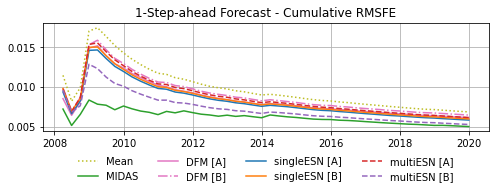

In [69]:
# Plot -- 1-Step-ahead Forecast - Cumulative RMSFE
def cumulRMSFE_2007(forecast):
    cumulMFE = np.cumsum(np.square(dataset2007['GDP_data_test'] - forecast.to_numpy()))
    return np.sqrt(cumulMFE / np.reshape(np.arange(1, len(forecast)+1), (-1, 1)))

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2007(UnMean_fix_for_1sa_2007), label="Mean", c="C8", ls=':') 
#
plt.plot(cumulRMSFE_2007(MIDAS_fix_for_1sa_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2007(DFM_A_fix_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2007(DFM_B_fix_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2007(esnSingle_A_agg_fix_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2007(esnSingle_B_agg_fix_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(cumulRMSFE_2007(esnMulti_A_fix_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulRMSFE_2007(esnMulti_B_fix_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_2007.pdf'), bbox_inches="tight")
plt.show()

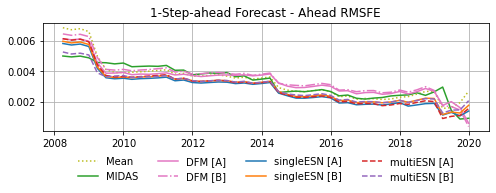

In [70]:
# Plot -- 1-Step-ahead Forecast - Ahead RMSFE
def aheadRMSFE_2007(forecast):
    fSFE = np.flip(np.square(dataset2007['GDP_data_test'].to_numpy() - forecast.to_numpy()))
    aheadMSFE = np.sqrt(np.cumsum(fSFE) / np.arange(1, len(forecast)+1))
    return pd.DataFrame(data=np.flip(aheadMSFE), index=dataset2007['GDP_data_test'].index)

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2007(UnMean_fix_for_1sa_2007), label="Mean", c="C8", ls=':') 
#
plt.plot(aheadRMSFE_2007(MIDAS_fix_for_1sa_2007), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2007(DFM_A_fix_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2007(DFM_B_fix_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2007(esnSingle_A_agg_fix_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2007(esnSingle_B_agg_fix_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(aheadRMSFE_2007(esnMulti_A_fix_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(aheadRMSFE_2007(esnMulti_B_fix_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_2007.pdf'), bbox_inches="tight")
plt.show()

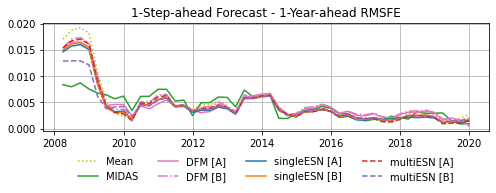

In [71]:
# Plot -- 1-Step-ahead Forecast - 1-Year-ahead RMSFE
def YA_RMSFE_2007(forecast):
    SFE = np.square(dataset2007['GDP_data_test'].to_numpy() - forecast.to_numpy())
    T = len(SFE)
    YA_RMSFE = np.array(
        [np.sqrt(np.mean(SFE[j:min(j+4,T)])) for j in range(T)]
    )
    return pd.DataFrame(data=YA_RMSFE, index=dataset2007['GDP_data_test'].index)

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2007(UnMean_fix_for_1sa_2007), label="Mean", c="C8", ls=':') 
#
plt.plot(YA_RMSFE_2007(MIDAS_fix_for_1sa_2007), label="MIDAS", c="C2") 
#
plt.plot(YA_RMSFE_2007(DFM_A_fix_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2007(DFM_B_fix_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2007(esnSingle_A_agg_fix_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2007(esnSingle_B_agg_fix_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(YA_RMSFE_2007(esnMulti_A_fix_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(YA_RMSFE_2007(esnMulti_B_fix_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_2007.pdf'), bbox_inches="tight")
plt.show()

In [311]:
mcs_data_2007_fix = pd.DataFrame(
    np.c_[UnMean_fix_for_1sa_2007,
        MIDAS_fix_for_1sa_2007, 
        DFM_A_fix_forecast_2007,
        DFM_B_fix_forecast_2007,
        esnSingle_A_agg_fix_for_1sa_2007,
        esnSingle_B_agg_fix_for_1sa_2007,
        esnMulti_A_fix_for_1sa_2007,
        esnMulti_B_fix_for_1sa_2007,
    ],
    columns=['Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]']
)
mcs_data_2007_fix = (mcs_data_2007_fix - dataset2007['GDP_data_test'].to_numpy())

mcs_25_2007_fix = ModelConfidenceSet(
    data=np.square(mcs_data_2007_fix), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2007_fix = ModelConfidenceSet(
    data=np.square(mcs_data_2007_fix), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2007_fix.included}")
print(f"MCS 10 included: {mcs_10_2007_fix.included}")

MCS 25 included: ['singleESN [A]', 'multiESN [B]', 'MIDAS']
MCS 10 included: ['singleESN [A]', 'multiESN [B]', 'MIDAS']


In [312]:
mcs_25_2007_fix.pvalues

DFM [B]          0.0102
Mean             0.0775
DFM [A]          0.0775
multiESN [A]     0.0775
singleESN [B]    0.0775
singleESN [A]    0.3862
multiESN [B]     0.7245
MIDAS            1.0000
dtype: float64

In [313]:
mcs_data_2007_fix.to_csv(
    os.path.join(path_folder, "R", "mcs_small_fix_2007.csv")
)

Ljung-Box Test on Forecast Errors

In [75]:
#LBtest_2007 = lambda forecast : acorr_ljungbox((dataset2007['GDP_data_test'] - forecast.to_numpy()), lags=7)
#
#print("Ljung-Box autocorrelation test [Fixed, 2007] - p-values (10 lags):")
#print(pd.DataFrame(
#    np.c_[LBtest_2007(MIDAS_fix_for_1sa_2007)['lb_pvalue'],
#        LBtest_2007(DFM_A_fix_forecast_2007)['lb_pvalue'],
#        LBtest_2007(DFM_B_fix_forecast_2007)['lb_pvalue'],
#        LBtest_2007(esnSingle_A_agg_fix_for_1sa_2007)['lb_pvalue'],
#        LBtest_2007(esnSingle_B_agg_fix_for_1sa_2007)['lb_pvalue'],
#        LBtest_2007(esnMulti_A_fix_for_1sa_2007)['lb_pvalue'],
#        LBtest_2007(esnMulti_B_fix_for_1sa_2007)['lb_pvalue'],
#    ],
#    columns=['MIDAS', 'DFM [A]', 'DFM [B]', 'esnSingle [A]', 'esnSingle [B]', 'esnMulti [A]', 'esnMulti [B]'],
#    index=np.arange(1,8),
#))

Wassertstein

In [76]:
#def wasserstein1_2007(forecast):
#    xs = dataset2007['GDP_data_test'].to_numpy().reshape((-1, 1))
#    xt = forecast.to_numpy().reshape((-1, 1))
#    n = len(xs)
#    # Distance matrix
#    M = ot.dist(xs, xt, metric='euclidean')
#    M /= M.max()
#    # Uniform distribution on samples
#    a, b = np.ones((n,)) / n, np.ones((n,)) / n
#    return ot.emd2(a, b, M)
#
#def wasserstein2_2007(forecast):
#    xs = dataset2007['GDP_data_test'].to_numpy().reshape((-1, 1))
#    xt = forecast.to_numpy().reshape((-1, 1))
#    n = len(xs)
#    # Distance matrix
#    M = ot.dist(xs, xt)
#    M /= M.max()
#    # Uniform distribution on samples
#    a, b = np.ones((n,)) / n, np.ones((n,)) / n
#    return np.sqrt(ot.emd2(a, b, M))

In [77]:
#print("Wasserstein 1 distance forecast / test data:")
#print(f"MIDAS: \t\t {wasserstein1_2007(MIDAS_1sa_forecast_2007):.4f}")
#print(f"DFM [A]: \t {wasserstein1_2007(DFM_A_forecast_2007):.4f}")
#print(f"DFM [B]: \t {wasserstein1_2007(DFM_B_forecast_2007):.4f}")
#print(f"singleESN [A]: \t {wasserstein1_2007(esnSingle_A_agg_for_1sa_2007):.4f}")
#print(f"singleESN [B]: \t {wasserstein1_2007(esnSingle_B_agg_for_1sa_2007):.4f}")
#print(f"multiESN [A]: \t {wasserstein1_2007(esnMulti_A_for_1sa_2007):.4f}")
#print(f"multiESN [B]: \t {wasserstein1_2007(esnMulti_B_for_1sa_2007):.4f}")

In [78]:
#print("Wasserstein 2 distance forecast / test data:")
#print(f"MIDAS: \t\t {wasserstein2_2007(MIDAS_1sa_forecast_2007):.4f}")
#print(f"DFM [A]: \t {wasserstein2_2007(DFM_A_forecast_2007):.4f}")
#print(f"DFM [B]: \t {wasserstein2_2007(DFM_B_forecast_2007):.4f}")
#print(f"singleESN [A]: \t {wasserstein2_2007(esnSingle_A_agg_for_1sa_2007):.4f}")
#print(f"singleESN [B]: \t {wasserstein2_2007(esnSingle_B_agg_for_1sa_2007):.4f}")
#print(f"multiESN [A]: \t {wasserstein2_2007(esnMulti_A_for_1sa_2007):.4f}")
#print(f"multiESN [B]: \t {wasserstein2_2007(esnMulti_B_for_1sa_2007):.4f}")

In [79]:
#fig, ax = plt.subplots(figsize=(12, 4), nrows=1, ncols=4, sharex='all', sharey='all')
#ax[0].hist(dataset2007['GDP_data_test'].to_numpy(), label="Data", color='k', density=True)
#ax[0].hist(MIDAS_1sa_forecast_2007.to_numpy(), label="MIDAS", color='C2', alpha=0.8, density=True)
#ax[0].grid()
#ax[0].legend()
#ax[1].hist(dataset2007['GDP_data_test'].to_numpy(), label="Data", color='k', density=True)
#ax[1].hist(DFM_A_forecast_2007.to_numpy(), label="DFM [A]", color='C6', alpha=0.8, density=True)
#ax[1].grid()
#ax[1].legend()
#ax[2].hist(dataset2007['GDP_data_test'].to_numpy(), label="Data", color='k', density=True)
#ax[2].hist(esnSingle_A_agg_for_1sa_2007.to_numpy(), label="singleESN [A]", color='C0', alpha=0.8, density=True)
#ax[2].grid()
#ax[2].legend()
#ax[3].hist(dataset2007['GDP_data_test'].to_numpy(), label="Data", color='k', density=True)
#ax[3].hist(esnMulti_B_for_1sa_2007.to_numpy(), label="multiESN [B]", color='C4', alpha=0.8, density=True)
#ax[3].grid()
#ax[3].legend()
#plt.show()

##### Expanding Window

In [80]:
#DFM_A_ew_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1, 4, 12]_expanding__2007', 'q_test_12.csv'),
#    parse_dates = [0])
#DFM_A_ew_forecast.columns.values[0] = 'Date'
#DFM_A_ew_forecast_2007 = (DFM_A_ew_forecast.set_index('Date')[:'2019-12-31'])[['Q1_test_pred']]
#
#DFM_B_ew_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1, 4, 12]_expanding__2007', 'q_test_12.csv'),
#    parse_dates = [0])
#DFM_B_ew_forecast.columns.values[0] = 'Date'
#DFM_B_ew_forecast_2007 = (DFM_B_ew_forecast.set_index('Date')[:'2019-12-31'])[['Q1_test_pred']]

#DFM_A_ew_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1]_expanding__2007', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_A_ew_forecast_2007 = DFM_A_ew_forecast[['0']].loc[DFM_slice_2007,]
#
#DFM_B_ew_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1]_expanding__2007', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_B_ew_forecast_2007 = DFM_B_ew_forecast[['0']].loc[DFM_slice_2007,]

DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_ew_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_expanding__2007', date_slice=DFM_slice_2007,
)

DFM_B_ew_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_expanding__2007', date_slice=DFM_slice_2007,
)

In [81]:
def uncondMean_ew_1sa_Forecast(data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_ew = np.zeros((len(GDP_data_test), 1))
    for j in range(len(GDP_data_test)):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
        else:
            GDP_data_train_j = GDP_data_train

        forecast_ew[j] = GDP_data_train_j.mean().iloc[0]

    return pd.DataFrame(data=forecast_ew, index=GDP_test_dates,)

In [82]:
UnMean_ew_1sa_forecast_2007 = uncondMean_ew_1sa_Forecast(
    data=dataset2007,
)

In [83]:
def MIDAS_ew_fit_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_ew = np.zeros((len(GDP_data_test), 1))
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
            ]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.loc[:GDP_test_dates[0],].iloc[1:,]
            d_data_test_j = d_data_test.loc[:GDP_test_dates[0],].iloc[1:,]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        #print(GDP_data_train_j.shape)
        #print(GDP_data_test_j.shape)
        #print(m_data_train_j.shape)
        #print(m_data_test_j.shape)
        #print(d_data_train_j.shape)
        #print(d_data_test_j.shape)

        # MIDAS data format
        GDP_data_midas_j = np.vstack((
            GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
        ))
        md_data_midas_j = (
            tuple(
                np.vstack((
                    m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                )) for s in m_data_train.columns
            ) +
            (np.vstack((
                d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
            )), )
        )

        MIDAS_fit = midasModel.fixedparamsForecast(
            data=(GDP_data_midas_j, md_data_midas_j),
            fit_length=len(GDP_data_train_j),
            steps=1,
            grad=True,
            method='L-BFGS-B',
            debug=False
        )

        #print(f"j = {j}")
        #print(MIDAS_fit['forecasts'][0]['Forecast'][0])
        #print("-------------------------------")

        forecast_ew[j] = np.squeeze(MIDAS_fit['forecasts'][0]['Forecast']) * sig_j + mu_j

    return pd.DataFrame(data=forecast_ew, index=GDP_test_dates,)

In [84]:
MIDAS_ew_1sa_forecast_2007 = MIDAS_ew_fit_1sa(
    midasModel=MIDAS_model, 
    data=dataset2007,
)

 EW:   0%|          | 0/48 [00:00<?, ?it/s]

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\n

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:693: RuntimeWarning: invalid value encountered in matmul
  G1 = (Zt[for_zslices[i],0:p]).T @ c
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:694: RuntimeWarning: invalid value encountered in matmul
  D  = (Zt[for_zslices[i],p:]).T @ c
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value en

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


In [85]:
## Expanding window
#MIDAS_ew_fit_1sa_2007 = ExpandingWindow(
#    model=MIDAS_model, 
#    minlength=len(dataset2007['GDP_data_train'])
#).expandingWindowForecast(
#    data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']), 
#    steps=1,
#    #spec={'grad': False, 'method': 'nls'},
#    spec={'grad': True, 'method': 'L-BFGS-B'},
#    debug=False
#)
#
#MIDAS_ew_1sa_forecast_2007 = pd.DataFrame(
#    data=np.array(
#        [MIDAS_ew_fit_1sa_2007['forecasts'][j][0]['Forecast'][0] 
#            for j in range(len(dataset2007['GDP_data_test']))]
#    ),
#    index=dataset2007['GDP_data_test'].index,
#)

In [59]:
def esnSingle_ew_fit_1sa(esnModel, Lambda, data, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index

    if retune:  Lambdas = []

    forecast_ew = np.zeros((len(GDP_fill_data_test), 1))
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train, 
                GDP_fill_data_test.iloc[0:j,]
            ])
            md_fill_data_train_j = pd.concat([
                md_fill_data_train, 
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
            md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
            md_fill_data_test_j = md_fill_data_test.iloc[[0],]

        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        #print(np.mean(GDP_fill_data_train_j))
        #print(np.mean(GDP_fill_data_train_j))

        #print(f"j = {j}")
        #print(f"{GDP_fill_data_train_j.index[-1]} | {GDP_fill_data_test_j.index[0]}")
        #print(f"{md_fill_data_train_j.index[-1]} | {md_fill_data_test_j.index[0]} -> {md_fill_data_test_j.index[-1]}")
        #print("-------------------------------")

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnSingle_for = esnModel.fixedParamsForecast(
            Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
            fit=esnSingle_fit
        )

        forecast_ew[j] = np.squeeze(esnSingle_for['Forecast'][0]['Y_for']) * sig_j + mu_j

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_ew, index=GDP_test_dates,)

 EW:   0%|          | 0/48 [00:00<?, ?it/s]

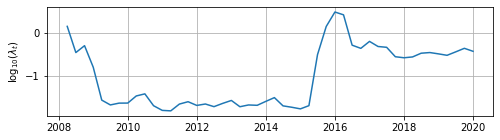

 EW:   0%|          | 0/48 [00:00<?, ?it/s]

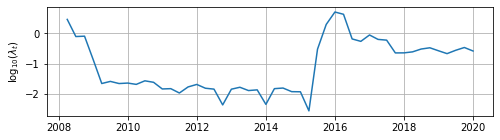

In [60]:
esnSingle_A_agg_ew_for_1sa_2007 = esnSingle_ew_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_ew_for_1sa_2007 = esnSingle_ew_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

In [57]:
def esnMulti_ew_fit_1sa(esnModel, Lambda, data, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    if retune:  Lambdas = []

    forecast_ew = np.zeros((len(GDP_data_test), 1))
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
            d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.iloc[[0],]
            d_data_test_j = d_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        #print(f"j = {j}")
        #print(f"{GDP_data_train_j.index[-1]} | {GDP_data_test_j.index[0]}")
        #print(f"{m_data_train_j.index[-1]} | {m_data_test_j.index[0]} -> {m_data_test_j.index[-1]}")
        #print(f"{d_data_train_j.index[-1]} | {d_data_test_j.index[0]} -> {d_data_test_j.index[-1]}")
        #print("-------------------------------")

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnMulti_for = esnModel.fixedParamsForecast(
            Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
            fit=esnMulti_fit
        )

        forecast_ew[j] = np.squeeze(esnMulti_for['Forecast'][0]['Y_for']) * sig_j + mu_j

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_ew, index=GDP_test_dates,)

 EW:   0%|          | 0/48 [00:00<?, ?it/s]

 EW:   0%|          | 0/48 [00:00<?, ?it/s]

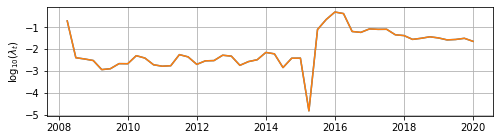

In [109]:
esnMulti_A_ew_for_1sa_2007 = esnMulti_ew_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

esnMulti_B_ew_for_1sa_2007 = esnMulti_ew_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

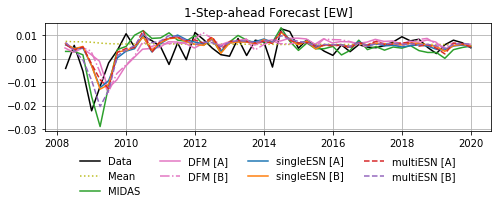

In [90]:
# Plot -- 1-Step-ahead Forecast
plt.figure(figsize=(8, 2))
plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_ew_1sa_forecast_2007, label="Mean", c="C8", ls=':')
#
plt.plot(MIDAS_ew_1sa_forecast_2007, label="MIDAS", c="C2")
#
plt.plot(DFM_A_ew_forecast_2007, label="DFM [A]", c="C6") 
plt.plot(DFM_B_ew_forecast_2007, label="DFM [B]", c="C6", ls='-.')  
#
plt.plot(esnSingle_A_agg_ew_for_1sa_2007, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_ew_for_1sa_2007, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_ew_for_1sa_2007, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_ew_for_1sa_2007, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_ew_2007.pdf'), bbox_inches="tight")
plt.show()

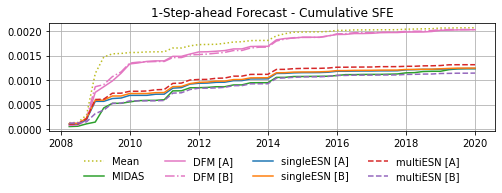

In [91]:
# Plot -- 1-Step-ahead Forecast - Cumulative SFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2007(UnMean_ew_1sa_forecast_2007), label="Mean", c="C8", ls=':')
#
plt.plot(cumulSFE_2007(MIDAS_ew_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2007(DFM_A_ew_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2007(DFM_B_ew_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulSFE_2007(esnSingle_A_agg_ew_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2007(esnSingle_B_agg_ew_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(cumulSFE_2007(esnMulti_A_ew_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulSFE_2007(esnMulti_B_ew_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
#plt.yscale('log')
plt.title("1-Step-ahead Forecast - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [92]:
MIDAS_MSE_ew_2007_td = MSFE_2007(MIDAS_ew_1sa_forecast_2007) * 1e4
UnMean_MSE_ew_2007_td = MSFE_2007(UnMean_ew_1sa_forecast_2007) * 1e4
DFM_A_MSE_ew_2007_td = MSFE_2007(DFM_A_ew_forecast_2007) * 1e4
DMF_B_MSE_ew_2007_td = MSFE_2007(DFM_B_ew_forecast_2007) * 1e4
esnSingle_A_MSE_ew_2007_td = MSFE_2007(esnSingle_A_agg_ew_for_1sa_2007) * 1e4
esnSingle_B_MSE_ew_2007_td = MSFE_2007(esnSingle_B_agg_ew_for_1sa_2007) * 1e4
esnMulti_A_MSE_ew_2007_td = MSFE_2007(esnMulti_A_ew_for_1sa_2007) * 1e4
esnMulti_B_MSE_ew_2007_td = MSFE_2007(esnMulti_B_ew_for_1sa_2007) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"MIDAS \t\t = {MIDAS_MSE_ew_2007_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_ew_2007_td).round(4)}")
print(f"Mean \t\t = {UnMean_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_ew_2007_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_ew_2007_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_ew_2007_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_ew_2007_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_ew_2007_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_ew_2007_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_ew_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_ew_2007_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
MIDAS 		 = 0.258 	|	0.5079
Mean 		 = 0.4325 	|	0.6577
DFM [A]		 = 0.4239 	|	0.6511
DFM [B]		 = 0.4249 	|	0.6518
singleESN [A]	 = 0.2581 	|	0.5081
singleESN [B]	 = 0.2602 	|	0.5101
multiESN [A]	 = 0.2747 	|	0.5241
multiESN [B]	 = 0.2389 	|	0.4888


In [93]:
ref_MSE_2007_ew = UnMean_MSE_ew_2007_td
MIDAS_MSE_toRef_2007_ew = MIDAS_MSE_ew_2007_td / ref_MSE_2007_ew
DFM_A_MSE_toRef_2007_ew = DFM_A_MSE_ew_2007_td / ref_MSE_2007_ew
DMF_B_MSE_toRef_2007_ew = DMF_B_MSE_ew_2007_td / ref_MSE_2007_ew
esnSingle_A_MSE_toRef_2007_ew = esnSingle_A_MSE_ew_2007_td / ref_MSE_2007_ew
esnSingle_B_MSE_toRef_2007_ew = esnSingle_B_MSE_ew_2007_td / ref_MSE_2007_ew
esnMulti_A_MSE_toRef_2007_ew = esnMulti_A_MSE_ew_2007_td / ref_MSE_2007_ew
esnMulti_B_MSE_toRef_2007_ew = esnMulti_B_MSE_ew_2007_td / ref_MSE_2007_ew

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2007_ew.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2007_ew.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2007_ew.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2007_ew.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2007_ew.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2007_ew.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2007_ew.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
MIDAS 		 = 0.5964
DFM [A]		 = 0.9801
DFM [B]		 = 0.9823
singleESN [A]	 = 0.5968
singleESN [B]	 = 0.6017
multiESN [A]	 = 0.6351
multiESN [B]	 = 0.5524


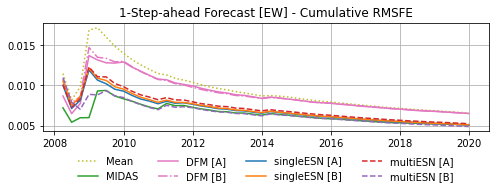

In [94]:
# Plot -- 1-Step-ahead Forecast - Cumulative RMSFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2007(UnMean_ew_1sa_forecast_2007), label="Mean", c="C8", ls=':')
#
plt.plot(cumulRMSFE_2007(MIDAS_ew_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2007(DFM_A_ew_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2007(DFM_B_ew_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2007(esnSingle_A_agg_ew_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2007(esnSingle_B_agg_ew_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(cumulRMSFE_2007(esnMulti_A_ew_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulRMSFE_2007(esnMulti_B_ew_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [EW] - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_ew_2007.pdf'), bbox_inches="tight")
plt.show()

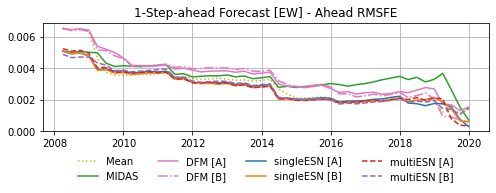

In [95]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2007(UnMean_ew_1sa_forecast_2007), label="Mean", c="C8", ls=':')
#
plt.plot(aheadRMSFE_2007(MIDAS_ew_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2007(DFM_A_ew_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2007(DFM_B_ew_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2007(esnSingle_A_agg_ew_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2007(esnSingle_B_agg_ew_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(aheadRMSFE_2007(esnMulti_A_ew_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(aheadRMSFE_2007(esnMulti_B_ew_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [EW] - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_ew_2007.pdf'), bbox_inches="tight")
plt.show()

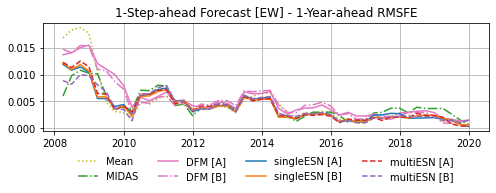

In [96]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2007(UnMean_ew_1sa_forecast_2007), label="Mean", c="C8", ls=':')
#
plt.plot(YA_RMSFE_2007(MIDAS_ew_1sa_forecast_2007), label="MIDAS", c="C2", ls='-.') 
#
plt.plot(YA_RMSFE_2007(DFM_A_ew_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2007(DFM_B_ew_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2007(esnSingle_A_agg_ew_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2007(esnSingle_B_agg_ew_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(YA_RMSFE_2007(esnMulti_A_ew_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(YA_RMSFE_2007(esnMulti_B_ew_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [EW] - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [314]:
mcs_data_2007_ew = pd.DataFrame(
    np.c_[UnMean_ew_1sa_forecast_2007,
        MIDAS_ew_1sa_forecast_2007, 
        DFM_A_ew_forecast_2007,
        DFM_B_ew_forecast_2007,
        esnSingle_A_agg_ew_for_1sa_2007,
        esnSingle_B_agg_ew_for_1sa_2007,
        esnMulti_A_ew_for_1sa_2007,
        esnMulti_B_ew_for_1sa_2007,
    ],
    columns=['Mean', 'MIDAS [EW]', 'DFM [A]', 'DFM [B]', 
                'singleESN [A] [EW]', 'singleESN [B] [EW]', 'multiESN [A] [EW]', 'multiESN [B] [EW]']
)
mcs_data_2007_ew = (mcs_data_2007_ew - dataset2007['GDP_data_test'].to_numpy())
#mcs_data_2007_ew = mcs_data_2007_ew.iloc[6:,:]

mcs_25_2007_ew = ModelConfidenceSet(
    data=np.square(mcs_data_2007_ew), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2007_ew = ModelConfidenceSet(
    data=np.square(mcs_data_2007_ew), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2007_ew.included}")
print(f"MCS 10 included: {mcs_10_2007_ew.included}")

MCS 25 included: ['Mean', 'multiESN [A] [EW]', 'singleESN [B] [EW]', 'MIDAS [EW]', 'singleESN [A] [EW]', 'multiESN [B] [EW]']
MCS 10 included: ['DFM [B]', 'DFM [A]', 'Mean', 'multiESN [A] [EW]', 'singleESN [B] [EW]', 'MIDAS [EW]', 'singleESN [A] [EW]', 'multiESN [B] [EW]']


In [315]:
mcs_25_2007_ew.pvalues

DFM [B]               0.2158
DFM [A]               0.2204
Mean                  0.6429
multiESN [A] [EW]     0.6429
singleESN [B] [EW]    0.9439
MIDAS [EW]            0.9439
singleESN [A] [EW]    0.9439
multiESN [B] [EW]     1.0000
dtype: float64

In [316]:
mcs_data_2007_ew.to_csv(
    os.path.join(path_folder, "R", "mcs_small_ew_2007.csv")
)

In [100]:
#mcs_data_2007_ew.plot(figsize=(12,4))
#plt.yscale('log')
#plt.legend(loc='center left', bbox_to_anchor=(1.01, 0.5))
#plt.grid()
#plt.show()

In [101]:
#print("Ljung-Box autocorrelation test [EW, 2007] - p-values (10 lags):")
#print(pd.DataFrame(
#    np.c_[LBtest_2007(MIDAS_1sa_forecast_2007)['lb_pvalue'],
#        LBtest_2007(DFM_A_forecast_2007)['lb_pvalue'],
#        LBtest_2007(DFM_B_forecast_2007)['lb_pvalue'],
#        LBtest_2007(esnSingle_A_for_1sa_2007)['lb_pvalue'],
#        LBtest_2007(esnSingle_B_for_1sa_2007)['lb_pvalue'],
#        LBtest_2007(esnMulti_A_for_1sa_2007)['lb_pvalue'],
#        LBtest_2007(esnMulti_B_for_1sa_2007)['lb_pvalue'],
#    ],
#    columns=['MIDAS', 'DFM [A]', 'DFM [B]', 'esnSingle [A]', 'esnSingle [B]', 'esnMulti [A]', 'esnMulti [B]'],
#    index=np.arange(1,8),
#))

##### Rolling Window

In [102]:
#DFM_A_rw_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1, 4, 12]_window__2007', 'q_test_12.csv'),
#    parse_dates = [0])
#DFM_A_rw_forecast.columns.values[0] = 'Date'
#DFM_A_rw_forecast_2007 = (DFM_A_rw_forecast.set_index('Date')[:'2019-12-31'])[['Q1_test_pred']]
#
#DFM_B_rw_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1, 4, 12]_window__2007', 'q_test_12.csv'),
#    parse_dates = [0])
#DFM_B_rw_forecast.columns.values[0] = 'Date'
#DFM_B_rw_forecast_2007 = (DFM_B_rw_forecast.set_index('Date')[:'2019-12-31'])[['Q1_test_pred']]

#DFM_A_rw_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1]_window__2007', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_A_rw_forecast_2007 = DFM_A_rw_forecast[['0']].loc[DFM_slice_2007,]
#
#DFM_B_rw_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1]_window__2007', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_B_rw_forecast_2007 = DFM_B_rw_forecast[['0']].loc[DFM_slice_2007,]

DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_rw_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_window__2007', date_slice=DFM_slice_2007,
)

DFM_B_rw_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_window__2007', date_slice=DFM_slice_2007,
)

In [103]:
def uncondMean_rw_1sa_Forecast(data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_rw = np.zeros((len(GDP_data_test), 1))
    for j in range(len(GDP_data_test)):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train.iloc[j:,],
                GDP_data_test.iloc[0:j,]
            ])
        else:
            GDP_data_train_j = GDP_data_train

        forecast_rw[j] = GDP_data_train_j.mean().iloc[0]

    return pd.DataFrame(data=forecast_rw, index=GDP_test_dates,)

In [104]:
UnMean_rw_1sa_forecast_2007 = uncondMean_rw_1sa_Forecast(
    data=dataset2007,
)

In [105]:
def MIDAS_rw_fit_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    forecast_rw = np.zeros((len(GDP_data_test), 1))
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
            ]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.loc[:GDP_test_dates[0],].iloc[1:,]
            d_data_test_j = d_data_test.loc[:GDP_test_dates[0],].iloc[1:,]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        #print(GDP_data_train_j.shape)
        #print(GDP_data_test_j.shape)
        #print(m_data_train_j.shape)
        #print(m_data_test_j.shape)
        #print(d_data_train_j.shape)
        #print(d_data_test_j.shape)

        # MIDAS data format
        GDP_data_midas_j = np.vstack((
            GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
        ))
        md_data_midas_j = (
            tuple(
                np.vstack((
                    m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                )) for s in m_data_train.columns
            ) +
            (np.vstack((
                d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
            )), )
        )

        MIDAS_fit = midasModel.fixedparamsForecast(
            data=(GDP_data_midas_j, md_data_midas_j),
            fit_length=len(GDP_data_train_j),
            steps=1,
            grad=True,
            method='L-BFGS-B',
            debug=False
        )

        #print(f"j = {j}")
        #print(MIDAS_fit['forecasts'][0]['Forecast'][0])
        #print("-------------------------------")

        forecast_rw[j] = np.squeeze(MIDAS_fit['forecasts'][0]['Forecast']) * sig_j + mu_j

    return pd.DataFrame(data=forecast_rw, index=GDP_test_dates,)

In [106]:
MIDAS_rw_1sa_forecast_2007 = MIDAS_rw_fit_1sa(
    midasModel=MIDAS_model, 
    data=dataset2007,
)

 RW:   0%|          | 0/48 [00:00<?, ?it/s]

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Ma

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: invalid value encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


In [107]:
## Expanding window
#MIDAS_rw_fit_1sa_2007 = RollingWindow(
#    model=MIDAS_model, 
#    length=len(dataset2007['GDP_data_train'])
#).rollingWindowForecast(
#    data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']), 
#    steps=1,
#    #spec={'grad': False, 'method': 'nls'},
#    spec={'grad': True, 'method': 'L-BFGS-B'},
#    debug=True
#)
#
#MIDAS_rw_1sa_forecast_2007 = pd.DataFrame(
#    data=np.array(
#        [MIDAS_rw_fit_1sa_2007['forecasts'][j][0]['Forecast'][0] 
#            for j in range(len(dataset2007['GDP_data_test']))]
#    ),
#    index=dataset2007['GDP_data_test'].index,
#)

In [108]:
def esnSingle_rw_fit_1sa(esnModel, Lambda, data, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index
    GDP_dates = GDP_fill_data_train.index.append(GDP_fill_data_test.index)

    if retune:  Lambdas = []

    forecast_rw = np.zeros((len(GDP_fill_data_test), 1))
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train,
                GDP_fill_data_test.iloc[0:j,]
            ]).iloc[j:,]
            md_fill_data_train_j = pd.concat([
                md_fill_data_train,
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            md_fill_data_train_j = md_fill_data_train_j[GDP_dates[j-1]:]
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
            md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
            md_fill_data_test_j = md_fill_data_test.iloc[[0],]

        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        #print(f"j = {j}")
        #print(f"{GDP_fill_data_train_j.index[-1]} | {GDP_fill_data_test_j.index[0]}")
        #print(f"{md_fill_data_train_j.index[-1]} | {md_fill_data_test_j.index[0]} -> {md_fill_data_test_j.index[-1]}")
        #print(f"{GDP_fill_data_train_j.index[0]} -> {GDP_fill_data_train_j.index[-1]}")
        #print(f"{md_fill_data_train_j.index[0]} -> {md_fill_data_train_j.index[-1]}")
        #print("-------------------------------")

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnSingle_for = esnModel.fixedParamsForecast(
            Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
            fit=esnSingle_fit
        )

        forecast_rw[j] = np.squeeze(esnSingle_for['Forecast'][0]['Y_for']) * sig_j + mu_j

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_rw, index=GDP_test_dates,)

 RW:   0%|          | 0/48 [00:00<?, ?it/s]

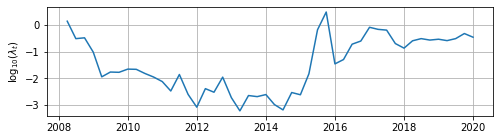

 RW:   0%|          | 0/48 [00:00<?, ?it/s]

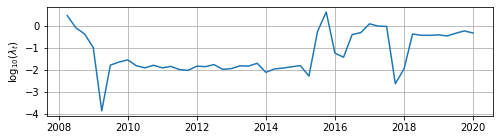

In [109]:
esnSingle_A_agg_rw_for_1sa_2007 = esnSingle_rw_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_rw_for_1sa_2007 = esnSingle_rw_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007,
    data=dataset2007,
    retune=True,
    aggregate=True,
)

In [110]:
def esnMulti_rw_fit_1sa(esnModel, Lambda, data, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    if retune:  Lambdas = []

    forecast_rw = np.zeros((len(GDP_data_test), 1))
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            m_data_train_j = m_data_train_j[GDP_dates[j-1]:]
            d_data_train_j = d_data_train_j[GDP_dates[j-1]:]
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
            d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.iloc[[0],]
            d_data_test_j = d_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        #print(f"j = {j}")
        #print(f"{GDP_data_train_j.index[-1]} | {GDP_data_test_j.index[0]}")
        #print(f"{m_data_train_j.index[-1]} | {m_data_test_j.index[0]} -> {m_data_test_j.index[-1]}")
        #print(f"{d_data_train_j.index[-1]} | {d_data_test_j.index[0]} -> {d_data_test_j.index[-1]}")
        #print(f"{GDP_data_train_j.index[0]} -> {GDP_data_train_j.index[-1]}")
        #print(f"{m_data_train_j.index[0]} -> {m_data_train_j.index[-1]}")
        #print(f"{d_data_train_j.index[0]} -> {d_data_train_j.index[-1]}")
        #print("-------------------------------")

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnMulti_for = esnModel.fixedParamsForecast(
            Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
            fit=esnMulti_fit
        )

        forecast_rw[j] = np.squeeze(esnMulti_for['Forecast'][0]['Y_for']) * sig_j + mu_j

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_rw, index=GDP_test_dates,)

 RW:   0%|          | 0/48 [00:00<?, ?it/s]

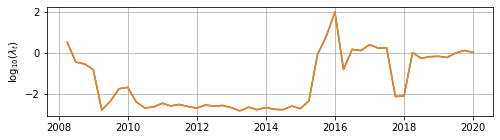

 RW:   0%|          | 0/48 [00:00<?, ?it/s]

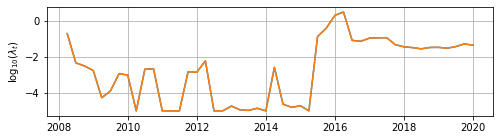

In [111]:
esnMulti_A_rw_for_1sa_2007 = esnMulti_rw_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

esnMulti_B_rw_for_1sa_2007 = esnMulti_rw_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

In [112]:
#plt.figure(figsize=(5,3))
#plt.hist(dataset2007['GDP_data_test'].to_numpy() - DFM_A_rw_forecast_2007.to_numpy(),
#    label="DFM [A]")
#plt.legend()
#plt.show()
#
#plt.figure(figsize=(5,3))
#plt.hist(dataset2007['GDP_data_test'].to_numpy() - DFM_B_rw_forecast_2007.to_numpy(),
#    label="DFM [B]")
#plt.legend()
#plt.show()
#
#plt.figure(figsize=(5,3))
#plt.hist(dataset2007['GDP_data_test'].to_numpy() - esnMulti_B_rw_for_1sa_2007.to_numpy(),
#    label="multiESN [B]")
#plt.legend()
#plt.show()

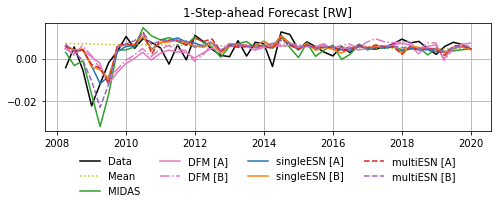

In [113]:
# Plot -- 1-Step-ahead Forecast
plt.figure(figsize=(8, 2))
plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_rw_1sa_forecast_2007, label="Mean", c="C8", ls=':')
#
plt.plot(MIDAS_rw_1sa_forecast_2007, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_rw_forecast_2007, label="DFM [A]", c="C6") 
plt.plot(DFM_B_rw_forecast_2007, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_rw_for_1sa_2007, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_rw_for_1sa_2007, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_rw_for_1sa_2007, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_rw_for_1sa_2007, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_rw_2007.pdf'), bbox_inches="tight")
plt.show()

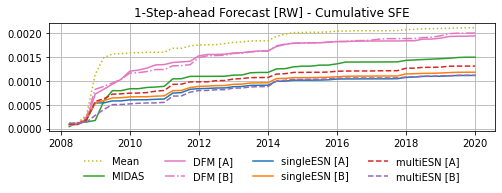

In [114]:
# Plot -- 1-Step-ahead Forecast - Cumulative SFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2007(UnMean_rw_1sa_forecast_2007), label="Mean", c="C8", ls=':')
#
plt.plot(cumulSFE_2007(MIDAS_rw_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2007(DFM_A_rw_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2007(DFM_B_rw_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulSFE_2007(esnSingle_A_agg_rw_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2007(esnSingle_B_agg_rw_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(cumulSFE_2007(esnMulti_A_rw_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulSFE_2007(esnMulti_B_rw_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
#plt.yscale('log')
plt.title("1-Step-ahead Forecast [RW] - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [115]:
MIDAS_MSE_rw_2007_td = MSFE_2007(MIDAS_rw_1sa_forecast_2007) * 1e4
UnMean_MSE_rw_2007_td = MSFE_2007(UnMean_rw_1sa_forecast_2007) * 1e4
DFM_A_MSE_rw_2007_td = MSFE_2007(DFM_A_rw_forecast_2007) * 1e4
DMF_B_MSE_rw_2007_td = MSFE_2007(DFM_B_rw_forecast_2007) * 1e4
esnSingle_A_MSE_rw_2007_td = MSFE_2007(esnSingle_A_agg_rw_for_1sa_2007) * 1e4
esnSingle_B_MSE_rw_2007_td = MSFE_2007(esnSingle_B_agg_rw_for_1sa_2007) * 1e4
esnMulti_A_MSE_rw_2007_td = MSFE_2007(esnMulti_A_rw_for_1sa_2007) * 1e4
esnMulti_B_MSE_rw_2007_td = MSFE_2007(esnMulti_B_rw_for_1sa_2007) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"MIDAS \t\t = {MIDAS_MSE_rw_2007_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_rw_2007_td).round(4)}")
print(f"Mean \t\t = {UnMean_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_rw_2007_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_rw_2007_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_rw_2007_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_rw_2007_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_rw_2007_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_rw_2007_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_rw_2007_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_rw_2007_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
MIDAS 		 = 0.3122 	|	0.5588
Mean 		 = 0.4404 	|	0.6637
DFM [A]		 = 0.405 	|	0.6364
DFM [B]		 = 0.4173 	|	0.646
singleESN [A]	 = 0.2331 	|	0.4828
singleESN [B]	 = 0.247 	|	0.497
multiESN [A]	 = 0.2737 	|	0.5231
multiESN [B]	 = 0.2336 	|	0.4833


In [116]:
ref_MSE_2007_rw = UnMean_MSE_rw_2007_td
MIDAS_MSE_toRef_2007_rw = MIDAS_MSE_rw_2007_td / ref_MSE_2007_rw
DFM_A_MSE_toRef_2007_rw = DFM_A_MSE_rw_2007_td / ref_MSE_2007_rw
DMF_B_MSE_toRef_2007_rw = DMF_B_MSE_rw_2007_td / ref_MSE_2007_rw
esnSingle_A_MSE_toRef_2007_rw = esnSingle_A_MSE_rw_2007_td / ref_MSE_2007_rw
esnSingle_B_MSE_toRef_2007_rw = esnSingle_B_MSE_rw_2007_td / ref_MSE_2007_rw
esnMulti_A_MSE_toRef_2007_rw = esnMulti_A_MSE_rw_2007_td / ref_MSE_2007_rw
esnMulti_B_MSE_toRef_2007_rw = esnMulti_B_MSE_rw_2007_td / ref_MSE_2007_rw

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2007_rw.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2007_rw.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2007_rw.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2007_rw.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2007_rw.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2007_rw.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2007_rw.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
MIDAS 		 = 0.7089
DFM [A]		 = 0.9194
DFM [B]		 = 0.9475
singleESN [A]	 = 0.5292
singleESN [B]	 = 0.5607
multiESN [A]	 = 0.6213
multiESN [B]	 = 0.5303


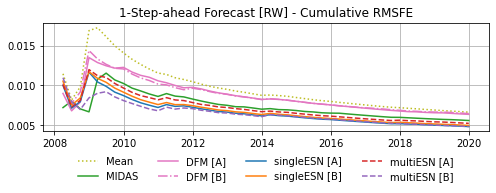

In [117]:
# Plot -- 1-Step-ahead Forecast - Cumulative RMSFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2007(UnMean_rw_1sa_forecast_2007), label="Mean", c="C8", ls=':')
#
plt.plot(cumulRMSFE_2007(MIDAS_rw_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2007(DFM_A_rw_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2007(DFM_B_rw_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2007(esnSingle_A_agg_rw_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2007(esnSingle_B_agg_rw_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(cumulRMSFE_2007(esnMulti_A_rw_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulRMSFE_2007(esnMulti_B_rw_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_rw_2007.pdf'), bbox_inches="tight")
plt.show()

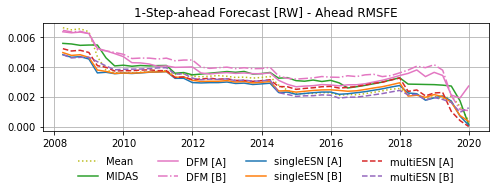

In [118]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2007(UnMean_rw_1sa_forecast_2007), label="Mean", c="C8", ls=':')
#
plt.plot(aheadRMSFE_2007(MIDAS_rw_1sa_forecast_2007), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2007(DFM_A_rw_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2007(DFM_B_rw_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2007(esnSingle_A_agg_rw_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2007(esnSingle_B_agg_rw_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(aheadRMSFE_2007(esnMulti_A_rw_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(aheadRMSFE_2007(esnMulti_B_rw_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_rw_2007.pdf'), bbox_inches="tight")
plt.show()

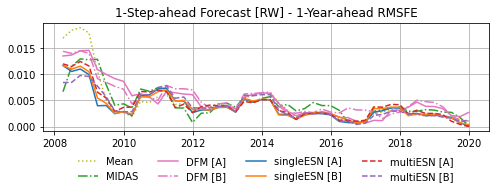

In [119]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2007(UnMean_rw_1sa_forecast_2007), label="Mean", c="C8", ls=':')
#
plt.plot(YA_RMSFE_2007(MIDAS_rw_1sa_forecast_2007), label="MIDAS", c="C2", ls='-.') 
#
plt.plot(YA_RMSFE_2007(DFM_A_rw_forecast_2007), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2007(DFM_B_rw_forecast_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2007(esnSingle_A_agg_rw_for_1sa_2007), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2007(esnSingle_B_agg_rw_for_1sa_2007), label="singleESN [B]", c="C1") 
#
plt.plot(YA_RMSFE_2007(esnMulti_A_rw_for_1sa_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(YA_RMSFE_2007(esnMulti_B_rw_for_1sa_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [317]:
mcs_data_2007_rw = pd.DataFrame(
    np.c_[UnMean_rw_1sa_forecast_2007,
        MIDAS_rw_1sa_forecast_2007,
        DFM_A_rw_forecast_2007,
        DFM_B_rw_forecast_2007,
        esnSingle_A_agg_rw_for_1sa_2007,
        esnSingle_B_agg_rw_for_1sa_2007,
        esnMulti_A_rw_for_1sa_2007,
        esnMulti_B_rw_for_1sa_2007,
    ],
    columns=['Mean', 'MIDAS [RW]', 'DFM [A]', 'DFM [B]', 
                'singleESN [A] [RW]', 'singleESN [B] [RW]', 'multiESN [A] [RW]', 'multiESN [B] [RW]']
)
mcs_data_2007_rw = (mcs_data_2007_rw - dataset2007['GDP_data_test'].to_numpy())

mcs_25_2007_rw = ModelConfidenceSet(
    data=np.square(mcs_data_2007_rw), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2007_rw = ModelConfidenceSet(
    data=np.square(mcs_data_2007_rw), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2007_rw.included}")
print(f"MCS 10 included: {mcs_10_2007_rw.included}")

MCS 25 included: ['Mean', 'MIDAS [RW]', 'multiESN [A] [RW]', 'singleESN [B] [RW]', 'multiESN [B] [RW]', 'singleESN [A] [RW]']
MCS 10 included: ['DFM [A]', 'Mean', 'MIDAS [RW]', 'multiESN [A] [RW]', 'singleESN [B] [RW]', 'multiESN [B] [RW]', 'singleESN [A] [RW]']


In [318]:
mcs_25_2007_rw.pvalues

DFM [B]               0.0720
DFM [A]               0.1756
Mean                  0.2677
MIDAS [RW]            0.2677
multiESN [A] [RW]     0.2677
singleESN [B] [RW]    0.3982
multiESN [B] [RW]     0.9927
singleESN [A] [RW]    1.0000
dtype: float64

In [319]:
mcs_data_2007_rw.to_csv(
    os.path.join(path_folder, "R", "mcs_small_rw_2007.csv")
)

In [123]:
# Check boostrap code
#from numpy.random import rand
#
#def bootstrap_sample(data, B, w):
#    '''
#    Bootstrap the input data
#    data: input numpy data array
#    B: boostrap size
#    w: block length of the boostrap
#    '''
#    t = len(data)
#    p = 1 / w
#    indices = np.zeros((t, B), dtype=int)
#    indices[0, :] = np.ceil(t * rand(1, B))
#    select = np.asfortranarray(rand(B, t).T < p)
#    vals = np.ceil(rand(1, np.sum(np.sum(select))) * t).astype(int)
#    indices_flat = indices.ravel(order="F")
#    indices_flat[select.ravel(order="F")] = vals.ravel()
#    indices = indices_flat.reshape([B, t]).T
#    for i in range(1, t):
#        indices[i, ~select[i, :]] = indices[i - 1, ~select[i, :]] + 1
#    indices[indices > t] = indices[indices > t] - t
#    indices -= 1
#    return data[indices]
#
#B___ = bootstrap_sample(np.arange(1, 10), B=10000, w=3)
#
#plt.hist(B___.ravel(), bins=range(1,11))
#plt.show()

#plt.hist(mcs_data_2007_rw['DFM [A]'].to_numpy().squeeze(), bins=200, density=True)
#plt.grid()
#plt.show()
#
#plt.hist(bootstrap_sample(
#    data=mcs_data_2007_rw['DFM [A]'].to_numpy().squeeze(),
#    B=10000, w=2,
#).reshape((-1)), bins=200, density=True)
#plt.grid()
#plt.show()

In [124]:
#def bootstrap_sample_new(data, B=1, w=1, seed=None):
#    '''
#    Bootstrap the input data
#    data: input numpy data array
#    B: boostrap size
#    w: block length of the boostrap
#    '''
#    # NOTE: the following implementation mostly
#    # follows Kunsch (1989), AoS
#    N = len(data)
#    n = N - w + 1
#    k = np.ceil(N / w).astype(int)
#    # Set seed
#    if not seed is None:
#        rng = np.random.default_rng(seed)
#    else:
#        rng = np.random.default_rng()
#    block_indices = rng.integers(low=0, high=n, size=(k, B))
#    indices = np.zeros((N, B), dtype=int)
#    for b in range(B):
#        indx_b = np.array(
#            [np.arange(i, i+w) for i in block_indices[:, b]]
#        ).ravel()
#        indices[:, b] = indx_b[0:N]
#    return data[indices]    
#
#    #t = len(data)
#    #p = 1 / w
#    #indices = np.zeros((t, B), dtype=int)
#    #indices[0, :] = np.ceil(t * rand(1, B))
#    #select = np.asfortranarray(rand(B, t).T < p)
#    #vals = np.ceil(rand(1, np.sum(np.sum(select))) * t).astype(int)
#    #indices_flat = indices.ravel(order="F")
#    #indices_flat[select.ravel(order="F")] = vals.ravel()
#    #indices = indices_flat.reshape([B, t]).T
#    #for i in range(1, t):
#    #    indices[i, ~select[i, :]] = indices[i - 1, ~select[i, :]] + 1
#    #indices[indices > t] = indices[indices > t] - t
#    #indices -= 1
#    #return data[indices]
#
#B___ = bootstrap_sample_new(np.arange(1, 10), B=10, w=4)
#print(np.tile(np.arange(1, 10), (6, 1)).T)
#print("---")
#np.tile(np.arange(1, 10), (6, 1)).T[[[1, 2, 0], [1, 3, 4]], :]

#plt.hist(B___.ravel(), bins=range(1,11))
#plt.show()

In [125]:
#np.tensordot(
#    np.ones((1, 6)),
#    np.tile(np.tile(np.arange(1, 11), (6, 1))[:, :, np.newaxis], (1, 1, 3)),
#    axes=([1], [0])
#).shape

In [126]:
#included_M = np.arange(10, dtype=int)
#excluded_M = [3, 8, 9, 11, 20]
#
#np.setdiff1d(included_M, excluded_M)

In [127]:
#from MultiHorizonMCS import MultiHorizonMCS
#import xarray as xr
#
#da = xr.DataArray(
#    data=np.random.random((2, 50, 3))**2,
#    dims=["H", "T", "M0"],
#    attrs=dict(
#        names=["Model1", "Model2", "Model3"]
#    )
#)
#
#res = MultiHorizonMCS(data=da, method="uSPA", alpha=0.1, B=100, w=2, seed=98923589).run()
#res.pvalues

In [128]:
#import statsmodels.api as sm 
#
#for c in mcs_data_2007_rw.columns:
#    sm.graphics.tsa.plot_pacf(
#        mcs_data_2007_rw[c].to_numpy().squeeze(), 
#        lags=10, method="yw",
#        title=c + " - residuals^2",
#    )

##### Tests

In [129]:
#JBtest_MIDAS_fit_1sa_2007 = jarque_bera(MIDAS_fit_1sa_2007['parsfit_for'][0]['Residuals'])
#JBtest_esnSingle_A_fit_1sa_2007 = jarque_bera(esnSingle_A_fit_1sa_2007['fit_for'][0]['Residuals'])
#JBtest_esnSingle_B_fit_1sa_2007 = jarque_bera(esnSingle_B_fit_1sa_2007['fit_for'][0]['Residuals'])
#JBtest_esnMulti_A_fit_1sa_2007 = jarque_bera(esnMulti_A_fit_1sa_2007['fit_for'][0]['Residuals'])
#JBtest_esnMulti_B_fit_1sa_2007 = jarque_bera(esnMulti_B_fit_1sa_2007['fit_for'][0]['Residuals'])
#
#print("Jarque-Bera normality test - fit residuals:")
#print(tabulate([
#    ["MIDAS", JBtest_MIDAS_fit_1sa_2007[0], JBtest_MIDAS_fit_1sa_2007[1]],
#    ["esnSingle [A]", JBtest_esnSingle_A_fit_1sa_2007[0], JBtest_esnSingle_A_fit_1sa_2007[1]],
#    ["esnSingle [B]", JBtest_esnSingle_B_fit_1sa_2007[0], JBtest_esnSingle_B_fit_1sa_2007[1]],
#    ["esnMulti [A]", JBtest_esnMulti_A_fit_1sa_2007[0], JBtest_esnMulti_A_fit_1sa_2007[1]],
#    ["esnMulti [B]", JBtest_esnMulti_B_fit_1sa_2007[0], JBtest_esnMulti_B_fit_1sa_2007[1]],
#], headers=["Model", "Jarque-Bera stat", "p-value"],))

In [130]:
#LBtest_MIDAS_fit_1sa_2007 = acorr_ljungbox(MIDAS_fit_1sa_2007['parsfit_for'][0]['Residuals'])
#LBtest_esnSingle_A_fit_1sa_2007 = acorr_ljungbox(esnSingle_A_fit_1sa_2007['fit_for'][0]['Residuals'])
#LBtest_esnSingle_B_fit_1sa_2007 = acorr_ljungbox(esnSingle_B_fit_1sa_2007['fit_for'][0]['Residuals'])
#LBtest_esnMulti_A_fit_1sa_2007 = acorr_ljungbox(esnMulti_A_fit_1sa_2007['fit_for'][0]['Residuals'])
#LBtest_esnMulti_B_fit_1sa_2007 = acorr_ljungbox(esnMulti_B_fit_1sa_2007['fit_for'][0]['Residuals'])
#
#print("Ljung-Box autocorrelation test - p-values (10 lags):")
#print(pd.DataFrame(
#    np.c_[LBtest_MIDAS_fit_1sa_2007['lb_pvalue'],
#        LBtest_esnSingle_A_fit_1sa_2007['lb_pvalue'],
#        LBtest_esnSingle_B_fit_1sa_2007['lb_pvalue'],
#        LBtest_esnMulti_A_fit_1sa_2007['lb_pvalue'],
#        LBtest_esnMulti_B_fit_1sa_2007['lb_pvalue'],
#    ],
#    columns=['MIDAS', 'esnSingle [A]', 'esnSingle [B]', 'esnMulti [A]', 'esnMulti [B]'],
#    index=np.arange(1,11),
#))

#### 1-step Ahead High-Frequency Forecast Comparison

##### Fixed Parameters

In [100]:
DFM_A_fix_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_fixed__2007', 
)
DFM_A_fix_highfreq_forecast_2007 = DFM_A_fix_highfreq_forecast_2007.loc[
    (DFM_A_fix_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_A_fix_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_fix_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_fixed__2007',
)
DFM_B_fix_highfreq_forecast_2007 = DFM_B_fix_highfreq_forecast_2007.loc[
    (DFM_B_fix_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_B_fix_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_fix_highfreq_forecast_2007.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_fix_highfreq_forecast_2007.index = DFM_index_for[1:]
DFM_B_fix_highfreq_forecast_2007.index = DFM_index_for[1:]

# Final filtering
DFM_A_fix_highfreq_forecast_2007 = DFM_A_fix_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]
DFM_B_fix_highfreq_forecast_2007 = DFM_B_fix_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]

In [101]:
def MIDAS_fix_fit_highfreq_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    # Normalize
    # NOTE: if adding normalization here, makes sure models forecasts are 
    #       properly adjusted and comparable
    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test, 
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    # MIDAS data format
    GDP_data_midas = np.vstack((
        GDP_data_train.to_numpy(), 
        GDP_data_test.to_numpy()
    ))
    md_data_midas = (
        tuple(
            np.vstack((
                m_data_train[s].to_numpy()[:,None], 
                m_data_test[s].loc[(GDP_data_train.index[-1] + pd.offsets.Day()):].to_numpy()[:,None]
            )) for s in m_data_train.columns
        ) +
        (np.vstack((
            d_data_train.to_numpy(), 
            d_data_test.loc[(GDP_data_train.index[-1] + pd.offsets.Day()):].to_numpy()
        )), )
    )

    # Fit
    MIDAS_fit = midasModel.fixedparamsHighFreqForecast(
        data=(GDP_data_midas, md_data_midas),
        fit_length=len(GDP_data_train),
        steps=1,
        grad=True,
        method='L-BFGS-B',
        debug=False
    )

    #midasModel.plotPhi(MIDAS_fit, figsize=(12, 2))

    # NOTE: build high-freq forecast index *manually*
    #       (here easier than programmatically)
    index_for = GDP_test_dates[[0]]
    for m in pd.date_range(GDP_test_dates[0]+pd.offsets.Day(1), GDP_test_dates[-1], freq="M"):
        index_for = index_for.union(pd.date_range(
            m - pd.offsets.Day(23), m,
        ))

    # Compute pointwise forecasts
    MIDAS_fix_forecast = pd.DataFrame(
        data=(MIDAS_fit['forecasts'][0]['Forecast'] * 
            GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()), 
        #index=GDP_test_dates[[0]].union(
        #    d_test_dates[d_test_dates > GDP_test_dates[0]]
        #),
        index=index_for,
    )

    return MIDAS_fix_forecast

In [102]:
MIDAS_fix_for_highfreq_1sa_2007 = MIDAS_fix_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2007,
)

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


In [103]:
def esnSingle_fix_fit_highfreq_1sa(esnModel, Lambda, data, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    #GDP_test_dates = GDP_fill_data_test.index

    GDP_fill_data_train, GDP_fill_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_fill_data_train, GDP_fill_data_test,
            return_mu_sig=True)
    )
    md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)

    esnSingle_fit = esnModel.fit(
        Y=GDP_fill_data_train, z=(md_fill_data_train, ), 
        method='ridge',
        Lambda=Lambda,
        full=False,
        debug=False,
    )

    esnSingle_hf_for = esnModel.fixedParamsHighFreqForecast(
        Yf=GDP_fill_data_test, zf=(md_fill_data_test,), 
        fit=esnSingle_fit
    )

    # Compute pointwise forecasts
    esnSingle_fix_hf_forecast = (esnSingle_hf_for['highFrequencyForecast'][0]['Y_for'] * 
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy())
    target_hf = (esnSingle_hf_for['highFrequencyForecast'][0]['Y'] *
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()
    )

    return {"hf_forecast": esnSingle_fix_hf_forecast, "hf_target": target_hf}

In [104]:
esnSingle_A_agg_fix_highfreq_for_1sa_2007 = esnSingle_fix_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    aggregate=True,
)

esnSingle_B_agg_fix_highfreq_for_1sa_2007 = esnSingle_fix_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    aggregate=True,
)

In [105]:
def esnMulti_fix_fit_highfreq_1sa(esnModel, Lambda, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    #GDP_test_dates = GDP_data_test.index

    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test,
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    esnMulti_fit = esnModel.fit(
        Y=GDP_data_train, z=(m_data_train, d_data_train), 
        method='ridge',
        Lambda=Lambda,
        full=False,
        debug=False,
    )

    esnMulti_hf_for = esnModel.fixedParamsHighFreqForecast(
        Yf=GDP_data_test, zf=(m_data_test, d_data_test), 
        fit=esnMulti_fit
    )

    # Compute pointwise forecasts
    esnMulti_fix_hf_forecast = (esnMulti_hf_for['highFrequencyForecast'][0]['Y_for'] * 
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy())
    target_hf = (esnMulti_hf_for['highFrequencyForecast'][0]['Y'] *
        GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()
    )

    return {"hf_forecast": esnMulti_fix_hf_forecast, "hf_target": target_hf}

In [106]:
esnMulti_A_fix_highfreq_for_1sa_2007 = esnMulti_fix_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
)

esnMulti_B_fix_highfreq_for_1sa_2007 = esnMulti_fix_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
)

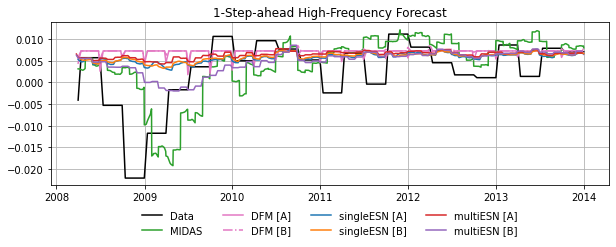

In [107]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_fix_highfreq_for_1sa_2007["hf_target"].loc[:"2013"], c='k', label="Data")
#
plt.plot(MIDAS_fix_for_highfreq_1sa_2007.loc[:"2013"], label="MIDAS", c="C2") 
#
plt.plot(DFM_A_fix_highfreq_forecast_2007.loc[:"2013"], label="DFM [A]", c="C6") 
plt.plot(DFM_B_fix_highfreq_forecast_2007.loc[:"2013"], label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_fix_highfreq_for_1sa_2007["hf_forecast"].loc[:"2013"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_fix_highfreq_for_1sa_2007["hf_forecast"].loc[:"2013"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_fix_highfreq_for_1sa_2007["hf_forecast"].loc[:"2013"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_fix_highfreq_for_1sa_2007["hf_forecast"].loc[:"2013"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_fix_2007.pdf'), bbox_inches="tight")
plt.show()

##### Expanding Window

In [82]:
DFM_A_ew_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_expanding__2007', 
)
DFM_A_ew_highfreq_forecast_2007 = DFM_A_ew_highfreq_forecast_2007.loc[
    (DFM_A_ew_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_A_ew_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_ew_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_expanding__2007',
)
DFM_B_ew_highfreq_forecast_2007 = DFM_B_ew_highfreq_forecast_2007.loc[
    (DFM_B_ew_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_B_ew_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_ew_highfreq_forecast_2007.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_ew_highfreq_forecast_2007.index = DFM_index_for[1:]
DFM_B_ew_highfreq_forecast_2007.index = DFM_index_for[1:]

# Final filtering
DFM_A_ew_highfreq_forecast_2007 = DFM_A_ew_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]
DFM_B_ew_highfreq_forecast_2007 = DFM_B_ew_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]

In [83]:
def MIDAS_ew_fit_highfreq_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_hf_ew = []
    #target_hf_ew = []
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train

        if j == 0:
            GDP_data_test_j = GDP_data_test.iloc[[0,1],]
            m_data_test_j = m_data_test.loc[:GDP_test_dates[1],].iloc[1:,]
            d_data_test_j = d_data_test.loc[:GDP_test_dates[1],].iloc[1:,]
        elif j < (len(GDP_data_test) - 1):
            GDP_data_test_j = GDP_data_test.iloc[[j,j+1],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j+1],
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j+1],
            ]
        else:
            GDP_data_test_j = GDP_data_test.iloc[[-1],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[-1]
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[-1]
            ]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        print(f"j = {j}")

        # MIDAS data format
        GDP_data_midas_j = np.vstack((
            GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
        ))
        md_data_midas_j = (
            tuple(
                np.vstack((
                    m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                )) for s in m_data_train.columns
            ) +
            (np.vstack((
                d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
            )), )
        )

        MIDAS_fit = midasModel.fixedparamsHighFreqForecast(
            data=(GDP_data_midas_j, md_data_midas_j),
            fit_length=len(GDP_data_train_j),
            steps=1,
            grad=True,
            method='L-BFGS-B',
            debug=False
        )

        # NOTE: build high-freq forecast index *manually*
        #       (here easier than programmatically)
        index_for_j = GDP_data_test_j.index[[0]]
        for m in pd.date_range(GDP_data_test_j.index[0]+pd.offsets.Day(1), GDP_data_test_j.index[-1], freq="M"):
            index_for_j = index_for_j.union(pd.date_range(
                m - pd.offsets.Day(23), m,
            ))
        index_for_j = index_for_j[:-1]

        #print(index_for_j)

        # Compute pointwise forecasts
        MIDAS_fix_forecast = pd.DataFrame(
            data=(MIDAS_fit['forecasts'][0]['Forecast'][:-1] * sig_j.to_numpy() + mu_j.to_numpy()), 
            index=index_for_j,
        )
        forecast_hf_ew.append(MIDAS_fix_forecast)

    forecast_hf_ew = pd.concat(forecast_hf_ew)

    return forecast_hf_ew

In [84]:
MIDAS_ew_for_highfreq_1sa_2007 = MIDAS_ew_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2007,
)

j = 0
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 1
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 2
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 3
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 4
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 5
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))



j = 6
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 7
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 8
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 9
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 10
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\n

j = 11
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
j = 12
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:693: RuntimeWarning: invalid value encountered in matmul
  G1 = (Zt[for_zslices[i],0:p]).T @ c
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:694: RuntimeWarning: invalid value encountered in matmul
  D  = (Zt[for_zslices[i],p:]).T @ c
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value en

j = 13
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 14
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 15
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 16
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 17
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 18
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 19
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 20
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 21
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 22
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 23
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 24
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 25
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 26
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 27
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 28
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 29
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 30
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 31
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 32
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 33
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 34
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 35
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 36
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 37
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

j = 38
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 39
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 40
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 41
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 42
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 43
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 44
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 45
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 46
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 47
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


In [85]:
def esnSingle_ew_fit_highfreq_1sa(esnModel, Lambda, data, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index

    if retune:  Lambdas = []

    forecast_hf_ew = []
    target_hf_ew = []
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train, 
                GDP_fill_data_test.iloc[0:j,]
            ])
            md_fill_data_train_j = pd.concat([
                md_fill_data_train, 
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train

        if j < (len(GDP_fill_data_test) - 1):
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j,j+1],]
            md_fill_data_test_j = md_fill_data_test.loc[md_fill_data_train_j.index[-1]:GDP_test_dates[j+1]]
        else:
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[-1],]
            md_fill_data_test_j = md_fill_data_test.loc[md_fill_data_train_j.index[-1]:GDP_test_dates[-1]]

        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnSingle_hf_for = esnModel.fixedParamsHighFreqForecast(
            Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
            fit=esnSingle_fit
        )

        forecast_hf_ew.append(
            esnSingle_hf_for['highFrequencyForecast'][0]['Y_for'] * sig_j.to_numpy() + mu_j.to_numpy()
        )
        target_hf_ew.append(
            esnSingle_hf_for['highFrequencyForecast'][0]['Y'] * sig_j.to_numpy() + mu_j.to_numpy()
        )

    forecast_hf_ew = pd.concat(forecast_hf_ew)
    target_hf_ew = pd.concat(target_hf_ew)

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return {"hf_ew_forecast": forecast_hf_ew, "hf_target": target_hf_ew}

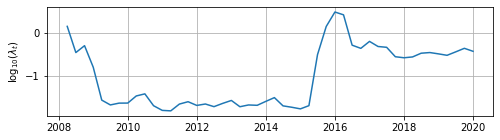

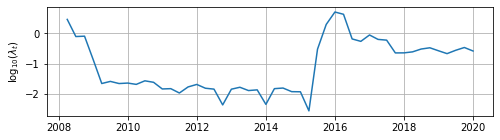

In [86]:
esnSingle_A_agg_ew_highfreq_for_1sa_2007 = esnSingle_ew_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_ew_highfreq_for_1sa_2007 = esnSingle_ew_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

In [88]:
def esnMulti_ew_fit_highfreq_1sa(esnModel, Lambda, data, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    if retune:  Lambdas = []

    forecast_hf_ew = []
    target_hf_ew = []
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train

        if j < (len(GDP_data_test) - 1):
            GDP_data_test_j = GDP_data_test.iloc[[j,j+1],]
            m_data_test_j = m_data_test.loc[m_data_train_j.index[-1]:GDP_test_dates[j+1]]
            d_data_test_j = d_data_test.loc[d_data_train_j.index[-1]:GDP_test_dates[j+1]]
        else:
            GDP_data_test_j = GDP_data_test.iloc[[-1],]
            m_data_test_j = m_data_test.loc[m_data_train_j.index[-1]:GDP_test_dates[-1]]
            d_data_test_j = d_data_test.loc[d_data_train_j.index[-1]:GDP_test_dates[-1]]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnMulti_hf_for = esnModel.fixedParamsHighFreqForecast(
            Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
            fit=esnMulti_fit
        )

        forecast_hf_ew.append(
            esnMulti_hf_for['highFrequencyForecast'][0]['Y_for'] * sig_j.to_numpy() + mu_j.to_numpy()
        )
        target_hf_ew.append(
            esnMulti_hf_for['highFrequencyForecast'][0]['Y'] * sig_j.to_numpy() + mu_j.to_numpy()
        )

    forecast_hf_ew = pd.concat(forecast_hf_ew)
    target_hf_ew = pd.concat(target_hf_ew)

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return {"hf_ew_forecast": forecast_hf_ew, "hf_target": target_hf_ew}

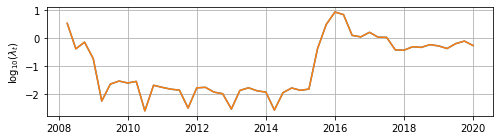

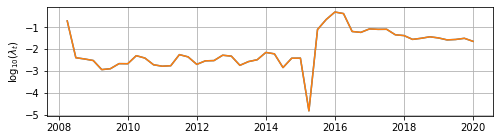

In [89]:
esnMulti_A_ew_highfreq_for_1sa_2007 = esnMulti_ew_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

esnMulti_B_ew_highfreq_for_1sa_2007 = esnMulti_ew_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

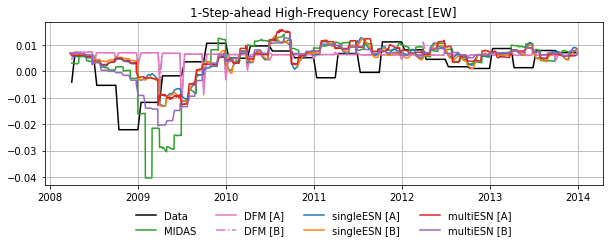

In [93]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_ew_highfreq_for_1sa_2007["hf_target"].loc[:"2013"], c='k', label="Data")
#
plt.plot(MIDAS_ew_for_highfreq_1sa_2007.loc[:"2013"], label="MIDAS", c="C2") 
#
plt.plot(DFM_A_ew_highfreq_forecast_2007.loc[:"2013"], label="DFM [A]", c="C6") 
plt.plot(DFM_B_ew_highfreq_forecast_2007.loc[:"2013"], label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_ew_highfreq_for_1sa_2007["hf_ew_forecast"].loc[:"2013"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_ew_highfreq_for_1sa_2007["hf_ew_forecast"].loc[:"2013"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_ew_highfreq_for_1sa_2007["hf_ew_forecast"].loc[:"2013"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_ew_highfreq_for_1sa_2007["hf_ew_forecast"].loc[:"2013"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_ew_2007.pdf'), bbox_inches="tight")
plt.show()

##### Rolling Window

In [76]:
DFM_A_rw_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_window__2007', 
)
DFM_A_rw_highfreq_forecast_2007 = DFM_A_rw_highfreq_forecast_2007.loc[
    (DFM_A_rw_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_A_rw_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_rw_highfreq_forecast_2007 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_window__2007',
)
DFM_B_rw_highfreq_forecast_2007 = DFM_B_rw_highfreq_forecast_2007.loc[
    (DFM_B_rw_highfreq_forecast_2007.index > pd.to_datetime("2007-12-31"))
    &
    (DFM_B_rw_highfreq_forecast_2007.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_rw_highfreq_forecast_2007.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_rw_highfreq_forecast_2007.index = DFM_index_for[1:]
DFM_B_rw_highfreq_forecast_2007.index = DFM_index_for[1:]

# Final filtering
DFM_A_rw_highfreq_forecast_2007 = DFM_A_rw_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]
DFM_B_rw_highfreq_forecast_2007 = DFM_B_rw_highfreq_forecast_2007[DFM_index_for[1:] >= pd.to_datetime("2008-03-31")]

In [57]:
def MIDAS_rw_fit_highfreq_1sa(midasModel, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    forecast_hf_rw = []
    #target_hf_rw = []
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train

        if j == 0:
            GDP_data_test_j = GDP_data_test.iloc[[0,1],]
            m_data_test_j = m_data_test.loc[:GDP_test_dates[1],].iloc[1:,]
            d_data_test_j = d_data_test.loc[:GDP_test_dates[1],].iloc[1:,]
        elif j < (len(GDP_data_test) - 1):
            GDP_data_test_j = GDP_data_test.iloc[[j,j+1],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j+1],
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j+1],
            ]
        else:
            GDP_data_test_j = GDP_data_test.iloc[[-1],]
            m_data_test_j = m_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[-1]
            ]
            d_data_test_j = d_data_test.loc[
                (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[-1]
            ]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        print(f"j = {j}")

        # MIDAS data format
        GDP_data_midas_j = np.vstack((
            GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
        ))
        md_data_midas_j = (
            tuple(
                np.vstack((
                    m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                )) for s in m_data_train.columns
            ) +
            (np.vstack((
                d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
            )), )
        )

        MIDAS_fit = midasModel.fixedparamsHighFreqForecast(
            data=(GDP_data_midas_j, md_data_midas_j),
            fit_length=len(GDP_data_train_j),
            steps=1,
            grad=True,
            method='L-BFGS-B',
            debug=False
        )

        # NOTE: build high-freq forecast index *manually*
        #       (here easier than programmatically)
        index_for_j = GDP_data_test_j.index[[0]]
        for m in pd.date_range(GDP_data_test_j.index[0]+pd.offsets.Day(1), GDP_data_test_j.index[-1], freq="M"):
            index_for_j = index_for_j.union(pd.date_range(
                m - pd.offsets.Day(23), m,
            ))
        index_for_j = index_for_j[:-1]

        #print(index_for_j)

        # Compute pointwise forecasts
        MIDAS_fix_forecast = pd.DataFrame(
            data=(MIDAS_fit['forecasts'][0]['Forecast'][:-1] * sig_j.to_numpy() + mu_j.to_numpy()), 
            index=index_for_j,
        )
        forecast_hf_rw.append(MIDAS_fix_forecast)

    forecast_hf_rw = pd.concat(forecast_hf_rw)

    return forecast_hf_rw

In [58]:
MIDAS_rw_for_highfreq_1sa_2007 = MIDAS_rw_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2007,
)

j = 0
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 1
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 2
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 3
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 4
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 5
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

j = 6
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 7
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 8
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 9
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 10
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 11
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 12
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Ma

j = 13
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
j = 14
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 15
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 16
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 17
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 18
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 19
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 20
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 21
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 22
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 23
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 24
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

j = 25
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 26
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 27
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 28
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 29
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 30
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 31
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 32
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 33
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 34
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 35
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 36
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 37
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 38
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 39
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: invalid value encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 40
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 41
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 42
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 43
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 44
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 45
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 46
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 47
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


In [60]:
def esnSingle_rw_fit_highfreq_1sa(esnModel, Lambda, data, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index
    GDP_dates = GDP_fill_data_train.index.append(GDP_fill_data_test.index)

    if retune:  Lambdas = []

    forecast_hf_rw = []
    target_hf_rw = []
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train,
                GDP_fill_data_test.iloc[0:j,]
            ]).iloc[j:,]
            md_fill_data_train_j = pd.concat([
                md_fill_data_train,
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            md_fill_data_train_j = md_fill_data_train_j[GDP_dates[j-1]:]
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train

        if j < (len(GDP_fill_data_test) - 1):
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j,j+1],]
            md_fill_data_test_j = md_fill_data_test.loc[md_fill_data_train_j.index[-1]:GDP_test_dates[j+1]]
        else:
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[-1],]
            md_fill_data_test_j = md_fill_data_test.loc[md_fill_data_train_j.index[-1]:GDP_test_dates[-1]]


        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnSingle_hf_for = esnModel.fixedParamsHighFreqForecast(
            Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
            fit=esnSingle_fit
        )

        forecast_hf_rw.append(
            esnSingle_hf_for['highFrequencyForecast'][0]['Y_for'] * sig_j.to_numpy() + mu_j.to_numpy()
        )
        target_hf_rw.append(
            esnSingle_hf_for['highFrequencyForecast'][0]['Y'] * sig_j.to_numpy() + mu_j.to_numpy()
        )

    forecast_hf_rw = pd.concat(forecast_hf_rw)
    target_hf_rw = pd.concat(target_hf_rw)

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return {"hf_rw_forecast": forecast_hf_rw, "hf_target": target_hf_rw}

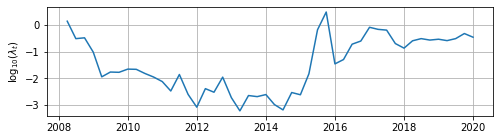

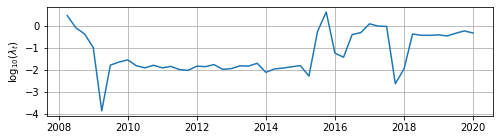

In [61]:
esnSingle_A_agg_rw_highfreq_for_1sa_2007 = esnSingle_rw_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_rw_highfreq_for_1sa_2007 = esnSingle_rw_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    retune=True,
    aggregate=True,
)

In [97]:
def esnMulti_rw_fit_highfreq_1sa(esnModel, Lambda, data, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    if retune:  Lambdas = []

    forecast_hf_rw = []
    target_hf_rw = []
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            m_data_train_j = m_data_train_j[GDP_dates[j-1]:]
            d_data_train_j = d_data_train_j[GDP_dates[j-1]:]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train

        if j < (len(GDP_data_test) - 1):
            GDP_data_test_j = GDP_data_test.iloc[[j,j+1],]
            m_data_test_j = m_data_test.loc[m_data_train_j.index[-1]:GDP_test_dates[j+1]]
            d_data_test_j = d_data_test.loc[d_data_train_j.index[-1]:GDP_test_dates[j+1]]
        else:
            GDP_data_test_j = GDP_data_test.iloc[[-1],]
            m_data_test_j = m_data_test.loc[m_data_train_j.index[-1]:GDP_test_dates[-1]]
            d_data_test_j = d_data_test.loc[d_data_train_j.index[-1]:GDP_test_dates[-1]]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
            method='ridge',
            Lambda=Lambda_j,
            full=False,
            debug=False,
        )

        esnMulti_hf_for = esnModel.fixedParamsHighFreqForecast(
            Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
            fit=esnMulti_fit
        )

        forecast_hf_rw.append(
            esnMulti_hf_for['highFrequencyForecast'][0]['Y_for'] * sig_j.to_numpy() + mu_j.to_numpy()
        )
        target_hf_rw.append(
            esnMulti_hf_for['highFrequencyForecast'][0]['Y'] * sig_j.to_numpy() + mu_j.to_numpy()
        )

    forecast_hf_rw = pd.concat(forecast_hf_rw)
    target_hf_rw = pd.concat(target_hf_rw)

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return {"hf_rw_forecast": forecast_hf_rw, "hf_target": target_hf_rw}

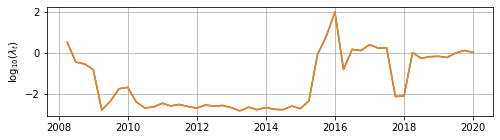

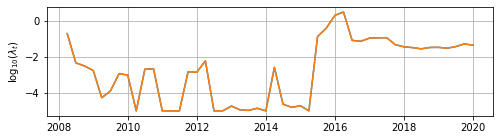

In [98]:
esnMulti_A_rw_highfreq_for_1sa_2007 = esnMulti_rw_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

esnMulti_B_rw_highfreq_for_1sa_2007 = esnMulti_rw_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    retune=True,
)

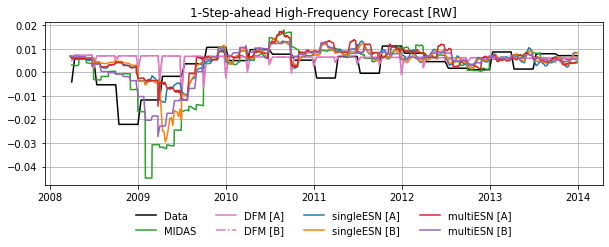

In [99]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_rw_highfreq_for_1sa_2007["hf_target"].loc[:"2013"], c='k', label="Data")
#
plt.plot(MIDAS_rw_for_highfreq_1sa_2007.loc[:"2013"], label="MIDAS", c="C2") 
#
plt.plot(DFM_A_rw_highfreq_forecast_2007.loc[:"2013"], label="DFM [A]", c="C6") 
plt.plot(DFM_B_rw_highfreq_forecast_2007.loc[:"2013"], label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_rw_highfreq_for_1sa_2007["hf_rw_forecast"].loc[:"2013"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_rw_highfreq_for_1sa_2007["hf_rw_forecast"].loc[:"2013"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_rw_highfreq_for_1sa_2007["hf_rw_forecast"].loc[:"2013"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_rw_highfreq_for_1sa_2007["hf_rw_forecast"].loc[:"2013"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_rw_2007.pdf'), bbox_inches="tight")
plt.show()

#### Multi-step Point Forecast

##### Fixed Parameters

In [131]:
# NOTE: this optimization is currently too expensive (high-frequency 
#       model estimation). Do it on cluster, load results.
#
#MIDAS_fit_multisa_2007 = MIDAS_model.fixedparamsForecast(
#    data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']),
#    fit_length=len(dataset2007['GDP_data_train']),
#    steps=1,
#    grad=False,
#    #method='L-BFGS-B',
#    debug=True
#)

import pickle

MIDAS_fix_multistep_for_2007 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_2ff621952c__MIDAS_fix_multistep_2007.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_fix_multistep_for_2007 = pickle.load(file)

#MIDAS_fix_multistep_for_2007 = [ pd.DataFrame(
#    data=MIDAS_fit_multisa_2007['forecasts'][(h*3*24)]['Forecast'], 
#    index=dataset2007['GDP_data_test'].index,
#) for h in range(8) ]

In [132]:
#plt.figure(figsize=(12, 2))
##
#plt.plot(MIDAS_fit_multisa_2007['parsfit_for'][0]['Yt_fit'], label='Fit')
#plt.plot(
#    (MIDAS_fit_multisa_2007['parsfit_for'][0]['Yt_fit'] -
#        MIDAS_fit_multisa_2007['parsfit_for'][0]['Residuals']),
#    label='Data', c='k', ls=':'
#)
##
#plt.grid()
#plt.legend()
#plt.show()

In [133]:
def UnMean_fix_fit_multistep(steps, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_fix_multistep = np.zeros((len(GDP_test_dates), steps))
    for s in range(steps):
        forecast_fix_multistep[:,s] = np.ones(len(GDP_test_dates)) * GDP_data_train.mean().to_numpy()

    return pd.DataFrame(data=forecast_fix_multistep, index=GDP_test_dates, columns=range(steps))

In [134]:
#UnMean_multistep_for_2007 = [ 
#    UnMean_1sa_forecast_2007
#for _ in range(8) ]

UnMean_fix_multistep_for_2007 = UnMean_fix_fit_multistep(
    data=dataset2007,
    steps=8,
)

In [135]:
#DFM_A_multistep_for_2007 = [ pd.read_csv(
#        os.path.join(dfm_path, 'stock__5__6__[1, 4, 12]_fixed__2007', 'q_test_'+str(12*(h+1))+'.csv'),
#        parse_dates = [0]
#    ).set_index('Unnamed: 0')[:'2019-12-31'][['Q1_test_pred']]
#    for h in range(6)
#] + [pd.DataFrame(np.full(1, np.nan)) for _ in range(2)]
#
#DFM_B_multistep_for_2007 = [ pd.read_csv(
#        os.path.join(dfm_path, 'almon__5__6__[1, 4, 12]_fixed__2007', 'q_test_'+str(12*(h+1))+'.csv'),
#        parse_dates = [0]
#    ).set_index('Unnamed: 0')[:'2019-12-31'][['Q1_test_pred']]
#    for h in range(6)
#] + [pd.DataFrame(np.full(1, np.nan)) for _ in range(2)]

#DFM_A_fix_multistep_for_2007 = pd.DataFrame(
#    data=None, columns=range(6), index=dataset2007['GDP_data_test'].index,
#)
#for h in range(6):
#    DFM_A_fix_multistep_for_2007.iloc[:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'stock__5__6__[1, 4, 12]_fixed__2007', 'q_test_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0]
#        ).iloc[:,1].to_numpy()
#    )
#
#DFM_B_fix_multistep_for_2007 = pd.DataFrame(
#    data=None, columns=range(6), index=dataset2007['GDP_data_test'].index,
#)
#for h in range(6):
#    DFM_B_fix_multistep_for_2007.iloc[:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'almon__5__6__[1, 4, 12]_fixed__2007', 'q_test_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0]
#        ).iloc[:,1].to_numpy()
#    )

In [136]:
#DFM_A_fix_multistep_for_2007 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2007['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_A_fix_multistep_for_2007.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'stock__5__6__[1]_fixed__2007', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2007[h:],'0'].to_numpy()
#    )
#
#DFM_B_fix_multistep_for_2007 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2007['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_B_fix_multistep_for_2007.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'almon__5__6__[1]_fixed__2007', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2007[h:],'0'].to_numpy()
#    )

DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_fix_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_fixed__2007', steps=8, date_slice=DFM_slice_2007,
)

DFM_B_fix_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_fixed__2007', steps=8, date_slice=DFM_slice_2007,
)

In [137]:
#D = (
#    esnSingle_A.models_[0].A_ + esnSingle_A.models_[0].C_ @ 
#            esnSingle_A_fit_1sa_2007['fit_comp_ar'][0][1:,].T
#)
#np.max(np.abs(np.linalg.eig(D)[0]))

In [138]:
## Autonomous state penalty
#esnSingle_A_comps_ridgecv_2007 = esnSingle_A.ridge_lambda_components_cv(
#    Y=dataset2007['GDP_fill_data_train'], z=(dataset2007['md_fill_data_train'], ),
#    cv_options="-cv:50",
#    debug=True,
#)
#
#esnSingle_A_multistep_ridgecv_2007 = esnSingle_A.ridge_lambda_cv(
#    Y=dataset2007['GDP_fill_data_train'], z=(dataset2007['md_fill_data_train'], ),
#    method="ridge-multistep",
#    cv_options="-cv:10-test_size:5",
#    steps=5,
#    steps_weights=np.exp(np.arange(0, -5, -1) / 2),
#    Lambda_comps=esnSingle_A_comps_ridgecv_2007,
#    debug=True,
#)

In [139]:
#for h in range(8):
#    weights_h = np.zeros(8)
#    weights_h[h] = 1 
#
#    print(f"| h = {h} ---------------------------")
#    esnSingle_A.ridge_lambda_cv(
#        Y=dataset2007['GDP_fill_data_train'], z=(dataset2007['md_fill_data_train'], ),
#        method="ridge-multistep-split",
#        cv_options="-cv:5",
#        #cv_options="-cv_min_split_size:30-cv_max_split_size:30",
#        steps=8,
#        steps_weights=weights_h,
#        debug=True,
#    )

In [140]:
# (A) Multi-step-adapted fit (W changed for each horizon h)
#esnSingle_A_fit_multistep_2007 = esnSingle_A.fit_multistep(
#    Y=dataset2007['GDP_fill_data_train'], z=(dataset2007['md_fill_data_train'], ), 
#    #Lambda=[ [(1e-2 * 2**h),] for h in range(8)],
#    Lambda=[ [l, ] for l in np.exp(np.arange(0, -8, -1) / 3)],
#    steps=8,
#)

In [141]:
#esnSingle_A_for_multisa_ridgecv_2007 = esnSingle_A.multistepForecast(
#    Yf=dataset2007['GDP_fill_data_test'], zf=(dataset2007['md_fill_data_test'], ), 
#    fit=esnSingle_A.fit(
#        Y=dataset2007['GDP_fill_data_train'], z=(dataset2007['md_fill_data_train'], ), 
#        method='ridge',
#        Lambda=esnSingle_A_multistep_ridgecv_2007,
#        full=True, 
#        debug=False,
#    ),
#    #fit=esnSingle_A_fit_multistep_2007,
#    steps=8
#)
#esnSingle_A_multisa_ridgecv_forecast_2007 = [  
#    esnSingle_A_for_multisa_ridgecv_2007['multistepForecast'][h]['Y_for']
#for h in range(8) ]

In [142]:
def esnSingle_fix_fit_multistep(esnModel, Lambda, steps, data, direct=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index

    GDP_fill_data_train, GDP_fill_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_fill_data_train, GDP_fill_data_test,
            return_mu_sig=True)
    )
    md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)

    esnSingle_fit = esnModel.fit(
        Y=GDP_fill_data_train, z=(md_fill_data_train, ), 
        method='ridge',
        Lambda=Lambda,
        full=True,
        debug=False,
        steps=(steps if direct else 1)
    )

    if direct:
        esnSingle_for = esnModel.fixedParamsForecast(
            Yf=GDP_fill_data_test, zf=(md_fill_data_test, ),
            fit=esnSingle_fit,
        )
    else:
        esnSingle_for = esnModel.multistepForecast(
            Yf=GDP_fill_data_test, zf=(md_fill_data_test, ),
            fit=esnSingle_fit,
            steps=steps
        )

    forecast_fix_multistep = np.zeros((len(GDP_test_dates), steps))
    for s in range(steps):
        if direct:
            forecast_fix_multistep[:,s] = np.squeeze(esnSingle_for['Forecast'][s]['Y_for'].to_numpy())
        else:
            forecast_fix_multistep[:,s] = np.squeeze(esnSingle_for['multistepForecast'][s]['Y_for'].to_numpy())

    forecast_fix_multistep = forecast_fix_multistep * GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()

    return pd.DataFrame(data=forecast_fix_multistep, index=GDP_test_dates, columns=range(steps))

In [143]:
#esnSingle_A_msfor_2007 = esnSingle_A.multistepForecast(
#    Yf=dataset2007['GDP_fill_data_test'], zf=(dataset2007['md_fill_data_test'], ), 
#    fit=esnSingle_A_fit_1sa_2007,
#    steps=8
#)
#esnSingle_A_multistep_for_2007 = [  
#    esnSingle_A_msfor_2007['multistepForecast'][h]['Y_for']
#for h in range(8) ]
#
#esnSingle_B_msfor_2007 = esnSingle_B.multistepForecast(
#    Yf=dataset2007['GDP_fill_data_test'], zf=(dataset2007['md_fill_data_test'], ), 
#    fit=esnSingle_B_fit_1sa_2007,
#    steps=8
#)
#esnSingle_B_multistep_for_2007 = [  
#    esnSingle_B_msfor_2007['multistepForecast'][h]['Y_for']
#for h in range(8) ]

In [144]:
## Aggregated 
#esnSingle_A_agg_msfor_2007 = esnSingle_A.multistepForecast(
#    Yf=dataset2007['GDP_fill_data_test'], zf=(dataset2007['md_fill_agg_data_test'], ), 
#    fit=esnSingle_A_agg_fit_1sa_2007,
#    steps=8
#)
#esnSingle_A_agg_multistep_for_2007 = [  
#    esnSingle_A_agg_msfor_2007['multistepForecast'][h]['Y_for']
#for h in range(8) ]
#
#esnSingle_B_agg_msfor_2007 = esnSingle_B.multistepForecast(
#    Yf=dataset2007['GDP_fill_data_test'], zf=(dataset2007['md_fill_agg_data_test'], ), 
#    fit=esnSingle_B_agg_fit_1sa_2007,
#    steps=8
#)
#esnSingle_B_agg_multistep_for_2007 = [  
#    esnSingle_B_agg_msfor_2007['multistepForecast'][h]['Y_for']
#for h in range(8) ]

# Aggregated
esnSingle_A_agg_fix_multistep_for_2007 = esnSingle_fix_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    aggregate=True,
)

esnSingle_B_agg_fix_multistep_for_2007 = esnSingle_fix_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    aggregate=True,
)

In [145]:
## Direct multi-step
#esnSingle_A_fit_directms_2007 = esnSingle_A.fit(
#    Y=dataset2007['GDP_fill_data_train'], z=(dataset2007['md_fill_data_train'], ), 
#    method='ridge',
#    Lambda=[1e-2, ],
#    full=True, 
#    debug=False,
#    steps=8,
#)
#
#esnSingle_A_for_directmultisa_2007 = esnSingle_A.fixedParamsForecast(
#    Yf=dataset2007['GDP_fill_data_test'], zf=(dataset2007['md_fill_data_test'], ), 
#    fit=esnSingle_A_fit_directms_2007,
#)
#esnSingle_A_directmultisa_forecast_2007 = [
#    esnSingle_A_for_directmultisa_2007['Forecast'][h]['Y_for']
#for h in range(8) ]
#
#esnSingle_B_fit_directms_2007 = esnSingle_B.fit(
#    Y=dataset2007['GDP_fill_data_train'], z=(dataset2007['md_fill_data_train'], ), 
#    method='ridge',
#    Lambda=[1e-2, ],
#    full=True, 
#    debug=False,
#    steps=8,
#)
#
#esnSingle_B_for_directmultisa_2007 = esnSingle_B.fixedParamsForecast(
#    Yf=dataset2007['GDP_fill_data_test'], zf=(dataset2007['md_fill_data_test'], ), 
#    fit=esnSingle_B_fit_directms_2007,
#)
#esnSingle_B_directmultisa_forecast_2007 = [
#    esnSingle_B_for_directmultisa_2007['Forecast'][h]['Y_for']
#for h in range(8) ]

In [146]:
#for h in range(8):
#    plt.figure(figsize=(10, 2))
#    plt.grid()
#    plt.plot(dataset2007['GDP_fill_data_test'], c='k', label="Data")
#    #
#    plt.plot(
#        esnSingle_A_directmultisa_forecast_2007[h], 
#        label="singleESN [A] direct", c="C0"
#    )
#    plt.plot(
#        esnSingle_B_directmultisa_forecast_2007[h], 
#        label="singleESN [A] direct", c="C1"
#    )
#    #
#    plt.title(f" [h = {h+1}]")
#    plt.legend(fancybox=False, shadow=False, ncol=4)
#    plt.show()

In [147]:
#for h in range(8):
#    plt.figure(figsize=(10, 2))
#    #plt.plot(dataset2007['GDP_fill_data_train'], c='0.5')
#    ##
#    #plt.plot(
#    #    esnSingle_A_fit_multistep_2007['fit_for'][h]['Y_fit'], 
#    #    label="singleESN [A] autoMS", c="C0", ls="--"
#    #)
#    ##
#    #plt.plot(
#    #    esnSingle_A_fit_directms_2007['fit_for'][h]['Y_fit'], 
#    #    label="singleESN [A] directMS", c="C2", ls="--"
#    #)
#    ##
#    plt.plot(dataset2007['GDP_fill_data_test'], c='k')
#    #
#    plt.plot(
#        esnSingle_A_multisa_forecast_2007[h], 
#        label="singleESN [A] auto", c="C0"
#    )
#    #
#    plt.plot(
#        esnSingle_A_multisa_ridgecv_forecast_2007[h], 
#        label="singleESN [A] auto+ridgeCV", c="C1"
#    )
#    #
#    plt.plot(
#        esnSingle_A_directmultisa_forecast_2007[h], 
#        label="singleESN [A] direct", c="C2"
#    )
#    #
#    plt.plot(
#        esnSingle_A_agg_multisa_forecast_2007[h], 
#        label="singleESN [A] atuo+agg", c="C3"
#    )
#    #
#    plt.grid()
#    #plt.title("Multi-step Ahead Forecast" + f" [h = {h+1}]")
#    plt.legend(fancybox=False, shadow=False, ncol=4)
#    plt.show()

In [148]:
#plt.figure(figsize=(10, 3))
##
#plt.plot(esnSingle_A_for_1sa_2007, c="k") 
##
#for h in range(len(esnSingle_A_multisa_forecast_2007)):
##for h in [5,6,7]:
#    plt.plot(esnSingle_A_multisa_forecast_2007[h], label="h = "+str(h+1))
##
#plt.title("Auto MS")
#plt.legend(ncol=4)
#plt.grid()
#plt.show()
#
#plt.figure(figsize=(10, 3))
##
#plt.plot(esnSingle_A_agg_for_1sa_2007, c="k",) 
##
#for h in range(len(esnSingle_A_agg_multisa_forecast_2007)):
##for h in [5,6,7]:
#    plt.plot(esnSingle_A_agg_multisa_forecast_2007[h], label="h = "+str(h+1), ls="-.")
##
#plt.title("Auto MS + aggregation")
#plt.legend(ncol=4)
#plt.grid()
#plt.show()

In [149]:
def esnMulti_fix_fit_multistep(esnModel, Lambda, steps, data, direct=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test,
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    esnMulti_fit = esnModel.fit(
        Y=GDP_data_train, z=(m_data_train, d_data_train),
        method='ridge',
        Lambda=Lambda,
        full=True,
        debug=False,
        steps=(steps if direct else 1)
    )

    if direct:
        esnMulti_for = esnModel.fixedParamsForecast(
            Yf=GDP_data_test, zf=(m_data_test, d_data_test),
            fit=esnMulti_fit,
        )
    else:
        esnMulti_for = esnModel.multistepForecast(
            Yf=GDP_data_test, zf=(m_data_test, d_data_test),
            fit=esnMulti_fit,
            steps=steps
        )

    forecast_fix_multistep = np.zeros((len(GDP_test_dates), steps))
    for s in range(steps):
        if direct:
            forecast_fix_multistep[:,s] = np.squeeze(esnMulti_for['Forecast'][s]['Y_for'].to_numpy())
        else:
            forecast_fix_multistep[:,s] = np.squeeze(esnMulti_for['multistepForecast'][s]['Y_for'].to_numpy())

    forecast_fix_multistep = forecast_fix_multistep * GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()

    return pd.DataFrame(data=forecast_fix_multistep, index=GDP_test_dates, columns=range(steps))

In [150]:
#esnMulti_A_msfor_2007 = esnMulti_A.multistepForecast(
#    Yf=dataset2007['GDP_data_test'], zf=(dataset2007['m_data_test'], dataset2007['d_data_test']), 
#    fit=esnMulti_A_fit_1sa_2007,
#    steps=8
#)
#esnMulti_A_multistep_for_2007 = [  
#    esnMulti_A_msfor_2007['multistepForecast'][h]['Y_for']
#for h in range(8) ]
#
#esnMulti_B_msfor_2007 = esnMulti_B.multistepForecast(
#    Yf=dataset2007['GDP_data_test'], zf=(dataset2007['m_data_test'], dataset2007['d_data_test']), 
#    fit=esnMulti_B_fit_1sa_2007,
#    steps=8
#)
#esnMulti_B_multistep_for_2007 = [  
#    esnMulti_B_msfor_2007['multistepForecast'][h]['Y_for']
#for h in range(8) ]

esnMulti_A_fix_multistep_for_2007 = esnMulti_fix_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    steps=8,
    direct=False,
)

esnMulti_B_fix_multistep_for_2007 = esnMulti_fix_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    steps=8,
    direct=False,
)

In [151]:
#for n_folds in [5, 10, 15, 20]:
#    print(f"+ n_folds = {n_folds} -----------")
#
#    esnMulti_A.ridge_lambda_cv(
#        Y=dataset2007['GDP_data_test'], z=(dataset2007['m_data_test'], dataset2007['d_data_test']),
#        method="ridge",
#        cv_options=("-cv:" + str(n_folds) + "-test_size:1"),
#        steps=1,
#        debug=True,
#    )

In [152]:
#esnSingle_A_for_multisa_2007 = esnSingle_A.multistepForecast(
#    Yf=dataset2007['GDP_fill_data_test'], zf=(dataset2007['md_fill_data_test'], ), 
#    fit=esnSingle_A_fit_1sa_2007,
#    steps=3
#)
#esnSingle_A_multisa_forecast_2007 = [  
#    esnSingle_A_for_multisa_2007['multistepForecast'][h]['Y_for']
#for h in range(3) ]

In [153]:
#esnMulti_A_for_multisa_2007 = esnMulti_A.multistepForecast(
#    Yf=dataset2007['GDP_data_test'], zf=(dataset2007['m_data_test'], dataset2007['d_data_test']), 
#    fit=esnMulti_A_fit_1sa_2007,
#    steps=3
#)
#esnMulti_A_multisa_forecast_2007 = [  
#    esnMulti_A_for_multisa_2007['multistepForecast'][h]['Y_for']
#for h in range(3) ]

In [154]:
#def hStepRMSFE_2007(forecasts_array):
#    steps = len(forecasts_array)
#    hStep_rmse = np.zeros((steps))
#    for h in range(steps):
#        hStep_rmse[h] = np.sqrt(np.mean(np.square(
#            dataset2007['GDP_data_test'].to_numpy() - forecasts_array[h].to_numpy()
#        )[h:(-steps+h)]))
#    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

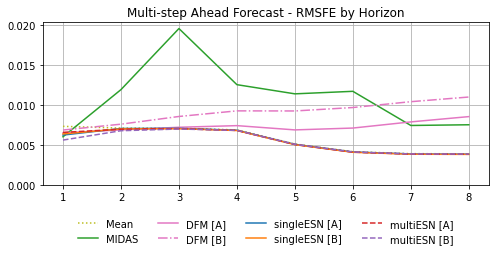

In [155]:
def hStepRMSFE_2007(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2007['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

plt.figure(figsize=(8, 3))
plt.grid()
#
plt.plot(hStepRMSFE_2007(UnMean_fix_multistep_for_2007), label="Mean", c="C8", ls=':') 
#
plt.plot(hStepRMSFE_2007(MIDAS_fix_multistep_for_2007), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2007(DFM_A_fix_multistep_for_2007), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2007(DFM_B_fix_multistep_for_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2007(esnSingle_A_agg_fix_multistep_for_2007), label="singleESN [A]", c="C0") 
plt.plot(hStepRMSFE_2007(esnSingle_B_agg_fix_multistep_for_2007), label="singleESN [B]", c="C1") 
#
#plt.plot(hStepRMSFE_2007(esnSingle_A_directmultisa_forecast_2007), label="singleESN [A] direct", c="C0", ls="-.")
#plt.plot(hStepRMSFE_2007(esnSingle_B_directmultisa_forecast_2007), label="singleESN [B] direct", c="C1", ls="-.")
#
#plt.plot(hStepRMSFE_2007(esnSingle_A_agg_multisa_forecast_2007), label="singleESN [A] agg", c="C0", ls=":")
#plt.plot(hStepRMSFE_2007(esnSingle_B_agg_multisa_forecast_2007), label="singleESN [B] agg", c="C1", ls=":")
#
plt.plot(hStepRMSFE_2007(esnMulti_A_fix_multistep_for_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(hStepRMSFE_2007(esnMulti_B_fix_multistep_for_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
plt.title("Multi-step Ahead Forecast - RMSFE by Horizon")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_fix_2007.pdf'), bbox_inches="tight")
plt.show()

In [156]:
table_RMSFE_multistep_fix_2007 = pd.DataFrame(
    index=range(1,9)
)
table_RMSFE_multistep_fix_2007.index.name = "FIX_2007"
table_RMSFE_multistep_fix_2007["Model"] = ['Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
        'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
    ]

for h in range(8):
    ref_h_hStepRMSFE_fix = hStepRMSFE_2007(UnMean_fix_multistep_for_2007).iat[h,0]
    table_RMSFE_multistep_fix_2007[str(h+1)] = [
        hStepRMSFE_2007(UnMean_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(MIDAS_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(DFM_A_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(DFM_B_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(esnSingle_A_agg_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(esnSingle_B_agg_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(esnMulti_A_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2007(esnMulti_B_fix_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_fix,
    ]

table_RMSFE_multistep_fix_2007.round(3)

,Model,1,2,3,4,5,6,7,8
FIX_2007,,,,,,,,,
1,Mean,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
2,MIDAS,0.823,1.672,2.737,1.816,2.213,2.791,1.888,1.921
3,DFM [A],0.890,0.969,1.014,1.077,1.341,1.701,2.001,2.180
4,DFM [B],0.937,1.069,1.202,1.344,1.799,2.310,2.638,2.801
5,singleESN [A],0.852,0.994,0.995,0.995,0.993,0.991,0.991,0.991
6,singleESN [B],0.871,0.986,0.989,0.989,0.985,0.981,0.981,0.981
7,multiESN [A],0.898,0.980,0.990,0.991,0.988,0.985,0.985,0.985
8,multiESN [B],0.767,0.954,0.983,0.991,0.991,0.990,0.991,0.991


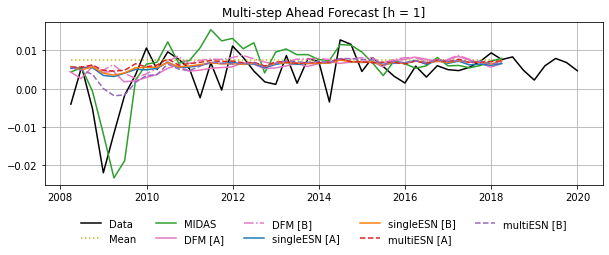

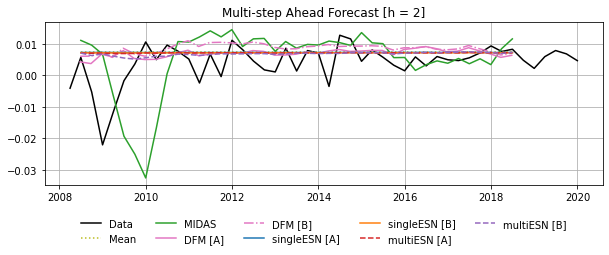

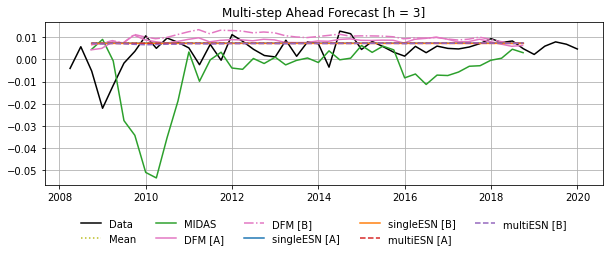

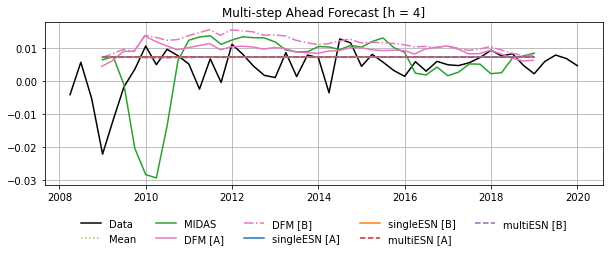

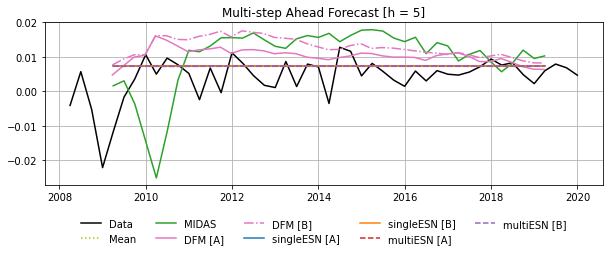

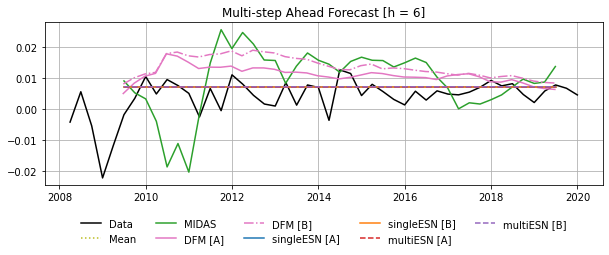

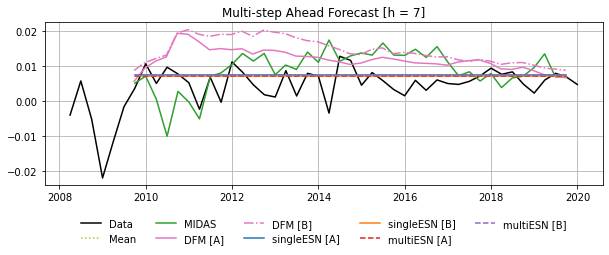

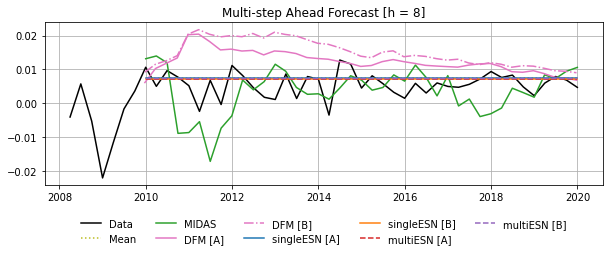

In [157]:
steps = 8
T = len(dataset2007['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8", ls=':') 
    #
    plt.plot(MIDAS_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C1") 
    #
    #plt.plot(esnSingle_A_directmultistep_for_2007[h], label="singleESN [A] direct", c="C0", ls="-.")
    #plt.plot(esnSingle_B_directmultistep_for_2007[h], label="singleESN [B] direct", c="C1", ls="-.")
    #
    #plt.plot(esnSingle_A_agg_multistep_for_2007[h], label="singleESN [A] agg", c="C0", ls=":")
    #plt.plot(esnSingle_B_agg_multistep_for_2007[h], label="singleESN [B] agg", c="C1", ls=":")
    #
    plt.plot(esnMulti_A_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3", ls='--') 
    plt.plot(esnMulti_B_fix_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C4", ls='--')
    #
    plt.title("Multi-step Ahead Forecast" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=5)
    plt.show()

Export multi-horizon losses:

In [329]:
mhmcs_steps = 8
mhmcs_multistep_fix_2007 = xr.DataArray(
    data=np.zeros(
        (mhmcs_steps, len(dataset2007['GDP_data_test']) - mhmcs_steps, 8)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_fix_2007[h, :, :] = (
        np.c_[
            UnMean_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_fix_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2007['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [159]:
#for h in range(mhmcs_steps):
#    plt.figure(figsize=(10,2))
#    for i in range(8):
#        plt.plot(mhmcs_multistep_fix_2007[h,:,i])
#    plt.yscale('log')
#    plt.grid()
#    plt.show()

In [330]:
mhmcs_multistep_fix_2007_df = mhmcs_multistep_fix_2007.to_dataframe(
    name="Loss", dim_order=['M0', 'H', 'T']
)
mhmcs_multistep_fix_2007_df.to_csv(
    os.path.join(path_folder, "R", "mhmcs_small_multistep_fix_2007.csv")
)

In [161]:
#from MultiHorizonMCS import MultiHorizonMCS
#
#mhmcs_25_multisa_2007_h = (
#    MultiHorizonMCS(data=mhmcs_multisa_2007, method="uSPA", alpha=0.25, B=10, w=2, seed=202209).run()
#)
#print(f"MCS 25 included: {mhmcs_25_multisa_2007_h.included}")
#print(f"MCS 25 p-values: \n{mhmcs_25_multisa_2007_h.pvalues}")

Horizon-specific MCS:

In [162]:
for h in range(8):
    mcs_multistep_2007_h = pd.DataFrame(
        np.c_[UnMean_fix_multistep_for_2007[h],
            MIDAS_fix_multistep_for_2007[h],
            DFM_A_fix_multistep_for_2007[h],
            DFM_B_fix_multistep_for_2007[h],
            esnSingle_A_agg_fix_multistep_for_2007[h],
            esnSingle_B_agg_fix_multistep_for_2007[h],
            esnMulti_A_fix_multistep_for_2007[h],
            esnMulti_B_fix_multistep_for_2007[h],
        ],
        columns=['Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                    'singleESN [A]', 'singleESN [B]', 
                    'multiESN [A]', 'multiESN [B]']
    )
    mcs_multistep_2007_h = np.square((mcs_multistep_2007_h - dataset2007['GDP_data_test'].to_numpy()))

    mcs_25_multistep_2007_h = (
        ModelConfidenceSet(data=mcs_multistep_2007_h, alpha=0.25, B=10000, w=2, algorithm='R').run()
    )
    mcs_10_multistep_2007_h = (
        ModelConfidenceSet(data=mcs_multistep_2007_h, alpha=0.10, B=10000, w=2, algorithm='R').run()
    )

    print(f"h = {h+1} -------------------------------------------")
    print(f"MCS 25 included: {mcs_25_multistep_2007_h.included}")
    print(f"MCS 10 included: {mcs_10_multistep_2007_h.included}")
    print(" ")

h = 1 -------------------------------------------
MCS 25 included: ['singleESN [A]', 'MIDAS', 'multiESN [B]']
MCS 10 included: ['singleESN [A]', 'MIDAS', 'multiESN [B]']
 
h = 2 -------------------------------------------
MCS 25 included: ['multiESN [B]', 'DFM [A]']
MCS 10 included: ['multiESN [A]', 'multiESN [B]', 'DFM [A]']
 
h = 3 -------------------------------------------
MCS 25 included: ['singleESN [B]', 'multiESN [B]']
MCS 10 included: ['singleESN [B]', 'multiESN [B]']
 
h = 4 -------------------------------------------
MCS 25 included: ['singleESN [B]']
MCS 10 included: ['singleESN [B]']
 
h = 5 -------------------------------------------
MCS 25 included: ['singleESN [B]']
MCS 10 included: ['singleESN [B]']
 
h = 6 -------------------------------------------
MCS 25 included: ['singleESN [B]']
MCS 10 included: ['singleESN [B]']
 
h = 7 -------------------------------------------
MCS 25 included: ['singleESN [B]']
MCS 10 included: ['singleESN [B]']
 
h = 8 ----------------------

##### Expanding Window

In [163]:
import pickle

MIDAS_ew_multistep_for_2007 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_5c70cf6033__MIDAS_ew_multistep_for_2007.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_ew_multistep_for_2007 = pickle.load(file)

In [164]:
def UnMean_ew_fit_multistep(steps, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_ew_multistep = np.zeros((len(GDP_test_dates), steps))
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
        else:
            GDP_data_train_j = GDP_data_train

        for_j = np.zeros(steps)
        T_train = len(GDP_data_train_j)
        for s in range(steps):
            for_j[s] = GDP_data_train_j.iloc[:(T_train-s),:].mean().iloc[0]

        forecast_ew_multistep[j,:] = for_j

    return pd.DataFrame(data=forecast_ew_multistep, index=GDP_test_dates, columns=range(steps))

In [165]:
UnMean_ew_multistep_for_2007 = UnMean_ew_fit_multistep(
    data=dataset2007,
    steps=8,
)

 EW:   0%|          | 0/48 [00:00<?, ?it/s]

In [166]:
#UnMean_ew_multistep_for_2007 =  pd.DataFrame(
#    data=None, columns=range(6), index=dataset2007['GDP_data_test'].index,
#)
#for h in range(6):
#    UnMean_ew_multistep_for_2007.iloc[:,h] = UnMean_ew_1sa_forecast_2007

In [167]:
#DFM_A_ew_multistep_for_2007 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2007['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_A_ew_multistep_for_2007.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'stock__5__6__[1]_expanding__2007', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2007[h:],'0'].to_numpy()
#    )
#
#DFM_B_ew_multistep_for_2007 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2007['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_B_ew_multistep_for_2007.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'almon__5__6__[1]_expanding__2007', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2007[h:],'0'].to_numpy()
#    )

DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_ew_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_expanding__2007', steps=8, date_slice=DFM_slice_2007,
)

DFM_B_ew_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_expanding__2007', steps=8, date_slice=DFM_slice_2007,
)

In [168]:
def esnSingle_ew_fit_multistep(esnModel, Lambda, steps, data, direct=False, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index

    if retune:  Lambdas = []

    forecast_ew_multistep = np.zeros((len(GDP_test_dates), steps))
    W_list = []
    L_list = []
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train, 
                GDP_fill_data_test.iloc[0:j,]
            ])
            md_fill_data_train_j = pd.concat([
                md_fill_data_train, 
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
            md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
            md_fill_data_test_j = md_fill_data_test.iloc[[0],]

        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, GDP_mu_train_j, GDP_sig_train_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=True,
            debug=False,
            steps=(steps if direct else 1)
        )

        W_list.append(esnSingle_fit['fit_for'][0]['W'])
        L_list.append(np.max(np.abs(np.linalg.eig(
            esnModel.models_[0].A_ + esnModel.models_[0].C_ @ 
                esnSingle_fit['fit_comp_ar'][0][1:,:].T
        )[0])))

        if direct:
            esnSingle_for = esnModel.fixedParamsForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ),
                fit=esnSingle_fit,
            )
        else:
            esnSingle_for = esnModel.multistepForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ),
                fit=esnSingle_fit,
                steps=steps
            )

        for_j = np.zeros(steps)
        for s in range(steps):
            if direct:
                for_j[s] = esnSingle_for['Forecast'][s]['Y_for'][0]
            else:
                for_j[s] = esnSingle_for['multistepForecast'][s]['Y_for'][0]

        forecast_ew_multistep[j,:] = for_j * GDP_sig_train_j.to_numpy() + GDP_mu_train_j.to_numpy()

    _, axs = plt.subplots(1, 2, figsize=(8,2))
    axs[0].plot(np.array([np.linalg.norm(w) for w in W_list]), c="C0")
    axs[0].grid()
    axs[0].set_title("||W||")
    axs[1].plot(np.array(L_list), c="C1")
    axs[1].grid()
    axs[1].set_title("\lambda_1(A + CW')")

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_ew_multistep, index=GDP_test_dates, columns=range(steps))

In [169]:
#esnSingle_A_ew_multistep_for_2007 = esnSingle_ew_fit_multistep(
#    esnModel=esnSingle_A, Lambda=[1e-2,], data=dataset2007,
#    steps=8,
#    direct=False,
#)
#
#esnSingle_B_ew_multistep_for_2007 = esnSingle_ew_fit_multistep(
#    esnModel=esnSingle_B, Lambda=[1e-2,], data=dataset2007,
#    steps=8,
#    direct=False,
#)

 EW:   0%|          | 0/48 [00:00<?, ?it/s]

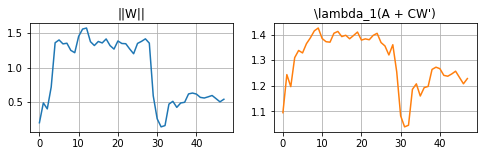

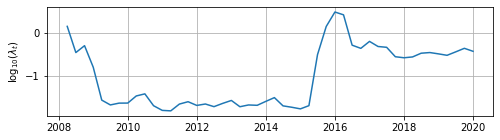

 EW:   0%|          | 0/48 [00:00<?, ?it/s]

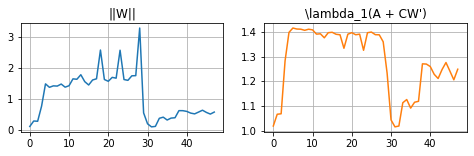

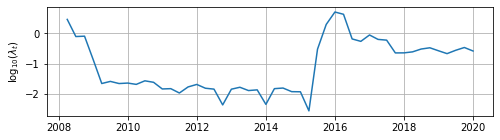

In [170]:
# Aggregated
esnSingle_A_agg_ew_multistep_for_2007 = esnSingle_ew_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_ew_multistep_for_2007 = esnSingle_ew_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

In [171]:
def esnMulti_ew_fit_multistep(esnModel, Lambda, steps, data, direct=False, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    if retune:  Lambdas = []

    forecast_ew_multistep = np.zeros((len(GDP_data_test), steps))
    W_list = []
    for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ])
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
            d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.iloc[[0],]
            d_data_test_j = d_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, GDP_mu_train_j, GDP_sig_train_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j),
            method='ridge',
            Lambda=Lambda_j,
            full=True,
            debug=False,
            steps=(steps if direct else 1)
        )

        W_list.append(esnMulti_fit['fit_for'][0]['W'])

        if direct:
            esnMulti_for = esnModel.fixedParamsForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j),
                fit=esnMulti_fit,
            )
        else:
            esnMulti_for = esnModel.multistepForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j),
                fit=esnMulti_fit,
                steps=steps
            )

        for_j = np.zeros(steps)
        for s in range(steps):
            if direct:
                for_j[s] = esnMulti_for['Forecast'][s]['Y_for'][0]
            else:
                for_j[s] = esnMulti_for['multistepForecast'][s]['Y_for'][0]

        forecast_ew_multistep[j,:] = for_j * GDP_sig_train_j.to_numpy() + GDP_mu_train_j.to_numpy()

    plt.figure(figsize=(8,2))
    plt.plot(np.array([np.linalg.norm(w) for w in W_list]))
    plt.grid()
    plt.title("||W||")

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_ew_multistep, index=GDP_test_dates, columns=range(steps))

 EW:   0%|          | 0/48 [00:00<?, ?it/s]

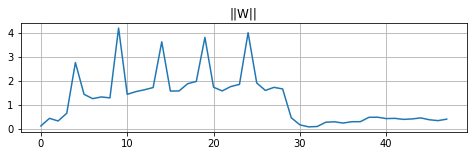

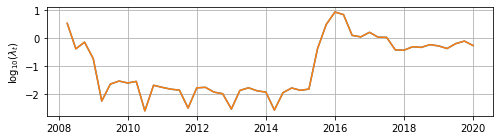

 EW:   0%|          | 0/48 [00:00<?, ?it/s]

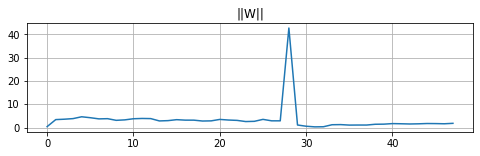

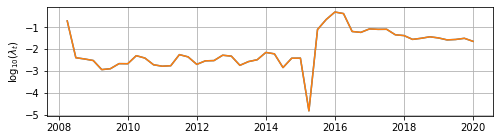

In [172]:
esnMulti_A_ew_multistep_for_2007 = esnMulti_ew_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
)

esnMulti_B_ew_multistep_for_2007 = esnMulti_ew_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]], 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
)

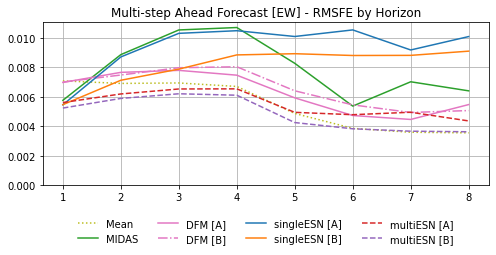

In [173]:
def hStepRMSFE_2007(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2007['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

plt.figure(figsize=(8, 3))
plt.grid()
#
plt.plot(hStepRMSFE_2007(UnMean_ew_multistep_for_2007), label="Mean", c="C8", ls=':') 
#
plt.plot(hStepRMSFE_2007(MIDAS_ew_multistep_for_2007), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2007(DFM_A_ew_multistep_for_2007), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2007(DFM_B_ew_multistep_for_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2007(esnSingle_A_agg_ew_multistep_for_2007), label="singleESN [A]", c="C0") 
plt.plot(hStepRMSFE_2007(esnSingle_B_agg_ew_multistep_for_2007), label="singleESN [B]", c="C1") 
#
plt.plot(hStepRMSFE_2007(esnMulti_A_ew_multistep_for_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(hStepRMSFE_2007(esnMulti_B_ew_multistep_for_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
plt.title("Multi-step Ahead Forecast [EW] - RMSFE by Horizon")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [174]:
table_RMSFE_multistep_ew_2007 = pd.DataFrame(
    index=range(1,9)
)
table_RMSFE_multistep_ew_2007.index.name = "EW_2007"
table_RMSFE_multistep_ew_2007["Model"] = ['Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
        'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
    ]

for h in range(8):
    ref_h_hStepRMSFE_ew = hStepRMSFE_2007(UnMean_ew_multistep_for_2007).iat[h,0]
    table_RMSFE_multistep_ew_2007[str(h+1)] = [
        hStepRMSFE_2007(UnMean_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(MIDAS_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(DFM_A_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(DFM_B_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(esnSingle_A_agg_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(esnSingle_B_agg_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(esnMulti_A_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2007(esnMulti_B_ew_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_ew,
    ]

table_RMSFE_multistep_ew_2007.round(3)

,Model,1,2,3,4,5,6,7,8
EW_2007,,,,,,,,,
1,Mean,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
2,MIDAS,0.814,1.283,1.518,1.596,1.697,1.391,1.951,1.800
3,DFM [A],0.985,1.109,1.123,1.114,1.217,1.226,1.241,1.539
4,DFM [B],0.989,1.082,1.149,1.199,1.315,1.412,1.373,1.425
5,singleESN [A],0.771,1.260,1.485,1.564,2.070,2.728,2.550,2.834
6,singleESN [B],0.772,1.031,1.135,1.319,1.831,2.279,2.449,2.556
7,multiESN [A],0.792,0.897,0.941,0.976,1.015,1.240,1.377,1.227
8,multiESN [B],0.740,0.853,0.894,0.911,0.873,0.993,1.020,1.020


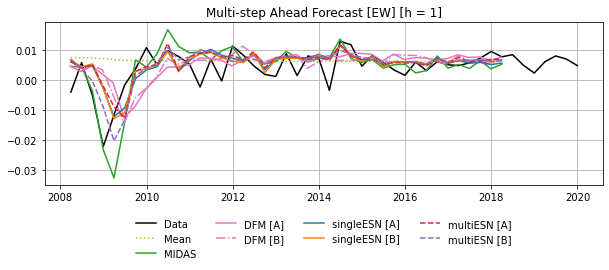

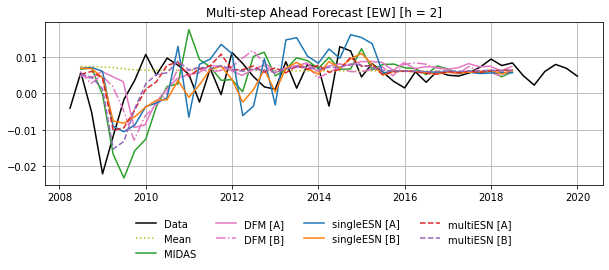

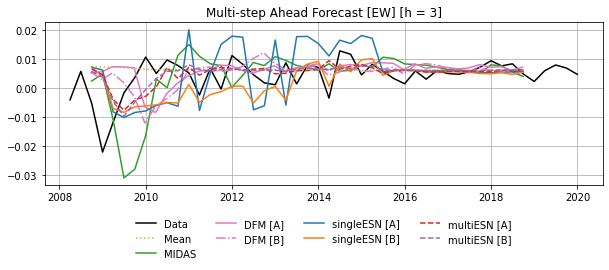

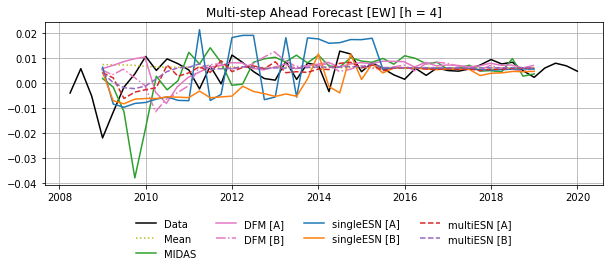

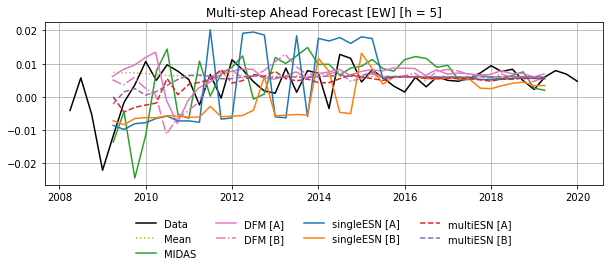

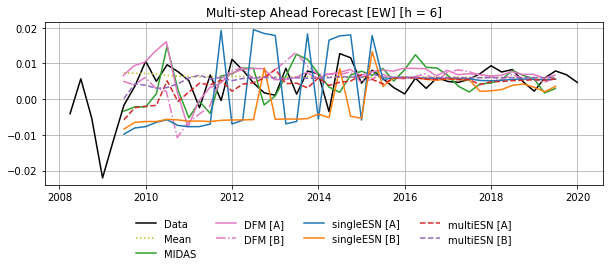

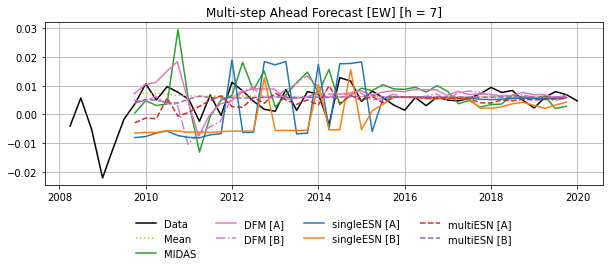

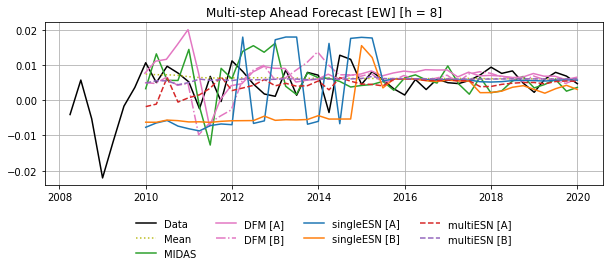

In [175]:
steps = 8
T = len(dataset2007['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8", ls=':') 
    #
    plt.plot(MIDAS_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C1") 
    #
    plt.plot(esnMulti_A_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3", ls='--') 
    plt.plot(esnMulti_B_ew_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C4", ls='--')
    #
    plt.title("Multi-step Ahead Forecast [EW]" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=4)
    plt.show()

Export multi-horizon losses:

In [331]:
mhmcs_steps = 8
mhmcs_multistep_ew_2007 = xr.DataArray(
    data=np.zeros(
        (mhmcs_steps, len(dataset2007['GDP_data_test']) - mhmcs_steps, 8)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_ew_2007[h, :, :] = (
        np.c_[
            UnMean_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_ew_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2007['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [332]:
mhmcs_multistep_ew_2007_df = mhmcs_multistep_ew_2007.to_dataframe(
    name="Loss", dim_order=['M0', 'H', 'T']
)
mhmcs_multistep_ew_2007_df.to_csv(
    os.path.join(path_folder, "R", "mhmcs_small_multistep_ew_2007.csv")
)

##### Rolling Window

In [178]:
import pickle

MIDAS_rw_multistep_for_2007 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_381d93060c__MIDAS_rw_multistep_for_2007.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_rw_multistep_for_2007 = pickle.load(file)

In [179]:
def UnMean_rw_fit_multistep(steps, data):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']

    GDP_test_dates = GDP_data_test.index

    forecast_rw_multistep = np.zeros((len(GDP_test_dates), steps))
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
        else:
            GDP_data_train_j = GDP_data_train

        for_j = np.zeros(steps)
        T_train = len(GDP_data_train_j)
        for s in range(steps):
            js_idx = np.max((0,(j-s))) if j > 0 else 0
            for_j[s] = GDP_data_train_j.iloc[js_idx:(T_train-s),:].mean().iloc[0]

        forecast_rw_multistep[j,:] = for_j

    return pd.DataFrame(data=forecast_rw_multistep, index=GDP_test_dates, columns=range(steps))

In [180]:
UnMean_rw_multistep_for_2007 = UnMean_rw_fit_multistep(
    data=dataset2007,
    steps=8
)

 RW:   0%|          | 0/48 [00:00<?, ?it/s]

In [181]:
#UnMean_rw_multistep_for_2007 =  pd.DataFrame(
#    data=None, columns=range(6), index=dataset2007['GDP_data_test'].index,
#)
#for h in range(6):
#    UnMean_rw_multistep_for_2007.iloc[:,h] = UnMean_rw_1sa_forecast_2007

In [182]:
#DFM_A_rw_multistep_for_2007 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2007['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_A_rw_multistep_for_2007.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'stock__5__6__[1]_window__2007', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2007[h:],'0'].to_numpy()
#    )
#
#DFM_B_rw_multistep_for_2007 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2007['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_B_rw_multistep_for_2007.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'almon__5__6__[1]_window__2007', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2007[h:],'0'].to_numpy()
#    )

DFM_slice_2007 = (
    pd.date_range('2008-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_rw_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_window__2007', steps=8, date_slice=DFM_slice_2007,
)

DFM_B_rw_multistep_for_2007 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_window__2007', steps=8, date_slice=DFM_slice_2007,
)

In [183]:
def esnSingle_rw_fit_multistep(esnModel, Lambda, steps, data, direct=False, retune=False, aggregate=False):
    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index
    GDP_dates = GDP_fill_data_train.index.append(GDP_fill_data_test.index)

    if retune:  Lambdas = []

    forecast_rw_multistep = np.zeros((len(GDP_test_dates), steps))
    W_list = []
    L_list = []
    for j in tqdm(range(len(GDP_fill_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_fill_data_train_j = pd.concat([
                GDP_fill_data_train,
                GDP_fill_data_test.iloc[0:j,]
            ]).iloc[j:,]
            md_fill_data_train_j = pd.concat([
                md_fill_data_train,
                md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            md_fill_data_train_j = md_fill_data_train_j[GDP_dates[j-1]:]
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
            md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
        else:
            GDP_fill_data_train_j = GDP_fill_data_train
            md_fill_data_train_j = md_fill_data_train
            GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
            md_fill_data_test_j = md_fill_data_test.iloc[[0],]

        # Normalize
        GDP_fill_data_train_j, GDP_fill_data_test_j, GDP_mu_train_j, GDP_sig_train_j = (
            normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                return_mu_sig=True)
        )
        md_fill_data_train_j, md_fill_data_test_j = (
            normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnSingle_fit = esnModel.fit(
            Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
            method='ridge',
            Lambda=Lambda_j,
            full=True,
            debug=False,
            steps=(steps if direct else 1)
        )

        W_list.append(esnSingle_fit['fit_for'][0]['W'])
        L_list.append(np.max(np.abs(np.linalg.eig(
            esnModel.models_[0].A_ + esnModel.models_[0].C_ @ 
                esnSingle_fit['fit_comp_ar'][0][1:,:].T
        )[0])))

        if direct:
            esnSingle_for = esnModel.fixedParamsForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ),
                fit=esnSingle_fit,
            )
        else:
            esnSingle_for = esnModel.multistepForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ),
                fit=esnSingle_fit,
                steps=steps
            )

        for_j = np.zeros(steps)
        for s in range(steps):
            if direct:
                for_j[s] = esnSingle_for['Forecast'][s]['Y_for'][0]
            else:
                for_j[s] = esnSingle_for['multistepForecast'][s]['Y_for'][0]

        forecast_rw_multistep[j,:] = for_j * GDP_sig_train_j.to_numpy() + GDP_mu_train_j.to_numpy()

    _, axs = plt.subplots(1, 2, figsize=(8,2))
    axs[0].plot(np.array([np.linalg.norm(w) for w in W_list]), c="C0")
    axs[0].grid()
    axs[0].set_title("||W||")
    axs[1].plot(np.array(L_list), c="C1")
    axs[1].grid()
    axs[1].set_title("\lambda_1(A + CW')")

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_rw_multistep, index=GDP_test_dates, columns=range(steps))

In [184]:
#esnSingle_A_rw_multistep_for_2007 = esnSingle_rw_fit_multistep(
#    esnModel=esnSingle_A, Lambda=[1e-2,], data=dataset2007,
#    steps=8,
#    direct=False
#)
#
#esnSingle_B_rw_multistep_for_2007 = esnSingle_rw_fit_multistep(
#    esnModel=esnSingle_B, Lambda=[1e-2,], data=dataset2007,
#    steps=8,
#    direct=False
#)

 RW:   0%|          | 0/48 [00:00<?, ?it/s]

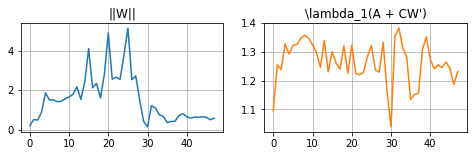

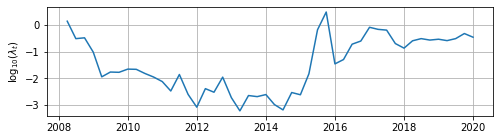

 RW:   0%|          | 0/48 [00:00<?, ?it/s]

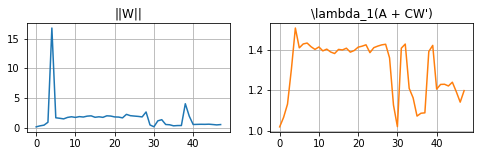

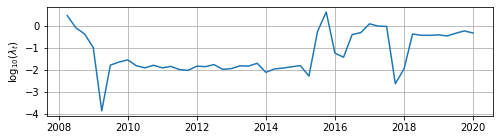

In [185]:
# Aggregated
esnSingle_A_agg_rw_multistep_for_2007 = esnSingle_rw_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_rw_multistep_for_2007 = esnSingle_rw_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2007, 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

In [186]:
def esnMulti_rw_fit_multistep(esnModel, Lambda, steps, data, direct=False, retune=False):
    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    if retune:  Lambdas = []

    forecast_rw_multistep = np.zeros((len(GDP_data_test), steps))
    W_list = []
    for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
        if j > 0:
            GDP_data_train_j = pd.concat([
                GDP_data_train,
                GDP_data_test.iloc[0:j,]
            ]).iloc[j:,]
            m_data_train_j = pd.concat([
                m_data_train,
                m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            d_data_train_j = pd.concat([
                d_data_train,
                d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
            ])
            m_data_train_j = m_data_train_j[GDP_dates[j-1]:]
            d_data_train_j = d_data_train_j[GDP_dates[j-1]:]
            GDP_data_test_j = GDP_data_test.iloc[[j],]
            m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
            d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
        else:
            GDP_data_train_j = GDP_data_train
            m_data_train_j = m_data_train
            d_data_train_j = d_data_train
            GDP_data_test_j = GDP_data_test.iloc[[0],]
            m_data_test_j = m_data_test.iloc[[0],]
            d_data_test_j = d_data_test.iloc[[0],]

        # Normalize
        GDP_data_train_j, GDP_data_test_j, GDP_mu_train_j, GDP_sig_train_j = (
            normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                return_mu_sig=True)
        )
        m_data_train_j, m_data_test_j = (
            normalize_train_test(m_data_train_j, m_data_test_j)
        )
        d_data_train_j, d_data_test_j = (
            normalize_train_test(d_data_train_j, d_data_test_j)
        )

        if retune:
            Lambda_j = esnModel.ridge_lambda_cv(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method="ridge-isotropic",
                cv_options="-cv:5-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda_j = [Lambda_j[0], Lambda_j[0]]
            Lambdas.append(Lambda_j)
        else:
            Lambda_j = Lambda

        esnMulti_fit = esnModel.fit(
            Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j),
            method='ridge',
            Lambda=Lambda_j,
            full=True,
            debug=False,
            steps=(steps if direct else 1)
        )

        W_list.append(esnMulti_fit['fit_for'][0]['W'])

        if direct:
            esnMulti_for = esnModel.fixedParamsForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j),
                fit=esnMulti_fit,
            )
        else:
            esnMulti_for = esnModel.multistepForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j),
                fit=esnMulti_fit,
                steps=steps
            )

        for_j = np.zeros(steps)
        for s in range(steps):
            if direct:
                for_j[s] = esnMulti_for['Forecast'][s]['Y_for'][0]
            else:
                for_j[s] = esnMulti_for['multistepForecast'][s]['Y_for'][0]

        forecast_rw_multistep[j,:] = for_j * GDP_sig_train_j.to_numpy() + GDP_mu_train_j.to_numpy()

    plt.figure(figsize=(8,2))
    plt.plot(np.array([np.linalg.norm(w) for w in W_list]))
    plt.grid()
    plt.title("||W||")

    if retune:
        plt.figure(figsize=(8,2))
        for l in range(len(Lambda_j)):
            plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        plt.ylabel("$\log_{10}(\lambda_t)$")
        plt.grid()
        plt.show()

    return pd.DataFrame(data=forecast_rw_multistep, index=GDP_test_dates, columns=range(steps))

 RW:   0%|          | 0/48 [00:00<?, ?it/s]

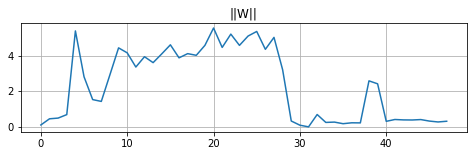

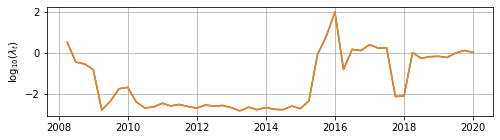

 RW:   0%|          | 0/48 [00:00<?, ?it/s]

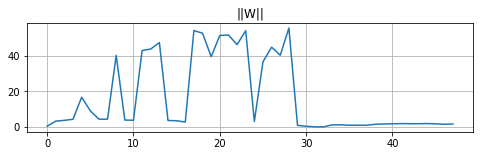

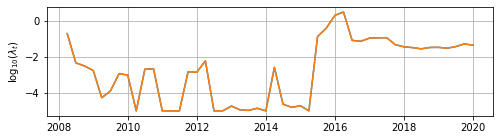

In [187]:
esnMulti_A_rw_multistep_for_2007 = esnMulti_rw_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]], 
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
)

esnMulti_B_rw_multistep_for_2007 = esnMulti_rw_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]],
    data=dataset2007,
    steps=8,
    direct=False,
    retune=True,
)

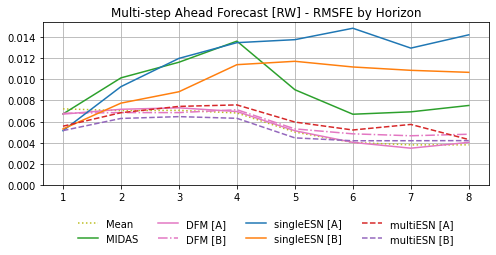

In [188]:
def hStepRMSFE_2007(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2007['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

plt.figure(figsize=(8, 3))
plt.grid()
#
plt.plot(hStepRMSFE_2007(UnMean_rw_multistep_for_2007), label="Mean", c="C8", ls=':') 
#
plt.plot(hStepRMSFE_2007(MIDAS_rw_multistep_for_2007), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2007(DFM_A_rw_multistep_for_2007), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2007(DFM_B_rw_multistep_for_2007), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2007(esnSingle_A_agg_rw_multistep_for_2007), label="singleESN [A]", c="C0") 
plt.plot(hStepRMSFE_2007(esnSingle_B_agg_rw_multistep_for_2007), label="singleESN [B]", c="C1") 
#
plt.plot(hStepRMSFE_2007(esnMulti_A_rw_multistep_for_2007), label="multiESN [A]", c="C3", ls='--') 
plt.plot(hStepRMSFE_2007(esnMulti_B_rw_multistep_for_2007), label="multiESN [B]", c="C4", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
plt.title("Multi-step Ahead Forecast [RW] - RMSFE by Horizon")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [189]:
table_RMSFE_multistep_rw_2007 = pd.DataFrame(
    index=range(1,9)
)
table_RMSFE_multistep_rw_2007.index.name = "RW_2007"
table_RMSFE_multistep_rw_2007["Model"] = ['Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
        'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
    ]

for h in range(8):
    ref_h_hStepRMSFE_rw = hStepRMSFE_2007(UnMean_rw_multistep_for_2007).iat[h,0]
    table_RMSFE_multistep_rw_2007[str(h+1)] = [
        hStepRMSFE_2007(UnMean_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(MIDAS_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(DFM_A_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(DFM_B_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(esnSingle_A_agg_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(esnSingle_B_agg_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(esnMulti_A_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2007(esnMulti_B_rw_multistep_for_2007).iat[h,0] / ref_h_hStepRMSFE_rw,
    ]

table_RMSFE_multistep_rw_2007.round(3)

,Model,1,2,3,4,5,6,7,8
RW_2007,,,,,,,,,
1,Mean,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
2,MIDAS,0.933,1.438,1.642,1.993,1.794,1.661,1.816,1.973
3,DFM [A],0.931,1.017,1.033,1.020,1.024,1.003,0.918,1.062
4,DFM [B],0.942,0.973,0.970,1.045,1.059,1.203,1.225,1.263
5,singleESN [A],0.714,1.320,1.693,1.972,2.733,3.669,3.391,3.719
6,singleESN [B],0.737,1.100,1.248,1.667,2.327,2.765,2.842,2.792
7,multiESN [A],0.773,0.972,1.053,1.111,1.187,1.293,1.505,1.131
8,multiESN [B],0.716,0.895,0.916,0.926,0.890,1.041,1.102,1.105


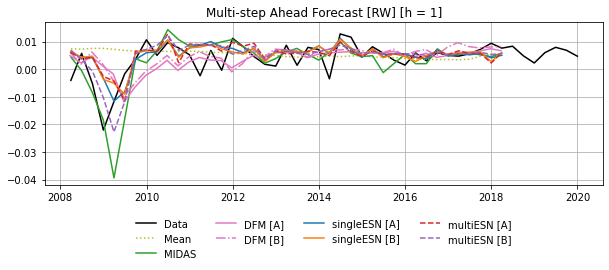

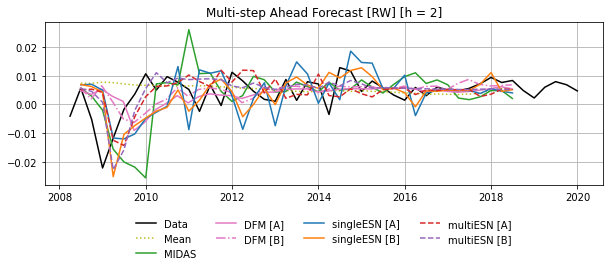

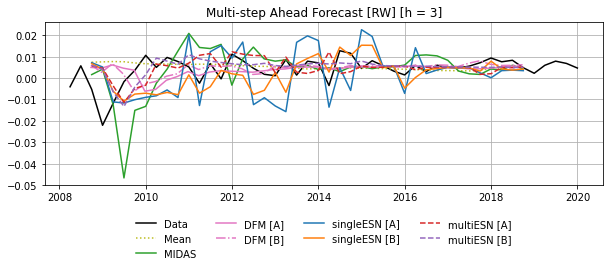

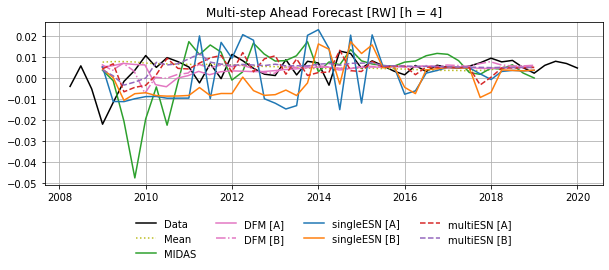

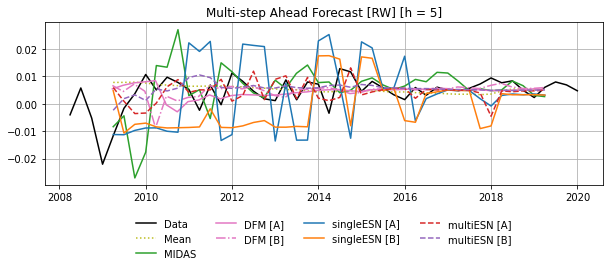

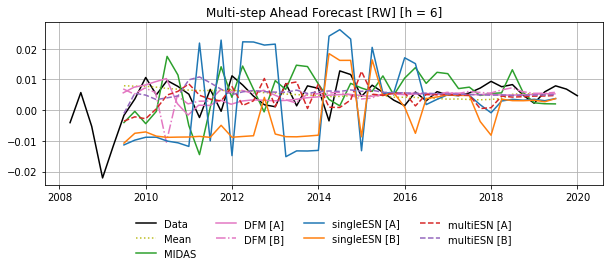

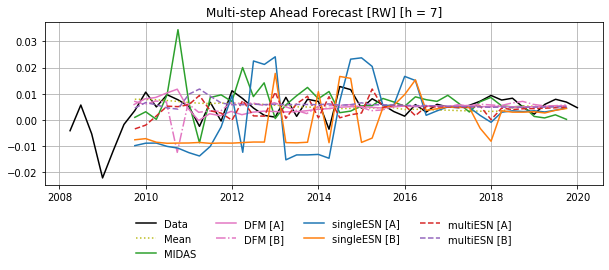

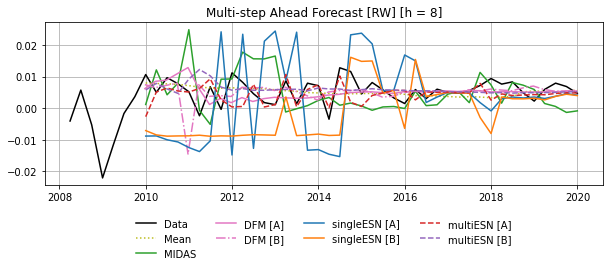

In [190]:
steps = 8
T = len(dataset2007['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2007['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8", ls=':') 
    #
    plt.plot(MIDAS_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C1") 
    #
    plt.plot(esnMulti_A_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3", ls='--') 
    plt.plot(esnMulti_B_rw_multistep_for_2007[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C4", ls='--')
    #
    plt.title("Multi-step Ahead Forecast [RW]" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=4)
    plt.show()

Export multi-horizon losses:

In [333]:
mhmcs_steps = 8
mhmcs_multistep_rw_2007 = xr.DataArray(
     data=np.zeros(
        (mhmcs_steps, len(dataset2007['GDP_data_test']) - mhmcs_steps, 8)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_rw_2007[h, :, :] = (
        np.c_[
            UnMean_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_rw_multistep_for_2007[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2007['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [334]:
mhmcs_multistep_rw_2007_df = mhmcs_multistep_rw_2007.to_dataframe(
    name="Loss", dim_order=['M0', 'H', 'T']
)
mhmcs_multistep_rw_2007_df.to_csv(
    os.path.join(path_folder, "R", "mhmcs_small_multistep_rw_2007.csv")
)

### Post-Crisis Model Evaluation

In [108]:
dataset2011 = getSmallDatasets('2011-12-31')

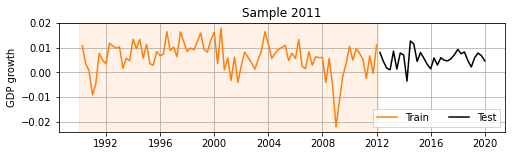

In [373]:
plt.figure(figsize=(8,2))
plt.axvspan(pd.to_datetime("01-01-1990"), pd.to_datetime("01-31-2012"),
                color="C1", alpha=0.1)
plt.plot(dataset2011['GDP_data_train'], label="Train", color="C1")
plt.plot(dataset2011['GDP_data_test'], color="black", label="Test")
plt.ylabel("GDP growth")
plt.grid()
plt.legend(loc="lower right", fancybox=False, shadow=False, ncol=2)
plt.title("Sample 2011")
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_train_sample_2011.pdf'), bbox_inches="tight")
plt.show()

##### ESN Ridge CV

Get 'extended' dataset to have enough CV data:

In [109]:
dataset2011_ext = getSmallDatasets_extended(
    '1975-01-01', '2019-12-31', trainTestSplitDate='2011-12-31'
)

Single ESN:

In [195]:
#esnSingle_A_cv10_lambda_2011 = esnSingle_A.ridge_lambda_cv(
#    Y=dataset2011_ext['GDP_fill_data_train'], z=(dataset2011_ext['md_fill_data_train'], ),
#    method="ridge-isotropic",
#    cv_options="-cv:10-test_size:5",
#    #cv_options="-cv_min_split_size:50-cv_max_split_size:50-test_size:1",
#    steps=1,
#    debug=True,
#)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


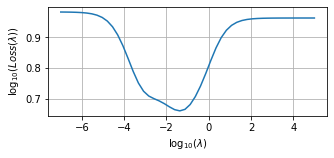

+ s = 0 --------------------
Best solution found:
lambda = [0.04286684]
F      = 4.589083633826376


In [110]:
# Aggregated
esnSingle_A_agg_cv10_lambda_2011 = esnSingle_A.ridge_lambda_cv(
    Y=dataset2011_ext['GDP_fill_data_train'], z=(dataset2011_ext['md_fill_agg_data_train'], ),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

In [197]:
#esnSingle_B_cv10_lambda_2011 = esnSingle_B.ridge_lambda_cv(
#    Y=dataset2011_ext['GDP_fill_data_train'], z=(dataset2011_ext['md_fill_data_train'], ),
#    method="ridge-isotropic",
#    cv_options="-cv:10-test_size:5",
#    #cv_options="-cv_min_split_size:70-cv_max_split_size:70-test_size:1",
#    steps=1,
#    debug=True,
#)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


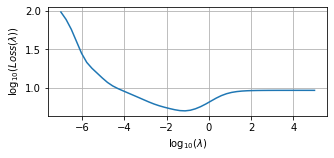

+ s = 0 --------------------
Best solution found:
lambda = [0.06804393]
F      = 4.940154024836524


In [111]:
esnSingle_B_agg_cv10_lambda_2011 = esnSingle_B.ridge_lambda_cv(
    Y=dataset2011_ext['GDP_fill_data_train'], z=(dataset2011_ext['md_fill_agg_data_train'], ),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

Multi ESN:

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


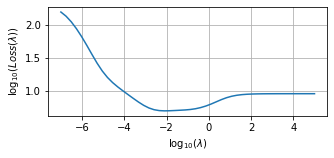

+ s = 0 --------------------
Best solution found:
lambda = [0.00839454]
F      = 5.06864339637799


In [112]:
esnMulti_A_cv10_lambda_2011 = esnMulti_A.ridge_lambda_cv(
    Y=dataset2011_ext['GDP_data_train'], 
    z=(dataset2011_ext['m_data_train'], dataset2011_ext['d_data_train']),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    steps=1,
    debug=True,
)

ESNMultiFrequency.ridge_lambda_cv()
. Method:
['ridge']
['isotropic']
[]
. CV Options:
['cv', 'test_size']
['10', '5']
. Folds built


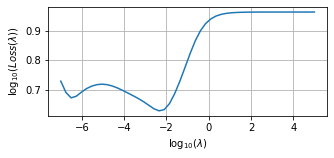

+ s = 0 --------------------
Best solution found:
lambda = [0.00503101]
F      = 4.257986356045738


In [113]:
esnMulti_B_cv10_lambda_2011 = esnMulti_B.ridge_lambda_cv(
    Y=dataset2011_ext['GDP_data_train'], 
    z=(dataset2011_ext['m_data_train'], dataset2011_ext['d_data_train']),
    method="ridge-isotropic",
    cv_options="-cv:10-test_size:5",
    #cv_options="-cv_min_split_size:70-cv_max_split_size:70-test_size:1",
    steps=1,
    Lambda0=1e-2,
    debug=True,
)

#### Fit

In [201]:
#MIDAS_fit_1sa_2011 = MIDAS_model.fixedparamsForecast(
#    data=(dataset2011['GDP_data_midas'], dataset2011['md_data_midas']),
#    fit_length=len(dataset2011['GDP_data_train']),
#    steps=1,
#    grad=True,
#    method='L-BFGS-B',
#    debug=False
#)

In [202]:
## (A)
#esnSingle_A_fit_1sa_2011 = esnSingle_A.fit(
#    Y=dataset2011['GDP_fill_data_train'], z=(dataset2011['md_fill_data_train'], ), 
#    method='ridge',
#    Lambda=[1e-2, ],
#    #Lambda=esnSingle_A_cv10_lambda_2011,
#    full=True, 
#    debug=False,
#)
#
##(B)
#esnSingle_B_fit_1sa_2011 = esnSingle_B.fit(
#    Y=dataset2011['GDP_fill_data_train'], z=(dataset2011['md_fill_data_train'], ), 
#    method='ridge',
#    Lambda=[1e-2, ],
#    #Lambda=esnSingle_B_cv10_lambda_2011,
#    full=True, 
#    debug=False,
#)

In [203]:
## Aggregated data (only for esnSingle models)
## (A)
#esnSingle_A_agg_fit_1sa_2011 = esnSingle_A.fit(
#    Y=dataset2011['GDP_fill_data_train'], z=(dataset2011['md_fill_agg_data_train'], ), 
#    method='ridge',
#    Lambda=esnSingle_A_agg_cv10_lambda_2011,
#    full=True, 
#    debug=False,
#)
#
##(B)
#esnSingle_B_agg_fit_1sa_2011 = esnSingle_B.fit(
#    Y=dataset2011['GDP_fill_data_train'], z=(dataset2011['md_fill_agg_data_train'], ), 
#    method='ridge',
#    Lambda=esnSingle_B_agg_cv10_lambda_2011,
#    full=True, 
#    debug=False,
#)

In [204]:
## (A)
#esnMulti_A_fit_1sa_2011 = esnMulti_A.fit(
#    Y=dataset2011['GDP_data_train'], z=(dataset2011['m_data_train'], dataset2011['d_data_train']), 
#    method='ridge',
#    #Lambda=[1e-2, 1e-2],
#    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]],
#    full=True, 
#    debug=False
#)
#
##(B)
#esnMulti_B_fit_1sa_2011 = esnMulti_B.fit(
#    Y=dataset2011['GDP_data_train'], z=(dataset2011['m_data_train'], dataset2011['d_data_train']), 
#    method='ridge',
#    #Lambda=[1e-2, 1e-2],
#    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]],
#    full=True, 
#    debug=False
#)

#### 1-step Ahead Point Forecast Comparison

##### Fixed Parameters

In [205]:
# External DFM forecasts
#DFM_A_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1, 4, 12]_fixed__2011', 'q_test_12.csv'),
#    parse_dates = [0])
#DFM_A_forecast.columns.values[0] = 'Date'
#DFM_A_forecast_2011 = (DFM_A_forecast.set_index('Date')['2012-01-01':'2019-12-31'])[['Q1_test_pred']]
#
#DFM_B_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1, 4, 12]_fixed__2011', 'q_test_12.csv'),
#    parse_dates = [0])
#DFM_B_forecast.columns.values[0] = 'Date'
#DFM_B_forecast_2011 = (DFM_B_forecast.set_index('Date')['2012-01-01':'2019-12-31'])[['Q1_test_pred']]

#DFM_A_fix_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1]_fixed__2011', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_A_fix_forecast_2011 = DFM_A_fix_forecast[['0']].loc[DFM_slice_2011,]
#
#DFM_B_fix_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1]_fixed__2011', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_B_fix_forecast_2011 = DFM_B_fix_forecast[['0']].loc[DFM_slice_2011,]

DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_fix_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_fixed__2011', date_slice=DFM_slice_2011,
)

DFM_B_fix_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_fixed__2011', date_slice=DFM_slice_2011,
)

In [206]:
UnMean_1sa_forecast_2011 = uncondMean_1sa_fixParamsForecast(
    data=dataset2011,
)

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

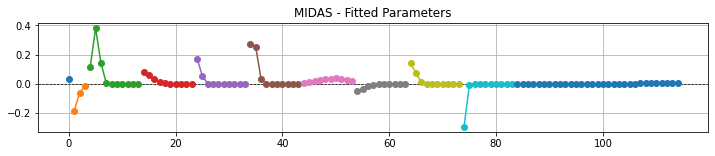

In [207]:
## Compute pointwise forecasts
#MIDAS_1sa_forecast_2011 = pd.DataFrame(
#    data=MIDAS_fit_1sa_2011['forecasts'][0]['Forecast'], 
#    index=dataset2011['GDP_data_test'].index,
#)

MIDAS_fix_for_1sa_2011 = MIDAS_fix_fit_1sa(
    midasModel=MIDAS_model,
    data=dataset2011,
)

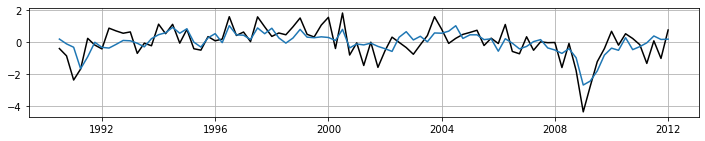

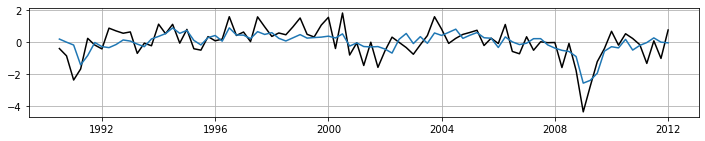

In [208]:
## Aggregated singleESNs
#esnSingle_A_agg_for_1sa_2011 = esnSingle_A.fixedParamsForecast(
#    Yf=dataset2011['GDP_fill_data_test'], zf=(dataset2011['md_fill_agg_data_test'], ), 
#    fit=esnSingle_A_agg_fit_1sa_2011
#)['Forecast'][0]['Y_for']
#
#esnSingle_B_agg_for_1sa_2011 = esnSingle_B.fixedParamsForecast(
#    Yf=dataset2011['GDP_fill_data_test'], zf=(dataset2011['md_fill_agg_data_test'], ), 
#    fit=esnSingle_B_agg_fit_1sa_2011
#)['Forecast'][0]['Y_for']

esnSingle_A_agg_fix_for_1sa_2011 = esnSingle_fix_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    #Lambda=[1e-2,],
    data=dataset2011,
    aggregate=True,
)

esnSingle_B_agg_fix_for_1sa_2011 = esnSingle_fix_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    #Lambda=[1e-2,],
    data=dataset2011,
    aggregate=True,
)

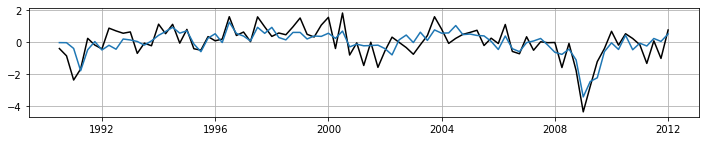

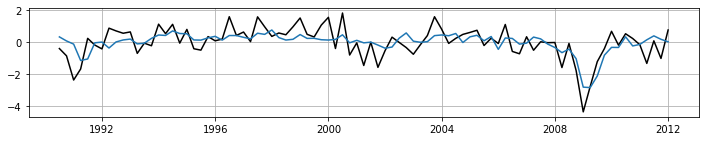

In [209]:
#esnMulti_A_for_1sa_2011 = esnMulti_A.fixedParamsForecast(
#    Yf=dataset2011['GDP_data_test'], zf=(dataset2011['m_data_test'], dataset2011['d_data_test']), 
#    fit=esnMulti_A_fit_1sa_2011
#)['Forecast'][0]['Y_for']
#
#esnMulti_B_for_1sa_2011 = esnMulti_B.fixedParamsForecast(
#    Yf=dataset2011['GDP_data_test'], zf=(dataset2011['m_data_test'], dataset2011['d_data_test']), 
#    fit=esnMulti_B_fit_1sa_2011
#)['Forecast'][0]['Y_for']

esnMulti_A_fix_for_1sa_2011 = esnMulti_fix_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    #Lambda=[1e-2, 1e-2],
    data=dataset2011,
)

esnMulti_B_fix_for_1sa_2011 = esnMulti_fix_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
)

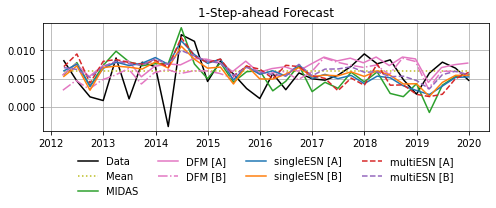

In [210]:
# Plot
plt.figure(figsize=(8, 2))
plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_1sa_forecast_2011, label="Mean", c="C8", ls=':')
#
plt.plot(MIDAS_fix_for_1sa_2011, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_fix_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_fix_forecast_2011, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_fix_for_1sa_2011, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_fix_for_1sa_2011, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_fix_for_1sa_2011, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_fix_for_1sa_2011, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_2011.pdf'), bbox_inches="tight")
plt.show()

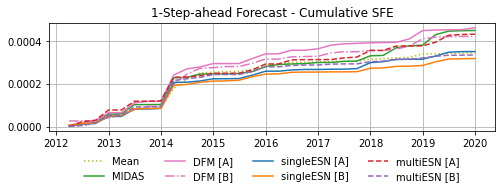

In [211]:
cumulSFE_2011 = lambda forecast : np.cumsum(np.square(dataset2011['GDP_data_test'] - forecast.to_numpy()))

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2011(UnMean_1sa_forecast_2011), label="Mean", c="C8", ls=':') 
#
plt.plot(cumulSFE_2011(MIDAS_fix_for_1sa_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2011(DFM_A_fix_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2011(DFM_B_fix_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulSFE_2011(esnSingle_A_agg_fix_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2011(esnSingle_B_agg_fix_for_1sa_2011), label="singleESN [B]", c="C1") 
#
plt.plot(cumulSFE_2011(esnMulti_A_fix_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulSFE_2011(esnMulti_B_fix_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
#plt.yscale('log')
plt.title("1-Step-ahead Forecast - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_2011.pdf'), bbox_inches="tight")
plt.show()

In [212]:
def MSFE_2011(forecast, startDate=None):
    if not startDate is None:
        startDate = pd.to_datetime(startDate)
        msfe = np.mean(np.square(
                dataset2011['GDP_data_test'].loc[startDate:,].to_numpy() - 
                    forecast.loc[startDate:,].to_numpy()
            ))
    else:
        msfe = np.mean(np.square(
                dataset2011['GDP_data_test'].to_numpy() - forecast.to_numpy()
            ))
    return msfe

MIDAS_MSE_fix_2011_td = MSFE_2011(MIDAS_fix_for_1sa_2011) * 1e4
UnMean_MSE_fix_2011_td = MSFE_2011(UnMean_1sa_forecast_2011) * 1e4
DFM_A_MSE_fix_2011_td = MSFE_2011(DFM_A_fix_forecast_2011) * 1e4
DMF_B_MSE_fix_2011_td = MSFE_2011(DFM_B_fix_forecast_2011) * 1e4
esnSingle_A_MSE_fix_2011_td = MSFE_2011(esnSingle_A_agg_fix_for_1sa_2011) * 1e4
esnSingle_B_MSE_fix_2011_td = MSFE_2011(esnSingle_B_agg_fix_for_1sa_2011) * 1e4
esnMulti_A_MSE_fix_2011_td = MSFE_2011(esnMulti_A_fix_for_1sa_2011) * 1e4
esnMulti_B_MSE_fix_2011_td = MSFE_2011(esnMulti_B_fix_for_1sa_2011) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"MIDAS \t\t = {MIDAS_MSE_fix_2011_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_fix_2011_td).round(4)}")
print(f"Mean \t\t = {UnMean_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_fix_2011_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_fix_2011_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_fix_2011_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_fix_2011_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_fix_2011_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_fix_2011_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_fix_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_fix_2011_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
MIDAS 		 = 0.1406 	|	0.375
Mean 		 = 0.1082 	|	0.3289
DFM [A]		 = 0.1446 	|	0.3803
DFM [B]		 = 0.1321 	|	0.3634
singleESN [A]	 = 0.1098 	|	0.3314
singleESN [B]	 = 0.0996 	|	0.3156
multiESN [A]	 = 0.1353 	|	0.3678
multiESN [B]	 = 0.1048 	|	0.3238


In [213]:
ref_MSE_2011_fix = UnMean_MSE_fix_2011_td
MIDAS_MSE_toRef_2011_fix = MIDAS_MSE_fix_2011_td / ref_MSE_2011_fix
DFM_A_MSE_toRef_2011_fix = DFM_A_MSE_fix_2011_td / ref_MSE_2011_fix
DMF_B_MSE_toRef_2011_fix = DMF_B_MSE_fix_2011_td / ref_MSE_2011_fix
esnSingle_A_MSE_toRef_2011_fix = esnSingle_A_MSE_fix_2011_td / ref_MSE_2011_fix
esnSingle_B_MSE_toRef_2011_fix = esnSingle_B_MSE_fix_2011_td / ref_MSE_2011_fix
esnMulti_A_MSE_toRef_2011_fix = esnMulti_A_MSE_fix_2011_td / ref_MSE_2011_fix
esnMulti_B_MSE_toRef_2011_fix = esnMulti_B_MSE_fix_2011_td / ref_MSE_2011_fix

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2011_fix.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2011_fix.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2011_fix.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2011_fix.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2011_fix.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2011_fix.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2011_fix.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
MIDAS 		 = 1.3
DFM [A]		 = 1.3369
DFM [B]		 = 1.2207
singleESN [A]	 = 1.0151
singleESN [B]	 = 0.9206
multiESN [A]	 = 1.2504
multiESN [B]	 = 0.969


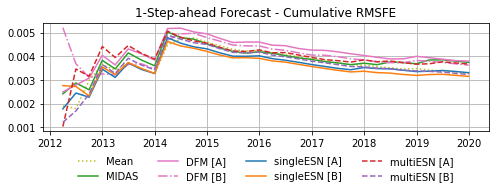

In [214]:
def cumulRMSFE_2011(forecast):
    cumulSFE = np.cumsum(np.square(dataset2011['GDP_data_test'] - forecast.to_numpy()))
    return np.sqrt(cumulSFE / np.reshape(np.arange(1, len(forecast)+1), (-1, 1)))

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2011(UnMean_1sa_forecast_2011), label="Mean", c="C8", ls=':') 
#
plt.plot(cumulRMSFE_2011(MIDAS_fix_for_1sa_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2011(DFM_A_fix_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2011(DFM_B_fix_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2011(esnSingle_A_agg_fix_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2011(esnSingle_B_agg_fix_for_1sa_2011), label="singleESN [B]", c="C1") 
#
#plt.plot(cumulRMSFE_2011(esnSingle_A_agg_for_1sa_2011), label="singleESN [A] agg", c="C0", ls='-.') 
#plt.plot(cumulRMSFE_2011(esnSingle_B_agg_for_1sa_2011), label="singleESN [B] agg", c="C1", ls='-.') 
#
plt.plot(cumulRMSFE_2011(esnMulti_A_fix_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulRMSFE_2011(esnMulti_B_fix_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_2011.pdf'), bbox_inches="tight")
plt.show()

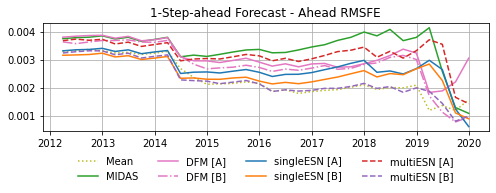

In [215]:
def aheadRMSFE_2011(forecast):
    fSFE = np.flip(np.square(dataset2011['GDP_data_test'].to_numpy() - forecast.to_numpy()))
    aheadSFE = np.sqrt(np.cumsum(fSFE) / np.arange(1, len(forecast)+1))
    return pd.DataFrame(data=np.flip(aheadSFE), index=dataset2011['GDP_data_test'].index)

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2011(UnMean_1sa_forecast_2011), label="Mean", c="C8", ls=':') 
#
plt.plot(aheadRMSFE_2011(MIDAS_fix_for_1sa_2011), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2011(DFM_A_fix_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2011(DFM_B_fix_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2011(esnSingle_A_agg_fix_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2011(esnSingle_B_agg_fix_for_1sa_2011), label="singleESN [B]", c="C1") 
#
plt.plot(aheadRMSFE_2011(esnMulti_A_fix_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(aheadRMSFE_2011(esnMulti_B_fix_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_2011.pdf'), bbox_inches="tight")
plt.show()

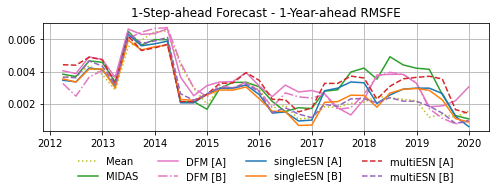

In [216]:
def YA_RMSFE_2011(forecast):
    SFE = np.square(dataset2011['GDP_data_test'].to_numpy() - forecast.to_numpy())
    T = len(SFE)
    YA_RMSFE = np.array(
        [np.sqrt(np.mean(SFE[j:min(j+4,T)])) for j in range(T)]
    )
    return pd.DataFrame(data=YA_RMSFE, index=dataset2011['GDP_data_test'].index)

plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2011(UnMean_1sa_forecast_2011), label="Mean", c="C8", ls=':') 
#
plt.plot(YA_RMSFE_2011(MIDAS_fix_for_1sa_2011), label="MIDAS", c="C2") 
#
plt.plot(YA_RMSFE_2011(DFM_A_fix_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2011(DFM_B_fix_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2011(esnSingle_A_agg_fix_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2011(esnSingle_B_agg_fix_for_1sa_2011), label="singleESN [B]", c="C1") 
#
plt.plot(YA_RMSFE_2011(esnMulti_A_fix_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(YA_RMSFE_2011(esnMulti_B_fix_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_2011.pdf'), bbox_inches="tight")
plt.show()

In [341]:
mcs_data_2011_fix = pd.DataFrame(
    np.c_[UnMean_1sa_forecast_2011,
        MIDAS_fix_for_1sa_2011, 
        DFM_A_fix_forecast_2011,
        DFM_B_fix_forecast_2011,
        esnSingle_A_agg_fix_for_1sa_2011,
        esnSingle_B_agg_fix_for_1sa_2011,
        esnMulti_A_fix_for_1sa_2011,
        esnMulti_B_fix_for_1sa_2011,
    ],
    columns=['Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]']
)
mcs_data_2011_fix = (mcs_data_2011_fix - dataset2011['GDP_data_test'].to_numpy())

mcs_25_2011_fix = ModelConfidenceSet(
    data=np.square(mcs_data_2011_fix), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2011_fix = ModelConfidenceSet(
    data=np.square(mcs_data_2011_fix), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2011_fix.included}")
print(f"MCS 10 included: {mcs_10_2011_fix.included}")

MCS 25 included: ['DFM [B]', 'singleESN [A]', 'Mean', 'multiESN [B]', 'singleESN [B]']
MCS 10 included: ['DFM [B]', 'singleESN [A]', 'Mean', 'multiESN [B]', 'singleESN [B]']


In [342]:
mcs_25_2011_fix.pvalues

DFM [A]          0.0152
MIDAS            0.0152
multiESN [A]     0.0152
DFM [B]          0.3630
singleESN [A]    0.3630
Mean             0.8168
multiESN [B]     0.8168
singleESN [B]    1.0000
dtype: float64

In [343]:
mcs_data_2011_fix.to_csv(
    os.path.join(path_folder, "R", "mcs_small_fix_2011.csv")
)

In [220]:
#def wasserstein1_2011(forecast):
#    xs = dataset2011['GDP_data_test'].to_numpy().reshape((-1, 1))
#    xt = forecast.to_numpy().reshape((-1, 1))
#    n = len(xs)
#    # Distance matrix
#    M = ot.dist(xs, xt, metric='euclidean')
#    M /= M.max()
#    # Uniform distribution on samples
#    a, b = np.ones((n,)) / n, np.ones((n,)) / n
#    return ot.emd2(a, b, M)
#
#def wasserstein2_2011(forecast):
#    xs = dataset2011['GDP_data_test'].to_numpy().reshape((-1, 1))
#    xt = forecast.to_numpy().reshape((-1, 1))
#    n = len(xs)
#    # Distance matrix
#    M = ot.dist(xs, xt)
#    M /= M.max()
#    # Uniform distribution on samples
#    a, b = np.ones((n,)) / n, np.ones((n,)) / n
#    return np.sqrt(ot.emd2(a, b, M))

In [221]:
#print("Wasserstein 1 distance forecast / test data:")
#print(f"MIDAS: \t\t {wasserstein1_2011(MIDAS_1sa_forecast_2011):.4f}")
#print(f"DFM [A]: \t {wasserstein1_2011(DFM_A_forecast_2011):.4f}")
#print(f"DFM [B]: \t {wasserstein1_2011(DFM_B_forecast_2011):.4f}")
#print(f"singleESN [A]: \t {wasserstein1_2011(esnSingle_A_agg_for_1sa_2011):.4f}")
#print(f"singleESN [B]: \t {wasserstein1_2011(esnSingle_B_agg_for_1sa_2011):.4f}")
#print(f"multiESN [A]: \t {wasserstein1_2011(esnMulti_A_for_1sa_2011):.4f}")
#print(f"multiESN [B]: \t {wasserstein1_2011(esnMulti_B_for_1sa_2011):.4f}")

In [222]:
#print("Wasserstein 2 distance forecast / test data:")
#print(f"MIDAS: \t\t {wasserstein2_2011(MIDAS_1sa_forecast_2011):.4f}")
#print(f"DFM [A]: \t {wasserstein2_2011(DFM_A_forecast_2011):.4f}")
#print(f"DFM [B]: \t {wasserstein2_2011(DFM_B_forecast_2011):.4f}")
#print(f"singleESN [A]: \t {wasserstein2_2011(esnSingle_A_agg_for_1sa_2011):.4f}")
#print(f"singleESN [B]: \t {wasserstein2_2011(esnSingle_B_agg_for_1sa_2011):.4f}")
#print(f"multiESN [A]: \t {wasserstein2_2011(esnMulti_A_for_1sa_2011):.4f}")
#print(f"multiESN [B]: \t {wasserstein2_2011(esnMulti_B_for_1sa_2011):.4f}")

In [223]:
#plt.figure(figsize=(10, 3))
#ax1 = plt.subplot(1,2,1)
#ax1.hist(dataset2011['GDP_data_test'].to_numpy(), label="Data", color='k')
#ax1.hist(MIDAS_1sa_forecast_2011.to_numpy(), label="MIDAS", color='C2', alpha=0.8)
#ax1.grid()
#ax1.legend()
#ax2 = plt.subplot(1,2,2)
#ax2.hist(dataset2011['GDP_data_test'].to_numpy(), label="Data", color='k')
#ax2.hist(esnMulti_B_for_1sa_2011.to_numpy(), label="multiESN [B]", color='C4', alpha=0.8)
#ax2.grid()
#ax2.legend()
#plt.show()

##### Expanding Window

In [224]:
#DFM_A_ew_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1, 4, 12]_expanding__2011', 'q_test_12.csv'),
#    parse_dates = [0])
#DFM_A_ew_forecast.columns.values[0] = 'Date'
#DFM_A_ew_forecast_2011 = (DFM_A_ew_forecast.set_index('Date')['2012-01-01':'2019-12-31'])[['Q1_test_pred']]
#
#DFM_B_ew_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1, 4, 12]_expanding__2011', 'q_test_12.csv'),
#    parse_dates = [0])
#DFM_B_ew_forecast.columns.values[0] = 'Date'
#DFM_B_ew_forecast_2011 = (DFM_B_ew_forecast.set_index('Date')['2012-01-01':'2019-12-31'])[['Q1_test_pred']]

#DFM_A_ew_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1]_expanding__2011', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_A_ew_forecast_2011 = DFM_A_ew_forecast[['0']].loc[DFM_slice_2011,]
#
#DFM_B_ew_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1]_expanding__2011', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_B_ew_forecast_2011 = DFM_B_ew_forecast[['0']].loc[DFM_slice_2011,]

DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_ew_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_expanding__2011', date_slice=DFM_slice_2011,
)

DFM_B_ew_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_expanding__2011', date_slice=DFM_slice_2011,
)

In [225]:
UnMean_ew_1sa_forecast_2011 = uncondMean_ew_1sa_Forecast(
    data=dataset2011,
)

In [226]:
MIDAS_ew_1sa_forecast_2011 = MIDAS_ew_fit_1sa(
    midasModel=MIDAS_model, 
    data=dataset2011,
)

 EW:   0%|          | 0/32 [00:00<?, ?it/s]

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


In [227]:
## Expanding window
#MIDAS_ew_fit_1sa_2011 = ExpandingWindow(
#    model=MIDAS_model, 
#    minlength=len(dataset2011['GDP_data_train'])
#).expandingWindowForecast(
#    data=(dataset2011['GDP_data_midas'], dataset2011['md_data_midas']), 
#    steps=1,
#    #spec={'grad': False, 'method': 'nls'},
#    spec={'grad': True, 'method': 'L-BFGS-B'},
#    debug=False
#)
#
#MIDAS_ew_1sa_forecast_2011 = pd.DataFrame(
#    data=np.array(
#        [MIDAS_ew_fit_1sa_2011['forecasts'][j][0]['Forecast'][0] 
#            for j in range(len(dataset2011['GDP_data_test']))]
#    ),
#    index=dataset2011['GDP_data_test'].index,
#)

 EW:   0%|          | 0/32 [00:00<?, ?it/s]

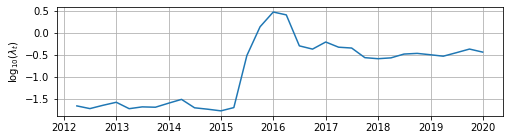

 EW:   0%|          | 0/32 [00:00<?, ?it/s]

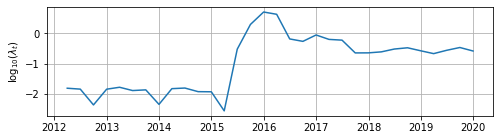

In [228]:
esnSingle_A_agg_ew_for_1sa_2011 = esnSingle_ew_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_ew_for_1sa_2011 = esnSingle_ew_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

 EW:   0%|          | 0/32 [00:00<?, ?it/s]

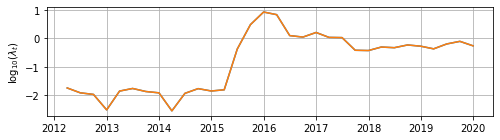

 EW:   0%|          | 0/32 [00:00<?, ?it/s]

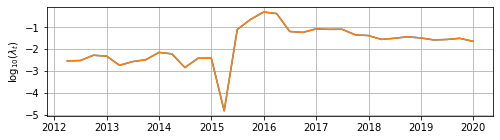

In [229]:
esnMulti_A_ew_for_1sa_2011 = esnMulti_ew_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

esnMulti_B_ew_for_1sa_2011 = esnMulti_ew_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

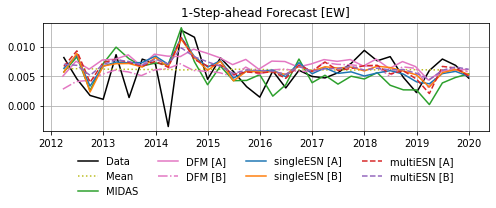

In [346]:
# Plot -- 1-Step-ahead Forecast
plt.figure(figsize=(8, 2))
plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_ew_1sa_forecast_2011, label="Mean", c="C8", ls=':')
#
plt.plot(MIDAS_ew_1sa_forecast_2011, label="MIDAS", c="C2", ls='-') 
#
plt.plot(DFM_A_ew_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_ew_forecast_2011, label="DFM [B]", c="C6", ls='-.')  
#
plt.plot(esnSingle_A_agg_ew_for_1sa_2011, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_ew_for_1sa_2011, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_ew_for_1sa_2011, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_ew_for_1sa_2011, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_ew_2011.pdf'), bbox_inches="tight")
plt.show()

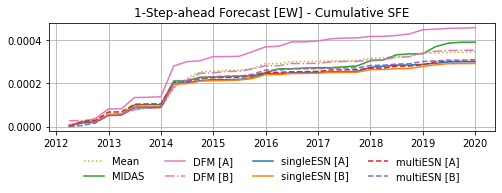

In [347]:
# Plot -- 1-Step-ahead Forecast - Cumulative SFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2011(UnMean_ew_1sa_forecast_2011), label="Mean", c="C8", ls=':')
#
plt.plot(cumulSFE_2011(MIDAS_ew_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2011(DFM_A_ew_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2011(DFM_B_ew_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulSFE_2011(esnSingle_A_agg_ew_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2011(esnSingle_B_agg_ew_for_1sa_2011), label="singleESN [B]", c="C1") 
#
plt.plot(cumulSFE_2011(esnMulti_A_ew_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulSFE_2011(esnMulti_B_ew_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
#
plt.title("1-Step-ahead Forecast [EW] - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_ew_2011.pdf'), bbox_inches="tight")
plt.show()

In [232]:
MIDAS_MSE_ew_2011_td = MSFE_2011(MIDAS_ew_1sa_forecast_2011)  * 1e4
UnMean_MSE_ew_2011_td = MSFE_2011(UnMean_ew_1sa_forecast_2011) * 1e4
DFM_A_MSE_ew_2011_td = MSFE_2011(DFM_A_ew_forecast_2011) * 1e4
DMF_B_MSE_ew_2011_td = MSFE_2011(DFM_B_ew_forecast_2011) * 1e4
esnSingle_A_MSE_ew_2011_td = MSFE_2011(esnSingle_A_agg_ew_for_1sa_2011) * 1e4
esnSingle_B_MSE_ew_2011_td = MSFE_2011(esnSingle_B_agg_ew_for_1sa_2011) * 1e4
esnMulti_A_MSE_ew_2011_td = MSFE_2011(esnMulti_A_ew_for_1sa_2011) * 1e4
esnMulti_B_MSE_ew_2011_td = MSFE_2011(esnMulti_B_ew_for_1sa_2011) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"MIDAS \t\t = {MIDAS_MSE_ew_2011_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_ew_2011_td).round(4)}")
print(f"Mean \t\t = {UnMean_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_ew_2011_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_ew_2011_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_ew_2011_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_ew_2011_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_ew_2011_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_ew_2011_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_ew_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_ew_2011_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
MIDAS 		 = 0.1221 	|	0.3494
Mean 		 = 0.1082 	|	0.3289
DFM [A]		 = 0.1429 	|	0.378
DFM [B]		 = 0.1106 	|	0.3325
singleESN [A]	 = 0.0939 	|	0.3064
singleESN [B]	 = 0.0913 	|	0.3021
multiESN [A]	 = 0.0946 	|	0.3076
multiESN [B]	 = 0.0968 	|	0.3111


In [233]:
ref_MSE_2011_ew = UnMean_MSE_ew_2011_td
MIDAS_MSE_toRef_2011_ew = MIDAS_MSE_ew_2011_td / ref_MSE_2011_ew
DFM_A_MSE_toRef_2011_ew = DFM_A_MSE_ew_2011_td / ref_MSE_2011_ew
DMF_B_MSE_toRef_2011_ew = DMF_B_MSE_ew_2011_td / ref_MSE_2011_ew
esnSingle_A_MSE_toRef_2011_ew = esnSingle_A_MSE_ew_2011_td / ref_MSE_2011_ew
esnSingle_B_MSE_toRef_2011_ew = esnSingle_B_MSE_ew_2011_td / ref_MSE_2011_ew
esnMulti_A_MSE_toRef_2011_ew = esnMulti_A_MSE_ew_2011_td / ref_MSE_2011_ew
esnMulti_B_MSE_toRef_2011_ew = esnMulti_B_MSE_ew_2011_td / ref_MSE_2011_ew

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2011_ew.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2011_ew.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2011_ew.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2011_ew.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2011_ew.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2011_ew.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2011_ew.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
MIDAS 		 = 1.1286
DFM [A]		 = 1.3205
DFM [B]		 = 1.0221
singleESN [A]	 = 0.8675
singleESN [B]	 = 0.8437
multiESN [A]	 = 0.8745
multiESN [B]	 = 0.8948


In [234]:
#ref_MSE_2011_ew = cumulSFE_2011(MIDAS_ew_1sa_forecast_2011).iloc[-1]
#UnMean_ew_MSE_toRef_2011 = cumulSFE_2011(UnMean_ew_1sa_forecast_2011).iloc[-1] / ref_MSE_2011_ew
#DFM_A_ew_MSE_toRef_2011 = cumulSFE_2011(DFM_A_ew_forecast_2011).iloc[-1] / ref_MSE_2011_ew
#DMF_B_ew_MSE_toRef_2011 = cumulSFE_2011(DFM_B_ew_forecast_2011).iloc[-1] / ref_MSE_2011_ew
#esnSingle_A_ew_MSE_toRef_2011 = cumulSFE_2011(esnSingle_A_ew_for_1sa_2011).iloc[-1] / ref_MSE_2011_ew
#esnSingle_B_ew_MSE_toRef_2011 = cumulSFE_2011(esnSingle_B_ew_for_1sa_2011).iloc[-1] / ref_MSE_2011_ew
#esnMulti_A_ew_MSE_toRef_2011 = cumulSFE_2011(esnMulti_A_ew_for_1sa_2011).iloc[-1] / ref_MSE_2011_ew
#esnMulti_B_ew_MSE_toRef_2011 = cumulSFE_2011(esnMulti_B_ew_for_1sa_2011).iloc[-1] / ref_MSE_2011_ew
#
#print("-------------------------- Relative MSFE -----------")
#print(f"MIDAS [EW] \t\t = {1.0}")
#print(f"Mean [EW] \t\t = {UnMean_ew_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"DFM [A] [EW]\t\t = {DFM_A_ew_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"DFM [B] [EW]\t\t = {DMF_B_ew_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"singleESN [A] [EW]\t = {esnSingle_A_ew_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"singleESN [B] [EW]\t = {esnSingle_B_ew_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"multiESN [A] [EW]\t = {esnMulti_A_ew_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"multiESN [B] [EW]\t = {esnMulti_B_ew_MSE_toRef_2011.iloc[0].round(4)}")

In [235]:
#MIDAS_MSE_ew_2011 = cumulSFE_2011(MIDAS_ew_1sa_forecast_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#UnMean_MSE_ew_2011 = cumulSFE_2011(UnMean_ew_1sa_forecast_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#DFM_A_MSE_ew_2011 = cumulSFE_2011(DFM_A_ew_forecast_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#DMF_B_MSE_ew_2011 = cumulSFE_2011(DFM_B_ew_forecast_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#esnSingle_A_MSE_ew_2011 = cumulSFE_2011(esnSingle_A_ew_for_1sa_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#esnSingle_B_MSE_ew_2011 = cumulSFE_2011(esnSingle_B_ew_for_1sa_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#esnMulti_A_MSE_ew_2011 = cumulSFE_2011(esnMulti_A_ew_for_1sa_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#esnMulti_B_MSE_ew_2011 = cumulSFE_2011(esnMulti_B_ew_for_1sa_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#
#print("--------------------------- MSFE -------------- RMSFE -----")
#print(f"MIDAS [EW] \t\t = {MIDAS_MSE_ew_2011.iloc[0].round(4)} \t|\t" 
#        f"{np.sqrt(MIDAS_MSE_ew_2011.iloc[0]).round(4)}")
#print(f"Mean [EW] \t\t = {UnMean_MSE_ew_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(UnMean_MSE_ew_2011.iloc[0]).round(4)}")
#print(f"DFM [A] [EW] \t\t = {DFM_A_MSE_ew_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(DFM_A_MSE_ew_2011.iloc[0]).round(4)}")
#print(f"DFM [B] [EW] \t\t = {DMF_B_MSE_ew_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(DMF_B_MSE_ew_2011.iloc[0]).round(4)}")
#print(f"singleESN [A] [EW] \t = {esnSingle_A_MSE_ew_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(esnSingle_A_MSE_ew_2011.iloc[0]).round(4)}")
#print(f"singleESN [B] [EW] \t = {esnSingle_B_MSE_ew_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(esnSingle_B_MSE_ew_2011.iloc[0]).round(4)}")
#print(f"multiESN [A] [EW] \t = {esnMulti_A_MSE_ew_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(esnMulti_A_MSE_ew_2011.iloc[0]).round(4)}")
#print(f"multiESN [B] [EW] \t = {esnMulti_B_MSE_ew_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(esnMulti_B_MSE_ew_2011.iloc[0]).round(4)}")

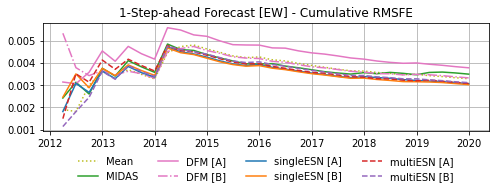

In [236]:
# Plot -- 1-Step-ahead Forecast - Cumulative RMSFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2011(UnMean_ew_1sa_forecast_2011), label="Mean", c="C8", ls=':')
#
plt.plot(cumulRMSFE_2011(MIDAS_ew_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2011(DFM_A_ew_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2011(DFM_B_ew_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2011(esnSingle_A_agg_ew_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2011(esnSingle_B_agg_ew_for_1sa_2011), label="singleESN [B]", c="C1") 
#
plt.plot(cumulRMSFE_2011(esnMulti_A_ew_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulRMSFE_2011(esnMulti_B_ew_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [EW] - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_ew_2011.pdf'), bbox_inches="tight")
plt.show()

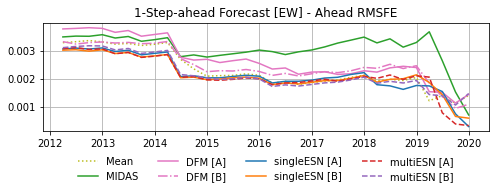

In [237]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2011(UnMean_ew_1sa_forecast_2011), label="Mean", c="C8", ls=':')
#
plt.plot(aheadRMSFE_2011(MIDAS_ew_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2011(DFM_A_ew_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2011(DFM_B_ew_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2011(esnSingle_A_agg_ew_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2011(esnSingle_B_agg_ew_for_1sa_2011), label="singleESN [B]", c="C1") 
#
plt.plot(aheadRMSFE_2011(esnMulti_A_ew_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(aheadRMSFE_2011(esnMulti_B_ew_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [EW] - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_ew_2011.pdf'), bbox_inches="tight")
plt.show()

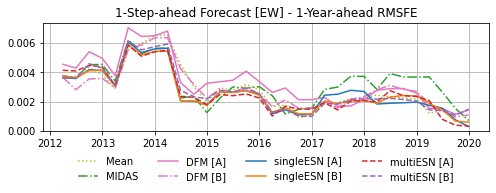

In [238]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2011(UnMean_ew_1sa_forecast_2011), label="Mean", c="C8", ls=':')
#
plt.plot(YA_RMSFE_2011(MIDAS_ew_1sa_forecast_2011), label="MIDAS", c="C2", ls='-.') 
#
plt.plot(YA_RMSFE_2011(DFM_A_ew_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2011(DFM_B_ew_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2011(esnSingle_A_agg_ew_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2011(esnSingle_B_agg_ew_for_1sa_2011), label="singleESN [B]", c="C1") 
#
plt.plot(YA_RMSFE_2011(esnMulti_A_ew_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(YA_RMSFE_2011(esnMulti_B_ew_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [EW] - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_ew_2011.pdf'), bbox_inches="tight")
plt.show()

In [323]:
mcs_data_2011_ew = pd.DataFrame(
    np.c_[UnMean_ew_1sa_forecast_2011,
        MIDAS_ew_1sa_forecast_2011, 
        DFM_A_ew_forecast_2011,
        DFM_B_ew_forecast_2011,
        esnSingle_A_agg_ew_for_1sa_2011,
        esnSingle_B_agg_ew_for_1sa_2011,
        esnMulti_A_ew_for_1sa_2011,
        esnMulti_B_ew_for_1sa_2011,
    ],
    columns=['Mean', 'MIDAS [EW]', 'DFM [A]', 'DFM [B]', 
                'singleESN [A] [EW]', 'singleESN [B] [EW]', 'multiESN [A] [EW]', 'multiESN [B] [EW]']
)
mcs_data_2011_ew = (mcs_data_2011_ew - dataset2011['GDP_data_test'].to_numpy())

mcs_25_2011_ew = ModelConfidenceSet(
    data=np.square(mcs_data_2011_ew), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2011_ew = ModelConfidenceSet(
    data=np.square(mcs_data_2011_ew), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2011_ew.included}")
print(f"MCS 10 included: {mcs_10_2011_ew.included}")

MCS 25 included: ['DFM [B]', 'Mean', 'multiESN [B] [EW]', 'multiESN [A] [EW]', 'singleESN [A] [EW]', 'singleESN [B] [EW]']
MCS 10 included: ['MIDAS [EW]', 'DFM [B]', 'Mean', 'multiESN [B] [EW]', 'multiESN [A] [EW]', 'singleESN [A] [EW]', 'singleESN [B] [EW]']


In [324]:
mcs_25_2011_ew.pvalues

DFM [A]               0.0033
MIDAS [EW]            0.1297
DFM [B]               0.7230
Mean                  0.7995
multiESN [B] [EW]     0.8511
multiESN [A] [EW]     0.8511
singleESN [A] [EW]    0.8511
singleESN [B] [EW]    1.0000
dtype: float64

In [325]:
mcs_data_2011_ew.to_csv(
    os.path.join(path_folder, "R", "mcs_small_ew_2011.csv")
)

##### Rolling Window

In [242]:
#DFM_A_rw_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1, 4, 12]_window__2011', 'q_test_12.csv'),
#    parse_dates = [0])
#DFM_A_rw_forecast.columns.values[0] = 'Date'
#DFM_A_rw_forecast_2011 = (DFM_A_rw_forecast.set_index('Date')['2012-01-01':'2019-12-31'])[['Q1_test_pred']]
#
#DFM_B_rw_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1, 4, 12]_window__2011', 'q_test_12.csv'),
#    parse_dates = [0])
#DFM_B_rw_forecast.columns.values[0] = 'Date'
#DFM_B_rw_forecast_2011 = (DFM_B_rw_forecast.set_index('Date')['2012-01-01':'2019-12-31'])[['Q1_test_pred']]

#DFM_A_rw_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'stock__5__6__[1]_window__2011', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_A_rw_forecast_2011 = DFM_A_rw_forecast[['0']].loc[DFM_slice_2011,]
#
#DFM_B_rw_forecast = pd.read_csv(
#    os.path.join(dfm_path, 'almon__5__6__[1]_window__2011', 'test_predictions_12.csv'),
#    parse_dates = [0, 1]).set_index('Target Date')
#DFM_B_rw_forecast_2011 = DFM_B_rw_forecast[['0']].loc[DFM_slice_2011,]

DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_rw_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_window__2011', date_slice=DFM_slice_2011,
)

DFM_B_rw_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_window__2011', date_slice=DFM_slice_2011,
)

In [243]:
UnMean_rw_1sa_forecast_2011 = uncondMean_rw_1sa_Forecast(
    data=dataset2011,
)

In [244]:
MIDAS_rw_1sa_forecast_2011 = MIDAS_rw_fit_1sa(
    midasModel=MIDAS_model, 
    data=dataset2011,
)

 RW:   0%|          | 0/32 [00:00<?, ?it/s]

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


In [245]:
## Expanding window
#MIDAS_rw_fit_1sa_2011 = RollingWindow(
#    model=MIDAS_model, 
#    length=len(dataset2011['GDP_data_train'])
#).rollingWindowForecast(
#    data=(dataset2011['GDP_data_midas'], dataset2011['md_data_midas']), 
#    steps=1,
#    #spec={'grad': False, 'method': 'nls'},
#    spec={'grad': True, 'method': 'L-BFGS-B'},
#    debug=False
#)
#
#MIDAS_rw_1sa_forecast_2011 = pd.DataFrame(
#    data=np.array(
#        [MIDAS_rw_fit_1sa_2011['forecasts'][j][0]['Forecast'][0] 
#            for j in range(len(dataset2011['GDP_data_test']))]
#    ),
#    index=dataset2011['GDP_data_test'].index,
#)

 RW:   0%|          | 0/32 [00:00<?, ?it/s]

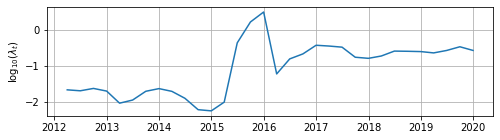

 RW:   0%|          | 0/32 [00:00<?, ?it/s]

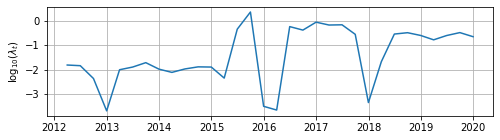

In [246]:
esnSingle_A_agg_rw_for_1sa_2011 = esnSingle_rw_fit_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_rw_for_1sa_2011 = esnSingle_rw_fit_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011,
    data=dataset2011,
    retune=True,
    aggregate=True,
)


 RW:   0%|          | 0/32 [00:00<?, ?it/s]

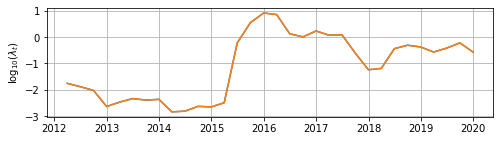

 RW:   0%|          | 0/32 [00:00<?, ?it/s]

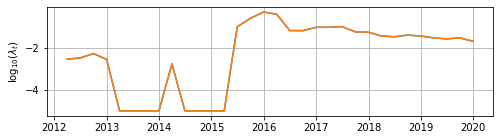

In [247]:
esnMulti_A_rw_for_1sa_2011 = esnMulti_rw_fit_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

esnMulti_B_rw_for_1sa_2011 = esnMulti_rw_fit_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

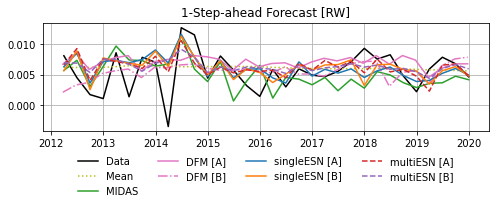

In [248]:
# Plot -- 1-Step-ahead Forecast
plt.figure(figsize=(8, 2))
plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
#
plt.plot(UnMean_rw_1sa_forecast_2011, label="Mean", c="C8", ls=':')
#
plt.plot(MIDAS_rw_1sa_forecast_2011, label="MIDAS", c="C2", ls='-') 
#
plt.plot(DFM_A_rw_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_rw_forecast_2011, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_rw_for_1sa_2011, label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_rw_for_1sa_2011, label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_rw_for_1sa_2011, label="multiESN [A]", c="C3", ls='--') 
plt.plot(esnMulti_B_rw_for_1sa_2011, label="multiESN [B]", c="C4", ls='--') 
#
plt.grid()
plt.title("1-Step-ahead Forecast [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_forecasts_rw_2011.pdf'), bbox_inches="tight")
plt.show()

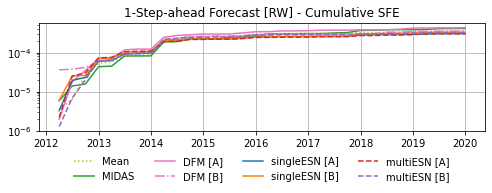

In [249]:
# Plot -- 1-Step-ahead Forecast - Cumulative SFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulSFE_2011(UnMean_rw_1sa_forecast_2011), label="Mean", c="C8", ls=':')
#
plt.plot(cumulSFE_2011(MIDAS_rw_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulSFE_2011(DFM_A_rw_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulSFE_2011(DFM_B_rw_forecast_2011), label="DFM [B]", c="C6", ls='-.')
#
plt.plot(cumulSFE_2011(esnSingle_A_agg_rw_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulSFE_2011(esnSingle_B_agg_rw_for_1sa_2011), label="singleESN [B]", c="C1") 
#
plt.plot(cumulSFE_2011(esnMulti_A_rw_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulSFE_2011(esnMulti_B_rw_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.yscale('log')
plt.title("1-Step-ahead Forecast [RW] - Cumulative SFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulsfe_rw_2011.pdf'), bbox_inches="tight")
plt.show()

In [250]:
MIDAS_MSE_rw_2011_td = MSFE_2011(MIDAS_rw_1sa_forecast_2011) * 1e4
UnMean_MSE_rw_2011_td = MSFE_2011(UnMean_rw_1sa_forecast_2011) * 1e4
DFM_A_MSE_rw_2011_td = MSFE_2011(DFM_A_rw_forecast_2011) * 1e4
DMF_B_MSE_rw_2011_td = MSFE_2011(DFM_B_rw_forecast_2011) * 1e4
esnSingle_A_MSE_rw_2011_td = MSFE_2011(esnSingle_A_agg_rw_for_1sa_2011) * 1e4
esnSingle_B_MSE_rw_2011_td = MSFE_2011(esnSingle_B_agg_rw_for_1sa_2011) * 1e4
esnMulti_A_MSE_rw_2011_td = MSFE_2011(esnMulti_A_rw_for_1sa_2011) * 1e4
esnMulti_B_MSE_rw_2011_td = MSFE_2011(esnMulti_B_rw_for_1sa_2011) * 1e4

print("------------------- MSFE -------------- RMSFE -----")
print(f"MIDAS \t\t = {MIDAS_MSE_rw_2011_td.round(4)} \t|\t" 
        f"{np.sqrt(MIDAS_MSE_rw_2011_td).round(4)}")
print(f"Mean \t\t = {UnMean_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(UnMean_MSE_rw_2011_td).round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DFM_A_MSE_rw_2011_td).round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(DMF_B_MSE_rw_2011_td).round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_A_MSE_rw_2011_td).round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnSingle_B_MSE_rw_2011_td).round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_A_MSE_rw_2011_td).round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_rw_2011_td.round(4)} \t|\t"
        f"{np.sqrt(esnMulti_B_MSE_rw_2011_td).round(4)}")

------------------- MSFE -------------- RMSFE -----
MIDAS 		 = 0.1284 	|	0.3584
Mean 		 = 0.1098 	|	0.3313
DFM [A]		 = 0.1346 	|	0.3668
DFM [B]		 = 0.1128 	|	0.3359
singleESN [A]	 = 0.0947 	|	0.3078
singleESN [B]	 = 0.1021 	|	0.3196
multiESN [A]	 = 0.0943 	|	0.307
multiESN [B]	 = 0.1012 	|	0.318


In [251]:
ref_MSE_2011_rw = UnMean_MSE_rw_2011_td
MIDAS_MSE_toRef_2011_rw = MIDAS_MSE_rw_2011_td / ref_MSE_2011_rw
DFM_A_MSE_toRef_2011_rw = DFM_A_MSE_rw_2011_td / ref_MSE_2011_rw
DMF_B_MSE_toRef_2011_rw = DMF_B_MSE_rw_2011_td / ref_MSE_2011_rw
esnSingle_A_MSE_toRef_2011_rw = esnSingle_A_MSE_rw_2011_td / ref_MSE_2011_rw
esnSingle_B_MSE_toRef_2011_rw = esnSingle_B_MSE_rw_2011_td / ref_MSE_2011_rw
esnMulti_A_MSE_toRef_2011_rw = esnMulti_A_MSE_rw_2011_td / ref_MSE_2011_rw
esnMulti_B_MSE_toRef_2011_rw = esnMulti_B_MSE_rw_2011_td / ref_MSE_2011_rw

print("------------------ Relative MSFE -----------")
print(f"Mean \t\t = {1.0}")
print(f"MIDAS \t\t = {MIDAS_MSE_toRef_2011_rw.round(4)}")
print(f"DFM [A]\t\t = {DFM_A_MSE_toRef_2011_rw.round(4)}")
print(f"DFM [B]\t\t = {DMF_B_MSE_toRef_2011_rw.round(4)}")
print(f"singleESN [A]\t = {esnSingle_A_MSE_toRef_2011_rw.round(4)}")
print(f"singleESN [B]\t = {esnSingle_B_MSE_toRef_2011_rw.round(4)}")
print(f"multiESN [A]\t = {esnMulti_A_MSE_toRef_2011_rw.round(4)}")
print(f"multiESN [B]\t = {esnMulti_B_MSE_toRef_2011_rw.round(4)}")

------------------ Relative MSFE -----------
Mean 		 = 1.0
MIDAS 		 = 1.1701
DFM [A]		 = 1.2259
DFM [B]		 = 1.0275
singleESN [A]	 = 0.8629
singleESN [B]	 = 0.9304
multiESN [A]	 = 0.8586
multiESN [B]	 = 0.9214


In [252]:
#ref_MSE_2011_rw = cumulSFE_2011(MIDAS_rw_1sa_forecast_2011).iloc[-1]
#UnMean_rw_MSE_toRef_2011 = cumulSFE_2011(UnMean_rw_1sa_forecast_2011).iloc[-1] / ref_MSE_2011_rw
#DFM_A_rw_MSE_toRef_2011 = cumulSFE_2011(DFM_A_rw_forecast_2011).iloc[-1] / ref_MSE_2011_rw
#DMF_B_rw_MSE_toRef_2011 = cumulSFE_2011(DFM_B_rw_forecast_2011).iloc[-1] / ref_MSE_2011_rw
#esnSingle_A_rw_MSE_toRef_2011 = cumulSFE_2011(esnSingle_A_rw_for_1sa_2011).iloc[-1] / ref_MSE_2011_rw
#esnSingle_B_rw_MSE_toRef_2011 = cumulSFE_2011(esnSingle_B_rw_for_1sa_2011).iloc[-1] / ref_MSE_2011_rw
#esnMulti_A_rw_MSE_toRef_2011 = cumulSFE_2011(esnMulti_A_rw_for_1sa_2011).iloc[-1] / ref_MSE_2011_rw
#esnMulti_B_rw_MSE_toRef_2011 = cumulSFE_2011(esnMulti_B_rw_for_1sa_2011).iloc[-1] / ref_MSE_2011_rw
#
#print("-------------------------- Relative MSFE -----------")
#print(f"MIDAS [RW] \t\t = {1.0}")
#print(f"Mean [RW] \t\t = {UnMean_rw_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"DFM [A] [RW]\t\t = {DFM_A_rw_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"DFM [B] [RW]\t\t = {DMF_B_rw_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"singleESN [A] [RW]\t = {esnSingle_A_rw_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"singleESN [B] [RW]\t = {esnSingle_B_rw_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"multiESN [A] [RW]\t = {esnMulti_A_rw_MSE_toRef_2011.iloc[0].round(4)}")
#print(f"multiESN [B] [RW]\t = {esnMulti_B_rw_MSE_toRef_2011.iloc[0].round(4)}")

In [253]:
#MIDAS_MSE_rw_2011 = cumulSFE_2011(MIDAS_rw_1sa_forecast_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#UnMean_MSE_rw_2011 = cumulSFE_2011(UnMean_rw_1sa_forecast_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#DFM_A_MSE_rw_2011 = cumulSFE_2011(DFM_A_rw_forecast_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#DMF_B_MSE_rw_2011 = cumulSFE_2011(DFM_B_rw_forecast_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#esnSingle_A_MSE_rw_2011 = cumulSFE_2011(esnSingle_A_rw_for_1sa_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#esnSingle_B_MSE_rw_2011 = cumulSFE_2011(esnSingle_B_rw_for_1sa_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#esnMulti_A_MSE_rw_2011 = cumulSFE_2011(esnMulti_A_rw_for_1sa_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#esnMulti_B_MSE_rw_2011 = cumulSFE_2011(esnMulti_B_rw_for_1sa_2011).iloc[-1] / len(dataset2011['GDP_data_test'])
#
#print("--------------------------- MSFE -------------- RMSFE -----")
#print(f"MIDAS [RW] \t\t = {MIDAS_MSE_rw_2011.iloc[0].round(4)} \t|\t" 
#        f"{np.sqrt(MIDAS_MSE_rw_2011.iloc[0]).round(4)}")
#print(f"Mean [RW] \t\t = {UnMean_MSE_rw_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(UnMean_MSE_rw_2011.iloc[0]).round(4)}")
#print(f"DFM [A] [RW]\t\t = {DFM_A_MSE_rw_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(DFM_A_MSE_rw_2011.iloc[0]).round(4)}")
#print(f"DFM [B] [RW]\t\t = {DMF_B_MSE_rw_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(DMF_B_MSE_rw_2011.iloc[0]).round(4)}")
#print(f"singleESN [A] [RW] \t = {esnSingle_A_MSE_rw_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(esnSingle_A_MSE_rw_2011.iloc[0]).round(4)}")
#print(f"singleESN [B] [RW] \t = {esnSingle_B_MSE_rw_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(esnSingle_B_MSE_rw_2011.iloc[0]).round(4)}")
#print(f"multiESN [A] [RW] \t = {esnMulti_A_MSE_rw_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(esnMulti_A_MSE_rw_2011.iloc[0]).round(4)}")
#print(f"multiESN [B] [RW] \t = {esnMulti_B_MSE_rw_2011.iloc[0].round(4)} \t|\t"
#        f"{np.sqrt(esnMulti_B_MSE_rw_2011.iloc[0]).round(4)}")

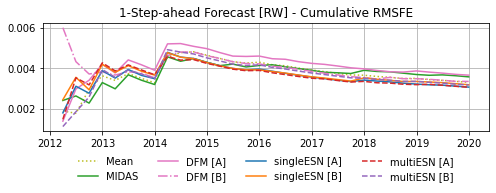

In [254]:
# Plot -- 1-Step-ahead Forecast - Cumulative RMSFE
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(cumulRMSFE_2011(UnMean_rw_1sa_forecast_2011), label="Mean", c="C8", ls=':')
#
plt.plot(cumulRMSFE_2011(MIDAS_rw_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(cumulRMSFE_2011(DFM_A_rw_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(cumulRMSFE_2011(DFM_B_rw_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(cumulRMSFE_2011(esnSingle_A_agg_rw_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(cumulRMSFE_2011(esnSingle_B_agg_rw_for_1sa_2011), label="singleESN [B]", c="C1") 
#
plt.plot(cumulRMSFE_2011(esnMulti_A_rw_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(cumulRMSFE_2011(esnMulti_B_rw_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - Cumulative RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_cumulrmsfe_rw_2011.pdf'), bbox_inches="tight")
plt.show()

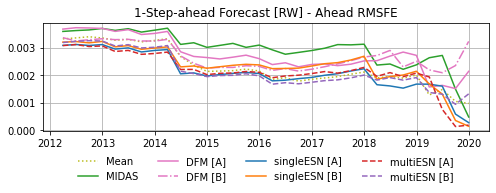

In [255]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(aheadRMSFE_2011(UnMean_rw_1sa_forecast_2011), label="Mean", c="C8", ls=':')
#
plt.plot(aheadRMSFE_2011(MIDAS_rw_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(aheadRMSFE_2011(DFM_A_rw_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(aheadRMSFE_2011(DFM_B_rw_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(aheadRMSFE_2011(esnSingle_A_agg_rw_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(aheadRMSFE_2011(esnSingle_B_agg_rw_for_1sa_2011), label="singleESN [B]", c="C1") 
#
plt.plot(aheadRMSFE_2011(esnMulti_A_rw_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(aheadRMSFE_2011(esnMulti_B_rw_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - Ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_armsfe_rw_2011.pdf'), bbox_inches="tight")
plt.show()

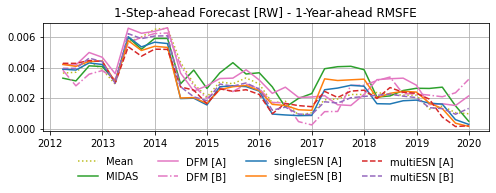

In [256]:
plt.figure(figsize=(8, 2))
plt.grid()
#
plt.plot(YA_RMSFE_2011(UnMean_rw_1sa_forecast_2011), label="Mean", c="C8", ls=':')
#
plt.plot(YA_RMSFE_2011(MIDAS_rw_1sa_forecast_2011), label="MIDAS", c="C2") 
#
plt.plot(YA_RMSFE_2011(DFM_A_rw_forecast_2011), label="DFM [A]", c="C6") 
plt.plot(YA_RMSFE_2011(DFM_B_rw_forecast_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(YA_RMSFE_2011(esnSingle_A_agg_rw_for_1sa_2011), label="singleESN [A]", c="C0") 
plt.plot(YA_RMSFE_2011(esnSingle_B_agg_rw_for_1sa_2011), label="singleESN [B]", c="C1") 
#
plt.plot(YA_RMSFE_2011(esnMulti_A_rw_for_1sa_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(YA_RMSFE_2011(esnMulti_B_rw_for_1sa_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.title("1-Step-ahead Forecast [RW] - 1-Year-ahead RMSFE")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_1yarmsfe_rw_2011.pdf'), bbox_inches="tight")
plt.show()

In [326]:
mcs_data_2011_rw = pd.DataFrame(
    np.c_[UnMean_rw_1sa_forecast_2011,
        MIDAS_rw_1sa_forecast_2011,
        DFM_A_rw_forecast_2011,
        DFM_B_rw_forecast_2011,
        esnSingle_A_agg_rw_for_1sa_2011,
        esnSingle_B_agg_rw_for_1sa_2011,
        esnMulti_A_rw_for_1sa_2011,
        esnMulti_B_rw_for_1sa_2011,
    ],
    columns=['Mean', 'MIDAS [RW]', 'DFM [A]', 'DFM [B]',
                'singleESN [A] [RW]', 'singleESN [B] [RW]', 'multiESN [A] [RW]', 'multiESN [B] [RW]']
)
mcs_data_2011_rw = (mcs_data_2011_rw - dataset2011['GDP_data_test'].to_numpy())

mcs_25_2011_rw = ModelConfidenceSet(
    data=np.square(mcs_data_2011_rw), alpha=0.25, B=10000, w=2, algorithm='R', seed=202209
).run()
mcs_10_2011_rw = ModelConfidenceSet(
    data=np.square(mcs_data_2011_rw), alpha=0.10, B=10000, w=2, algorithm='R', seed=202209
).run()

print(f"MCS 25 included: {mcs_25_2011_rw.included}")
print(f"MCS 10 included: {mcs_10_2011_rw.included}")

MCS 25 included: ['DFM [B]', 'Mean', 'singleESN [B] [RW]', 'multiESN [B] [RW]', 'singleESN [A] [RW]', 'multiESN [A] [RW]']
MCS 10 included: ['MIDAS [RW]', 'DFM [B]', 'Mean', 'singleESN [B] [RW]', 'multiESN [B] [RW]', 'singleESN [A] [RW]', 'multiESN [A] [RW]']


In [327]:
mcs_25_2011_rw.pvalues

DFM [A]               0.0056
MIDAS [RW]            0.1513
DFM [B]               0.8362
Mean                  0.8362
singleESN [B] [RW]    0.8362
multiESN [B] [RW]     0.8362
singleESN [A] [RW]    0.9661
multiESN [A] [RW]     1.0000
dtype: float64

In [328]:
mcs_data_2011_rw.to_csv(
    os.path.join(path_folder, "R", "mcs_small_rw_2011.csv")
)

##### Tests

In [260]:
#JBtest_MIDAS_fit_1sa_2011 = jarque_bera(MIDAS_fit_1sa_2011['parsfit_for'][0]['Residuals'])
#JBtest_esnSingle_A_fit_1sa_2011 = jarque_bera(esnSingle_A_fit_1sa_2011['fit_for'][0]['Residuals'])
#JBtest_esnSingle_B_fit_1sa_2011 = jarque_bera(esnSingle_B_fit_1sa_2011['fit_for'][0]['Residuals'])
#JBtest_esnMulti_A_fit_1sa_2011 = jarque_bera(esnMulti_A_fit_1sa_2011['fit_for'][0]['Residuals'])
#JBtest_esnMulti_B_fit_1sa_2011 = jarque_bera(esnMulti_B_fit_1sa_2011['fit_for'][0]['Residuals'])
#
#print("Jarque-Bera normality test - fit residuals:")
#print(tabulate([
#    ["MIDAS", JBtest_MIDAS_fit_1sa_2011[0], JBtest_MIDAS_fit_1sa_2011[1]],
#    ["esnSingle [A]", JBtest_esnSingle_A_fit_1sa_2011[0], JBtest_esnSingle_A_fit_1sa_2011[1]],
#    ["esnSingle [B]", JBtest_esnSingle_B_fit_1sa_2011[0], JBtest_esnSingle_B_fit_1sa_2011[1]],
#    ["esnMulti [A]", JBtest_esnMulti_A_fit_1sa_2011[0], JBtest_esnMulti_A_fit_1sa_2011[1]],
#    ["esnMulti [B]", JBtest_esnMulti_B_fit_1sa_2011[0], JBtest_esnMulti_B_fit_1sa_2011[1]],
#], headers=["Model", "Jarque-Bera stat", "p-value"],))

In [261]:
#LBtest_MIDAS_fit_1sa_2011 = acorr_ljungbox(MIDAS_fit_1sa_2011['parsfit_for'][0]['Residuals'])
#LBtest_esnSingle_A_fit_1sa_2011 = acorr_ljungbox(esnSingle_A_fit_1sa_2011['fit_for'][0]['Residuals'])
#LBtest_esnSingle_B_fit_1sa_2011 = acorr_ljungbox(esnSingle_B_fit_1sa_2011['fit_for'][0]['Residuals'])
#LBtest_esnMulti_A_fit_1sa_2011 = acorr_ljungbox(esnMulti_A_fit_1sa_2011['fit_for'][0]['Residuals'])
#LBtest_esnMulti_B_fit_1sa_2011 = acorr_ljungbox(esnMulti_B_fit_1sa_2011['fit_for'][0]['Residuals'])
#
#print("Ljung-Box autocorrelation test - p-values (10 lags):")
#print(pd.DataFrame(
#    np.c_[LBtest_MIDAS_fit_1sa_2011['lb_pvalue'],
#        LBtest_esnSingle_A_fit_1sa_2011['lb_pvalue'],
#        LBtest_esnSingle_B_fit_1sa_2011['lb_pvalue'],
#        LBtest_esnMulti_A_fit_1sa_2011['lb_pvalue'],
#        LBtest_esnMulti_B_fit_1sa_2011['lb_pvalue'],
#    ],
#    columns=['MIDAS', 'esnSingle [A]', 'esnSingle [B]', 'esnMulti [A]', 'esnMulti [B]'],
#    index=np.arange(1,11),
#))

#### 1-step Ahead High-Frequency Forecast Comparison


##### Fixed Parameters

In [115]:
DFM_A_fix_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_fixed__2011', 
)
DFM_A_fix_highfreq_forecast_2011 = DFM_A_fix_highfreq_forecast_2011.loc[
    (DFM_A_fix_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_A_fix_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_fix_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_fixed__2011',
)
DFM_B_fix_highfreq_forecast_2011 = DFM_B_fix_highfreq_forecast_2011.loc[
    (DFM_B_fix_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_B_fix_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_fix_highfreq_forecast_2011.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_fix_highfreq_forecast_2011.index = DFM_index_for[1:]
DFM_B_fix_highfreq_forecast_2011.index = DFM_index_for[1:]

# Final filtering
DFM_A_fix_highfreq_forecast_2011 = DFM_A_fix_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]
DFM_B_fix_highfreq_forecast_2011 = DFM_B_fix_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]

In [116]:
MIDAS_fix_for_highfreq_1sa_2011 = MIDAS_fix_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2011,
)

MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

In [117]:
esnSingle_A_agg_fix_highfreq_for_1sa_2011 = esnSingle_fix_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    aggregate=True,
)

esnSingle_B_agg_fix_highfreq_for_1sa_2011 = esnSingle_fix_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    aggregate=True,
)

In [118]:
esnMulti_A_fix_highfreq_for_1sa_2011 = esnMulti_fix_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
)

esnMulti_B_fix_highfreq_for_1sa_2011 = esnMulti_fix_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
)

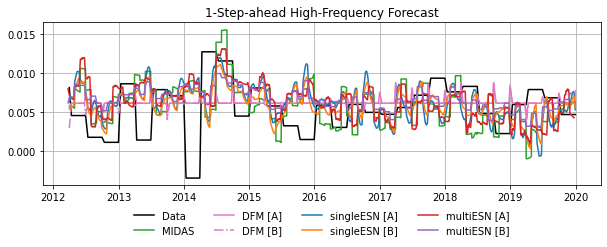

In [123]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_fix_highfreq_for_1sa_2011["hf_target"], c='k', label="Data")
#
plt.plot(MIDAS_fix_for_highfreq_1sa_2011, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_fix_highfreq_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_fix_highfreq_forecast_2011, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_fix_highfreq_for_1sa_2011["hf_forecast"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_fix_highfreq_for_1sa_2011["hf_forecast"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_fix_highfreq_for_1sa_2011["hf_forecast"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_fix_highfreq_for_1sa_2011["hf_forecast"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_fix_2011.pdf'), bbox_inches="tight")
plt.show()

##### Expanding Window

In [124]:
DFM_A_ew_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_expanding__2011', 
)
DFM_A_ew_highfreq_forecast_2011 = DFM_A_ew_highfreq_forecast_2011.loc[
    (DFM_A_ew_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_A_ew_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_ew_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_expanding__2011',
)
DFM_B_ew_highfreq_forecast_2011 = DFM_B_ew_highfreq_forecast_2011.loc[
    (DFM_B_ew_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_B_ew_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_ew_highfreq_forecast_2011.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_ew_highfreq_forecast_2011.index = DFM_index_for[1:]
DFM_B_ew_highfreq_forecast_2011.index = DFM_index_for[1:]

# Final filtering
DFM_A_ew_highfreq_forecast_2011 = DFM_A_ew_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]
DFM_B_ew_highfreq_forecast_2011 = DFM_B_ew_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]

In [125]:
MIDAS_ew_for_highfreq_1sa_2011 = MIDAS_ew_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2011,
)

j = 0
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 1
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 2
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 3
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 4
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 5
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 6
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 7
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 8
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 9
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 10
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 11
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 12
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 13
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 14
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 15
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 16
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 17
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 18
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 19
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 20
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 21
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

j = 22
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 23
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 24
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 25
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 26
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 27
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 28
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 29
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 30
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 31
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


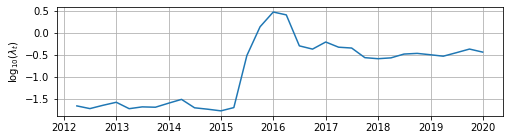

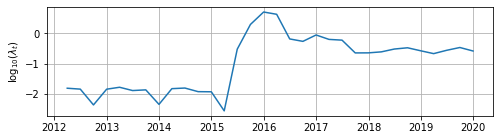

In [126]:
esnSingle_A_agg_ew_highfreq_for_1sa_2011 = esnSingle_ew_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_ew_highfreq_for_1sa_2011 = esnSingle_ew_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

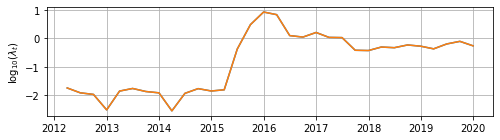

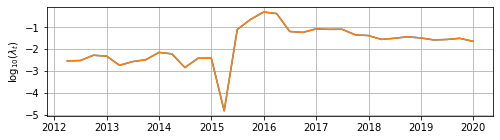

In [127]:
esnMulti_A_ew_highfreq_for_1sa_2011 = esnMulti_ew_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

esnMulti_B_ew_highfreq_for_1sa_2011 = esnMulti_ew_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

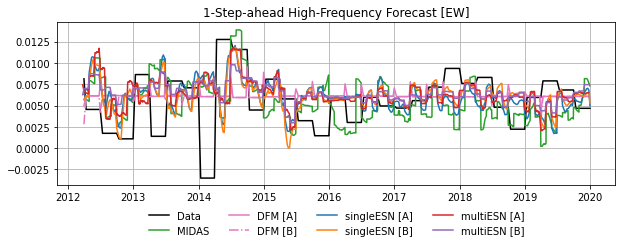

In [128]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_ew_highfreq_for_1sa_2011["hf_target"], c='k', label="Data")
#
plt.plot(MIDAS_ew_for_highfreq_1sa_2011, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_ew_highfreq_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_ew_highfreq_forecast_2011, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_ew_highfreq_for_1sa_2011["hf_ew_forecast"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_ew_highfreq_for_1sa_2011["hf_ew_forecast"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_ew_highfreq_for_1sa_2011["hf_ew_forecast"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_ew_highfreq_for_1sa_2011["hf_ew_forecast"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_ew_2011.pdf'), bbox_inches="tight")
plt.show()

##### Rolling Window

In [129]:
DFM_A_rw_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'stock__5__6__[1]_window__2011', 
)
DFM_A_rw_highfreq_forecast_2011 = DFM_A_rw_highfreq_forecast_2011.loc[
    (DFM_A_rw_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_A_rw_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

DFM_B_rw_highfreq_forecast_2011 = getDFMOneStepAheadForecast(
    'almon__5__6__[1]_window__2011',
)
DFM_B_rw_highfreq_forecast_2011 = DFM_B_rw_highfreq_forecast_2011.loc[
    (DFM_B_rw_highfreq_forecast_2011.index > pd.to_datetime("2011-12-31"))
    &
    (DFM_B_rw_highfreq_forecast_2011.index <= pd.to_datetime("2019-12-31"))
]

# NOTE: adjust dates *manually*
DFM_dates = DFM_A_rw_highfreq_forecast_2011.index
DFM_index_for = DFM_dates[[0]]
for m in pd.date_range(DFM_dates[0]+pd.offsets.Day(1), DFM_dates[-1]+pd.offsets.MonthEnd(1), freq="M"):
    DFM_index_for = DFM_index_for.union([
        m - pd.offsets.Day(18), m - pd.offsets.Day(12),
        m - pd.offsets.Day(6), m
    ])

DFM_A_rw_highfreq_forecast_2011.index = DFM_index_for[1:]
DFM_B_rw_highfreq_forecast_2011.index = DFM_index_for[1:]

# Final filtering
DFM_A_rw_highfreq_forecast_2011 = DFM_A_rw_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]
DFM_B_rw_highfreq_forecast_2011 = DFM_B_rw_highfreq_forecast_2011[DFM_index_for[1:] >= pd.to_datetime("2012-03-31")]

In [130]:
MIDAS_rw_for_highfreq_1sa_2011 = MIDAS_rw_fit_highfreq_1sa(
    midasModel=MIDAS_model,
    data=dataset2011,
)

j = 0
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 1
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 2
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 3
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 4
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 5
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 6
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 7
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 8
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 9
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 10
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 11
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 12
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 13
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: invalid value encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: Runtim

j = 14
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))


j = 15
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 16
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 17
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 18
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 19
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 20
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 21
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 22
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 23
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 24
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 25
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 26
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 27
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 28
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 29
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: invalid value encountered in matmul
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:690: RuntimeWarning: overflow encountered in exp
  phi    = np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:691: RuntimeWarning: invalid value encountered in matmul
  c = Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, (B @ beta) * phi))
c:\Users\Ballarin\Documents\GitHub\R

j = 30
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


j = 31
MIDAS.fitAlmon_solve_grad() [!] Explicit gradient only uses non-normalized Almon weights


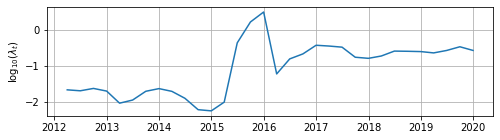

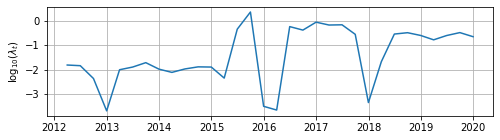

In [131]:
esnSingle_A_agg_rw_highfreq_for_1sa_2011 = esnSingle_rw_fit_highfreq_1sa(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_rw_highfreq_for_1sa_2011 = esnSingle_rw_fit_highfreq_1sa(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    retune=True,
    aggregate=True,
)

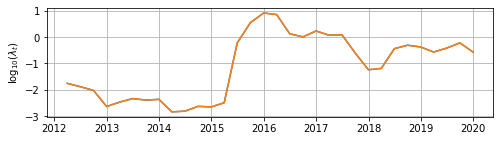

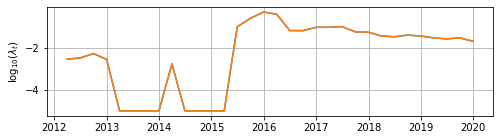

In [132]:
esnMulti_A_rw_highfreq_for_1sa_2011 = esnMulti_rw_fit_highfreq_1sa(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

esnMulti_B_rw_highfreq_for_1sa_2011 = esnMulti_rw_fit_highfreq_1sa(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    retune=True,
)

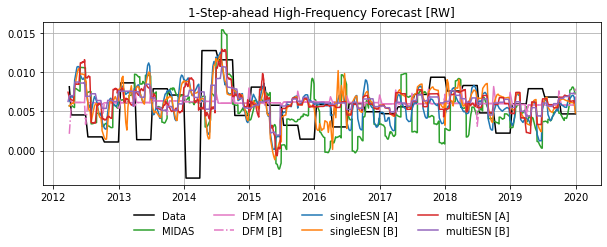

In [133]:
plt.figure(figsize=(10,3))
plt.plot(esnSingle_A_agg_rw_highfreq_for_1sa_2011["hf_target"], c='k', label="Data")
#
plt.plot(MIDAS_rw_for_highfreq_1sa_2011, label="MIDAS", c="C2") 
#
plt.plot(DFM_A_rw_highfreq_forecast_2011, label="DFM [A]", c="C6") 
plt.plot(DFM_B_rw_highfreq_forecast_2011, label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(esnSingle_A_agg_rw_highfreq_for_1sa_2011["hf_rw_forecast"], label="singleESN [A]", c="C0") 
plt.plot(esnSingle_B_agg_rw_highfreq_for_1sa_2011["hf_rw_forecast"], label="singleESN [B]", c="C1") 
#
plt.plot(esnMulti_A_rw_highfreq_for_1sa_2011["hf_rw_forecast"], label="multiESN [A]", c="C3") 
plt.plot(esnMulti_B_rw_highfreq_for_1sa_2011["hf_rw_forecast"], label="multiESN [B]", c="C4") 
#
plt.grid()
plt.title("1-Step-ahead High-Frequency Forecast [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_1sa_highfreq_forecasts_rw_2011.pdf'), bbox_inches="tight")
plt.show()

#### Multi-step Point Forecast

##### Fixed Parameters

In [262]:
import pickle

MIDAS_fix_multistep_for_2011 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_eadc2894b6__MIDAS_fix_multistep_2011.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_fix_multistep_for_2011 = pickle.load(file)

In [263]:
#MIDAS_multistep_for_2011 = [ pd.DataFrame(
#    data=MIDAS_fit_multisa_2011['forecasts'][(h*3*24)]['Forecast'], 
#    index=dataset2011['GDP_data_test'].index,
#) for h in range(8) ]

In [264]:
#UnMean_multistep_for_2011 = [ 
#    UnMean_1sa_forecast_2011
#for _ in range(8) ]

UnMean_fix_multistep_for_2011 = UnMean_fix_fit_multistep(
    data=dataset2011,
    steps=8,
)

In [265]:
#DFM_A_multistep_for_2011 = [ pd.read_csv(
#        os.path.join(dfm_path, 'stock__5__6__[1, 4, 12]_fixed__2011', 'q_test_'+str(12*(h+1))+'.csv'),
#        parse_dates = [0]
#    ).set_index('Unnamed: 0')[:'2019-12-31'][['Q1_test_pred']]
#    for h in range(6)
#] + [pd.DataFrame(np.full(1, np.nan)) for _ in range(2)]
#
#DFM_B_multistep_for_2011 = [ pd.read_csv(
#        os.path.join(dfm_path, 'almon__5__6__[1, 4, 12]_fixed__2011', 'q_test_'+str(12*(h+1))+'.csv'),
#        parse_dates = [0]
#    ).set_index('Unnamed: 0')[:'2019-12-31'][['Q1_test_pred']]
#    for h in range(6)
#] + [pd.DataFrame(np.full(1, np.nan)) for _ in range(2)]


#DFM_A_fix_multistep_for_2011 = pd.DataFrame(
#    data=None, columns=range(6), index=dataset2011['GDP_data_test'].index,
#)
#for h in range(6):
#    DFM_A_fix_multistep_for_2011.iloc[:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'stock__5__6__[1, 4, 12]_fixed__2011', 'q_test_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0]
#        ).iloc[:,1].to_numpy()
#    )
#
#DFM_B_fix_multistep_for_2011 = pd.DataFrame(
#    data=None, columns=range(6), index=dataset2011['GDP_data_test'].index,
#)
#for h in range(6):
#    DFM_B_fix_multistep_for_2011.iloc[:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'almon__5__6__[1, 4, 12]_fixed__2011', 'q_test_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0]
#        ).iloc[:,1].to_numpy()
#    )

In [266]:
#DFM_A_fix_multistep_for_2011 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2011['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_A_fix_multistep_for_2011.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'stock__5__6__[1]_fixed__2011', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2011[h:],'0'].to_numpy()
#    )
#
#DFM_B_fix_multistep_for_2011 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2011['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_B_fix_multistep_for_2011.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'almon__5__6__[1]_fixed__2011', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2011[h:],'0'].to_numpy()
#    )

DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_fix_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_fixed__2011', steps=8, date_slice=DFM_slice_2011,
)

DFM_B_fix_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_fixed__2011', steps=8, date_slice=DFM_slice_2011,
)

In [267]:
## Direct multi-step
#esnSingle_A_fit_directms_2011 = esnSingle_A.fit(
#    Y=dataset2011['GDP_fill_data_train'], z=(dataset2011['md_fill_data_train'], ), 
#    method='ridge',
#    Lambda=[1e-2, ],
#    full=True, 
#    debug=False,
#    steps=8,
#)
#
#esnSingle_B_fit_directms_2011 = esnSingle_B.fit(
#    Y=dataset2011['GDP_fill_data_train'], z=(dataset2011['md_fill_data_train'], ), 
#    method='ridge',
#    Lambda=[1e-2, ],
#    full=True, 
#    debug=False,
#    steps=8,
#)

In [268]:
## Autonomous state penalty
#esnSingle_A_comps_ridgecv_2011 = esnSingle_A.ridge_lambda_components_cv(
#    Y=dataset2011['GDP_fill_data_train'], z=(dataset2011['md_fill_data_train'], ),
#    cv_options="-cv:50",
#    debug=True,
#)
#
#esnSingle_A_multistep_ridgecv_2011 = esnSingle_A.ridge_lambda_cv(
#    Y=dataset2011['GDP_fill_data_train'], z=(dataset2011['md_fill_data_train'], ),
#    method="ridge-multistep",
#    cv_options="-cv:10-test_size:5",
#    steps=5,
#    steps_weights=np.exp(np.arange(0, -5, -1) / 2),
#    Lambda_comps=esnSingle_A_comps_ridgecv_2011,
#    debug=True,
#)

In [269]:
#esnSingle_A_for_directmultisa_2011 = esnSingle_A.fixedParamsForecast(
#    Yf=dataset2011['GDP_fill_data_test'], zf=(dataset2011['md_fill_data_test'], ), 
#    fit=esnSingle_A_fit_directms_2011,
#)
#esnSingle_A_directmultisa_forecast_2011 = [
#    esnSingle_A_for_directmultisa_2011['Forecast'][h]['Y_for']
#for h in range(8) ]
#
#esnSingle_B_for_directmultisa_2011 = esnSingle_B.fixedParamsForecast(
#    Yf=dataset2011['GDP_fill_data_test'], zf=(dataset2011['md_fill_data_test'], ), 
#    fit=esnSingle_B_fit_directms_2011,
#)
#esnSingle_B_directmultisa_forecast_2011 = [
#    esnSingle_B_for_directmultisa_2011['Forecast'][h]['Y_for']
#for h in range(8) ]

In [270]:
#for h in range(8):
#    plt.figure(figsize=(10, 2))
#    plt.grid()
#    plt.plot(dataset2011['GDP_fill_data_test'], c='k', label="Data")
#    #
#    plt.plot(
#        esnSingle_A_directmultisa_forecast_2011[h], 
#        label="singleESN [A] autoMS", c="C0"
#    )
#    plt.plot(
#        esnSingle_B_directmultisa_forecast_2011[h], 
#        label="singleESN [A] autoMS", c="C1"
#    )
#    #
#    plt.title(f" [h = {h+1}]")
#    plt.legend(fancybox=False, shadow=False, ncol=4)
#    plt.show()

In [271]:
#esnSingle_A_msfor_2011 = esnSingle_A.multistepForecast(
#    Yf=dataset2011['GDP_fill_data_test'], zf=(dataset2011['md_fill_data_test'], ), 
#    fit=esnSingle_A_fit_1sa_2011,
#    #fit=esnSingle_A_fit_multistep_2011,
#    steps=8
#)
#esnSingle_A_multistep_for_2011 = [  
#    esnSingle_A_msfor_2011['multistepForecast'][h]['Y_for']
#for h in range(8) ]
#
#esnSingle_B_msfor_2011 = esnSingle_B.multistepForecast(
#    Yf=dataset2011['GDP_fill_data_test'], zf=(dataset2011['md_fill_data_test'], ), 
#    fit=esnSingle_B_fit_1sa_2011,
#    steps=8
#)
#esnSingle_B_multistep_for_2011 = [  
#    esnSingle_B_msfor_2011['multistepForecast'][h]['Y_for']
#for h in range(8) ]

In [272]:
## Aggregated 
#esnSingle_A_agg_msfor_2011 = esnSingle_A.multistepForecast(
#    Yf=dataset2011['GDP_fill_data_test'], zf=(dataset2011['md_fill_agg_data_test'], ), 
#    fit=esnSingle_A_agg_fit_1sa_2011,
#    steps=8
#)
#esnSingle_A_agg_multistep_for_2011 = [  
#    esnSingle_A_agg_msfor_2011['multistepForecast'][h]['Y_for']
#for h in range(8) ]
#
#esnSingle_B_agg_msfor_2011 = esnSingle_B.multistepForecast(
#    Yf=dataset2011['GDP_fill_data_test'], zf=(dataset2011['md_fill_agg_data_test'], ), 
#    fit=esnSingle_B_agg_fit_1sa_2011,
#    steps=8
#)
#esnSingle_B_agg_multistep_for_2011 = [  
#    esnSingle_B_agg_msfor_2011['multistepForecast'][h]['Y_for']
#for h in range(8) ]

# Aggregated
esnSingle_A_agg_fix_multistep_for_2011 = esnSingle_fix_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    steps=8,
    direct=False,
    aggregate=True,
)

esnSingle_B_agg_fix_multistep_for_2011 = esnSingle_fix_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    steps=8,
    direct=False,
    aggregate=True,
)

In [273]:
#for h in range(8):
#    plt.figure(figsize=(10, 2))
#    plt.plot(dataset2011['GDP_fill_data_train'], c='0.5')
#    ##
#    plt.plot(
#        esnSingle_A_fit_1sa_2011['fit_for'][0]['Y_fit'], 
#        label="singleESN [A] autoMS", c="C0", ls="--"
#    )
#    ##
#    plt.plot(
#        esnSingle_A_fit_directms_2011['fit_for'][h]['Y_fit'], 
#        label="singleESN [A] directMS", c="C2", ls="--"
#    )
#    ##
#    plt.plot(dataset2011['GDP_fill_data_test'], c='k')
#    #
#    plt.plot(
#        esnSingle_A_multisa_forecast_2011[h], 
#        label="singleESN [A] autoMS", c="C0"
#    )
#    #
#    plt.plot(
#        esnSingle_A_agg_multisa_forecast_2011[h], 
#        label="singleESN [A] autoMS ridgeCV", c="C1"
#    )
#    #
#    plt.plot(
#        esnSingle_A_directmultisa_forecast_2011[h], 
#        label="singleESN [A] directMS", c="C2"
#    )
#    #
#    plt.grid()
#    #plt.title("Multi-step Ahead Forecast" + f" [h = {h+1}]")
#    plt.legend(fancybox=False, shadow=False, ncol=1)
#    plt.show()

In [274]:
#esnMulti_A_msfor_2011 = esnMulti_A.multistepForecast(
#    Yf=dataset2011['GDP_data_test'], zf=(dataset2011['m_data_test'], dataset2011['d_data_test']), 
#    fit=esnMulti_A_fit_1sa_2011,
#    steps=8
#)
#esnMulti_A_multistep_for_2011 = [  
#    esnMulti_A_msfor_2011['multistepForecast'][h]['Y_for']
#for h in range(8) ]
#
#esnMulti_B_msfor_2011 = esnMulti_B.multistepForecast(
#    Yf=dataset2011['GDP_data_test'], zf=(dataset2011['m_data_test'], dataset2011['d_data_test']), 
#    fit=esnMulti_B_fit_1sa_2011,
#    steps=8
#)
#esnMulti_B_multistep_for_2011 = [  
#    esnMulti_B_msfor_2011['multistepForecast'][h]['Y_for']
#for h in range(8) ]

esnMulti_A_fix_multistep_for_2011 = esnMulti_fix_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    steps=8,
    direct=False,
)

esnMulti_B_fix_multistep_for_2011 = esnMulti_fix_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    steps=8,
    direct=False,
)

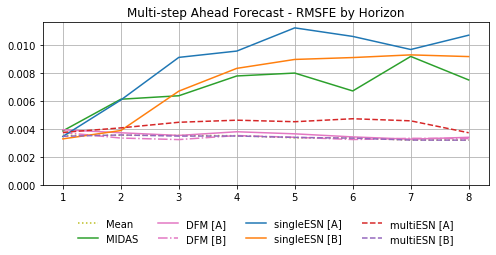

In [275]:
def hStepRMSFE_2011(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2011['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

plt.figure(figsize=(8, 3))
plt.grid()
#
plt.plot(hStepRMSFE_2011(UnMean_fix_multistep_for_2011), label="Mean", c="C8", ls=':') 
#
plt.plot(hStepRMSFE_2011(MIDAS_fix_multistep_for_2011), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2011(DFM_A_fix_multistep_for_2011), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2011(DFM_B_fix_multistep_for_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2011(esnSingle_A_agg_fix_multistep_for_2011), label="singleESN [A]", c="C0") 
plt.plot(hStepRMSFE_2011(esnSingle_B_agg_fix_multistep_for_2011), label="singleESN [B]", c="C1") 
#
#plt.plot(hStepRMSFE_2011(esnSingle_A_directmultistep_for_2011), label="singleESN [A] direct", c="C0", ls="-.")
#plt.plot(hStepRMSFE_2011(esnSingle_B_directmultistep_for_2011), label="singleESN [B] direct", c="C1", ls="-.")
#
#plt.plot(hStepRMSFE_2011(esnSingle_A_agg_multistep_for_2011), label="singleESN [A] agg", c="C0", ls=":")
#plt.plot(hStepRMSFE_2011(esnSingle_B_agg_multistep_for_2011), label="singleESN [B] agg", c="C1", ls=":")
#
plt.plot(hStepRMSFE_2011(esnMulti_A_fix_multistep_for_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(hStepRMSFE_2011(esnMulti_B_fix_multistep_for_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
plt.title("Multi-step Ahead Forecast - RMSFE by Horizon")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_fix_2011.pdf'), bbox_inches="tight")
plt.show()

In [276]:
table_RMSFE_multistep_fix_2011 = pd.DataFrame(
    index=range(1,9)
)
table_RMSFE_multistep_fix_2011.index.name = "FIX_2011"
table_RMSFE_multistep_fix_2011["Model"] = ['Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
        'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
    ]

for h in range(8):
    ref_h_hStepRMSFE_fix = hStepRMSFE_2011(UnMean_fix_multistep_for_2011).iat[h,0]
    table_RMSFE_multistep_fix_2011[str(h+1)] = [
        hStepRMSFE_2011(UnMean_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(MIDAS_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(DFM_A_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(DFM_B_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(esnSingle_A_agg_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(esnSingle_B_agg_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(esnMulti_A_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
        hStepRMSFE_2011(esnMulti_B_fix_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_fix,
    ]

table_RMSFE_multistep_fix_2011.round(3)

,Model,1,2,3,4,5,6,7,8
FIX_2011,,,,,,,,,
1,Mean,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
2,MIDAS,1.090,1.721,1.793,2.203,2.363,1.997,2.846,2.328
3,DFM [A],1.112,1.051,0.999,1.079,1.084,1.025,1.020,1.061
4,DFM [B],1.058,0.945,0.916,1.003,1.012,0.970,1.038,1.033
5,singleESN [A],0.978,1.705,2.561,2.704,3.314,3.151,2.999,3.316
6,singleESN [B],0.930,1.095,1.885,2.356,2.650,2.704,2.880,2.844
7,multiESN [A],1.059,1.148,1.262,1.312,1.339,1.409,1.424,1.162
8,multiESN [B],0.981,1.007,0.985,0.994,1.008,0.999,0.999,0.998


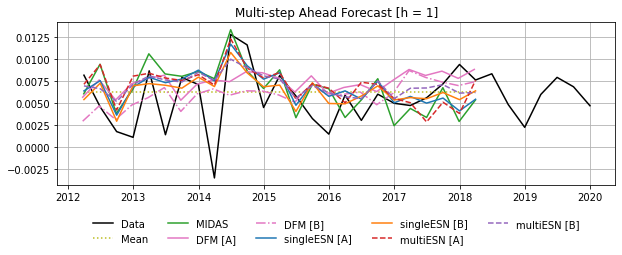

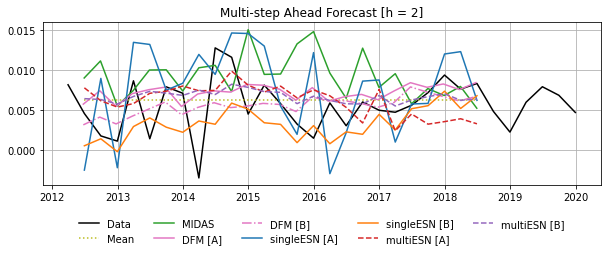

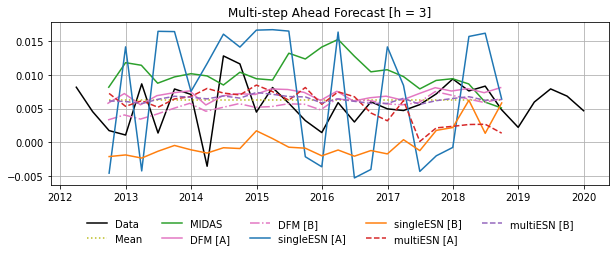

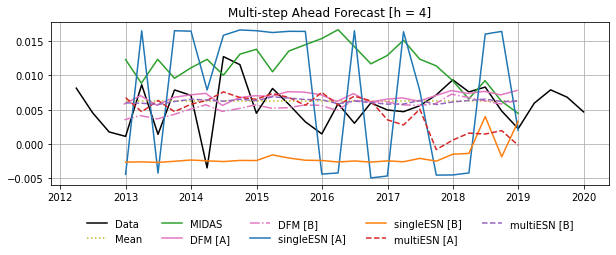

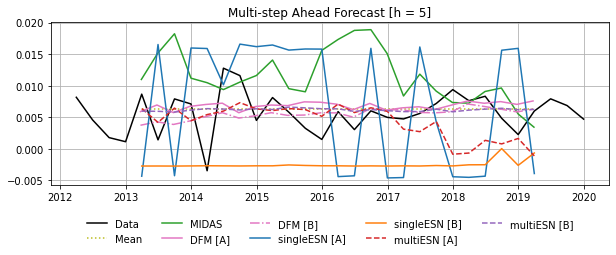

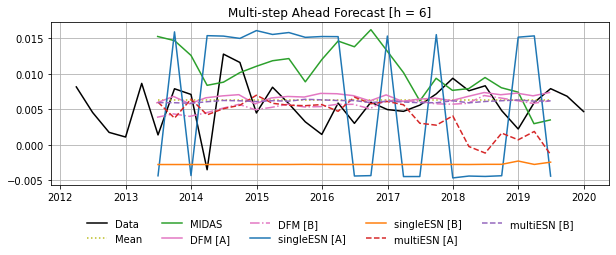

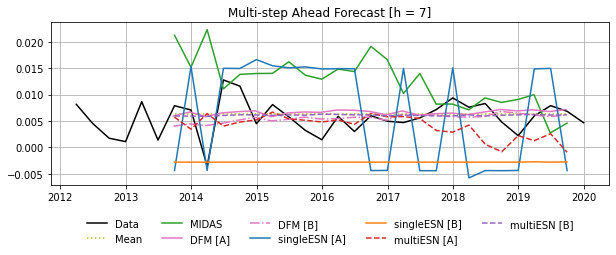

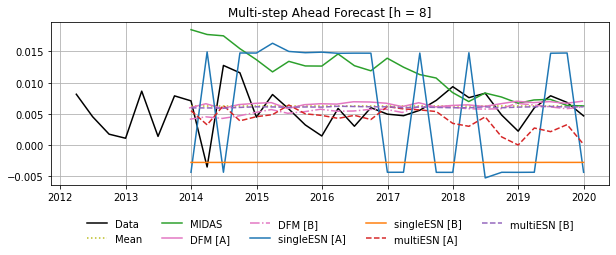

In [277]:
steps = 8
T = len(dataset2011['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8", ls=':') 
    #
    plt.plot(MIDAS_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C1") 
    #
    #plt.plot(esnSingle_A_directmultistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [A] direct", c="C0", ls="-.")
    #plt.plot(esnSingle_B_directmultistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [B] direct", c="C1", ls="-.")
    #
    plt.plot(esnMulti_A_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3", ls='--') 
    plt.plot(esnMulti_B_fix_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C4", ls='--')
    #
    plt.title("Multi-step Ahead Forecast" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=5)
    plt.show()

Export multi-horizon losses:

In [335]:
mhmcs_steps = 8
mhmcs_multistep_fix_2011 = xr.DataArray(
    data=np.zeros(
        (mhmcs_steps, len(dataset2011['GDP_data_test']) - mhmcs_steps, 8)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_fix_2011[h, :, :] = (
        np.c_[
            UnMean_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_fix_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2011['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [336]:
mhmcs_multistep_fix_2011_df = mhmcs_multistep_fix_2011.to_dataframe(
    name="Loss", dim_order=['M0', 'H', 'T']
)
mhmcs_multistep_fix_2011_df.to_csv(
    os.path.join(path_folder, "R", "mhmcs_small_multistep_fix_2011.csv")
)

##### Expanding Window

In [280]:
import pickle

MIDAS_ew_multistep_for_2011 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_2c162a989b__MIDAS_ew_multistep_for_2011.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_ew_multistep_for_2011 = pickle.load(file)

In [281]:
UnMean_ew_multistep_for_2011 = UnMean_ew_fit_multistep(
    data=dataset2011,
    steps=8,
)

 EW:   0%|          | 0/32 [00:00<?, ?it/s]

In [282]:
#UnMean_ew_multistep_for_2011 =  pd.DataFrame(
#    data=None, columns=range(6), index=dataset2011['GDP_data_test'].index,
#)
#for h in range(6):
#    UnMean_ew_multistep_for_2011.iloc[:,h] = UnMean_ew_1sa_forecast_2011

In [283]:
#DFM_A_ew_multistep_for_2011 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2011['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_A_ew_multistep_for_2011.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'stock__5__6__[1]_expanding__2011', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2011[h:],'0'].to_numpy()
#    )
#
#DFM_B_ew_multistep_for_2011 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2011['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_B_ew_multistep_for_2011.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'almon__5__6__[1]_expanding__2011', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2011[h:],'0'].to_numpy()
#    )

DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_ew_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_expanding__2011', steps=8, date_slice=DFM_slice_2011,
)

DFM_B_ew_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_expanding__2011', steps=8, date_slice=DFM_slice_2011,
)

In [284]:
#esnSingle_A_ew_multistep_for_2011 = esnSingle_ew_fit_multistep(
#    esnModel=esnSingle_A, Lambda=[1e-2,], data=dataset2011,
#    steps=8,
#    direct=False,
#)
#
#esnSingle_B_ew_multistep_for_2011 = esnSingle_ew_fit_multistep(
#    esnModel=esnSingle_B, Lambda=[1e-2,], data=dataset2011,
#    steps=8,
#    direct=False,
#)

 EW:   0%|          | 0/32 [00:00<?, ?it/s]

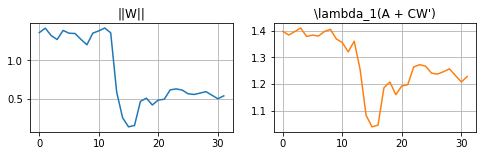

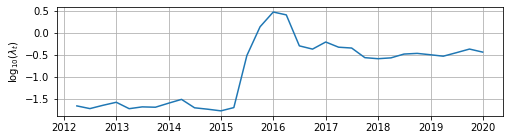

 EW:   0%|          | 0/32 [00:00<?, ?it/s]

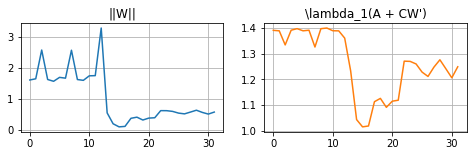

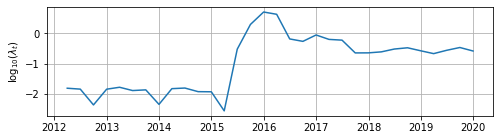

In [285]:
# Aggregated
esnSingle_A_agg_ew_multistep_for_2011 = esnSingle_ew_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011, 
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_ew_multistep_for_2011 = esnSingle_ew_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

 EW:   0%|          | 0/32 [00:00<?, ?it/s]

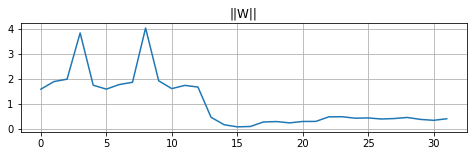

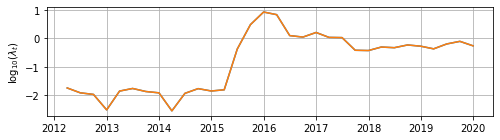

 EW:   0%|          | 0/32 [00:00<?, ?it/s]

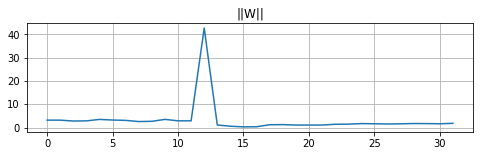

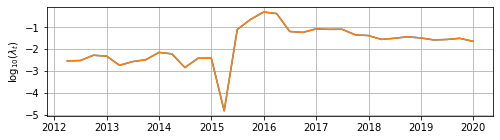

In [286]:
esnMulti_A_ew_multistep_for_2011 = esnMulti_ew_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]],  
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
)

esnMulti_B_ew_multistep_for_2011 = esnMulti_ew_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
)

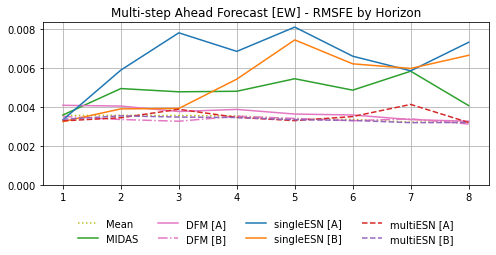

In [287]:
def hStepRMSFE_2011(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2011['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

plt.figure(figsize=(8, 3))
plt.grid()
#
plt.plot(hStepRMSFE_2011(UnMean_ew_multistep_for_2011), label="Mean", c="C8", ls=':') 
#
plt.plot(hStepRMSFE_2011(MIDAS_ew_multistep_for_2011), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2011(DFM_A_ew_multistep_for_2011), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2011(DFM_B_ew_multistep_for_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2011(esnSingle_A_agg_ew_multistep_for_2011), label="singleESN [A]", c="C0") 
plt.plot(hStepRMSFE_2011(esnSingle_B_agg_ew_multistep_for_2011), label="singleESN [B]", c="C1") 
#
plt.plot(hStepRMSFE_2011(esnMulti_A_ew_multistep_for_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(hStepRMSFE_2011(esnMulti_B_ew_multistep_for_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
plt.title("Multi-step Ahead Forecast [EW] - RMSFE by Horizon")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_ew_2011.pdf'), bbox_inches="tight")
plt.show()

In [288]:
table_RMSFE_multistep_ew_2011 = pd.DataFrame(
    index=range(1,9)
)
table_RMSFE_multistep_ew_2011.index.name = "EW_2011"
table_RMSFE_multistep_ew_2011["Model"] = ['Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
        'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
    ]

for h in range(8):
    ref_h_hStepRMSFE_ew = hStepRMSFE_2011(UnMean_ew_multistep_for_2011).iat[h,0]
    table_RMSFE_multistep_ew_2011[str(h+1)] = [
        hStepRMSFE_2011(UnMean_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(MIDAS_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(DFM_A_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(DFM_B_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(esnSingle_A_agg_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(esnSingle_B_agg_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(esnMulti_A_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
        hStepRMSFE_2011(esnMulti_B_ew_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_ew,
    ]

table_RMSFE_multistep_ew_2011.round(4)

,Model,1,2,3,4,5,6,7,8
EW_2011,,,,,,,,,
1,Mean,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,MIDAS,1.0050,1.3816,1.3392,1.3544,1.6088,1.4440,1.8033,1.2628
3,DFM [A],1.1441,1.1316,1.0572,1.0930,1.0758,1.0674,1.0384,1.0157
4,DFM [B],0.9854,0.9398,0.9179,0.9951,1.0097,0.9804,1.0505,0.9708
5,singleESN [A],0.9355,1.6451,2.1837,1.9286,2.3881,1.9589,1.8097,2.2664
6,singleESN [B],0.9112,1.0918,1.1005,1.5290,2.1948,1.8431,1.8469,2.0602
7,multiESN [A],0.9217,0.9651,1.0888,0.9785,0.9767,1.0434,1.2785,0.9954
8,multiESN [B],0.9443,0.9919,0.9777,0.9766,0.9907,0.9848,0.9904,0.9962


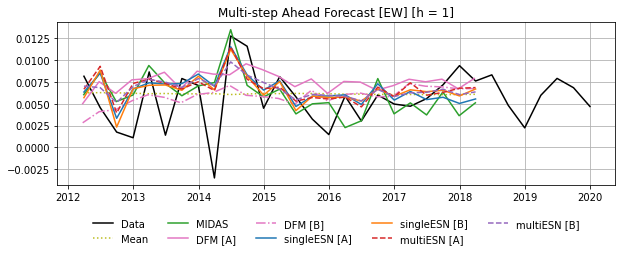

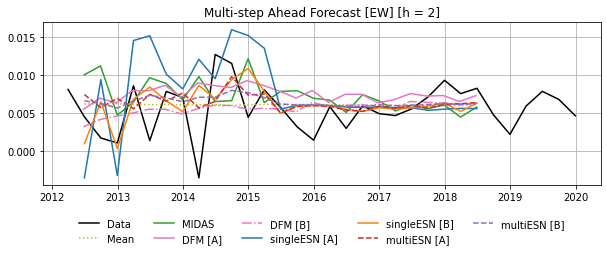

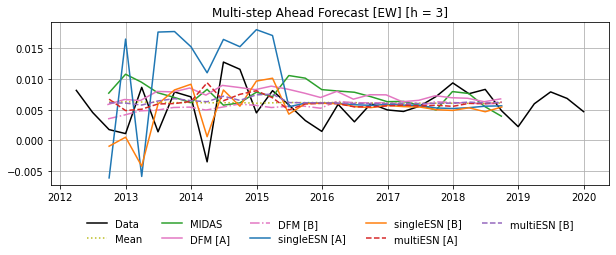

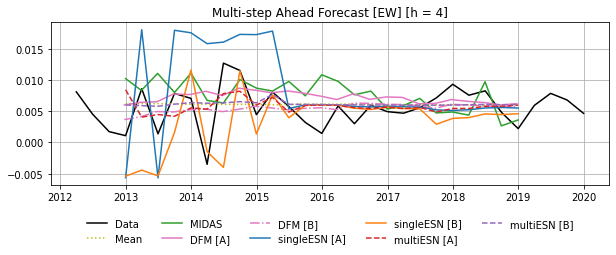

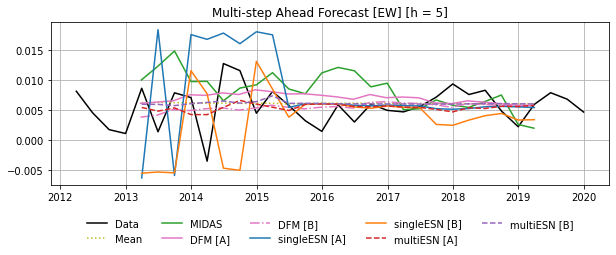

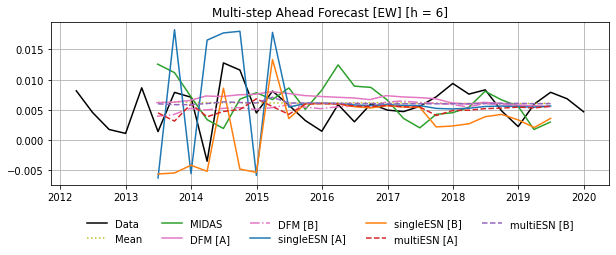

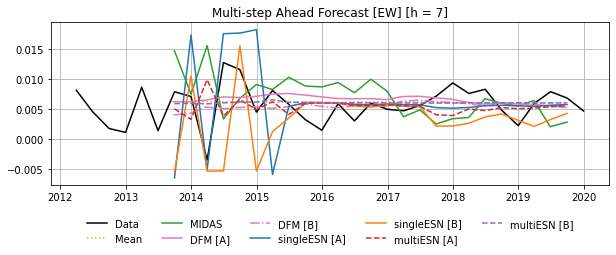

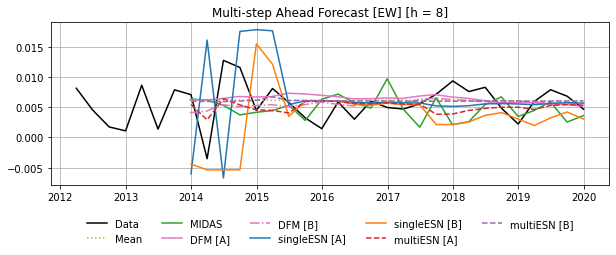

In [289]:
steps = 8
T = len(dataset2011['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8", ls=':') 
    #
    plt.plot(MIDAS_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C1") 
    #
    #plt.plot(esnSingle_A_agg_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [A] agg", c="C0")
    #plt.plot(esnSingle_B_agg_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [B] agg", c="C1") 
    #
    plt.plot(esnMulti_A_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3", ls='--') 
    plt.plot(esnMulti_B_ew_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C4", ls='--')
    #
    plt.title("Multi-step Ahead Forecast [EW]" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=5)
    plt.show()

Export multi-horizon losses:

In [337]:
mhmcs_steps = 8
mhmcs_multistep_ew_2011 = xr.DataArray(
    data=np.zeros(
        (mhmcs_steps, len(dataset2011['GDP_data_test']) - mhmcs_steps, 8)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_ew_2011[h, :, :] = (
        np.c_[
            UnMean_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_ew_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2011['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [338]:
mhmcs_multistep_ew_2011_df = mhmcs_multistep_ew_2011.to_dataframe(
    name="Loss", dim_order=['M0', 'H', 'T']
)
mhmcs_multistep_ew_2011_df.to_csv(
    os.path.join(path_folder, "R", "mhmcs_small_multistep_ew_2011.csv")
)

##### Rolling Window

In [292]:
import pickle

MIDAS_rw_multistep_for_2011 = None
# Open the file in binary mode
pickle_file_path = os.path.join(
    path_folder, "cluster", "pickle_eaf1d1fe9c__MIDAS_rw_multistep_for_2011.b"
)
with open(pickle_file_path, 'rb') as file:
    # Call load method to deserialze
    MIDAS_rw_multistep_for_2011 = pickle.load(file)

In [293]:
UnMean_rw_multistep_for_2011 = UnMean_rw_fit_multistep(
    data=dataset2011,
    steps=8
)

 RW:   0%|          | 0/32 [00:00<?, ?it/s]

In [294]:
#UnMean_rw_multistep_for_2011 =  pd.DataFrame(
#    data=None, columns=range(6), index=dataset2011['GDP_data_test'].index,
#)
#for h in range(6):
#    UnMean_rw_multistep_for_2011.iloc[:,h] = UnMean_rw_1sa_forecast_2011

In [295]:
#DFM_A_rw_multistep_for_2011 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2011['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_A_rw_multistep_for_2011.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'stock__5__6__[1]_window__2011', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2011[h:],'0'].to_numpy()
#    )
#
#DFM_B_rw_multistep_for_2011 = pd.DataFrame(
#    data=None, columns=range(8), index=dataset2011['GDP_data_test'].index,
#)
#for h in range(8):
#    DFM_B_rw_multistep_for_2011.iloc[h:,h] = (
#        pd.read_csv(
#            os.path.join(dfm_path, 'almon__5__6__[1]_window__2011', 'test_predictions_'+str(12*(h+1))+'.csv'),
#            parse_dates = [0,1]
#        ).set_index('Target Date').loc[DFM_slice_2011[h:],'0'].to_numpy()
#    )

DFM_slice_2011 = (
    pd.date_range('2012-01-01', '2019-12-31', freq="BQ") 
        - pd.tseries.offsets.MonthBegin(1) + pd.tseries.offsets.Day(23)
)

DFM_A_rw_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'stock__5__6__[1]_window__2011', steps=8, date_slice=DFM_slice_2011,
)

DFM_B_rw_multistep_for_2011 = getDFMMultiStepAheadForecast(
    'almon__5__6__[1]_window__2011', steps=8, date_slice=DFM_slice_2011,
)

In [296]:
#esnSingle_A_rw_multistep_for_2011 = esnSingle_rw_fit_multistep(
#    esnModel=esnSingle_A, Lambda=[1e-2,], data=dataset2011,
#    steps=8,
#    direct=False
#)
#
#esnSingle_B_rw_multistep_for_2011 = esnSingle_rw_fit_multistep(
#    esnModel=esnSingle_B, Lambda=[1e-2,], data=dataset2011,
#    steps=8,
#    direct=False
#)

 RW:   0%|          | 0/32 [00:00<?, ?it/s]

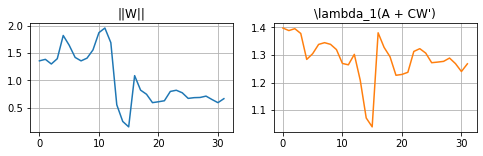

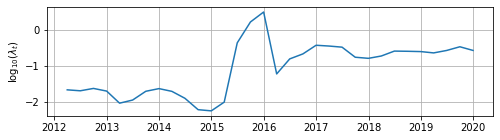

 RW:   0%|          | 0/32 [00:00<?, ?it/s]

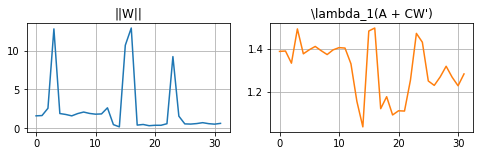

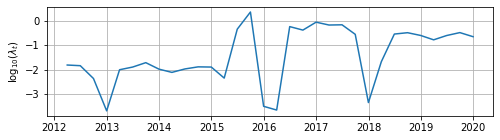

In [297]:
# Aggregated
esnSingle_A_agg_rw_multistep_for_2011 = esnSingle_rw_fit_multistep(
    esnModel=esnSingle_A, 
    Lambda=esnSingle_A_agg_cv10_lambda_2011,  
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

esnSingle_B_agg_rw_multistep_for_2011 = esnSingle_rw_fit_multistep(
    esnModel=esnSingle_B, 
    Lambda=esnSingle_B_agg_cv10_lambda_2011, 
    data=dataset2011, 
    steps=8,
    direct=False,
    retune=True,
    aggregate=True,
)

 RW:   0%|          | 0/32 [00:00<?, ?it/s]

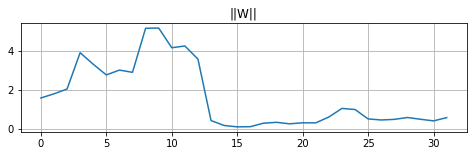

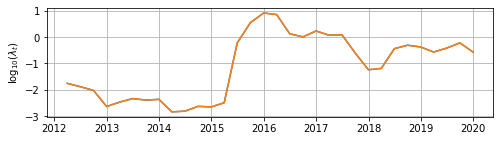

 RW:   0%|          | 0/32 [00:00<?, ?it/s]

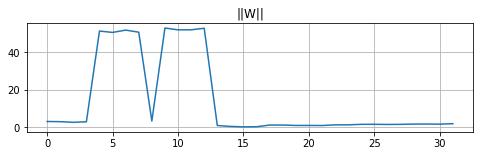

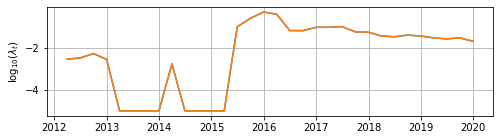

In [298]:
esnMulti_A_rw_multistep_for_2011 = esnMulti_rw_fit_multistep(
    esnModel=esnMulti_A, 
    Lambda=[esnMulti_A_cv10_lambda_2011[0], esnMulti_A_cv10_lambda_2011[0]], 
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
)

esnMulti_B_rw_multistep_for_2011 = esnMulti_rw_fit_multistep(
    esnModel=esnMulti_B, 
    Lambda=[esnMulti_B_cv10_lambda_2011[0], esnMulti_B_cv10_lambda_2011[0]], 
    data=dataset2011,
    steps=8,
    direct=False,
    retune=True,
)

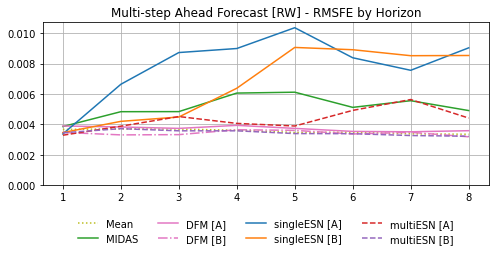

In [299]:
def hStepRMSFE_2011(forecasts_df):
    T = len(forecasts_df)
    steps = len(forecasts_df.columns)
    hStep_rmse = np.zeros((steps))
    for h, c in enumerate(forecasts_df.columns):
        hStep_rmse[h] = np.sqrt(np.mean(np.square(
            dataset2011['GDP_data_test'].to_numpy() - forecasts_df[[c]].to_numpy()
        )[h:(T-steps+h+1)]))
    return pd.DataFrame(data=hStep_rmse, index=range(1, 1+steps))

plt.figure(figsize=(8, 3))
plt.grid()
#
plt.plot(hStepRMSFE_2011(UnMean_rw_multistep_for_2011), label="Mean", c="C8", ls=':') 
#
plt.plot(hStepRMSFE_2011(MIDAS_rw_multistep_for_2011), label="MIDAS", c="C2") 
#
plt.plot(hStepRMSFE_2011(DFM_A_rw_multistep_for_2011), label="DFM [A]", c="C6") 
plt.plot(hStepRMSFE_2011(DFM_B_rw_multistep_for_2011), label="DFM [B]", c="C6", ls='-.') 
#
plt.plot(hStepRMSFE_2011(esnSingle_A_agg_rw_multistep_for_2011), label="singleESN [A]", c="C0") 
plt.plot(hStepRMSFE_2011(esnSingle_B_agg_rw_multistep_for_2011), label="singleESN [B]", c="C1") 
#
plt.plot(hStepRMSFE_2011(esnMulti_A_rw_multistep_for_2011), label="multiESN [A]", c="C3", ls='--') 
plt.plot(hStepRMSFE_2011(esnMulti_B_rw_multistep_for_2011), label="multiESN [B]", c="C4", ls='--') 
#
plt.ylim(bottom=0.)
#plt.yscale('log')
plt.title("Multi-step Ahead Forecast [RW] - RMSFE by Horizon")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_msa_rmsfe-by-h_rw_2011.pdf'), bbox_inches="tight")
plt.show()

In [300]:
table_RMSFE_multistep_rw_2011 = pd.DataFrame(
    index=range(1,9)
)
table_RMSFE_multistep_rw_2011.index.name = "RW_2011"
table_RMSFE_multistep_rw_2011["Model"] = ['Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
        'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
    ]

for h in range(8):
    ref_h_hStepRMSFE_rw = hStepRMSFE_2011(UnMean_rw_multistep_for_2011).iat[h,0]
    table_RMSFE_multistep_rw_2011[str(h+1)] = [
        hStepRMSFE_2011(UnMean_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(MIDAS_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(DFM_A_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(DFM_B_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(esnSingle_A_agg_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(esnSingle_B_agg_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(esnMulti_A_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
        hStepRMSFE_2011(esnMulti_B_rw_multistep_for_2011).iat[h,0] / ref_h_hStepRMSFE_rw,
    ]

table_RMSFE_multistep_rw_2011.round(4)

,Model,1,2,3,4,5,6,7,8
RW_2011,,,,,,,,,
1,Mean,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,MIDAS,1.0515,1.3032,1.3100,1.6742,1.7617,1.4672,1.6434,1.4631
3,DFM [A],1.0615,1.0325,1.0119,1.0884,1.0772,1.0148,1.0396,1.0693
4,DFM [B],0.9467,0.8927,0.9010,1.0089,1.0399,0.9663,1.0295,0.9494
5,singleESN [A],0.9193,1.7880,2.3595,2.4830,2.9813,2.4006,2.2336,2.6905
6,singleESN [B],0.9437,1.1322,1.2139,1.7617,2.6082,2.5519,2.5171,2.5407
7,multiESN [A],0.8964,1.0466,1.2221,1.1242,1.1222,1.4104,1.6662,1.3164
8,multiESN [B],0.9402,1.0026,0.9689,0.9893,0.9789,0.9720,0.9670,0.9609


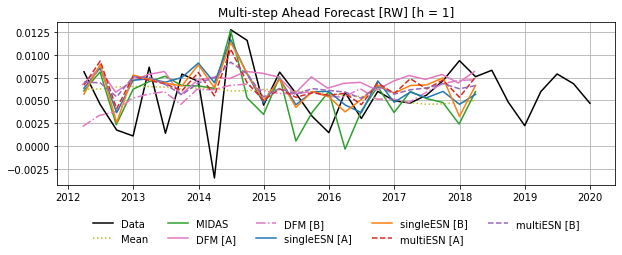

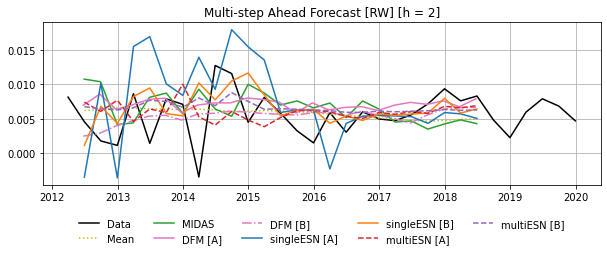

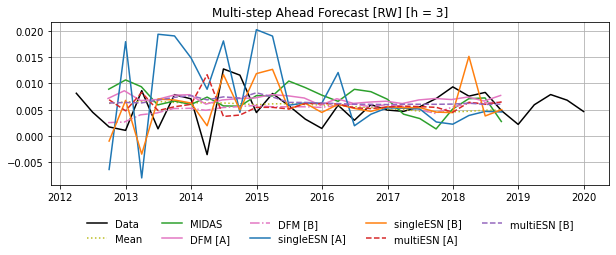

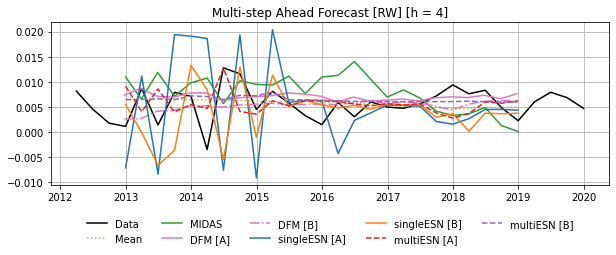

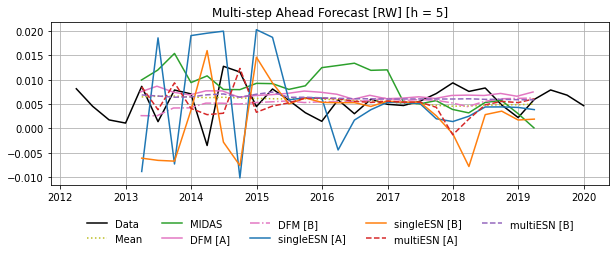

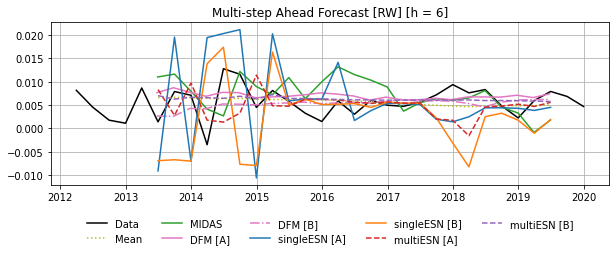

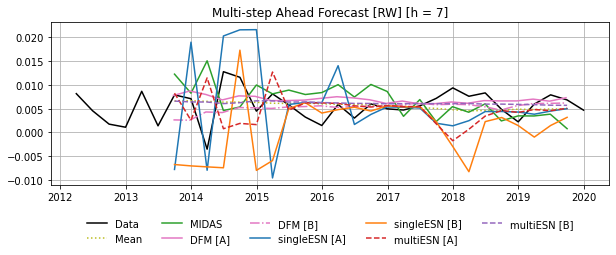

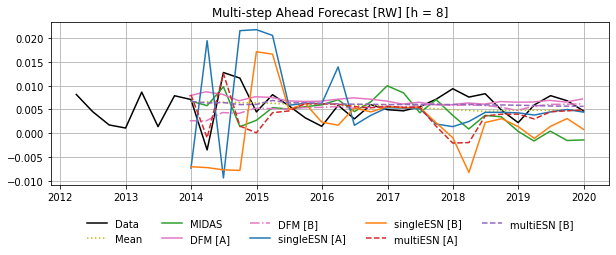

In [301]:
steps = 8
T = len(dataset2011['GDP_data_test'])
for h in range(steps):
    plt.figure(figsize=(10, 3))
    plt.grid()
    plt.plot(dataset2011['GDP_data_test'], c='k', label="Data")
    #
    plt.plot(UnMean_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="Mean", c="C8", ls=':') 
    #
    plt.plot(MIDAS_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="MIDAS", c="C2") 
    #
    plt.plot(DFM_A_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [A]", c="C6") 
    plt.plot(DFM_B_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="DFM [B]", c="C6", ls='-.') 
    #
    plt.plot(esnSingle_A_agg_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [A]", c="C0")
    plt.plot(esnSingle_B_agg_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="singleESN [B]", c="C1") 
    #
    plt.plot(esnMulti_A_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [A]", c="C3", ls='--') 
    plt.plot(esnMulti_B_rw_multistep_for_2011[h].iloc[h:(T-steps+h+1),], label="multiESN [B]", c="C4", ls='--')
    #
    plt.title("Multi-step Ahead Forecast [RW]" + f" [h = {h+1}]")
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                    frameon=False, fancybox=False, shadow=False, ncol=5)
    plt.show()

In [302]:
#from bokeh.io import show, output_notebook
#from bokeh.palettes import Category10_8
#from bokeh.plotting import figure
#from bokeh.models import ColumnDataSource, MultiLine
#output_notebook()
#
#p = figure(width=800, height=350, x_axis_type="datetime")
#for forecast, name, color in zip(
#    [UnMean_rw_multistep_for_2011, MIDAS_rw_multistep_for_2011,
#        DFM_A_rw_multistep_for_2011, DFM_B_rw_multistep_for_2011,
#        esnSingle_A_agg_rw_multistep_for_2011, esnSingle_B_agg_rw_multistep_for_2011,
#        esnMulti_A_rw_multistep_for_2011, esnMulti_B_rw_multistep_for_2011],
#    ["Mean", "MIDAS", "DFM [A]", "DFM [B]",
#        "singleESN [A]", "singleESN [B]", "multiESN [A]", "multiESN [B]"],
#    Category10_8,
#):
#    #plot_forecast_df = pd.DataFrame(data=[], columns=["Date", "Value"])
#    #steps = len(forecast.columns)
#    #T = len(forecast) - steps
#    #j = 0
#    #for t in range(T):
#    #    msfor_t = np.array([forecast.iloc[t+h,h] for h in range(steps)])
#    #    df_t = pd.DataFrame({
#    #        "Date": forecast.index[t:t+steps],
#    #        "Value": msfor_t,
#    #    })
#    #    plot_forecast_df = pd.concat([plot_forecast_df, df_t])
#    #
#    #p.line(plot_forecast_df["Date"], plot_forecast_df["Value"], 
#    #        line_width=2, color=color, alpha=0.8,
#    #        muted_color=color, muted_alpha=0.2, legend_label=name)
#
#    source = ColumnDataSource(dict(
#            value = [[forecast.iloc[t+h,h] for h in range(steps)] for t in range(T)],
#            date = [forecast.index[t:t+steps] for t in range(T)],
#        )
#    )
#
#    glyph = MultiLine(xs="date", ys="value", line_color=color, line_width=2, 
#                        line_alpha=0.8,) #muted_color=color, muted_alpha=0.2, 
#                        #legend_label=name)
#    p.add_glyph(source, glyph)
#
#p.legend.location = "top_left"
#p.legend.click_policy = "mute"
#
#show(p)

Export multi-horizon losses:

In [339]:
mhmcs_steps = 8
mhmcs_multistep_rw_2011 = xr.DataArray(
    data=np.zeros(
        (mhmcs_steps, len(dataset2011['GDP_data_test']) - mhmcs_steps, 8)
    ),
    dims=["H", "T", "M0"],
    coords={
        "M0": [
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    },
    attrs=dict(
        names=[
            'Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]'
        ]
    )
)

for h in range(mhmcs_steps):
    mhmcs_multistep_rw_2011[h, :, :] = (
        np.c_[
            UnMean_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            MIDAS_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_A_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            DFM_B_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_A_agg_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnSingle_B_agg_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_A_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
            esnMulti_B_rw_multistep_for_2011[h].iloc[h:(-mhmcs_steps+h),],
        ] - dataset2011['GDP_data_test'].iloc[h:(-mhmcs_steps+h),].to_numpy())

In [340]:
mhmcs_multistep_rw_2011_df = mhmcs_multistep_rw_2011.to_dataframe(
    name="Loss", dim_order=['M0', 'H', 'T']
)
mhmcs_multistep_rw_2011_df.to_csv(
    os.path.join(path_folder, "R", "mhmcs_small_multistep_rw_2011.csv")
)

### Tables

#### 1-Step Ahead

In [305]:
# Export Relative-MFSE to CSV
method_names = ['Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]']

RelMSFE_results = pd.DataFrame(
    data=np.zeros((len(method_names), 6)), 
    columns=[
       "MCS SMALL FIX 2007", "MCS SMALL FIX 2011", 
       "MCS SMALL EW 2007" , "MCS SMALL EW 2011" , 
       "MCS SMALL RW 2007" , "MCS SMALL RW 2011"
    ]
)
RelMSFE_results.loc[:,"MCS SMALL FIX 2007"] = [
        1, MIDAS_MSE_toRef_2007_fix,
        DFM_A_MSE_toRef_2007_fix, DMF_B_MSE_toRef_2007_fix, 
        esnSingle_A_MSE_toRef_2007_fix, esnSingle_B_MSE_toRef_2007_fix,
        esnMulti_A_MSE_toRef_2007_fix, esnMulti_B_MSE_toRef_2007_fix,
    ]
RelMSFE_results.loc[:,"MCS SMALL FIX 2011"] = [
        1, MIDAS_MSE_toRef_2011_fix,
        DFM_A_MSE_toRef_2011_fix, DMF_B_MSE_toRef_2011_fix, 
        esnSingle_A_MSE_toRef_2011_fix, esnSingle_B_MSE_toRef_2011_fix,
        esnMulti_A_MSE_toRef_2011_fix, esnMulti_B_MSE_toRef_2011_fix,
    ]
RelMSFE_results.loc[:,"MCS SMALL EW 2007"] = [
        1, MIDAS_MSE_toRef_2007_ew,
        DFM_A_MSE_toRef_2007_ew, DMF_B_MSE_toRef_2007_ew, 
        esnSingle_A_MSE_toRef_2007_ew, esnSingle_B_MSE_toRef_2007_ew,
        esnMulti_A_MSE_toRef_2007_ew, esnMulti_B_MSE_toRef_2007_ew,
    ]
RelMSFE_results.loc[:,"MCS SMALL EW 2011"] = [
        1, MIDAS_MSE_toRef_2011_ew, 
        DFM_A_MSE_toRef_2011_ew, DMF_B_MSE_toRef_2011_ew, 
        esnSingle_A_MSE_toRef_2011_ew, esnSingle_B_MSE_toRef_2011_ew,
        esnMulti_A_MSE_toRef_2011_ew, esnMulti_B_MSE_toRef_2011_ew,
    ]
RelMSFE_results.loc[:,"MCS SMALL RW 2007"] = [
        1, MIDAS_MSE_toRef_2007_rw,
        DFM_A_MSE_toRef_2007_rw, DMF_B_MSE_toRef_2007_rw, 
        esnSingle_A_MSE_toRef_2007_rw, esnSingle_B_MSE_toRef_2007_rw,
        esnMulti_A_MSE_toRef_2007_rw, esnMulti_B_MSE_toRef_2007_rw,
    ]
RelMSFE_results.loc[:,"MCS SMALL RW 2011"] = [
        1, MIDAS_MSE_toRef_2011_rw,
        DFM_A_MSE_toRef_2011_rw, DMF_B_MSE_toRef_2011_rw, 
        esnSingle_A_MSE_toRef_2011_rw, esnSingle_B_MSE_toRef_2011_rw,
        esnMulti_A_MSE_toRef_2011_rw, esnMulti_B_MSE_toRef_2011_rw,
    ]

RelMSFE_results.round(3).to_csv(
    os.path.join(path_folder, "R", "RelMSFE_small.csv")
)
RelMSFE_results.round(3)

,MCS SMALL FIX 2007,MCS SMALL FIX 2011,MCS SMALL EW 2007,MCS SMALL EW 2011,MCS SMALL RW 2007,MCS SMALL RW 2011
0,1.000,1.000,1.000,1.000,1.000,1.000
1,0.533,1.300,0.596,1.129,0.709,1.170
2,0.799,1.337,0.980,1.320,0.919,1.226
3,0.885,1.221,0.982,1.022,0.948,1.028
4,0.721,1.015,0.597,0.867,0.529,0.863
5,0.758,0.921,0.602,0.844,0.561,0.930
6,0.802,1.250,0.635,0.874,0.621,0.859
7,0.590,0.969,0.552,0.895,0.530,0.921


In [306]:
def MCS_include_stars(m, mcs25, mcs10):
    s = ''
    if m in mcs25.included: s+= '*'
    if m in mcs10.included: s+= '*'
    #if not s == '': s = '$' + s + '$'
    return s

In [307]:
method_names = ['Mean', 'MIDAS', 'DFM [A]', 'DFM [B]', 
                'singleESN [A]', 'singleESN [B]', 'multiESN [A]', 'multiESN [B]']

table_MSFE_MCS = pd.DataFrame(dict(
    method=method_names,
    MSFE_fix_2007=[
        1, MIDAS_MSE_toRef_2007_fix,
        DFM_A_MSE_toRef_2007_fix, DMF_B_MSE_toRef_2007_fix, 
        esnSingle_A_MSE_toRef_2007_fix, esnSingle_B_MSE_toRef_2007_fix,
        esnMulti_A_MSE_toRef_2007_fix, esnMulti_B_MSE_toRef_2007_fix,
    ],
    MCS_fix_2007=[
        MCS_include_stars(m, mcs_25_2007_fix, mcs_10_2007_fix) for m in method_names
    ],
    MSFE_fix_2011=[
        1, MIDAS_MSE_toRef_2011_fix,
        DFM_A_MSE_toRef_2011_fix, DMF_B_MSE_toRef_2011_fix, 
        esnSingle_A_MSE_toRef_2011_fix, esnSingle_B_MSE_toRef_2011_fix,
        esnMulti_A_MSE_toRef_2011_fix, esnMulti_B_MSE_toRef_2011_fix,
    ],
    MCS_fix_2011=[
        MCS_include_stars(m, mcs_25_2011_fix, mcs_10_2011_fix) for m in method_names
    ],
    MSFE_ew_2007=[
        1, MIDAS_MSE_toRef_2007_ew,
        DFM_A_MSE_toRef_2007_ew, DMF_B_MSE_toRef_2007_ew, 
        esnSingle_A_MSE_toRef_2007_ew, esnSingle_B_MSE_toRef_2007_ew,
        esnMulti_A_MSE_toRef_2007_ew, esnMulti_B_MSE_toRef_2007_ew,
    ],
    MCS_ew_2007=[
        MCS_include_stars(m, mcs_25_2007_ew, mcs_10_2007_ew) for m in method_names
    ],
    MSFE_ew_2011=[
        1, MIDAS_MSE_toRef_2011_ew, 
        DFM_A_MSE_toRef_2011_ew, DMF_B_MSE_toRef_2011_ew, 
        esnSingle_A_MSE_toRef_2011_ew, esnSingle_B_MSE_toRef_2011_ew,
        esnMulti_A_MSE_toRef_2011_ew, esnMulti_B_MSE_toRef_2011_ew,
    ],
    MCS_ew_2011=[
        MCS_include_stars(m, mcs_25_2011_ew, mcs_10_2011_ew) for m in method_names
    ],
    MSFE_rw_2007=[
        1, MIDAS_MSE_toRef_2007_rw,
        DFM_A_MSE_toRef_2007_rw, DMF_B_MSE_toRef_2007_rw, 
        esnSingle_A_MSE_toRef_2007_rw, esnSingle_B_MSE_toRef_2007_rw,
        esnMulti_A_MSE_toRef_2007_rw, esnMulti_B_MSE_toRef_2007_rw,
    ],
    MCS_rw_2007=[
        MCS_include_stars(m, mcs_25_2007_rw, mcs_10_2007_rw) for m in method_names
    ],
    MSFE_rw_2011=[
        1, MIDAS_MSE_toRef_2011_rw,
        DFM_A_MSE_toRef_2011_rw, DMF_B_MSE_toRef_2011_rw, 
        esnSingle_A_MSE_toRef_2011_rw, esnSingle_B_MSE_toRef_2011_rw,
        esnMulti_A_MSE_toRef_2011_rw, esnMulti_B_MSE_toRef_2011_rw,
    ],
    MCS_rw_2011=[
        MCS_include_stars(m, mcs_25_2011_rw, mcs_10_2011_rw) for m in method_names
    ],
))

table_MSFE_MCS.round(3)

,method,MSFE_fix_2007,MCS_fix_2007,MSFE_fix_2011,MCS_fix_2011,MSFE_ew_2007,MCS_ew_2007,MSFE_ew_2011,MCS_ew_2011,MSFE_rw_2007,MCS_rw_2007,MSFE_rw_2011,MCS_rw_2011
0,Mean,1.000,,1.000,**,1.000,**,1.000,**,1.000,**,1.000,**
1,MIDAS,0.533,**,1.300,,0.596,,1.129,,0.709,,1.170,
2,DFM [A],0.799,,1.337,,0.980,*,1.320,,0.919,*,1.226,
3,DFM [B],0.885,,1.221,**,0.982,*,1.022,**,0.948,,1.028,**
4,singleESN [A],0.721,**,1.015,**,0.597,,0.867,,0.529,,0.863,
5,singleESN [B],0.758,,0.921,**,0.602,,0.844,,0.561,,0.930,
6,multiESN [A],0.802,,1.250,,0.635,,0.874,,0.621,,0.859,
7,multiESN [B],0.590,**,0.969,,0.552,,0.895,,0.530,,0.921,


In [308]:
print(table_MSFE_MCS.round(3).to_latex(index=False))

\begin{tabular}{lrlrlrlrlrlrl}
\toprule
       method &  MSFE\_fix\_2007 & MCS\_fix\_2007 &  MSFE\_fix\_2011 & MCS\_fix\_2011 &  MSFE\_ew\_2007 & MCS\_ew\_2007 &  MSFE\_ew\_2011 & MCS\_ew\_2011 &  MSFE\_rw\_2007 & MCS\_rw\_2007 &  MSFE\_rw\_2011 & MCS\_rw\_2011 \\
\midrule
         Mean &          1.000 &              &          1.000 &           ** &         1.000 &          ** &         1.000 &          ** &         1.000 &          ** &         1.000 &          ** \\
        MIDAS &          0.533 &           ** &          1.300 &              &         0.596 &             &         1.129 &             &         0.709 &             &         1.170 &             \\
      DFM [A] &          0.799 &              &          1.337 &              &         0.980 &           * &         1.320 &             &         0.919 &           * &         1.226 &             \\
      DFM [B] &          0.885 &              &          1.221 &           ** &         0.982 &           * &         1.022

C:\Users\Ballarin\AppData\Local\Temp\ipykernel_23088\787148135.py:1: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  print(table_MSFE_MCS.round(3).to_latex(index=False))


#### Multistep Ahead

In [309]:
pd.concat([
    pd.DataFrame(columns=["Model", ] +  [str(i) for i in range(1,9)]),
    table_RMSFE_multistep_fix_2007.rename_axis("FIX_2007").reset_index(),
    table_RMSFE_multistep_ew_2007.rename_axis("EW_2007").reset_index(),
    table_RMSFE_multistep_rw_2007.rename_axis("RW_2007").reset_index(),
    #
    table_RMSFE_multistep_fix_2011.rename_axis("FIX_2011").reset_index(),
    table_RMSFE_multistep_ew_2011.rename_axis("EW_2011").reset_index(),
    table_RMSFE_multistep_rw_2011.rename_axis("RW_2011").reset_index(),
]).to_csv(
    os.path.join(path_folder, "R", "RelRMSFE_MH_small.csv")
)

### Robustness Checks

In [31]:
[] = 0

TypeError: cannot unpack non-iterable int object

#### ESN Resampling

In [46]:
dataset2007_short = {}
# Shorten sample to make resampling reasonably quick
for d in ['GDP_data_train', 'GDP_data_test', 'm_data_train', 'm_data_test',
            'd_data_train', 'd_data_test', 'GDP_fill_data_train', 'GDP_fill_data_test', 
            'md_fill_data_train', 'md_fill_data_test', 
            'md_fill_agg_data_train', 'md_fill_agg_data_test']:
    dataset2007_short[d] = dataset2007[d].loc[:'2011-12-31']

In [59]:
# DEF: SingleESN__resampleFitForecast()
def SingleESN__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        aggregate=False, doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N = N_esn
    k = int(m_data.shape[1] + d_data.shape[1])

    rho, gamma, leak_rate = pars

    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_fill_data_train, GDP_fill_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_fill_data_train, GDP_fill_data_test,
            return_mu_sig=True)
    )
    md_fill_data_train, md_fill_data_test = normalize_train_test(md_fill_data_train, md_fill_data_test)

    fits      = []
    forecasts = []
    lambdas   = []
    state_eigs = []
    for n in tqdm(range(n_models)):
        esn_S = ESN(
            N=N,
            A=stateMatrixGenerator(
                (N, N), 
                dist='sparse_normal', sparsity=10/N, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N, k), 
                dist='sparse_uniform', sparsity=10/N, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho,
            gamma=gamma,
            leak_rate=leak_rate,
            activation=np.tanh,
        )

        esnSingle = ESNMultiFrequency((esn_S,), ar=False) 

        if doOptim:
            #_, esnSingle__psi_optim = esnSingle.optim(
            #    Y=GDP_fill_data_train, z=(md_fill_data_train, ),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnSingle__current = esnSingle__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnSingle__current = esnSingle

        if doCV:
            Lambda = esnSingle__current.ridge_lambda_cv(
                Y=GDP_fill_data_train, z=(md_fill_data_train, ), 
                method="ridge-isotropic",
                cv_options="-cv:10-test_size:5",
                steps=1,
                debug=False,
            )
        else:
            assert not Lambda is None

        esnSingle_fit = esnSingle__current.fit(
            Y=GDP_fill_data_train, z=(md_fill_data_train, ), 
            method='ridge',
            Lambda=Lambda,
            full=False,
            debug=False,
        )

        esnSingle_for = esnSingle__current.fixedParamsForecast(
            Yf=GDP_fill_data_test, zf=(md_fill_data_test, ),  
            fit=esnSingle_fit
        )

        fits.append(esnSingle_fit['fit_for'][0]['Y_fit'])
        forecasts.append(
            esnSingle_for['Forecast'][0]['Y_for'] * GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()
        )

        lambdas.append(Lambda)

        fit_states = esnSingle_fit['fit_for'][0]['X']
        fit_Gamma0 = fit_states.T @ fit_states
        state_eigs.append(np.abs(np.linalg.eigvals(fit_Gamma0)))

    fits_np = np.full((n_models, len(fits[0].to_numpy())), np.nan)
    fits_se_np = np.full((n_models, len(fits[0].to_numpy())), np.nan)
    forecasts_np = np.full((n_models, len(forecasts[0].to_numpy())), np.nan)
    forecasts_se_np = np.full((n_models, len(forecasts[0].to_numpy())), np.nan)
    eigs_np = np.full((n_models, N), np.nan)
    for n in range(n_models):
        fits_np[n,:] = np.squeeze(fits[n])
        fits_se_np[n,:] = np.squeeze((fits[n] - GDP_fill_data_train.to_numpy()[1:,])**2)
        forecasts_np[n,:] = np.squeeze(forecasts[n])
        forecasts_se_np[n,:] = np.squeeze((forecasts[n] - GDP_fill_data_test.to_numpy())**2)
        eigs_np[n,:] = np.squeeze(state_eigs[n])

    fits_se_np = np.cumsum(fits_se_np, axis=1)
    forecasts_se_np = np.cumsum(forecasts_se_np, axis=1)

    fits_qts = np.quantile(fits_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    fits_se_qts = np.quantile(fits_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_se_qts = np.quantile(forecasts_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    pars = {'N': N_esn, 'rho': rho, 'gamma': gamma, 'leak_rate': leak_rate, 'doOptim': doOptim, 'doCV': doCV}

    return (fits_qts, forecasts_qts, fits_se_qts, forecasts_se_qts,
            fits_np, forecasts_np, eigs_np, lambdas, pars)

In [159]:
(esnSingle_A__fits_qts, 
    esnSingle_A__forecasts_qts,
    esnSingle_A__fits_se_qts,
    esnSingle_A__forecasts_se_qts,
    _, _,
    esnSingle_A__Gamma0_eigs,
    esnSingle_A__lambdas,
    pars_esnSingle_A
) = SingleESN__resampleFitForecast(
    n_models=100, 
    N_esn=30, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=esnSingle_A_agg_cv10_lambda_2007,
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [03:01<00:00,  1.82s/it]


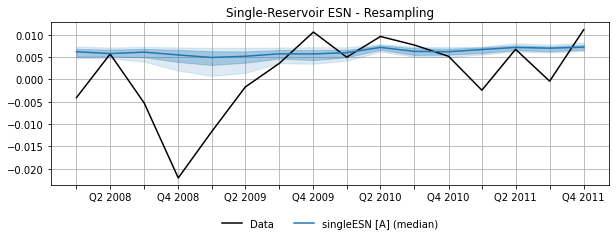

In [160]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_A__forecasts_qts[2,:], c="C0", label="singleESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A__forecasts_qts[1,:], esnSingle_A__forecasts_qts[3,:],
        color="C0", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A__forecasts_qts[0,:], esnSingle_A__forecasts_qts[4,:],
        color="C0", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_a_resample_2007.pdf'), bbox_inches="tight")
plt.show()

In [62]:
(esnSingle_B__fits_qts, 
    esnSingle_B__forecasts_qts,
    esnSingle_B__fits_se_qts,
    esnSingle_B__forecasts_se_qts,
    _, _,
    esnSingle_B__Gamma0_eigs,
    esnSingle_B__lambdas,
    pars_esnSingle_B
) = SingleESN__resampleFitForecast(
    n_models=100, 
    N_esn=120, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=esnSingle_B_agg_cv10_lambda_2007,
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [03:54<00:00,  2.35s/it]


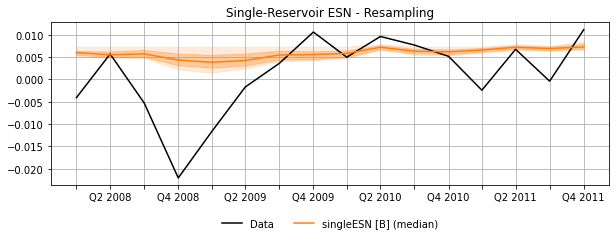

In [64]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_B__forecasts_qts[2,:], c="C1", label="singleESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B__forecasts_qts[1,:], esnSingle_B__forecasts_qts[3,:],
        color="C1", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B__forecasts_qts[0,:], esnSingle_B__forecasts_qts[4,:],
        color="C1", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_b_resample_2007.pdf'), bbox_inches="tight")
plt.show()

In [65]:
# DEF: SingleESN_ew__resampleFitForecast()
def SingleESN_ew__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        aggregate=False, doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N = N_esn
    k = int(m_data.shape[1] + d_data.shape[1])

    rho, gamma, leak_rate = pars

    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_test_dates = GDP_fill_data_test.index

    forecasts = []
    for n in tqdm(range(n_models)):
        esn_S = ESN(
            N=N,
            A=stateMatrixGenerator(
                (N, N), 
                dist='sparse_normal', sparsity=10/N, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N, k), 
                dist='sparse_uniform', sparsity=10/N, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho,
            gamma=gamma,
            leak_rate=leak_rate,
            activation=np.tanh,
        )

        esnSingle = ESNMultiFrequency((esn_S,), ar=False) 

        if doOptim:
            #_, esnSingle__psi_optim = esnSingle.optim(
            #    Y=GDP_fill_data_train, z=(md_fill_data_train, ),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnSingle__current = esnSingle__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnSingle__current = esnSingle

        forecast_ew = np.zeros((len(GDP_fill_data_test), 1))
        for j in tqdm(range(len(GDP_fill_data_test)), desc=" EW", position=1, leave=False):
            if j > 0:
                GDP_fill_data_train_j = pd.concat([
                    GDP_fill_data_train, 
                    GDP_fill_data_test.iloc[0:j,]
                ])
                md_fill_data_train_j = pd.concat([
                    md_fill_data_train, 
                    md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
                md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
            else:
                GDP_fill_data_train_j = GDP_fill_data_train
                md_fill_data_train_j = md_fill_data_train
                GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
                md_fill_data_test_j = md_fill_data_test.iloc[[0],]

            # Normalize
            GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                    return_mu_sig=True)
            )
            md_fill_data_train_j, md_fill_data_test_j = (
                normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
            )

            if doCV:
                Lambda_j = esnSingle__current.ridge_lambda_cv(
                    Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                    method="ridge-isotropic",
                    cv_options="-cv:5-test_size:5",
                    steps=1,
                    debug=False,
                )
            else:
                Lambda_j = Lambda

            esnSingle_fit = esnSingle__current.fit(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
                method='ridge',
                Lambda=Lambda_j,
                full=False,
                debug=False,
            )

            esnSingle_for = esnSingle__current.fixedParamsForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
                fit=esnSingle_fit
            )

            forecast_ew[j] = np.squeeze(esnSingle_for['Forecast'][0]['Y_for']) * sig_j + mu_j

        forecasts.append(forecast_ew)

    forecasts_np = np.full((n_models, len(forecasts[0])), np.nan)
    for n in range(n_models):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    pars = {'N': N_esn, 'rho': rho, 'gamma': gamma, 'leak_rate': leak_rate, 'doOptim': doOptim, 'doCV': doCV}

    return (forecasts_qts, forecasts_np, pars)

In [201]:
(esnSingle_A_ew__forecasts_qts,
    _,
    pars_esnSingle_A
) = SingleESN_ew__resampleFitForecast(
    n_models=100, 
    N_esn=30, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=[],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [41:32<00:00, 24.93s/it]


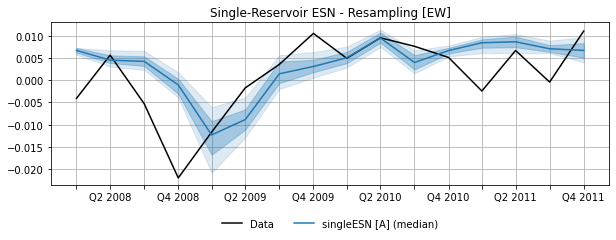

In [203]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_A_ew__forecasts_qts[2,:], c="C0", label="singleESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A_ew__forecasts_qts[1,:], esnSingle_A_ew__forecasts_qts[3,:],
        color="C0", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A_ew__forecasts_qts[0,:], esnSingle_A_ew__forecasts_qts[4,:],
        color="C0", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_a_resample_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [67]:
(esnSingle_B_ew__forecasts_qts,
    _,
    pars_esnSingle_B
) = SingleESN_ew__resampleFitForecast(
    n_models=100, 
    N_esn=120, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=[],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [40:12<00:00, 24.13s/it]


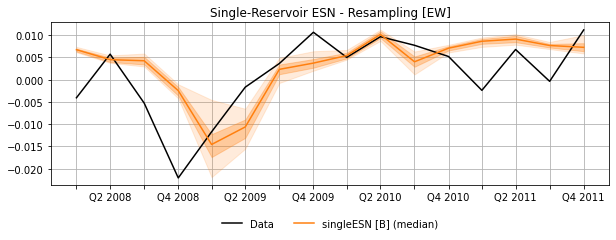

In [68]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_B_ew__forecasts_qts[2,:], c="C1", label="singleESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B_ew__forecasts_qts[1,:], esnSingle_B_ew__forecasts_qts[3,:],
        color="C1", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B_ew__forecasts_qts[0,:], esnSingle_B_ew__forecasts_qts[4,:],
        color="C1", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_b_resample_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [70]:
# DEF: SingleESN_rw__resampleFitForecast()
def SingleESN_rw__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        aggregate=False, doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N = N_esn
    k = int(m_data.shape[1] + d_data.shape[1])

    rho, gamma, leak_rate = pars

    GDP_fill_data_train = data['GDP_fill_data_train']
    GDP_fill_data_test = data['GDP_fill_data_test']
    if not aggregate:
        md_fill_data_train = data['md_fill_data_train']
        md_fill_data_test = data['md_fill_data_test']
    else:
        md_fill_data_train = data['md_fill_agg_data_train']
        md_fill_data_test = data['md_fill_agg_data_test']

    GDP_dates = GDP_fill_data_train.index.append(GDP_fill_data_test.index)
    GDP_test_dates = GDP_fill_data_test.index

    forecasts = []
    for n in tqdm(range(n_models)):
        esn_S = ESN(
            N=N,
            A=stateMatrixGenerator(
                (N, N), 
                dist='sparse_normal', sparsity=10/N, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N, k), 
                dist='sparse_uniform', sparsity=10/N, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho,
            gamma=gamma,
            leak_rate=leak_rate,
            activation=np.tanh,
        )

        esnSingle = ESNMultiFrequency((esn_S,), ar=False) 

        if doOptim:
            #_, esnSingle__psi_optim = esnSingle.optim(
            #    Y=GDP_fill_data_train, z=(md_fill_data_train, ),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnSingle__current = esnSingle__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnSingle__current = esnSingle

        forecast_rw = np.zeros((len(GDP_fill_data_test), 1))
        for j in tqdm(range(len(GDP_fill_data_test)), desc=" RW", position=1, leave=False):
            if j > 0:
                GDP_fill_data_train_j = pd.concat([
                    GDP_fill_data_train,
                    GDP_fill_data_test.iloc[0:j,]
                ]).iloc[j:,]
                md_fill_data_train_j = pd.concat([
                    md_fill_data_train,
                    md_fill_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                md_fill_data_train_j = md_fill_data_train_j[GDP_dates[j-1]:]
                GDP_fill_data_test_j = GDP_fill_data_test.iloc[[j],]
                md_fill_data_test_j = md_fill_data_test.loc[[GDP_test_dates[j-1]],]
            else:
                GDP_fill_data_train_j = GDP_fill_data_train
                md_fill_data_train_j = md_fill_data_train
                GDP_fill_data_test_j = GDP_fill_data_test.iloc[[0],]
                md_fill_data_test_j = md_fill_data_test.iloc[[0],]

            # Normalize
            GDP_fill_data_train_j, GDP_fill_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_fill_data_train_j, GDP_fill_data_test_j,
                    return_mu_sig=True)
            )
            md_fill_data_train_j, md_fill_data_test_j = (
                normalize_train_test(md_fill_data_train_j, md_fill_data_test_j)
            )

            if doCV:
                Lambda_j = esnSingle__current.ridge_lambda_cv(
                    Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ),
                    method="ridge-isotropic",
                    cv_options="-cv:5-test_size:5",
                    steps=1,
                    debug=False,
                )
            else:
                Lambda_j = Lambda

            esnSingle_fit = esnSingle__current.fit(
                Y=GDP_fill_data_train_j, z=(md_fill_data_train_j, ), 
                method='ridge',
                Lambda=Lambda_j,
                full=False,
                debug=False,
            )

            esnSingle_for = esnSingle__current.fixedParamsForecast(
                Yf=GDP_fill_data_test_j, zf=(md_fill_data_test_j, ), 
                fit=esnSingle_fit
            )

            forecast_rw[j] = np.squeeze(esnSingle_for['Forecast'][0]['Y_for']) * sig_j + mu_j

        forecasts.append(forecast_rw)

    forecasts_np = np.full((n_models, len(forecasts[0])), np.nan)
    for n in range(n_models):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    pars = {'N': N_esn, 'rho': rho, 'gamma': gamma, 'leak_rate': leak_rate, 'doOptim': doOptim, 'doCV': doCV}

    return (forecasts_qts, forecasts_np, pars)

In [208]:
(esnSingle_A_rw__forecasts_qts,
    _,
    pars_esnSingle_A
) = SingleESN_rw__resampleFitForecast(
    n_models=100, 
    N_esn=30, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=[],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [36:07<00:00, 21.67s/it]


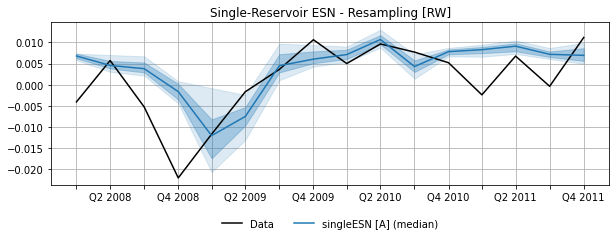

In [209]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_A_rw__forecasts_qts[2,:], c="C0", label="singleESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A_rw__forecasts_qts[1,:], esnSingle_A_rw__forecasts_qts[3,:],
        color="C0", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_A_rw__forecasts_qts[0,:], esnSingle_A_rw__forecasts_qts[4,:],
        color="C0", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_a_resample_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [71]:
(esnSingle_B_rw__forecasts_qts,
    _,
    pars_esnSingle_B
) = SingleESN_rw__resampleFitForecast(
    n_models=100, 
    N_esn=120, 
    pars=(0.5, 1, 0.1),
    data=dataset2007_short,
    aggregate=True,
    Lambda=[],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [40:02<00:00, 24.02s/it]


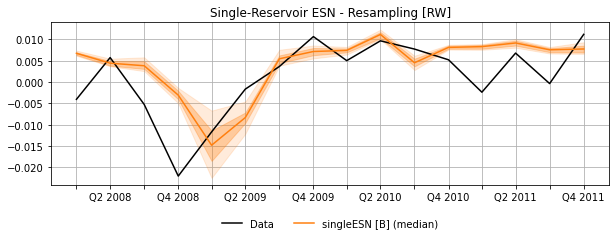

In [72]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnSingle_B_agg_fix_for_1sa_2007, c="C1", ls=':', label="singleESN [B]")
#
#plt.plot(esnSingle_A_agg_fix_for_1sa_2007, c="C3", label="singleESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnSingle_B_rw__forecasts_qts[2,:], c="C1", label="singleESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B_rw__forecasts_qts[1,:], esnSingle_B_rw__forecasts_qts[3,:],
        color="C1", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnSingle_B_rw__forecasts_qts[0,:], esnSingle_B_rw__forecasts_qts[4,:],
        color="C1", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Single-Reservoir ESN - Resampling [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_singleesn_b_resample_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [46]:
# DEF: MultiESN__resampleFitForecast()
def MultiESN__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N_m, N_d = N_esn
    k_m = int(m_data.shape[1])
    k_d = int(d_data.shape[1])

    rho_m, gamma_m, leak_rate_m = pars[0]
    rho_d, gamma_d, leak_rate_d = pars[1]

    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    #GDP_test_dates = GDP_data_test.index

    GDP_data_train, GDP_data_test, GDP_mu_train, GDP_sig_train = (
        normalize_train_test(GDP_data_train, GDP_data_test,
            return_mu_sig=True)
    )
    m_data_train, m_data_test = normalize_train_test(m_data_train, m_data_test)
    d_data_train, d_data_test = normalize_train_test(d_data_train, d_data_test)

    fits      = []
    forecasts = []
    lambdas   = []
    state_eigs = []
    for n in tqdm(range(n_models)):

        esn_M = ESN(
            N=N_m,
            A=stateMatrixGenerator(
                (N_m, N_m), 
                dist='sparse_normal', sparsity=10/N_m, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N_m, m_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_m, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho_m,
            gamma=gamma_m,
            leak_rate=leak_rate_m,
            activation=np.tanh,
        )

        esn_D = ESN(
            N=N_d,
            A=stateMatrixGenerator(
                (N_d, N_d), 
                dist='sparse_normal', sparsity=10/N_d, normalize='eig',
                seed=20220623
            ),
            C=stateMatrixGenerator(
                (N_d, d_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_d, normalize='norm2',
                seed=20220623
            ),
            rho=rho_d,
            gamma=gamma_d,
            leak_rate=leak_rate_d,
            activation=np.tanh,
        )

        esnMulti = ESNMultiFrequency((esn_M, esn_D), ar=False)  

        if doOptim:
            #_, esnMulti__psi_optim = esnMulti.optim(
            #    Y=GDP_data_train, z=(m_data_train, d_data_train),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnMulti__current = esnMulti__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnMulti__current = esnMulti

        if doCV:
            Lambda = esnMulti__current.ridge_lambda_cv(
                Y=GDP_data_train, z=(m_data_train, d_data_train), 
                method="ridge-isotropic",
                cv_options="-cv:10-test_size:5",
                steps=1,
                debug=False,
            )
            Lambda = [Lambda[0], Lambda[0]]
        else:
            assert not Lambda is None

        esnMulti_fit = esnMulti__current.fit(
            Y=GDP_data_train, z=(m_data_train, d_data_train), 
            method='ridge',
            Lambda=Lambda,
            full=False,
            debug=False,
        )

        esnMulti_for = esnMulti__current.fixedParamsForecast(
            Yf=GDP_data_test, zf=(m_data_test, d_data_test),  
            fit=esnMulti_fit
        )

        fits.append(esnMulti_fit['fit_for'][0]['Y_fit'])
        forecasts.append(
            esnMulti_for['Forecast'][0]['Y_for'] * GDP_sig_train.to_numpy() + GDP_mu_train.to_numpy()
        )

        lambdas.append(Lambda)

        fit_states = esnMulti_fit['fit_for'][0]['X']
        fit_Gamma0 = fit_states.T @ fit_states
        state_eigs.append(np.abs(np.linalg.eigvals(fit_Gamma0)))

    fits_np = np.full((n_models, len(fits[0].to_numpy())), np.nan)
    fits_se_np = np.full((n_models, len(fits[0].to_numpy())), np.nan)
    forecasts_np = np.full((n_models, len(forecasts[0].to_numpy())), np.nan)
    forecasts_se_np = np.full((n_models, len(forecasts[0].to_numpy())), np.nan)
    eigs_np = np.full((n_models, N_m+N_d), np.nan)
    for n in range(n_models):
        fits_np[n,:] = np.squeeze(fits[n])
        fits_se_np[n,:] = np.squeeze((fits[n] - GDP_data_train.to_numpy()[1:,])**2)
        forecasts_np[n,:] = np.squeeze(forecasts[n])
        forecasts_se_np[n,:] = np.squeeze((forecasts[n] - GDP_data_test.to_numpy())**2)
        #eigs_np[n,:] = np.squeeze(state_eigs[n])

    fits_se_np = np.cumsum(fits_se_np, axis=1)
    forecasts_se_np = np.cumsum(forecasts_se_np, axis=1)

    fits_qts = np.quantile(fits_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    fits_se_qts = np.quantile(fits_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_se_qts = np.quantile(forecasts_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    #pars = {'N': N_esn, 'rho': rho, 'gamma': gamma, 'leak_rate': leak_rate, 'doOptim': doOptim, 'doCV': doCV}
    pars = {}

    return (fits_qts, forecasts_qts, fits_se_qts, forecasts_se_qts,
            fits_np, forecasts_np, eigs_np, lambdas, pars)

In [218]:
(esnMulti_A__fits_qts, 
    esnMulti_A__forecasts_qts,
    esnMulti_A__fits_se_qts,
    esnMulti_A__forecasts_se_qts,
    _, _,
    esnMulti_A__Gamma0_eigs,
    esnMulti_A__lambdas,
    pars_esnMulti_A
) = MultiESN__resampleFitForecast(
    n_models=10, 
    N_esn=(100, 20), 
    pars=((0.5, 1.5, 0.), (0.5, 0.5, 0.1)),
    data=dataset2007_short,
    Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 10/10 [02:09<00:00, 12.92s/it]


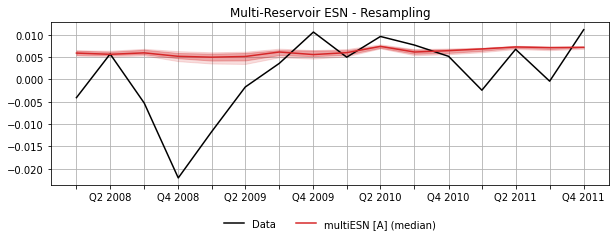

In [219]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_A__forecasts_qts[2,:], c="C3", label="multiESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A__forecasts_qts[1,:], esnMulti_A__forecasts_qts[3,:],
        color="C3", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A__forecasts_qts[0,:], esnMulti_A__forecasts_qts[4,:],
        color="C3", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_a_resample_2007.pdf'), bbox_inches="tight")
plt.show()

In [47]:
(esnMulti_B__fits_qts, 
    esnMulti_B__forecasts_qts,
    esnMulti_B__fits_se_qts,
    esnMulti_B__forecasts_se_qts,
    _, _,
    esnMulti_B__Gamma0_eigs,
    esnMulti_B__lambdas,
    pars_esnMulti_B
) = MultiESN__resampleFitForecast(
    n_models=100, 
    N_esn=(100, 20), 
    pars=((0.08, 0.25, 0.3), (0.01, 0.01, 0.99)),
    data=dataset2007_short,
    Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [13:49<00:00,  8.29s/it]


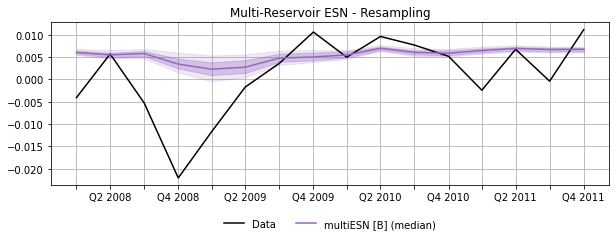

In [48]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_B__forecasts_qts[2,:], c="C4", label="multiESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B__forecasts_qts[1,:], esnMulti_B__forecasts_qts[3,:],
        color="C4", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B__forecasts_qts[0,:], esnMulti_B__forecasts_qts[4,:],
        color="C4", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_b_resample_2007.pdf'), bbox_inches="tight")
plt.show()

In [59]:
# DEF: MultiESN_ew__resampleFitForecast()
def MultiESN_ew__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N_m, N_d = N_esn
    k_m = int(m_data.shape[1])
    k_d = int(d_data.shape[1])

    rho_m, gamma_m, leak_rate_m = pars[0]
    rho_d, gamma_d, leak_rate_d = pars[1]

    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    forecasts = []
    for n in tqdm(range(n_models)):
        esn_M = ESN(
            N=N_m,
            A=stateMatrixGenerator(
                (N_m, N_m), 
                dist='sparse_normal', sparsity=10/N_m, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N_m, m_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_m, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho_m,
            gamma=gamma_m,
            leak_rate=leak_rate_m,
            activation=np.tanh,
        )

        esn_D = ESN(
            N=N_d,
            A=stateMatrixGenerator(
                (N_d, N_d), 
                dist='sparse_normal', sparsity=10/N_d, normalize='eig',
                seed=20220623
            ),
            C=stateMatrixGenerator(
                (N_d, d_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_d, normalize='norm2',
                seed=20220623
            ),
            rho=rho_d,
            gamma=gamma_d,
            leak_rate=leak_rate_d,
            activation=np.tanh,
        )

        esnMulti = ESNMultiFrequency((esn_M, esn_D), ar=False)

        if doOptim:
            #_, esnMulti__psi_optim = esnMulti.optim(
            #    Y=GDP_data_train, z=(m_data_train, d_data_train),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnMulti__current = esnMulti__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnMulti__current = esnMulti

        if doCV:  Lambdas = []

        forecast_ew = np.zeros((len(GDP_data_test), 1))
        for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
            if j > 0:
                GDP_data_train_j = pd.concat([
                    GDP_data_train,
                    GDP_data_test.iloc[0:j,]
                ])
                m_data_train_j = pd.concat([
                    m_data_train,
                    m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                d_data_train_j = pd.concat([
                    d_data_train,
                    d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                GDP_data_test_j = GDP_data_test.iloc[[j],]
                m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
                d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
            else:
                GDP_data_train_j = GDP_data_train
                m_data_train_j = m_data_train
                d_data_train_j = d_data_train
                GDP_data_test_j = GDP_data_test.iloc[[0],]
                m_data_test_j = m_data_test.iloc[[0],]
                d_data_test_j = d_data_test.iloc[[0],]

            # Normalize
            GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                    return_mu_sig=True)
            )
            m_data_train_j, m_data_test_j = (
                normalize_train_test(m_data_train_j, m_data_test_j)
            )
            d_data_train_j, d_data_test_j = (
                normalize_train_test(d_data_train_j, d_data_test_j)
            )

            if doCV:
                Lambda_j = esnMulti__current.ridge_lambda_cv(
                    Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                    method="ridge-isotropic",
                    cv_options="-cv:5-test_size:5",
                    steps=1,
                    debug=False,
                )
                Lambda_j = [Lambda_j[0], Lambda_j[0]]
                Lambdas.append(Lambda_j)
            else:
                Lambda_j = Lambda

            esnMulti_fit = esnMulti__current.fit(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method='ridge',
                Lambda=Lambda_j,
                full=False,
                debug=False,
            )

            esnMulti_for = esnMulti__current.fixedParamsForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
                fit=esnMulti_fit
            )

            forecast_ew[j] = np.squeeze(esnMulti_for['Forecast'][0]['Y_for']) * sig_j + mu_j

        forecasts.append(forecast_ew)

        #if doCV:
        #    plt.figure(figsize=(8,2))
        #    for l in range(len(Lambda_j)):
        #        plt.plot(GDP_test_dates, np.log10(np.array([lam[l] for lam in Lambdas])))
        #    plt.ylabel("$\log_{10}(\lambda_t)$")
        #    plt.grid()
        #    plt.show()

    forecasts_np = np.full((n_models, len(forecasts[0])), np.nan)
    for n in range(n_models):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    pars = {}

    return (forecasts_qts, forecasts_np, pars)

In [60]:
(esnMulti_A_ew__forecasts_qts, 
    _,
    pars_esnMulti_A
) = MultiESN_ew__resampleFitForecast(
    n_models=100, 
    N_esn=(100, 20), 
    pars=((0.5, 1.5, 0.), (0.5, 0.5, 0.1)),
    data=dataset2007_short,
    #Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [1:41:14<00:00, 60.75s/it]


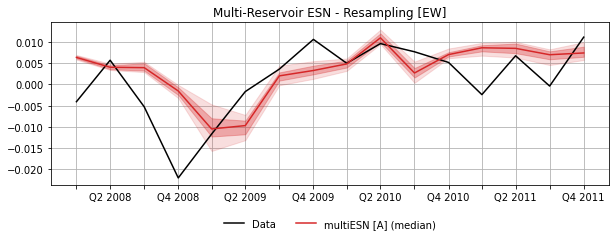

In [61]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_A_ew__forecasts_qts[2,:], c="C3", label="multiESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A_ew__forecasts_qts[1,:], esnMulti_A_ew__forecasts_qts[3,:],
        color="C3", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A_ew__forecasts_qts[0,:], esnMulti_A_ew__forecasts_qts[4,:],
        color="C3", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_a_resample_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [62]:
(esnMulti_B_ew__forecasts_qts, 
    _,
    pars_esnMulti_B
) = MultiESN_ew__resampleFitForecast(
    n_models=100, 
    N_esn=(100, 20), 
    pars=((0.08, 0.25, 0.3), (0.01, 0.01, 0.99)),
    data=dataset2007_short,
    #Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [1:41:39<00:00, 61.00s/it]


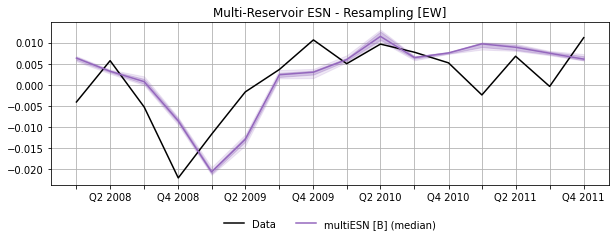

In [63]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_B_ew__forecasts_qts[2,:], c="C4", label="multiESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B_ew__forecasts_qts[1,:], esnMulti_B_ew__forecasts_qts[3,:],
        color="C4", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B_ew__forecasts_qts[0,:], esnMulti_B_ew__forecasts_qts[4,:],
        color="C4", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_b_resample_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [1]:
# DEF: MultiESN_rw__resampleFitForecast()
def MultiESN_rw__resampleFitForecast(n_models, N_esn, pars, data, Lambda=None,
                                        doOptim=False, doCV=False, rng_seed=None):
    assert not rng_seed is None, "Set a random number seed"
    N_m, N_d = N_esn
    k_m = int(m_data.shape[1])
    k_d = int(d_data.shape[1])

    rho_m, gamma_m, leak_rate_m = pars[0]
    rho_d, gamma_d, leak_rate_d = pars[1]

    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    forecasts = []
    for n in tqdm(range(n_models)):
        esn_M = ESN(
            N=N_m,
            A=stateMatrixGenerator(
                (N_m, N_m), 
                dist='sparse_normal', sparsity=10/N_m, normalize='eig',
                seed=rng_seed + 111*n
            ),
            C=stateMatrixGenerator(
                (N_m, m_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_m, normalize='norm2',
                seed=rng_seed + 111*n
            ),
            rho=rho_m,
            gamma=gamma_m,
            leak_rate=leak_rate_m,
            activation=np.tanh,
        )

        esn_D = ESN(
            N=N_d,
            A=stateMatrixGenerator(
                (N_d, N_d), 
                dist='sparse_normal', sparsity=10/N_d, normalize='eig',
                seed=20220623
            ),
            C=stateMatrixGenerator(
                (N_d, d_data.shape[1]), 
                dist='sparse_uniform', sparsity=10/N_d, normalize='norm2',
                seed=20220623
            ),
            rho=rho_d,
            gamma=gamma_d,
            leak_rate=leak_rate_d,
            activation=np.tanh,
        )

        esnMulti = ESNMultiFrequency((esn_M, esn_D), ar=False)

        if doOptim:
            #_, esnMulti__psi_optim = esnMulti.optim(
            #    Y=GDP_data_train, z=(m_data_train, d_data_train),  
            #    mode="E_psi",
            #    method="ridge-cv:40-test_size:1",
            #    Lambda=Lambda,
            #    debug=False,
            #)
            #esnMulti__current = esnMulti__psi_optim
            if n == 0: print("! doOptim option not available currently")
        else:
            esnMulti__current = esnMulti

        forecast_rw = np.zeros((len(GDP_data_test), 1))
        for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
            if j > 0:
                GDP_data_train_j = pd.concat([
                    GDP_data_train,
                    GDP_data_test.iloc[0:j,]
                ]).iloc[j:,]
                m_data_train_j = pd.concat([
                    m_data_train,
                    m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                d_data_train_j = pd.concat([
                    d_data_train,
                    d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                m_data_train_j = m_data_train_j[GDP_dates[j-1]:]
                d_data_train_j = d_data_train_j[GDP_dates[j-1]:]
                GDP_data_test_j = GDP_data_test.iloc[[j],]
                m_data_test_j = m_data_test.loc[[m_data_train_j.index[-1]],]
                d_data_test_j = d_data_test.loc[[d_data_train_j.index[-1]],]
            else:
                GDP_data_train_j = GDP_data_train
                m_data_train_j = m_data_train
                d_data_train_j = d_data_train
                GDP_data_test_j = GDP_data_test.iloc[[0],]
                m_data_test_j = m_data_test.iloc[[0],]
                d_data_test_j = d_data_test.iloc[[0],]

            # Normalize
            GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                    return_mu_sig=True)
            )
            m_data_train_j, m_data_test_j = (
                normalize_train_test(m_data_train_j, m_data_test_j)
            )
            d_data_train_j, d_data_test_j = (
                normalize_train_test(d_data_train_j, d_data_test_j)
            )

            if doCV:
                Lambda_j = esnMulti__current.ridge_lambda_cv(
                    Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                    method="ridge-isotropic",
                    cv_options="-cv:5-test_size:5",
                    steps=1,
                    debug=False,
                )
                Lambda_j = [Lambda_j[0], Lambda_j[0]]
            else:
                Lambda_j = Lambda

            esnMulti_fit = esnMulti__current.fit(
                Y=GDP_data_train_j, z=(m_data_train_j, d_data_train_j), 
                method='ridge',
                Lambda=Lambda_j,
                full=False,
                debug=False,
            )

            esnMulti_for = esnMulti__current.fixedParamsForecast(
                Yf=GDP_data_test_j, zf=(m_data_test_j, d_data_test_j), 
                fit=esnMulti_fit
            )

            forecast_rw[j] = np.squeeze(esnMulti_for['Forecast'][0]['Y_for']) * sig_j + mu_j

        forecasts.append(forecast_rw)

    forecasts_np = np.full((n_models, len(forecasts[0])), np.nan)
    for n in range(n_models):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    pars = {}

    return (forecasts_qts, forecasts_np, pars)

In [48]:
(esnMulti_A_rw__forecasts_qts, 
    _,
    pars_esnMulti_A
) = MultiESN_rw__resampleFitForecast(
    n_models=100, 
    N_esn=(100, 20), 
    pars=((0.5, 1.5, 0.), (0.5, 0.5, 0.1)),
    data=dataset2007_short,
    #Lambda=[esnMulti_A_cv10_lambda_2007[0], esnMulti_A_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [1:32:10<00:00, 55.30s/it]


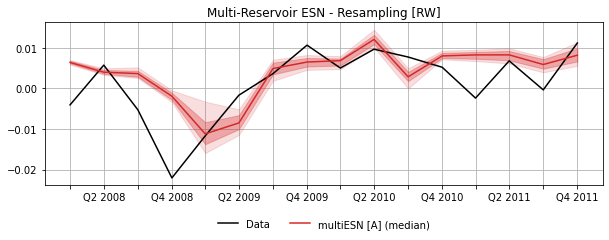

In [49]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_A_rw__forecasts_qts[2,:], c="C3", label="multiESN [A] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A_rw__forecasts_qts[1,:], esnMulti_A_rw__forecasts_qts[3,:],
        color="C3", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_A_rw__forecasts_qts[0,:], esnMulti_A_rw__forecasts_qts[4,:],
        color="C3", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_a_resample_rw_2007.pdf'), bbox_inches="tight")
plt.show()

In [50]:
(esnMulti_B_rw__forecasts_qts, 
    _,
    pars_esnMulti_B
) = MultiESN_rw__resampleFitForecast(
    n_models=100, 
    N_esn=(100, 20), 
    pars=((0.08, 0.25, 0.3), (0.01, 0.01, 0.99)),
    data=dataset2007_short,
    #Lambda=[esnMulti_B_cv10_lambda_2007[0], esnMulti_B_cv10_lambda_2007[0]],
    doOptim=False,
    doCV=True,
    rng_seed=20220623
)

100%|██████████| 100/100 [1:33:25<00:00, 56.06s/it]


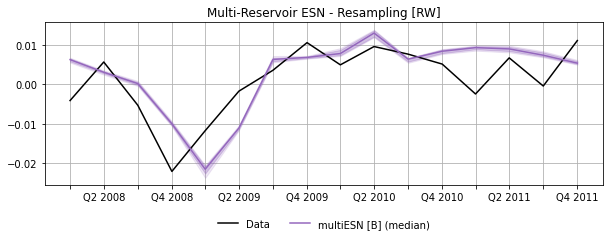

In [51]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
#
#plt.plot(esnMulti_B_fix_for_1sa_2007, c="C1", ls=':', label="multiESN [B]")
#
#plt.plot(esnMulti_A_fix_for_1sa_2007, c="C8", label="multiESN [A]",) 
#
plt.plot(dataset2007_short['GDP_data_test'].index, 
        esnMulti_B_rw__forecasts_qts[2,:], c="C4", label="multiESN [B] (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B_rw__forecasts_qts[1,:], esnMulti_B_rw__forecasts_qts[3,:],
        color="C4", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        esnMulti_B_rw__forecasts_qts[0,:], esnMulti_B_rw__forecasts_qts[4,:],
        color="C4", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("Multi-Reservoir ESN - Resampling [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_multiesn_b_resample_rw_2007.pdf'), bbox_inches="tight")
plt.show()

#### MIDAS

In [75]:
from scipy.stats import qmc
from sklearn.manifold import TSNE
from matplotlib import colors

In [177]:
# DEF: MIDAS__resampleLossFeatures()
def MIDAS__resampleLossFeatures(log_sobol=1, restart=1):
    # Sobol sample points
    N_initial_optim_points_base2 = 2 ** log_sobol
    dim_theta0 = 1+np.sum(Y_lags)+(len(X_lags)*3)

    print(f"Sobol sampler: 2^{log_sobol} = {N_initial_optim_points_base2} initial points")

    sobol_sampler = qmc.Sobol(d=dim_theta0, scramble=False, seed=20220618)
    sobol_sampler.reset()

    restart = 1 if (restart < 2 or restart is None) else restart

    # Build MIDAS design matrices
    MIDAS_RSSMats = MIDAS_model.fitAlmon_getRSS_mats(
        Y=dataset2007['GDP_data_midas'], 
        X=dataset2007['md_data_midas'], 
        fit_length=len(dataset2007['GDP_data_train']),
        steps=1,
    )

    sobol_theta0_rs = []
    fits_theta_rs = []
    fits_lossval_rs = []
    fits_lossgradnorm_rs = []
    for _ in tqdm(range(restart)):        
        #sobol_theta0 = sobol_sampler.random_base2(m=N_initial_optim_points_base2)
        sobol_theta0 = sobol_sampler.random(N_initial_optim_points_base2)
        sobol_theta0 = tuple(map(lambda x : (x - 0.5*np.ones(dim_theta0)) * 0.05, sobol_theta0))

        fits_theta_i = []
        fits_lossval_i = []
        fits_lossgradnorm_i = []
        L = len(sobol_theta0)
        for n in range(L):
            MIDAS_fixParsForecast = MIDAS_model.fixedparamsForecast(
                data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']),
                fit_length=len(dataset2007['GDP_data_train']),
                steps=1,
                normalize=False,
                grad=True, 
                method='L-BFGS-B',
                theta0 = sobol_theta0[n],
            )

            MIDAS_thetaOpt = MIDAS_fixParsForecast['parsfit_for'][0]['theta_opt']

            if np.all(~np.isnan(MIDAS_thetaOpt)):
                MIDAS_lossValue = MIDAS_model.fitAlmon_RSS_obj(MIDAS_RSSMats, MIDAS_thetaOpt, i=0)
                MIDAS_lossGradNorm = np.linalg.norm(
                    MIDAS_model.fitAlmon_RSS_grad(MIDAS_RSSMats, MIDAS_thetaOpt, i=0)
                )

                fits_theta_i.append(MIDAS_thetaOpt)
                fits_lossval_i.append(MIDAS_lossValue)
                fits_lossgradnorm_i.append(MIDAS_lossGradNorm)

        if restart < 2:
            sobol_theta0_rs = sobol_theta0
            fits_theta_rs = fits_theta_i
            fits_lossval_rs = fits_lossval_i
            fits_lossgradnorm_rs = fits_lossgradnorm_i
        else:
            idx_min = np.argmin(np.array(fits_lossval_i))

            sobol_theta0_rs.append(sobol_theta0[idx_min])
            fits_theta_rs.append(fits_theta_i[idx_min])
            fits_lossval_rs.append(fits_lossval_i[idx_min])
            fits_lossgradnorm_rs.append(fits_lossgradnorm_i[idx_min])


    return (fits_theta_rs, fits_lossval_rs, fits_lossgradnorm_rs, sobol_theta0_rs)

In [178]:
(MIDAS__fits_theta_opt, 
    MIDAS__fits_lossval_opt,
    MIDAS__fits_lossgradnorm_opt,
    MIDAS__sobol_theta0,
) = MIDAS__resampleLossFeatures(log_sobol=6, restart=100)

Sobol sampler: 2^6 = 64 initial points


  0%|          | 0/100 [00:00<?, ?it/s]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
  1%|          | 1/100 [00:08<14:45,  8.94s/it]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\U

In [179]:
# TSNE
fits_theta_embedded = TSNE(
    n_components=2, 
    learning_rate='auto', 
    init='pca'
).fit_transform(np.vstack((
    np.array(MIDAS__sobol_theta0),
    np.array(MIDAS__fits_theta_opt)
)))


c:\Users\Ballarin\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


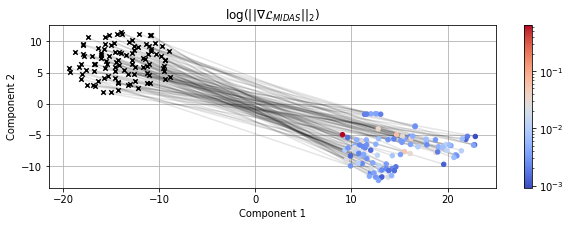

In [196]:
# Plot
fig = plt.figure(figsize=(10, 3))
#ax = fig.add_subplot(projection='3d')
#ax.scatter(
#    fits_theta_embedded[:,0], 
#    fits_theta_embedded[:,1], 
#    fits_theta_embedded[:,2], 
#    c=(MIDAS__fits_lossgradnorm_opt),
#    cmap='jet', norm=colors.LogNorm()
#)
# Lines
for i in range(len(MIDAS__sobol_theta0)):
    plt.plot(
        fits_theta_embedded[[i,i+len(MIDAS__sobol_theta0)],0],
        fits_theta_embedded[[i,i+len(MIDAS__sobol_theta0)],1],
        c='black',
        alpha=0.1,
    )
# Sobol starting points
plt.scatter(
    fits_theta_embedded[:len(MIDAS__sobol_theta0),0], 
    fits_theta_embedded[:len(MIDAS__sobol_theta0),1], 
    marker='x',
    c='black',
    zorder=2.5,
    s=20
)
# Optimization results
plt.scatter(
    fits_theta_embedded[len(MIDAS__sobol_theta0):,0], 
    fits_theta_embedded[len(MIDAS__sobol_theta0):,1], 
    c=(MIDAS__fits_lossgradnorm_opt),
    cmap='coolwarm', norm=colors.LogNorm(),
    zorder=2.5,
    s=20,
)
plt.colorbar()
plt.title(r"$\log(||\nabla\mathcal{L}_{MIDAS}||_2)$")
plt.xlabel("Component 1")
plt.ylabel("Component 2")
plt.grid()
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_midas_thetas_gradnorm_2007.png'), 
                    dpi=200, bbox_inches="tight")
plt.show()

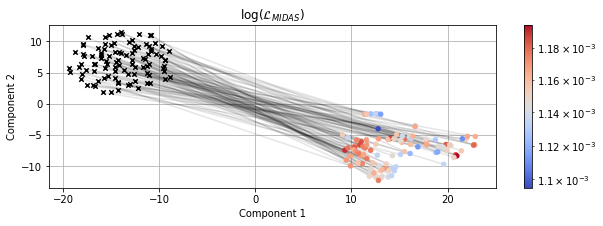

In [193]:
# Plot
fig = plt.figure(figsize=(10, 3))
#ax = fig.add_subplot(projection='3d')
#ax.scatter(
#    fits_theta_embedded[:,0], 
#    fits_theta_embedded[:,1], 
#    fits_theta_embedded[:,2], 
#    c=(MIDAS__fits_lossgradnorm_opt),
#    cmap='jet', norm=colors.LogNorm()
#)
# Lines
for i in range(len(MIDAS__sobol_theta0)):
    plt.plot(
        fits_theta_embedded[[i,i+len(MIDAS__sobol_theta0)],0],
        fits_theta_embedded[[i,i+len(MIDAS__sobol_theta0)],1],
        c='black',
        alpha=0.1,
    )
# Sobol starting points
plt.scatter(
    fits_theta_embedded[:len(MIDAS__sobol_theta0),0], 
    fits_theta_embedded[:len(MIDAS__sobol_theta0),1], 
    marker='x',
    c='black',
    zorder=2.5,
    s=20
)
# Optimization results
plt.scatter(
    fits_theta_embedded[len(MIDAS__sobol_theta0):,0], 
    fits_theta_embedded[len(MIDAS__sobol_theta0):,1], 
    c=(MIDAS__fits_lossval_opt),
    cmap='coolwarm', norm=colors.LogNorm(),
    zorder=2.5,
    s=20,
)
plt.colorbar()
plt.title(r'$\log(\mathcal{L}_{MIDAS})$')
plt.xlabel("Component 1")
plt.ylabel("Component 2")
plt.grid()
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_midas_thetas_lossval_2007.png'), 
                    dpi=200, bbox_inches="tight")
plt.show()

In [197]:
from plot_loss_surf import plot_loss_surf

MIDAS_RSSMats = MIDAS_model.fitAlmon_getRSS_mats(
        Y=dataset2007['GDP_data_midas'], 
        X=dataset2007['md_data_midas'], 
        fit_length=len(dataset2007['GDP_data_train']),
        steps=1,
    )
def MIDAS_model__loss(z):
  return MIDAS_model.fitAlmon_RSS_obj(MIDAS_RSSMats, z, i=0)

def MIDAS_model__grad(z):
  return MIDAS_model.fitAlmon_RSS_grad(MIDAS_RSSMats, z, i=0)

Evaluating loss...: 100%|██████████| 70/70 [00:07<00:00,  9.30it/s]


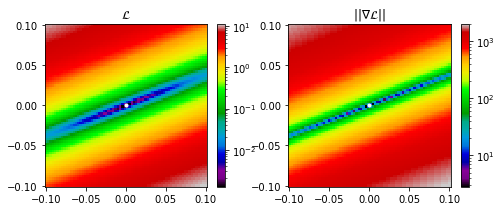

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 10.22it/s]


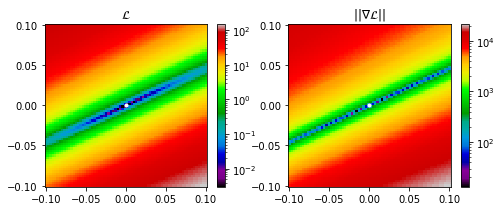

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 10.88it/s]


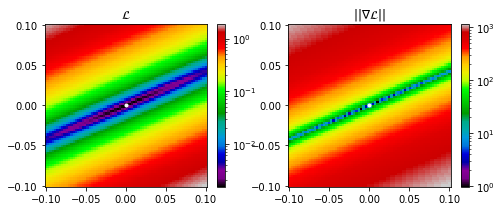

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 11.16it/s]


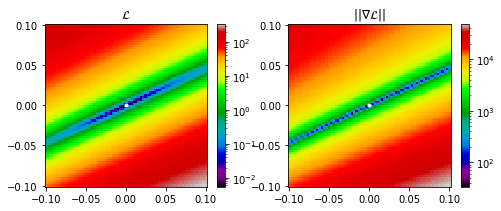

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 10.93it/s]


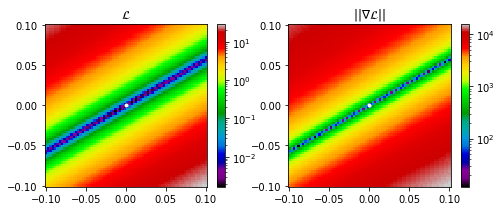

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 10.93it/s]


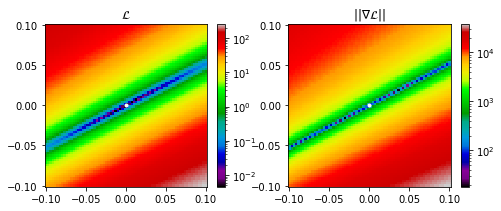

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 10.84it/s]


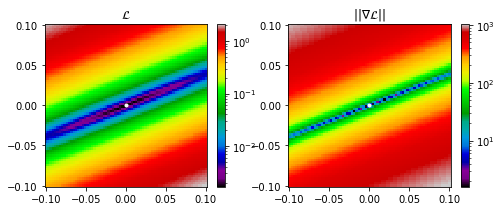

Evaluating loss...: 100%|██████████| 70/70 [00:06<00:00, 11.11it/s]


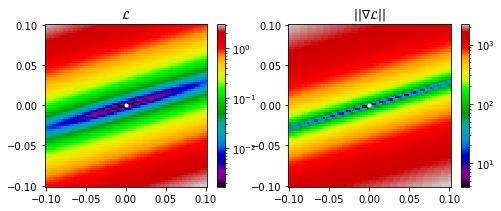

In [116]:
for i in range(8):
    plot_loss_surf(
      loss_fn = MIDAS_model__loss, 
      grad_fn = MIDAS_model__grad,
      param = MIDAS__fits_theta_opt[i],
      M = 70,
      scale = 0.1,
      seed=20220618,
      figsize=(8,3)
    )

In [198]:
# DEF: MIDAS__resampleFitForecast()
def MIDAS__resampleFitForecast(log_sobol=1, restart=1):
    # Sobol sample points
    N_initial_optim_points_base2 = 2 ** log_sobol
    dim_theta0 = 1+np.sum(Y_lags)+(len(X_lags)*3)

    print(f"Sobol sampler: 2^{log_sobol} = {N_initial_optim_points_base2} initial points")

    sobol_sampler = qmc.Sobol(d=dim_theta0, scramble=False, seed=20220618)
    sobol_sampler.reset()

    restart = 1 if (restart < 2 or restart is None) else restart

    # Build MIDAS design matrices
    MIDAS_RSSMats = MIDAS_model.fitAlmon_getRSS_mats(
        Y=dataset2007['GDP_data_midas'], 
        X=dataset2007['md_data_midas'], 
        fit_length=len(dataset2007['GDP_data_train']),
        steps=1,
    )

    fits_lossval = []
    fits = []
    fits_res = []
    forecasts = []
    for _ in tqdm(range(restart)):
        #sobol_theta0 = sobol_sampler.random_base2(m=N_initial_optim_points_base2)
        sobol_theta0 = sobol_sampler.random(N_initial_optim_points_base2)
        sobol_theta0 = tuple(map(lambda x : (x - 0.5*np.ones(dim_theta0)) * 0.05, sobol_theta0))

        fits_lossval_i = []
        fits_i = []
        fits_res_i = []
        forecasts_i = []
        L = len(sobol_theta0)
        for n in range(L):
            MIDAS_fixParsForecast = MIDAS_model.fixedparamsForecast(
                data=(dataset2007['GDP_data_midas'], dataset2007['md_data_midas']),
                fit_length=len(dataset2007['GDP_data_train']),
                steps=1,
                normalize=False,
                grad=True, 
                method='L-BFGS-B',
                theta0 = sobol_theta0[n],
            )

            MIDAS__for_fit_out = MIDAS_model.forecast_reshape(MIDAS_fixParsForecast)
            MIDAS_thetaOpt = MIDAS_fixParsForecast['parsfit_for'][0]['theta_opt']       

            if np.all(~np.isnan(MIDAS_fixParsForecast['parsfit_for'][0]['Yt_fit'])):
                MIDAS_lossValue = MIDAS_model.fitAlmon_RSS_obj(MIDAS_RSSMats, MIDAS_thetaOpt, i=0)

                fits_lossval_i.append(MIDAS_lossValue)
                fits_i.append(MIDAS_fixParsForecast['parsfit_for'][0]['Yt_fit'])
                fits_res_i.append(MIDAS_fixParsForecast['parsfit_for'][0]['Residuals'])
                forecasts_i.append(MIDAS__for_fit_out['Yt_forecast'])

        if restart < 2:
            fits_lossval = fits_lossval_i
            fits = fits_i
            fits_res = fits_res_i
            forecasts = forecasts_i
        else:
            idx_min = np.argmin(np.array(fits_lossval_i))

            fits_lossval.append(fits_lossval_i[idx_min])
            fits.append(fits_i[idx_min])
            fits_res.append(fits_res_i[idx_min])
            forecasts.append(forecasts_i[idx_min])

    B = len(fits)

    fits_np = np.full((B, len(fits[0])), np.nan)
    fits_se_np = np.full((B, len(fits[0])), np.nan)
    forecasts_np = np.full((B, len(forecasts[0])), np.nan)
    forecasts_se_np = np.full((B, len(forecasts[0])), np.nan)
    for b in range(B):
        fits_np[b,:] = np.squeeze(fits[b])
        fits_se_np[b,:] = np.squeeze(fits_res[b]**2)
        forecasts_np[b,:] = np.squeeze(forecasts[b])
        forecasts_se_np[b,:] = np.squeeze((forecasts[b] - dataset2007['GDP_data_test'].to_numpy())**2)

    fits_se_np = np.cumsum(fits_se_np, axis=1)
    forecasts_se_np = np.cumsum(forecasts_se_np, axis=1)

    fits_qts = np.quantile(fits_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    fits_se_qts = np.quantile(fits_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)
    forecasts_se_qts = np.quantile(forecasts_se_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    return (fits_qts, forecasts_qts, fits_se_qts, forecasts_se_qts,
            fits_np, forecasts_np)

In [199]:
(MIDAS__fits_qts, 
    MIDAS__forecasts_qts,
    MIDAS__fits_se_qts,
    MIDAS__forecasts_se_qts,
    MIDAS__fits, _,
) = MIDAS__resampleFitForecast(
    log_sobol=6, 
    restart=100
)

Sobol sampler: 2^6 = 64 initial points


  0%|          | 0/100 [00:00<?, ?it/s]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
  1%|          | 1/100 [00:07<12:25,  7.53s/it]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\U

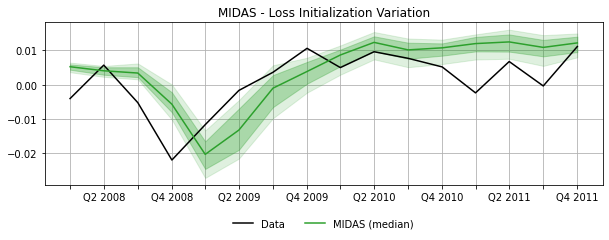

In [200]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
plt.plot(dataset2007_short['GDP_data_test'].index, 
        MIDAS__forecasts_qts[2,0:16], c="C2", label="MIDAS (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS__forecasts_qts[1,0:16], MIDAS__forecasts_qts[3,0:16],
        color="C2", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS__forecasts_qts[0,0:16], MIDAS__forecasts_qts[4,0:16],
        color="C2", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("MIDAS - Loss Initialization Variation")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_midas_resample_2007.pdf'), bbox_inches="tight")
plt.show()

In [52]:
# DEF: MIDAS_ew__resampleFitForecast()
def MIDAS_ew__resampleFitForecast(midasModel, data, log_sobol=1, restart=1):
    # Sobol sample points
    N_initial_optim_points_base2 = 2 ** log_sobol
    dim_theta0 = 1+np.sum(Y_lags)+(len(X_lags)*3)

    print(f"Sobol sampler: 2^{log_sobol} = {N_initial_optim_points_base2} initial points")

    sobol_sampler = qmc.Sobol(d=dim_theta0, scramble=False, seed=20220618)
    sobol_sampler.reset()

    restart = 1 if (restart < 2 or restart is None) else restart

    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index

    forecasts = []
    for _ in tqdm(range(restart)):
        #sobol_theta0 = sobol_sampler.random_base2(m=N_initial_optim_points_base2)
        sobol_theta0 = sobol_sampler.random(N_initial_optim_points_base2)
        sobol_theta0 = tuple(map(lambda x : (x - 0.5*np.ones(dim_theta0)) * 0.05, sobol_theta0))

        forecast_ew = np.zeros((len(GDP_data_test), 1))
        for j in tqdm(range(len(GDP_data_test)), desc=" EW", position=1, leave=False):
            if j > 0:
                GDP_data_train_j = pd.concat([
                    GDP_data_train,
                    GDP_data_test.iloc[0:j,]
                ])
                m_data_train_j = pd.concat([
                    m_data_train,
                    m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                d_data_train_j = pd.concat([
                    d_data_train,
                    d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ])
                GDP_data_test_j = GDP_data_test.iloc[[j],]
                m_data_test_j = m_data_test.loc[
                    (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
                ]
                d_data_test_j = d_data_test.loc[
                    (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
                ]
            else:
                GDP_data_train_j = GDP_data_train
                m_data_train_j = m_data_train
                d_data_train_j = d_data_train
                GDP_data_test_j = GDP_data_test.iloc[[0],]
                m_data_test_j = m_data_test.loc[:GDP_test_dates[0],].iloc[1:,]
                d_data_test_j = d_data_test.loc[:GDP_test_dates[0],].iloc[1:,]

            # Normalize
            GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                    return_mu_sig=True)
            )
            m_data_train_j, m_data_test_j = (
                normalize_train_test(m_data_train_j, m_data_test_j)
            )
            d_data_train_j, d_data_test_j = (
                normalize_train_test(d_data_train_j, d_data_test_j)
            )

            # MIDAS data format
            GDP_data_midas_j = np.vstack((
                GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
            ))
            md_data_midas_j = (
                tuple(
                    np.vstack((
                        m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                    )) for s in m_data_train.columns
                ) +
                (np.vstack((
                    d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
                )), )
            )

            # Build MIDAS design matrices
            MIDAS_RSSMats = midasModel.fitAlmon_getRSS_mats(
                Y=GDP_data_midas_j, 
                X=md_data_midas_j, 
                fit_length=len(GDP_data_train_j),
                steps=1,
            )

            fits_lossval_j = []
            forecasts_j = []
            for n in range(len(sobol_theta0)):
                MIDAS_fit = midasModel.fixedparamsForecast(
                    data=(GDP_data_midas_j, md_data_midas_j),
                    fit_length=len(GDP_data_train_j),
                    steps=1,
                    normalize=False,
                    grad=True, 
                    method='L-BFGS-B',
                    theta0 = sobol_theta0[n],
                )

                #MIDAS__for_fit_out = midasModel.forecast_reshape(MIDAS_fit)
                MIDAS_thetaOpt = MIDAS_fit['parsfit_for'][0]['theta_opt']       

                if np.all(~np.isnan(MIDAS_fit['parsfit_for'][0]['Yt_fit'])):
                    MIDAS_lossValue = midasModel.fitAlmon_RSS_obj(MIDAS_RSSMats, MIDAS_thetaOpt, i=0)
                    fits_lossval_j.append(MIDAS_lossValue)
                    forecasts_j.append(np.squeeze(MIDAS_fit['forecasts'][0]['Forecast']) * sig_j + mu_j)

            # Best fit
            idx_min = np.argmin(np.array(fits_lossval_j))
            forecast_ew[j] = forecasts_j[idx_min]

        forecasts.append(forecast_ew)

    forecasts_np = np.full((restart, len(forecasts[0])), np.nan)
    for n in range(restart):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    return (forecasts_qts, forecasts_np)

In [57]:
(MIDAS_ew__forecasts_qts,
    _,
) = MIDAS_ew__resampleFitForecast(
    MIDAS_model, 
    data=dataset2007_short,
    log_sobol=6, 
    restart=100
)

Sobol sampler: 2^6 = 64 initial points


  0%|          | 0/100 [00:00<?, ?it/s]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Comput

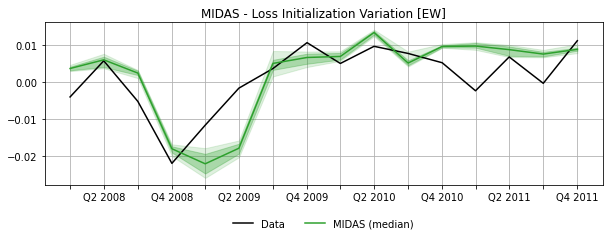

In [58]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
plt.plot(dataset2007_short['GDP_data_test'].index, 
        MIDAS_ew__forecasts_qts[2,:], c="C2", label="MIDAS (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS_ew__forecasts_qts[1,:], MIDAS_ew__forecasts_qts[3,:],
        color="C2", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS_ew__forecasts_qts[0,:], MIDAS_ew__forecasts_qts[4,:],
        color="C2", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("MIDAS - Loss Initialization Variation [EW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_midas_resample_ew_2007.pdf'), bbox_inches="tight")
plt.show()

In [77]:
# DEF: MIDAS_rw__resampleFitForecast()
def MIDAS_rw__resampleFitForecast(midasModel, data, log_sobol=1, restart=1):
    # Sobol sample points
    N_initial_optim_points_base2 = 2 ** log_sobol
    dim_theta0 = 1+np.sum(Y_lags)+(len(X_lags)*3)

    print(f"Sobol sampler: 2^{log_sobol} = {N_initial_optim_points_base2} initial points")

    sobol_sampler = qmc.Sobol(d=dim_theta0, scramble=False, seed=20220618)
    sobol_sampler.reset()

    restart = 1 if (restart < 2 or restart is None) else restart

    GDP_data_train = data['GDP_data_train']
    GDP_data_test = data['GDP_data_test']
    m_data_train = data['m_data_train']
    m_data_test = data['m_data_test']
    d_data_train = data['d_data_train']
    d_data_test = data['d_data_test']

    GDP_test_dates = GDP_data_test.index
    GDP_dates = GDP_data_train.index.append(GDP_data_test.index)

    forecasts = []
    for _ in tqdm(range(restart)):
        #sobol_theta0 = sobol_sampler.random_base2(m=N_initial_optim_points_base2)
        sobol_theta0 = sobol_sampler.random(N_initial_optim_points_base2)
        sobol_theta0 = tuple(map(lambda x : (x - 0.5*np.ones(dim_theta0)) * 0.05, sobol_theta0))

        forecast_rw = np.zeros((len(GDP_data_test), 1))
        for j in tqdm(range(len(GDP_data_test)), desc=" RW", position=1, leave=False):
            if j > 0:
                GDP_data_train_j = pd.concat([
                    GDP_data_train,
                    GDP_data_test.iloc[0:j,]
                ]).iloc[j:,]
                m_data_train_j = pd.concat([
                    m_data_train,
                    m_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
                d_data_train_j = pd.concat([
                    d_data_train,
                    d_data_test[:GDP_test_dates[j-1]].iloc[1:,]
                ]).loc[(GDP_dates[j-1]+ pd.offsets.Day()):,]
                GDP_data_test_j = GDP_data_test.iloc[[j],]
                m_data_test_j = m_data_test.loc[
                    (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
                ]
                d_data_test_j = d_data_test.loc[
                    (GDP_test_dates[j-1]+ pd.offsets.Day()):GDP_test_dates[j],
                ]
            else:
                GDP_data_train_j = GDP_data_train
                m_data_train_j = m_data_train
                d_data_train_j = d_data_train
                GDP_data_test_j = GDP_data_test.iloc[[0],]
                m_data_test_j = m_data_test.loc[:GDP_test_dates[0],].iloc[1:,]
                d_data_test_j = d_data_test.loc[:GDP_test_dates[0],].iloc[1:,]

            # Normalize
            GDP_data_train_j, GDP_data_test_j, mu_j, sig_j = (
                normalize_train_test(GDP_data_train_j, GDP_data_test_j,
                    return_mu_sig=True)
            )
            m_data_train_j, m_data_test_j = (
                normalize_train_test(m_data_train_j, m_data_test_j)
            )
            d_data_train_j, d_data_test_j = (
                normalize_train_test(d_data_train_j, d_data_test_j)
            )

            # MIDAS data format
            GDP_data_midas_j = np.vstack((
                GDP_data_train_j.to_numpy(), GDP_data_test_j.to_numpy()
            ))
            md_data_midas_j = (
                tuple(
                    np.vstack((
                        m_data_train_j[s].to_numpy()[:,None], m_data_test_j[s].to_numpy()[:,None]
                    )) for s in m_data_train.columns
                ) +
                (np.vstack((
                    d_data_train_j.to_numpy(), d_data_test_j.to_numpy()
                )), )
            )

            # Build MIDAS design matrices
            MIDAS_RSSMats = midasModel.fitAlmon_getRSS_mats(
                Y=GDP_data_midas_j, 
                X=md_data_midas_j, 
                fit_length=len(GDP_data_train_j),
                steps=1,
            )

            fits_lossval_j = []
            forecasts_j = []
            for n in range(len(sobol_theta0)):
                MIDAS_fit = midasModel.fixedparamsForecast(
                    data=(GDP_data_midas_j, md_data_midas_j),
                    fit_length=len(GDP_data_train_j),
                    steps=1,
                    normalize=False,
                    grad=True, 
                    method='L-BFGS-B',
                    theta0 = sobol_theta0[n],
                )

                #MIDAS__for_fit_out = midasModel.forecast_reshape(MIDAS_fit)
                MIDAS_thetaOpt = MIDAS_fit['parsfit_for'][0]['theta_opt']       

                if np.all(~np.isnan(MIDAS_fit['parsfit_for'][0]['Yt_fit'])):
                    MIDAS_lossValue = midasModel.fitAlmon_RSS_obj(MIDAS_RSSMats, MIDAS_thetaOpt, i=0)
                    fits_lossval_j.append(MIDAS_lossValue)
                    forecasts_j.append(np.squeeze(MIDAS_fit['forecasts'][0]['Forecast']) * sig_j + mu_j)

            # Best fit
            idx_min = np.argmin(np.array(fits_lossval_j))
            forecast_rw[j] = forecasts_j[idx_min]

        forecasts.append(forecast_rw)

    forecasts_np = np.full((restart, len(forecasts[0])), np.nan)
    for n in range(restart):
        forecasts_np[n,:] = np.squeeze(forecasts[n])

    forecasts_qts = np.quantile(forecasts_np, [0.95, 0.8333, 0.5, 0.1666, 0.05], axis=0)

    return (forecasts_qts, forecasts_np)

In [78]:
(MIDAS_rw__forecasts_qts,
    _,
) = MIDAS_rw__resampleFitForecast(
    MIDAS_model, 
    data=dataset2007_short,
    log_sobol=6, 
    restart=100
)

Sobol sampler: 2^6 = 64 initial points


  0%|          | 0/100 [00:00<?, ?it/s]c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:680: RuntimeWarning: overflow encountered in square
  return np.sum(np.square(Yt[for_yslices[i],:] - Zt[for_zslices[i],:] @ np.vstack((rho, bephi))))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:695: RuntimeWarning: overflow encountered in matmul
  G2 = B.T @ np.diagflat(phi) @ D
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:699: RuntimeWarning: overflow encountered in matmul
  return np.squeeze(- 2 * np.vstack((G1, G2, H1 @ G3, H2 @ G3)))
c:\Users\Ballarin\Documents\GitHub\Reservoir-Computing-for-Macroeconomic-Modelling\Numpy\newToolbox_MIDAS.py:679: RuntimeWarning: overflow encountered in exp
  bephi  = (B @ beta) * np.exp((B @ theta1) * Nu + (B @ theta2) * Nusq)
c:\Users\Ballarin\Documents\GitHub\Reservoir-Comput

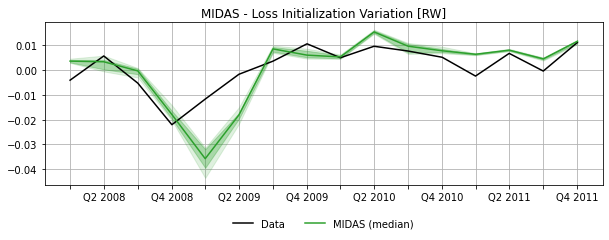

In [79]:
plt.figure(figsize=(10, 3))
plt.plot(dataset2007_short['GDP_data_test'], color='k', label="Data")
plt.plot(dataset2007_short['GDP_data_test'].index, 
        MIDAS_rw__forecasts_qts[2,:], c="C2", label="MIDAS (median)")
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS_rw__forecasts_qts[1,:], MIDAS_rw__forecasts_qts[3,:],
        color="C2", alpha=0.3)
plt.fill_between(dataset2007_short['GDP_data_test'].index,
        MIDAS_rw__forecasts_qts[0,:], MIDAS_rw__forecasts_qts[4,:],
        color="C2", alpha=0.15)
#
plt.xticks(pd.date_range(
        dataset2007_short['GDP_data_test'].index[0], 
        dataset2007_short['GDP_data_test'].index[-1],
        freq="Q"
), labels=[l for y in [2008, 2009, 2010, 2011] for l in ["", "Q2 "+str(y), "", "Q4 "+str(y)]])
plt.grid()
plt.title("MIDAS - Loss Initialization Variation [RW]")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), 
                frameon=False, fancybox=False, shadow=False, ncol=4)
if savePlots: 
    plt.savefig(os.path.join(plots_folder, 'plot_midas_resample_rw_2007.pdf'), bbox_inches="tight")
plt.show()